In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

42


In [2]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [3]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])*(t- coeffs[3]) )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQR','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logisticQR')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x


In [22]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [23]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [24]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [25]:
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1084358,North America,North America,NaN,2389.0,200.0,17985.0,NaN,1474770,89051.0,301361.0,NaN,NaN
1,806888,Europe,Europe,NaN,84.0,8.0,14339.0,NaN,1605922,151773.0,647261.0,NaN,NaN
2,179108,South America,South America,NaN,177.0,8.0,10095.0,NaN,298131,15400.0,103623.0,NaN,NaN
3,270326,Asia,Asia,NaN,1023.0,11.0,5008.0,NaN,651907,21862.0,359719.0,NaN,NaN
4,38105,Africa,Africa\n,NaN,1.0,NaN,217.0,NaN,61986,2232.0,21649.0,NaN,NaN


In [26]:
df.tail()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
224,270326,Asia,Total:,NaN,1023.0,11.0,5008.0,NaN,651907,21862.0,359719.0,NaN,NaN
225,38105,Africa,Total:,NaN,1.0,NaN,217.0,NaN,61986,2232.0,21649.0,NaN,NaN
226,811,Australia/Oceania,Total:,NaN,12.0,NaN,20.0,NaN,8537,118.0,7608.0,NaN,NaN
227,61,NaN,Total:,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
228,409685,Europe,European Union,258.391616,84.0,8.0,9732.0,30357.676353,1093386,115049.0,568402.0,13516771.0,2455.664768


In [27]:
dfAll.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1084358,North America,North America,NaN,2389.0,200.0,17985.0,NaN,1474770,89051.0,301361.0,NaN,NaN
1,806888,Europe,Europe,NaN,84.0,8.0,14339.0,NaN,1605922,151773.0,647261.0,NaN,NaN
2,179108,South America,South America,NaN,177.0,8.0,10095.0,NaN,298131,15400.0,103623.0,NaN,NaN
3,270326,Asia,Asia,NaN,1023.0,11.0,5008.0,NaN,651907,21862.0,359719.0,NaN,NaN
4,38105,Africa,Africa\n,NaN,1.0,NaN,217.0,NaN,61986,2232.0,21649.0,NaN,NaN


In [28]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
92,567,Europe,Lithuania,18.0,0.0,0.0,17.0,66243.0,1444,49.0,828.0,180332.0,530.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


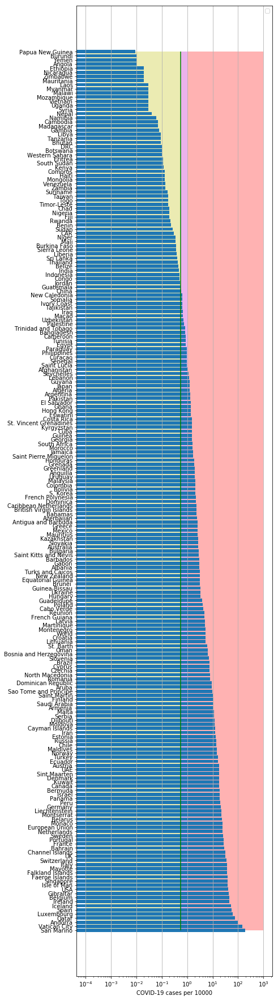

In [29]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


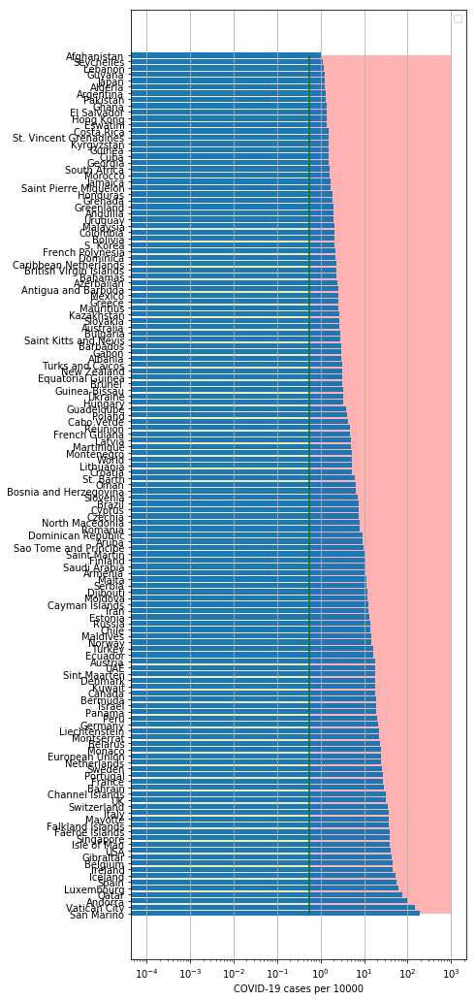

In [30]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

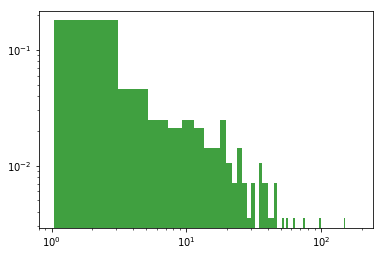

In [31]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [32]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
          date   cases  active    death
70 2020-05-05  250561   70230  25613.0
71 2020-05-06  253682   68466  25857.0
72 2020-05-07  256855   66866  26070.0
73 2020-05-08  260117   65410  26299.0
74 2020-05-09  262783   63148  26478.0
GB
          date   cases  active    death
69 2020-05-05  194990  165219  29427.0
70 2020-05-06  201101  170681  30076.0
71 2020-05-07  206715  175756  30615.0
72 2020-05-08  211364  179779  31241.0
73 2020-05-09  215260  183329  31587.0
IT
          date   cases  active    death
72 2020-05-05  213013   98467  29315.0
73 2020-05-06  214457   91528  29684.0
74 2020-05-07  215858   89624  29958.0
75 2020-05-08  217185   87961  30201.0
76 2020-05-09  218268   84842  30395.0
LT
          date   cases  active  death     tests
57 2020-05-05  1428.0     662   48.0  156493.0
58 2020-05-06  1433.0     645   49.0  164088.0
59 2020-05-07  1436.0     622   49.1  172191.0
60 2020-05-08  1444.0     563   49.2  180332.0
61 2020-05-09  1444.0     567   49.0       NaN


IE
          date  cases   active  death
57 2020-05-05  12071   9002.0  872.0
58 2020-05-06  12438   9226.0  895.0
59 2020-05-07  12776   9465.0  930.0
60 2020-05-08  13112   9675.0  943.0
61 2020-05-09  13645  10079.0  959.0
MX
          date  cases  active   death
58 2020-05-05  26025  6708.0  2507.0
59 2020-05-06  27634  7149.0  2704.0
60 2020-05-07  29616  8874.0  2961.0
61 2020-05-08  31522  8048.0  3160.0
62 2020-05-09  33460  8283.0  3353.0
PM
          date  cases  active  death
56 2020-05-05   7523  6490.0  210.0
57 2020-05-06   7731  6654.0  218.0
58 2020-05-07   7868  6757.0  225.0
59 2020-05-08   8070  6953.0  231.0
60 2020-05-09   8282  3544.0  237.0
PU
          date  cases   active   death
59 2020-05-05  51189  34332.0  1444.0
60 2020-05-06  54817  35757.0  1533.0
61 2020-05-07  58526  38511.0  1627.0
62 2020-05-08  61847  41121.0  1714.0
63 2020-05-09  65015  42955.0  1814.0
SB
          date  cases  active  death
56 2020-05-05   9677  7754.0  200.0
57 2020-05-06   9791

In [33]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)

In [34]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.775987018178767
intercept: -2.695573676744358
slope: [0.1176853]


/usr/local/lib/python3.5/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


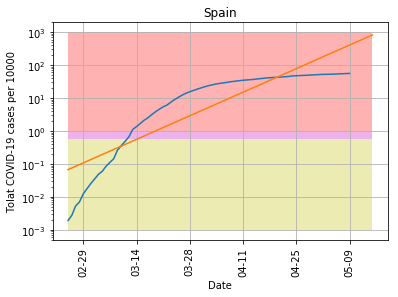

In [35]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-05-15', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [36]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.8882672853564827
intercept: -4.270145569778673
slope: [0.12957184]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


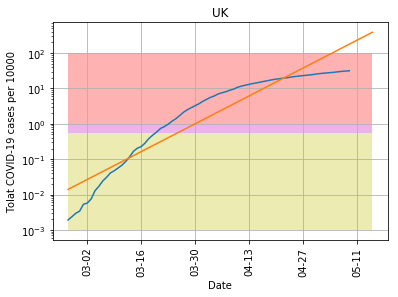

In [37]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-05-15', "pictures/coronaGB.png", model1, 'UK',100)

In [38]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0718751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9923703640704333
intercept: 1.905007996948179
slope: [-0.05035122]


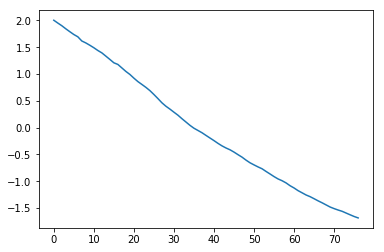

In [39]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


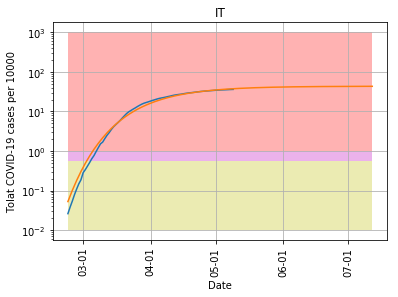

In [40]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [41]:
cs=y_pred11[-1]/10000.*populationIT

In [42]:
cs

261247.65834840617

In [43]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.691833726228092
intercept: -2.3673813170563363
slope: [0.08911957]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


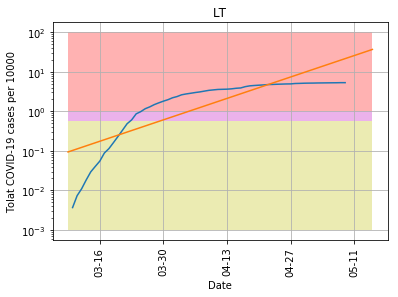

In [44]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-05-15', "pictures/coronaLT.png", model1, 'LT',100)

In [45]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9923703640704333
intercept: -6.100660531336605
slope: [0.14689819]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


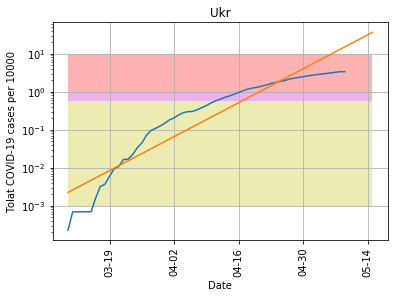

In [46]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-05-15', "pictures/coronaUkr.png", model11, 'Ukr',10)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


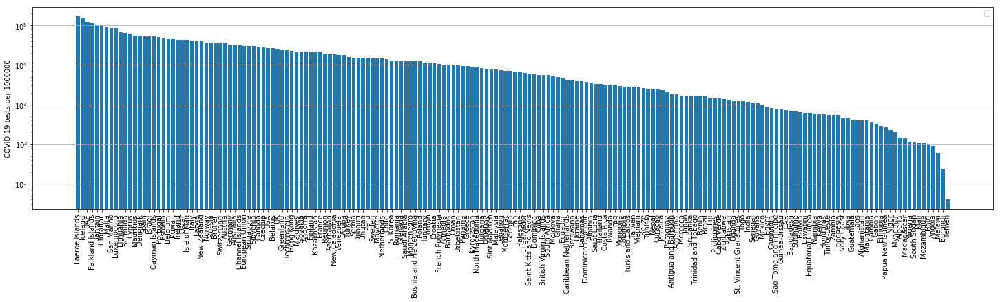

In [47]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [48]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9923703640704333
intercept: -3.8291408224186694
slope: [0.13622653]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


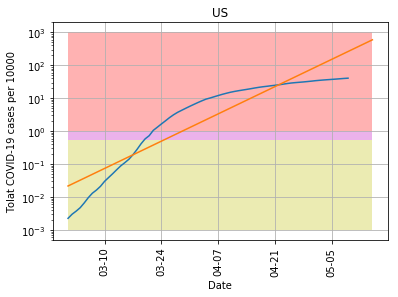

In [49]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-05-15', "pictures/coronaUS.png", model11, 'US',1000)

In [50]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
228  European Union  0.105223


(0, 0.15)

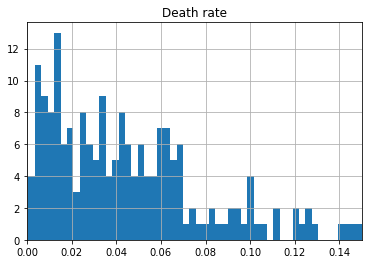

In [51]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

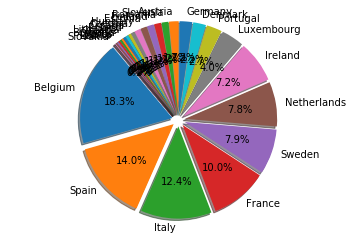

In [52]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [53]:
dfTTh.head()

,Country,Deathsper1Mpop
20,Belgium,740.0
8,Spain,566.0
9,Italy,503.0
12,France,403.0
29,Sweden,319.0


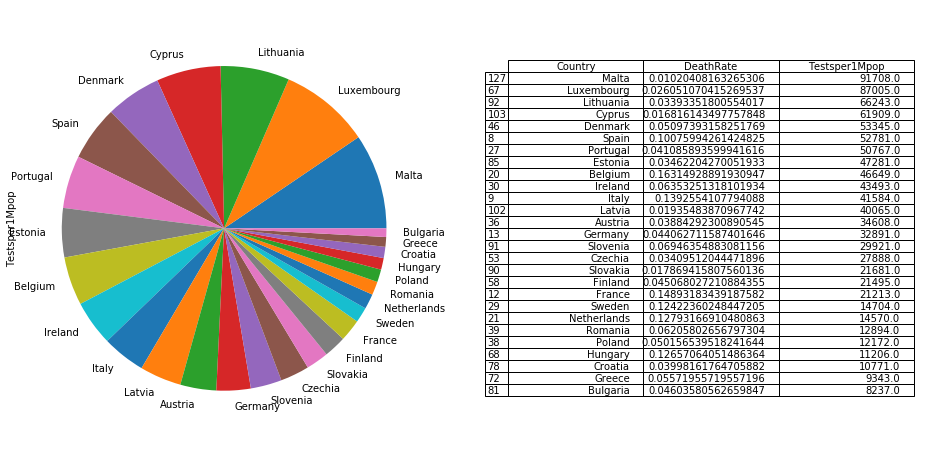

In [54]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

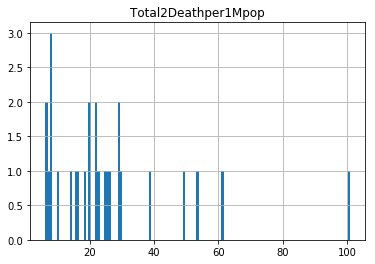

In [55]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [56]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
8,Spain,5620.0,566.0
9,Italy,3610.0,503.0
12,France,2706.0,403.0
13,Germany,2045.0,90.0
20,Belgium,4538.0,740.0


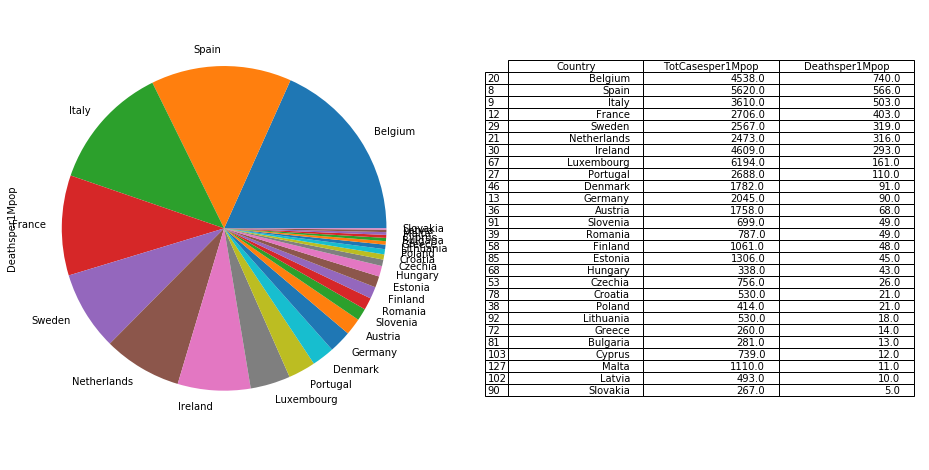

In [57]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [58]:
dfAll.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1084358,North America,North America,0.0,2389.0,200.0,17985.0,0.0,1474770,89051.0,301361.0,0.0,0.0
1,806888,Europe,Europe,0.0,84.0,8.0,14339.0,0.0,1605922,151773.0,647261.0,0.0,0.0
2,179108,South America,South America,0.0,177.0,8.0,10095.0,0.0,298131,15400.0,103623.0,0.0,0.0
3,270326,Asia,Asia,0.0,1023.0,11.0,5008.0,0.0,651907,21862.0,359719.0,0.0,0.0
4,38105,Africa,Africa\n,0.0,1.0,0.0,217.0,0.0,61986,2232.0,21649.0,0.0,0.0


In [59]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
8,Spain,0.106478
9,Italy,0.086812
12,France,0.127563
13,Germany,0.062175
20,Belgium,0.097280


In [60]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.174578
 Netherlands             0.169732
      France             0.127563
       Spain             0.106478
     Ireland             0.105971
     Belgium             0.097280
       Italy             0.086812
  Luxembourg             0.071191
     Germany             0.062175
     Romania             0.061036
    Portugal             0.052948
     Austria             0.050798
     Finland             0.049360
     Croatia             0.049206
    Bulgaria             0.034114
      Poland             0.034012
     Denmark             0.033405
     Hungary             0.030162
      Greece             0.027828
     Estonia             0.027622
     Czechia             0.027108
    Slovenia             0.023362
    Slovakia             0.012315
      Latvia             0.012305
       Malta             0.012104
      Cyprus             0.011937
   Lithuania             0.008001


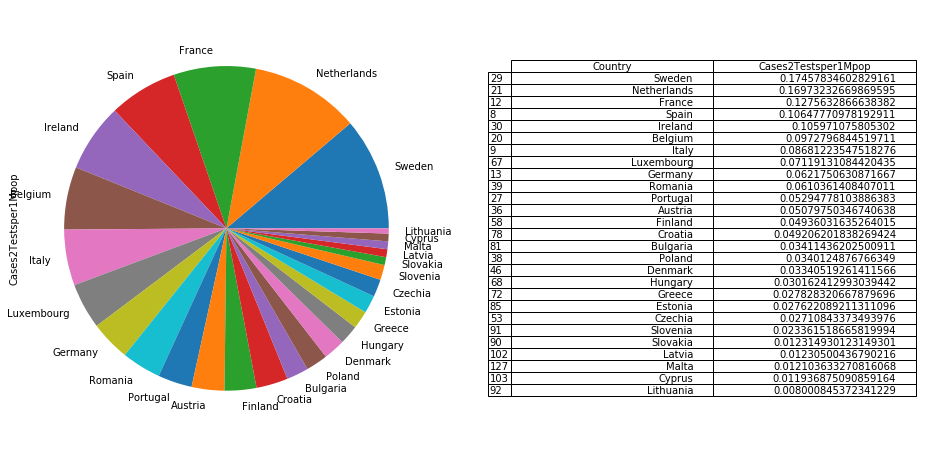

In [61]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [62]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
33,Qatar,0.000609,43232.000000
31,Singapore,0.000890,30016.000000
63,Bahrain,0.001676,104816.000000
93,Djibouti,0.002523,15239.000000
109,Maldives,0.003797,21784.000000
95,Hong Kong,0.003828,22448.000000
76,Uzbekistan,0.004189,9710.000000
119,Guinea-Bissau,0.004680,762.000000
64,Ghana,0.005161,4995.000000
69,Oman,0.005273,9791.000000


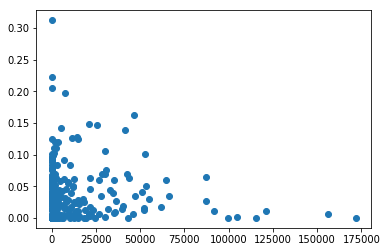

In [63]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.5/dist-packages/matplotlib/patches.py:694: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.5/dist-packages/matplotlib/projections/polar.py:67: RuntimeWarning: invalid value encountered in less
  mask = r < 0


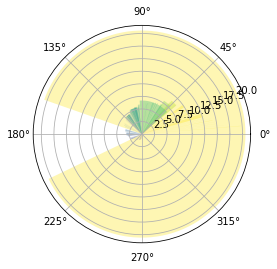

In [64]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

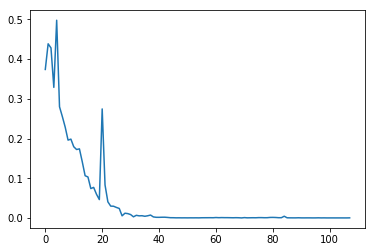

In [65]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [66]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


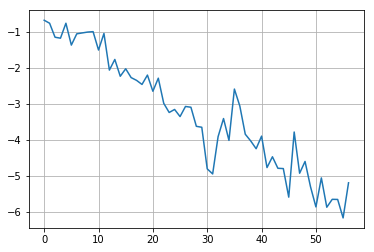

In [67]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

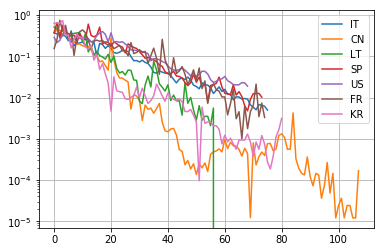

In [68]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

69 69
coefficient of determination: 0.9244420127814036
intercept: -7.752272442842611
slope: [-0.17886325]


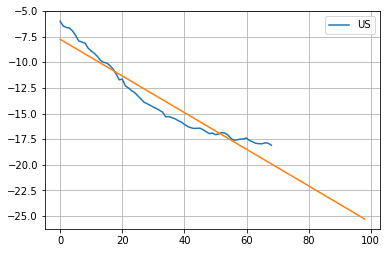

In [69]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

76 76
coefficient of determination: 0.9210860179768476
intercept: -8.968364429159719
slope: [-0.13055674]


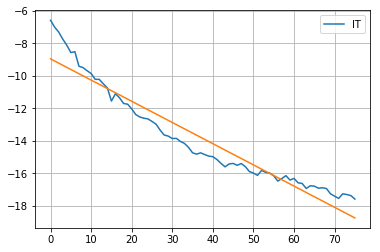

In [70]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [71]:
#model11.coef_

In [72]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

58 58
coefficient of determination: 0.9651186902970238
intercept: -14.506351269929988
slope: [-0.08935736]


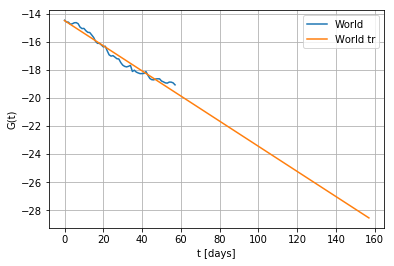

In [73]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

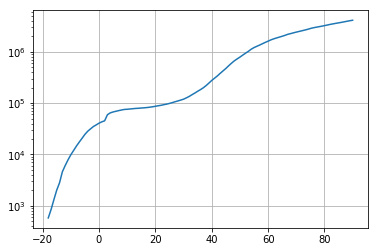

In [74]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [75]:
dfW['cases'].values

array([    580,     845,    1317,    2015,    2800,    4581,    6058,
          7813,    9823,   11950,   14553,   17391,   20630,   24545,
         28266,   31439,   34876,   37552,   40553,   43099,   45134,
         59287,   64438,   67100,   69197,   71329,   73332,   75184,
         75700,   76677,   77673,   78651,   79205,   80087,   80828,
         81820,   83112,   84615,   86604,   88585,   90443,   93016,
         95314,   98425,  102050,  106099,  109991,  114381,  118948,
        126214,  134576,  145483,  156653,  169593,  182490,  198238,
        218822,  244933,  275597,  305036,  337489,  378860,  422629,
        471035,  531864,  596366,  663079,  723279,  784738,  858355,
        936237, 1016330, 1117928, 1203058, 1274578, 1347566, 1432869,
       1519195, 1605277, 1700004, 1780713, 1853505, 1925330, 2000065,
       2084633, 2183942, 2252370, 2332650, 2407467, 2482272, 2557917,
       2638909, 2725972, 2833697, 2921571, 2995209, 3065871, 3139009,
       3221029, 3308

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 5.67369550e+06  3.00204413e+00 -3.08606737e+01  1.44002470e-02]


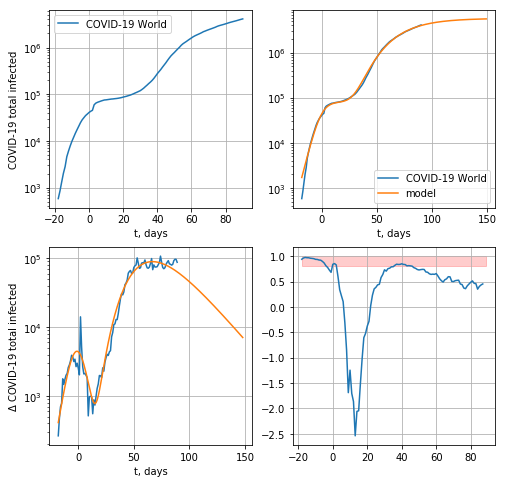

31776.350447100616


In [76]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

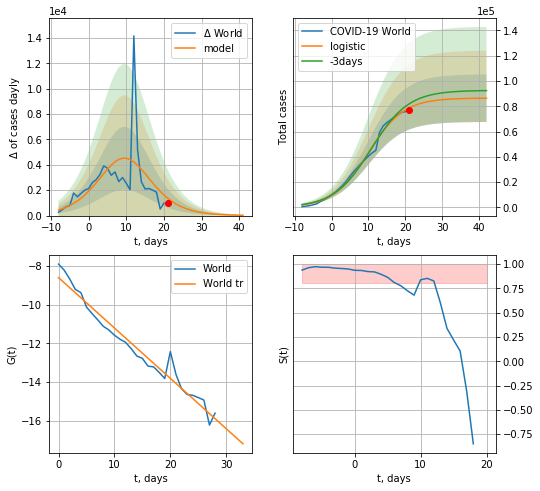

World data at: 2020-05-09
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +21 days
	 deltaDaycases:  24
	 total cases:  86368 ± 18811
	 total death:  5904 ± 3857
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


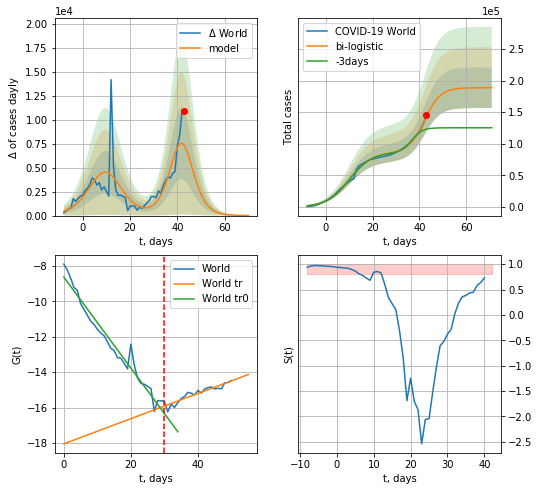

World data at: 2020-05-09
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +28 days
	 deltaDaycases:  7
	 total cases:  188680 ± 32062
	 total death:  12900 ± 6576
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


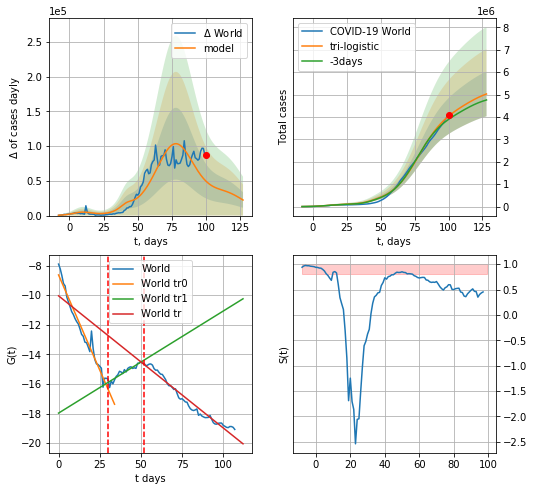

World data at: 2020-05-09
+3 day model MAPE: 0.038349593247450416
model: tri-logistic
coeffs:  [4.09668861e+06 9.90738212e-02 7.79241666e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.1984460832128385
forecast at the end of period: +28 days
	 deltaDaycases:  22414
	 total cases:  5025497 ± 997290
	 total death:  343592 ± 204553
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.961366
 intercept: -10.042262
 slope: -0.089315


In [77]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

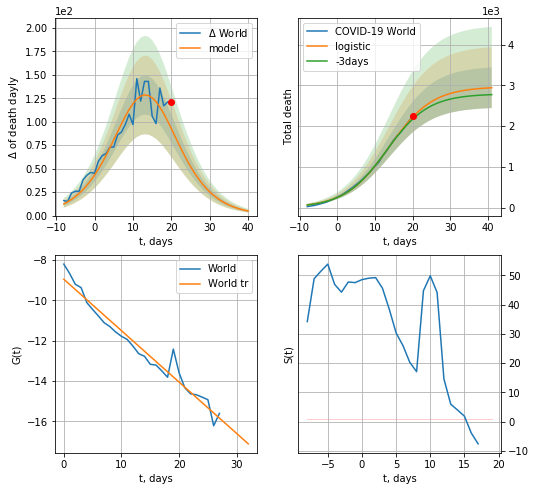

World data at: 2020-05-09
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +21 days
	 total death:  2943 ± 498
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


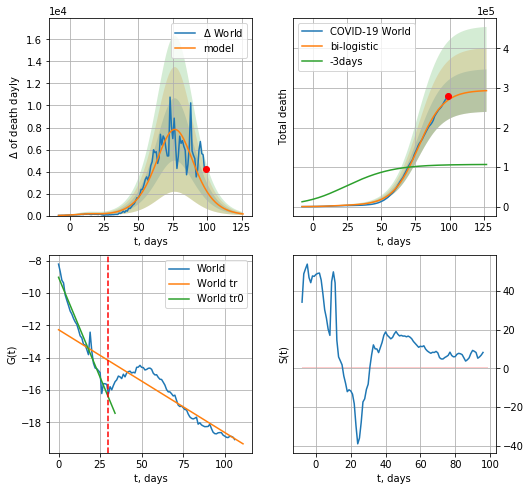

World data at: 2020-05-09
+3 day model MAPE: 1.5772925670140883
model: bi-logistic
coeffs:  [2.91597559e+05 1.07422423e-01 7.69267970e+01] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.18323702658434818
forecast at the end of period: +28 days
	 deltaDaydeath:  151
	 total death:  293228 ± 53730
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.826370
 intercept: -12.272254
 slope: -0.063645


In [78]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [79]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


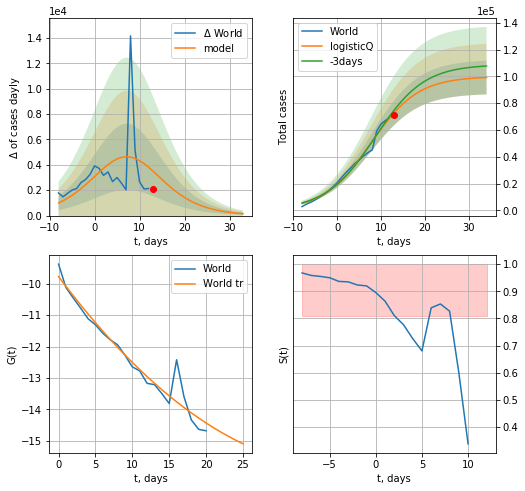

World data at: 2020-05-09
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +21 days
	 deltaDaycases: 148
	 total cases: 99134 ± 12586
	 total death: 6777 ± 2581
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp


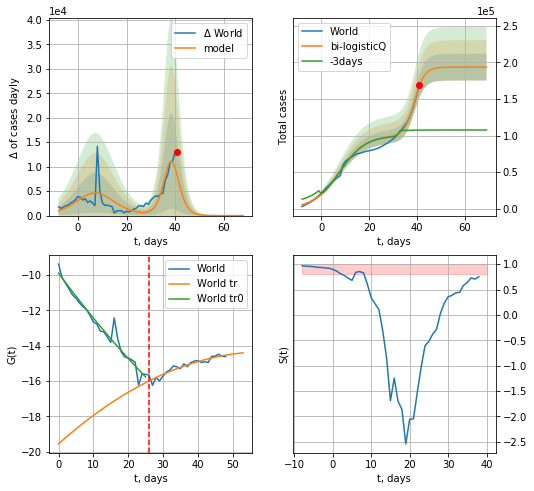

World data at: 2020-05-09
+3 day model MAPE: 0.635593
model: bi-logisticQ
coeffs: [ 9.37578627e+04  2.55228565e-05  3.89552969e+01 -1.87082152e+04]
rational stdev: 0.094698
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 193621 ± 18335
	 total death: 13237 ± 3760
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:432: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


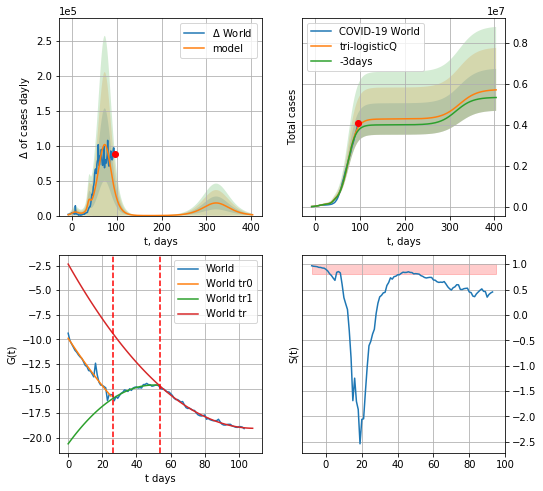

World data at: 2020-05-09
+3 day model MAPE: 0.044019
model: bi-logisticQ
coeffs: [ 4.07968893e+06  1.18062257e-06  7.38846502e+01 -8.44079159e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.179638
forecast at the end of period: +308 days
	 deltaDaycases: 1178
	 total cases: 5694905 ± 1023019
	 total death: 389359 ± 209830
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.993121
 intercept_: -2.3479222155626758
 coeffs_: [ 0.         -0.30600156  0.00140207]


In [80]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*9-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*50-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


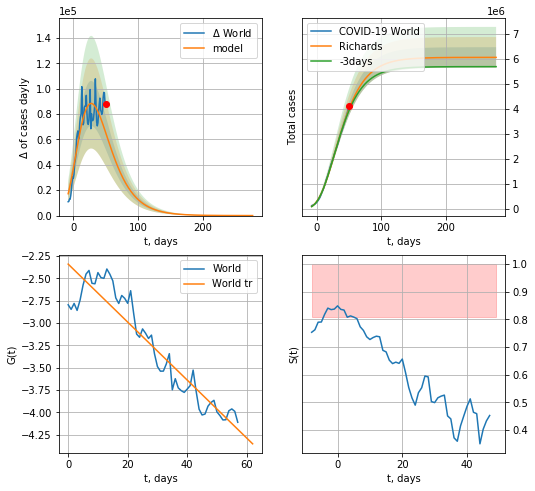

World data at: 2020-05-09
+3 day model MAPE: 0.017445
model: Richards
coeffs: [ 6.06429813e+06  2.31216695e+00 -7.35713519e+01  1.72744933e-02]
rational stdev: 0.067021
forecast at the end of period: +228 days
	 deltaDaycases: 11
	 total cases: 6064018 ± 406417
	 total death: 414595 ± 83359
trend coefficient of determination: 0.881690
 intercept: -2.341524
 slope: -0.032404


In [81]:
x = forecastRR("World",dfW[50:],d1,30*9-dT,1.0,False)

In [82]:
#x = forecastR("World",dfW[:30],d1,7*9-dT,1.0)
#xx = forecast2R("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


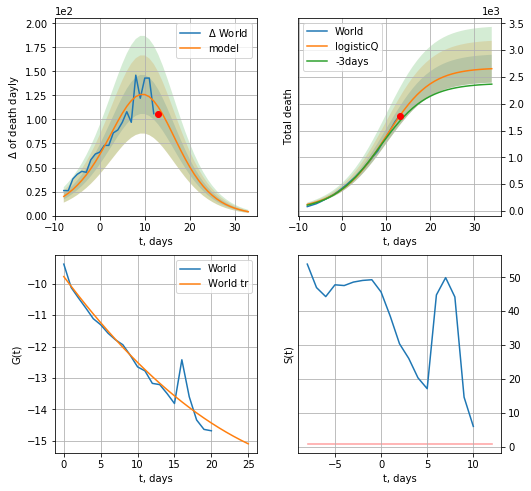

World data at: 2020-05-09
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +21 days
	 total death: 2654 ± 260
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


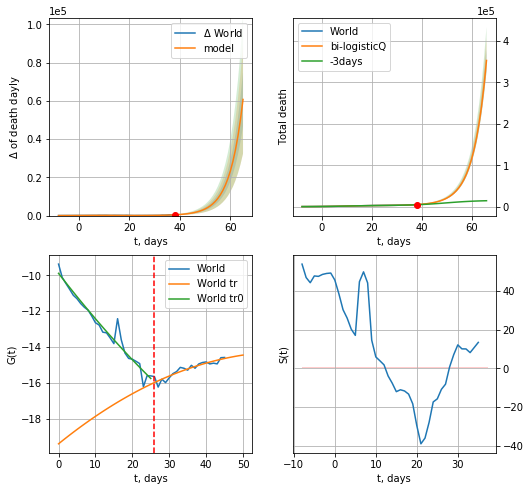

World data at: 2020-05-09
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +28 days
	 total death: 353131 ± 27046
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:432: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


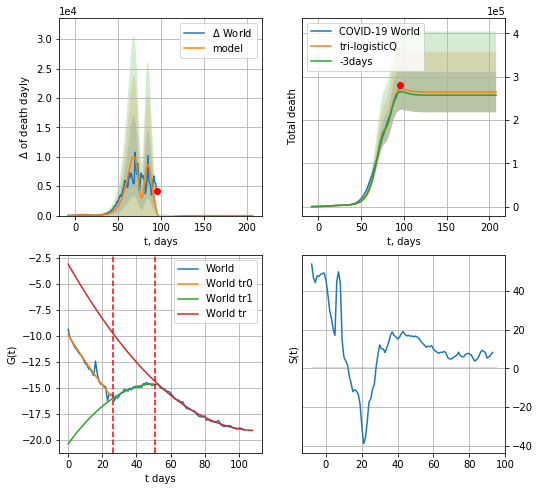

World data at: 2020-05-09
+3 day model MAPE: 0.022653
model: bi-logisticQ
coeffs: [-6.16044733e+06  4.46988860e-05  7.97075023e+01 -4.99226239e+03]
rational stdev: 0.176150
forecast at the end of period: +112 days
	 total death: 264264 ± 46550
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.993399
 intercept_: -3.0853571095683456
 coeffs_: [ 0.         -0.28776648  0.00129198]


In [83]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


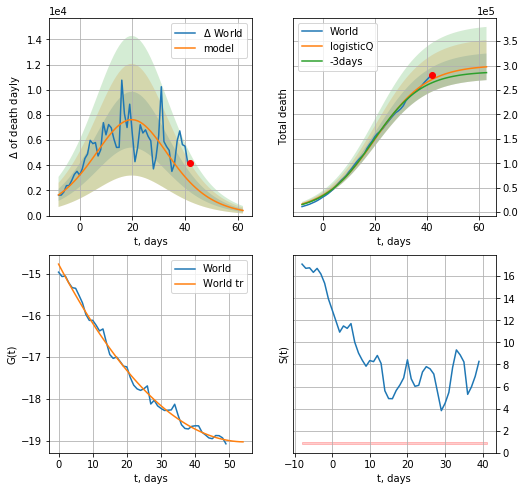

World data at: 2020-05-09
+3 day model MAPE: 0.026588
model: logisticQ
coeffs: [ 3.01210043e+05  1.14724561e-05  2.02207383e+01 -8.80453371e+03]
rational stdev: 0.091562
forecast at the end of period: +21 days
	 total death: 297379 ± 27228
trend coefficient of determination: 0.993137
 intercept_: -14.774065775725566
 coeffs_: [ 0.         -0.15573498  0.0014254 ]


In [84]:
x = forecastRRR("World",dfW[58:],d1,7*9-dT,1.0,False,cases='death')

In [85]:
#trend(dfSP,'SP',10)

In [86]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

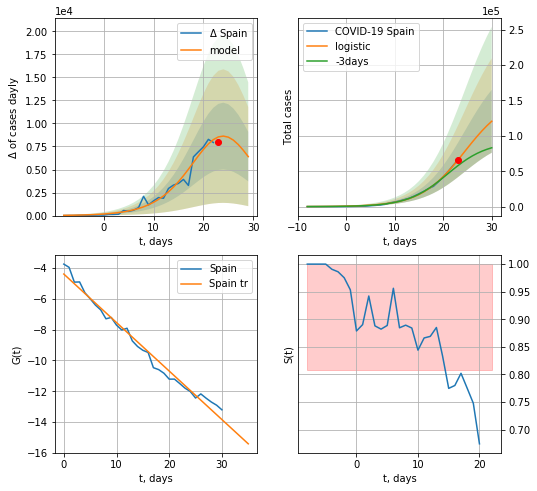

Spain data at: 2020-05-09
+3 day model MAPE: 0.17994225331219452
model: logistic
coeffs:  [1.55796358e+05 2.21769203e-01 2.44355993e+01]
rational stdev:  0.3682790859287634
forecast at the end of period: +7 days
	 deltaDaycases:  6397
	 total cases:  120667 ± 44439
	 total death:  12158 ± 13432
trend coefficient of determination: 0.981962
 intercept: -4.388643
 slope: -0.315050


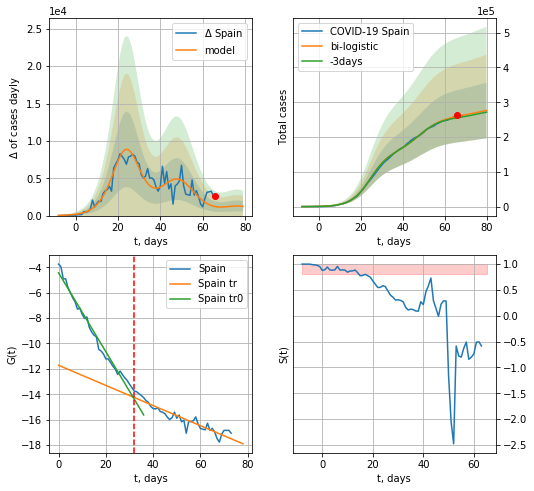

Spain data at: 2020-05-09
+3 day model MAPE: 0.01732794106738672
model: bi-logistic
coeffs:  [1.05354651e+05 1.78984683e-01 4.86389038e+01] [1.55796358e+05 2.21769203e-01 2.44355993e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.2894806799058595
forecast at the end of period: +14 days
	 deltaDaycases:  1226
	 total cases:  276471 ± 80033
	 total death:  27857 ± 24192
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.981698
 intercept: -4.427117
 slope: -0.311203
trend coefficient of determination: 0.874900
 intercept: -11.718527
 slope: -0.079350


In [88]:
vL = 32#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,7*7-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*8-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

SP
          date   cases  active    death
70 2020-05-05  250561   70230  25613.0
71 2020-05-06  253682   68466  25857.0
72 2020-05-07  256855   66866  26070.0
73 2020-05-08  260117   65410  26299.0
74 2020-05-09  262783   63148  26478.0


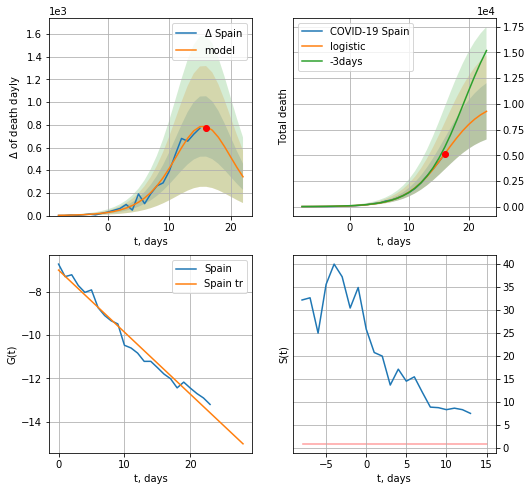

Spain data at: 2020-05-09
+3 day model MAPE: 0.15747030887395475
model: logistic
coeffs:  [1.03877331e+04 3.04619794e-01 1.60547713e+01]
rational stdev:  0.29538659014568974
forecast at the end of period: +7 days
	 total death:  9270 ± 2738
trend coefficient of determination: 0.976452
 intercept: -6.992078
 slope: -0.287044


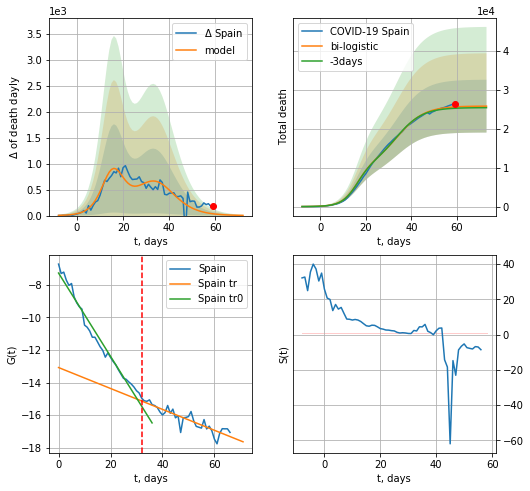

Spain data at: 2020-05-09
+3 day model MAPE: 0.014021766460263188
model: bi-logistic
coeffs:  [1.54755993e+04 1.68679186e-01 3.40113231e+01] [1.03877331e+04 3.04619794e-01 1.60547713e+01]
rational stdev:  0.2629017722976764
forecast at the end of period: +14 days
	 deltaDaydeath:  3
	 total death:  25841 ± 6793
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.975844
 intercept: -7.265510
 slope: -0.256124
trend coefficient of determination: 0.806738
 intercept: -13.079602
 slope: -0.064336


In [90]:
vL = 32#len(dfSP[:])-7-dT
dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*7-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*8-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


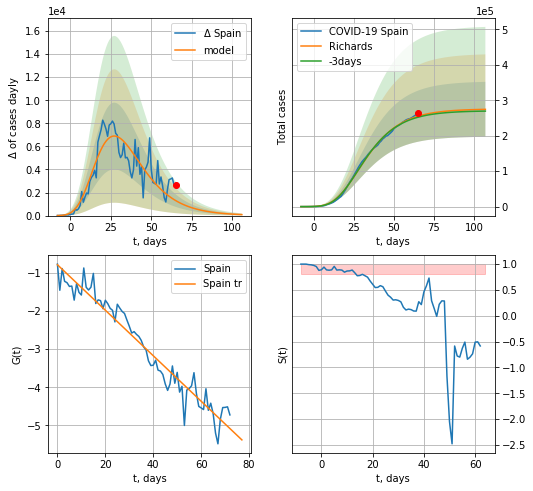

Spain data at: 2020-05-09
+3 day model MAPE: 0.011938
model: Richards
coeffs: [ 2.75563023e+05  6.28379463e+00 -3.84083056e+01  1.08922550e-02]
rational stdev: 0.282538
forecast at the end of period: +42 days
	 deltaDaycases: 84
	 total cases: 274361 ± 77517
	 total death: 27644 ± 23431
trend coefficient of determination: 0.940133
 intercept: -0.785218
 slope: -0.059706


In [91]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:72: RuntimeWarning: divide by zero encountered in true_divide


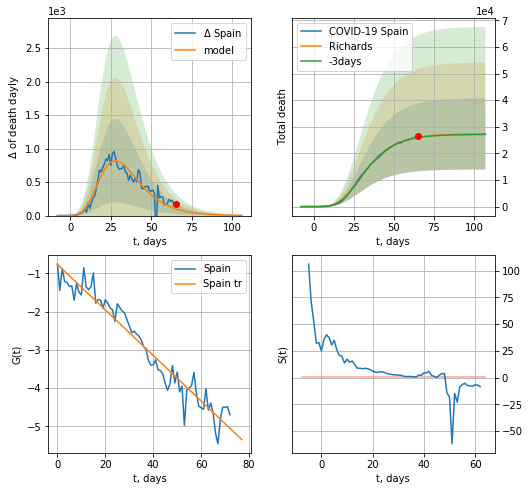

Spain data at: 2020-05-09
+3 day model MAPE: 0.006068
model: Richards
coeffs: [ 2.73686795e+04  9.86478614e+00 -3.02409066e+01  8.29627333e-03]
rational stdev: 0.490282
forecast at the end of period: +42 days
	 total death: 27325 ± 13396
trend coefficient of determination: 0.939363
 intercept: -0.768682
 slope: -0.059421


In [92]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


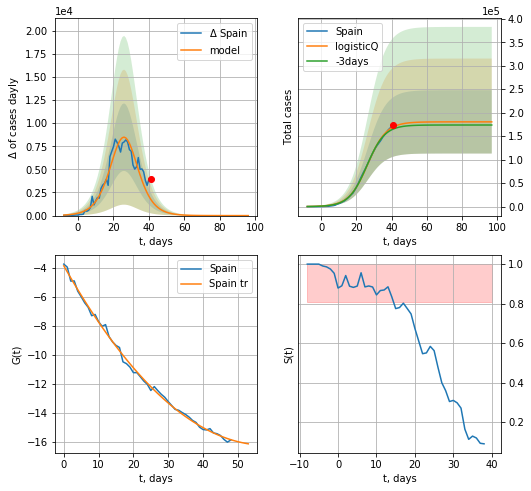

Spain data at: 2020-05-09
+3 day model MAPE: 0.028157
model: logisticQ
coeffs: [ 1.80489569e+05  4.90633148e-06  2.63952659e+01 -3.83458431e+04]
rational stdev: 0.373397
forecast at the end of period: +56 days
	 deltaDaycases: 0
	 total cases: 180489 ± 67394
	 total death: 18186 ± 20371
trend coefficient of determination: 0.997432
 intercept_: -3.859009253100683
 coeffs_: [ 0.         -0.42385579  0.00363487]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


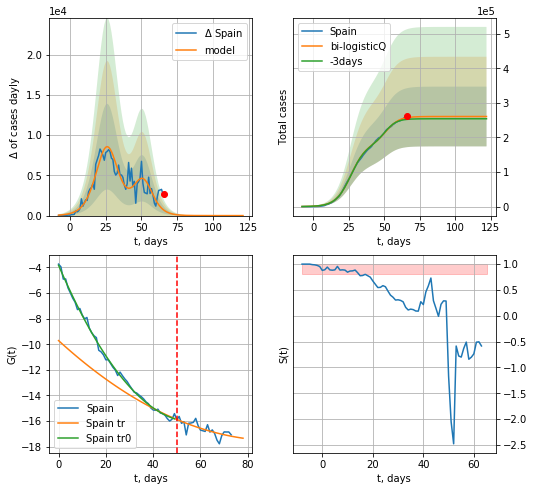

Spain data at: 2020-05-09
+3 day model MAPE: 0.020529
model: bi-logisticQ
coeffs: [ 8.00108183e+04  2.23926812e-06  5.14063095e+01 -9.64669284e+04]
rational stdev: 0.331451
forecast at the end of period: +56 days
	 deltaDaycases: 0
	 total cases: 260500 ± 86343
	 total death: 26248 ± 26099
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997202
 intercept_: -3.834231460165485
 coeffs_: [ 0.         -0.42809872  0.00374483]
trend coefficient of determination: 0.562295
 intercept_: -9.713032545281944
 coeffs_: [ 0.         -0.16861046  0.00090902]


In [93]:
x = forecastRRR('Spain',dfSP[:50],d1,7*14-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: divide by zero encountered in true_divide


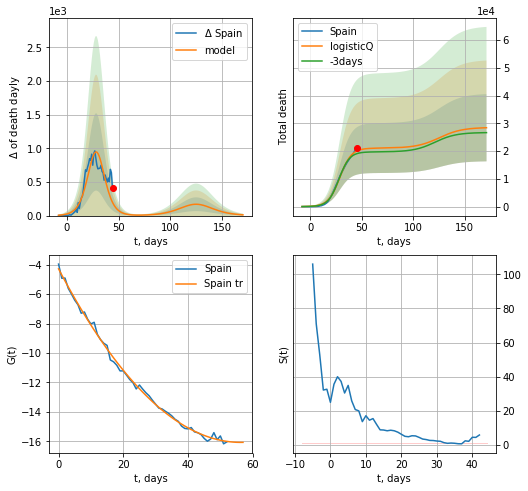

Spain data at: 2020-05-09
+3 day model MAPE: 0.052146
model: logisticQ
coeffs: [ 2.10785072e+04  2.45976331e-06  2.87220026e+01 -7.30294753e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.426167
forecast at the end of period: +126 days
	 total death: 28426 ± 12114
trend coefficient of determination: 0.997093
 intercept_: -4.2745317106494545
 coeffs_: [ 0.         -0.41935329  0.00372528]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:344: RuntimeWarning: divide by zero encountered in true_divide


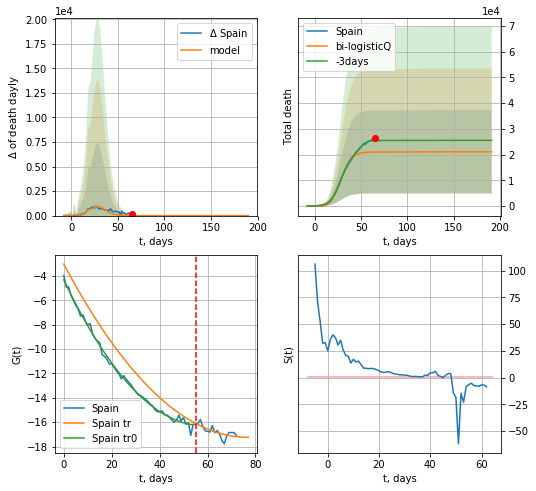

Spain data at: 2020-05-09
+3 day model MAPE: 0.175328
model: bi-logisticQ
coeffs: [-4.85758336e+02 -8.23272264e-02  1.85478618e+01  4.38382215e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.766838
forecast at the end of period: +126 days
	 total death: 21078 ± 16163
bi-logisticQ approximation splitting point: 55
trend coefficient of determination: 0.995977
 intercept_: -4.321307017900119
 coeffs_: [ 0.         -0.41196694  0.00354831]
trend coefficient of determination: 0.571579
 intercept_: -3.027131383569385
 coeffs_: [ 0.         -0.37027375  0.00241264]


In [94]:
x = forecastRRR('Spain',dfSP[1:55],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=55)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


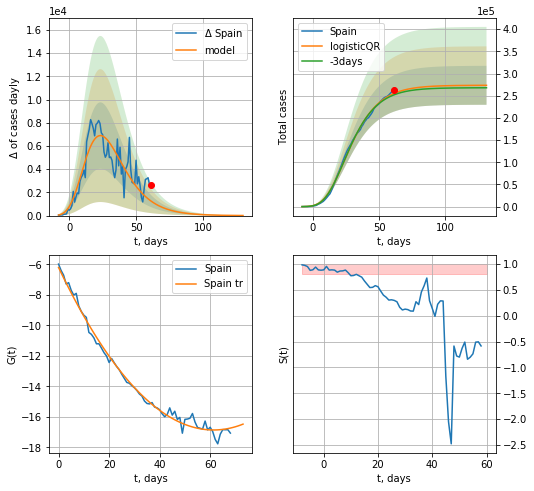

Spain data at: 2020-05-09
+3 day model MAPE: 0.012724735770782498
model: logisticQR
coeffs:  [ 2.73574140e+05  3.61198118e-02 -8.07188193e+01 -1.30867358e+03
  1.32213008e-03]
rational stdev:  0.1604515257611255
forecast at the end of period: +70 days
	 deltaDaycases:  8
	 total cases:  273475 ± 43879
	 total death:  27555 ± 13263
trend coefficient of determination: 0.991145
 intercept_: -6.209255542655232
 coeffs_: [ 0.         -0.34733363  0.00283038]


In [95]:
x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

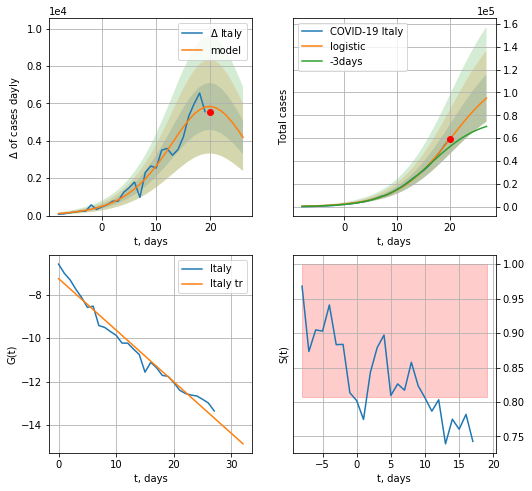

Italy data at: 2020-05-09
+3 day model MAPE: 0.1545703725042627
model: logistic
coeffs:  [1.21492367e+05 1.92504372e-01 2.03342758e+01]
rational stdev:  0.21800555140478417
forecast at the end of period: +7 days
	 deltaDaycases:  4189
	 total cases:  95127 ± 20738
	 total death:  13247 ± 8663
trend coefficient of determination: 0.973351
 intercept: -7.256152
 slope: -0.237823


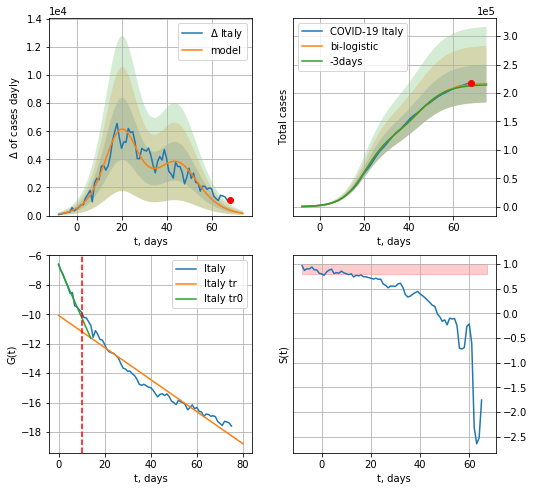

Italy data at: 2020-05-09
+3 day model MAPE: 0.009916366119399122
model: bi-logistic
coeffs:  [9.59305350e+04 1.52450190e-01 4.51755631e+01] [1.21492367e+05 1.92504372e-01 2.03342758e+01]
rational stdev:  0.15354021917862695
forecast at the end of period: +7 days
	 deltaDaycases:  164
	 total cases:  216413 ± 33228
	 total death:  30136 ± 13881
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.939299
 intercept: -10.077751
 slope: -0.109101


In [97]:
x = forecast('Italy',dfIT[:-6-dT],d1,7*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,7*7-dT,x,1.0)

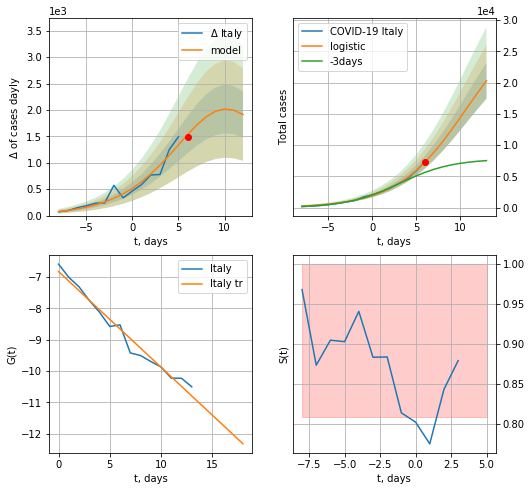

Italy data at: 2020-05-09
+3 day model MAPE: 0.4420796150765939
model: logistic
coeffs:  [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.1413171221665118
forecast at the end of period: +7 days
	 deltaDaycases:  1912
	 total cases:  20304 ± 2869
	 total death:  2827 ± 1198
trend coefficient of determination: 0.972659
 intercept: -6.827339
 slope: -0.305199


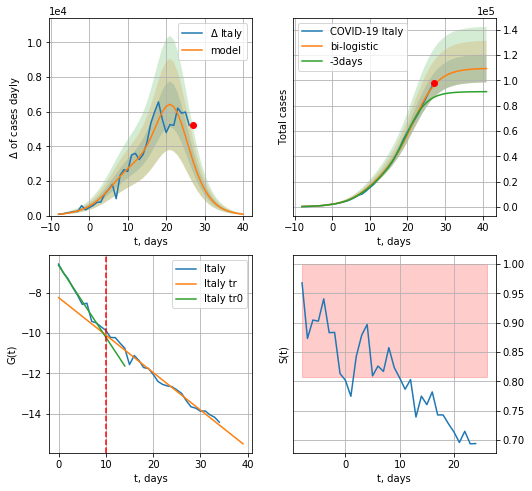

Italy data at: 2020-05-09
+3 day model MAPE: 0.12719416413980916
model: bi-logistic
coeffs:  [7.80633996e+04 3.07326084e-01 2.18190350e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.10039113205484494
forecast at the end of period: +14 days
	 deltaDaycases:  80
	 total cases:  109346 ± 10977
	 total death:  15227 ± 4585
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


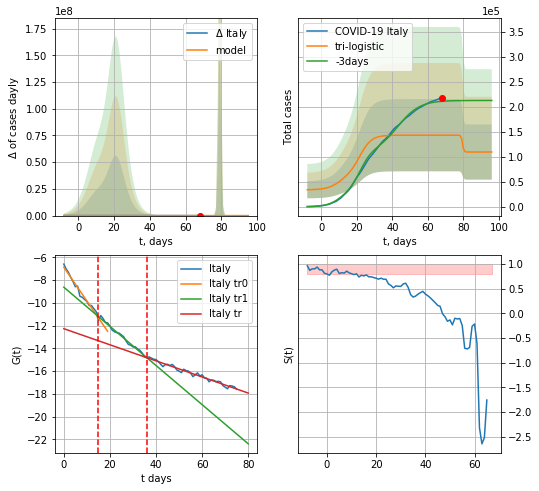

Italy data at: 2020-05-09
+3 day model MAPE: 0.3221661685622408
model: tri-logistic
coeffs:  [ 3.37059445e+04 -2.78184955e+00  7.95195637e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01 7.80633996e+04
 3.07326084e-01 2.18190350e+01]
forecast rational stdev:  0.5047112338985145
forecast at the end of period: +28 days
	 deltaDaycases:  0
	 total cases:  109573 ± 55303
	 total death:  15258 ± 23102
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544
trend1 coefficient of determination: 0.980760
 intercept: -8.621359
 slope: -0.172242
trend coefficient of determination: 0.972509
 intercept: -12.271616
 slope: -0.070825


In [98]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*7-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

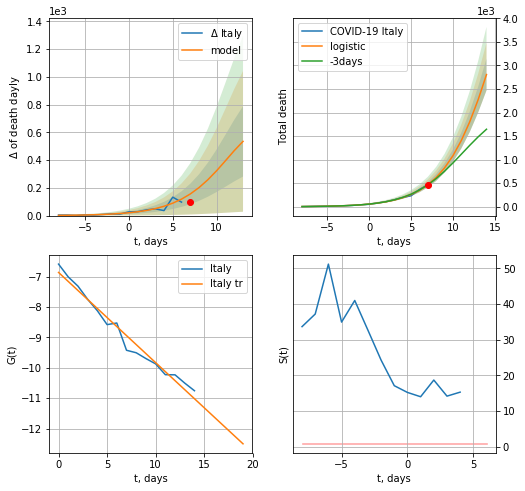

Italy data at: 2020-05-09
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +7 days
	 total death:  2806 ± 337
trend coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544


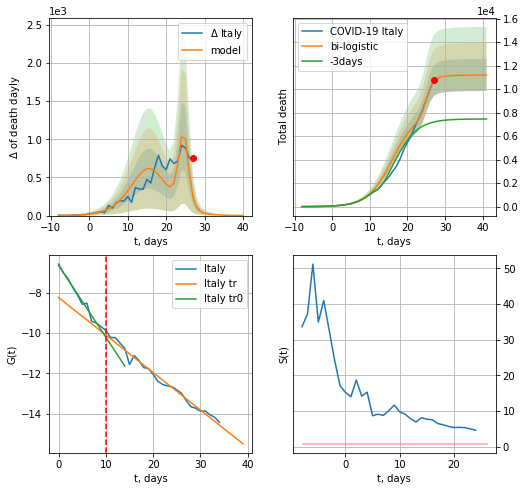

Italy data at: 2020-05-09
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +14 days
	 deltaDaydeath:  1
	 total death:  11207 ± 1364
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


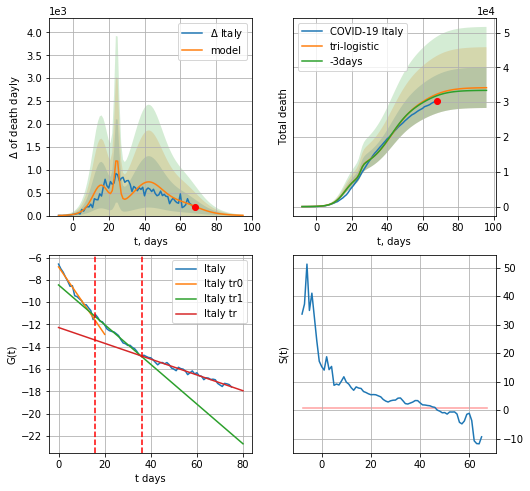

Italy data at: 2020-05-09
+3 day model MAPE: 0.01431063202564365
model: tri-logistic
coeffs:  [1.83903942e+04 1.54608874e-01 4.24299871e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.1704611241607337
forecast at the end of period: +28 days
	 deltaDaydeath:  5
	 total death:  34164 ± 5823
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976838
 intercept: -6.838821
 slope: -0.302120
trend1 coefficient of determination: 0.986419
 intercept: -8.458056
 slope: -0.177939
trend coefficient of determination: 0.972509
 intercept: -12.271616
 slope: -0.070825


In [100]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*7-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


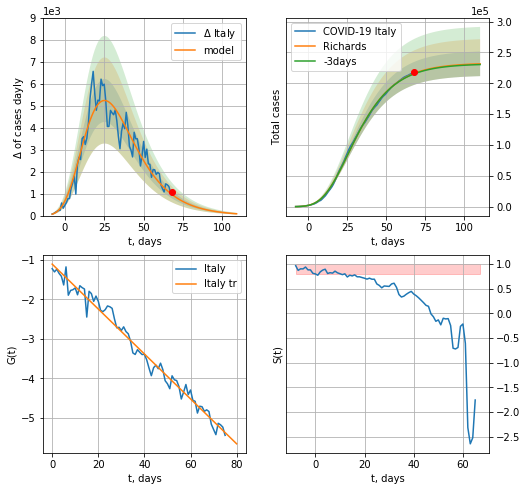

Italy data at: 2020-05-09
+3 day model MAPE: 0.003483
model: Richards
coeffs: [ 2.32899177e+05  5.34116523e+00 -4.69604860e+01  1.15059451e-02]
rational stdev: 0.086149
forecast at the end of period: +42 days
	 deltaDaycases: 82
	 total cases: 231593 ± 19951
	 total death: 32250 ± 8334
trend coefficient of determination: 0.980465
 intercept: -1.103433
 slope: -0.056988


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


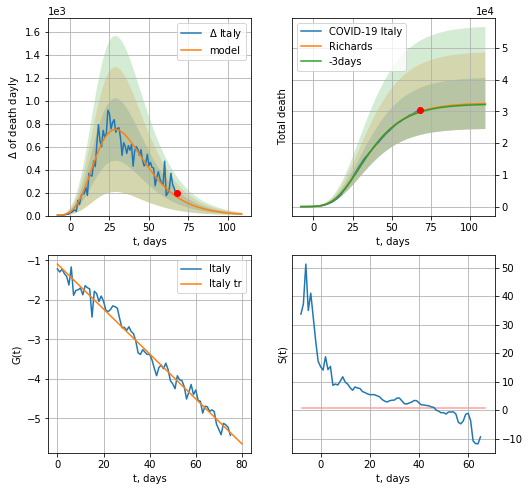

Italy data at: 2020-05-09
+3 day model MAPE: 0.006629
model: Richards
coeffs: [ 3.26914923e+04  6.15635982e+00 -4.38202927e+01  1.01901371e-02]
rational stdev: 0.247559
forecast at the end of period: +42 days
	 total death: 32485 ± 8042
trend coefficient of determination: 0.980345
 intercept: -1.092964
 slope: -0.056890


In [101]:
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0)
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


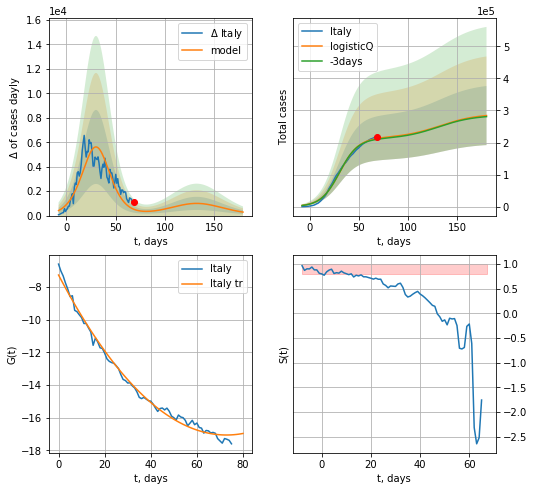

Italy data at: 2020-05-09
+3 day model MAPE: 0.012277
model: logisticQ
coeffs: [ 2.14016066e+05  6.55418580e-07  3.03895976e+01 -1.59670552e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.324254
forecast at the end of period: +112 days
	 deltaDaycases: 285
	 total cases: 284082 ± 92114
	 total death: 39560 ± 38482
trend coefficient of determination: 0.992144
 intercept_: -7.260029617733792
 coeffs_: [ 0.         -0.26908538  0.00184715]


In [102]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


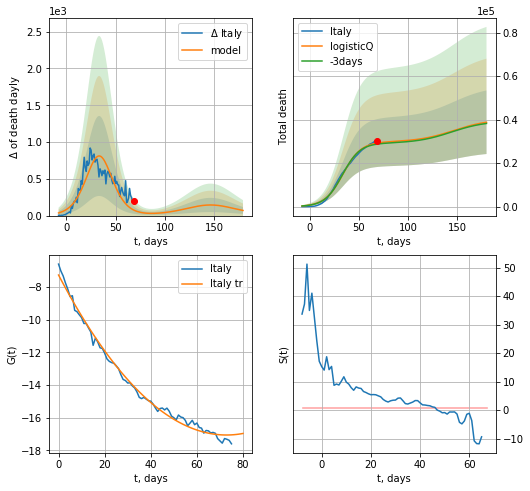

Italy data at: 2020-05-09
+3 day model MAPE: 0.016808
model: logisticQ
coeffs: [ 2.97159692e+04  7.20383819e-07  3.36139772e+01 -1.51313668e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.376653
forecast at the end of period: +112 days
	 total death: 38794 ± 14611
trend coefficient of determination: 0.992144
 intercept_: -7.260029617733792
 coeffs_: [ 0.         -0.26908538  0.00184715]


In [103]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [104]:
dT

42

FR
          date     cases  active    death
80 2020-05-05  170551.0   92284  25531.0
81 2020-05-06  174191.0   94410  25809.0
82 2020-05-07  174791.0   93777  25987.0
83 2020-05-08  176079.0   94067  26230.0
84 2020-05-09  176658.0   94310  26310.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


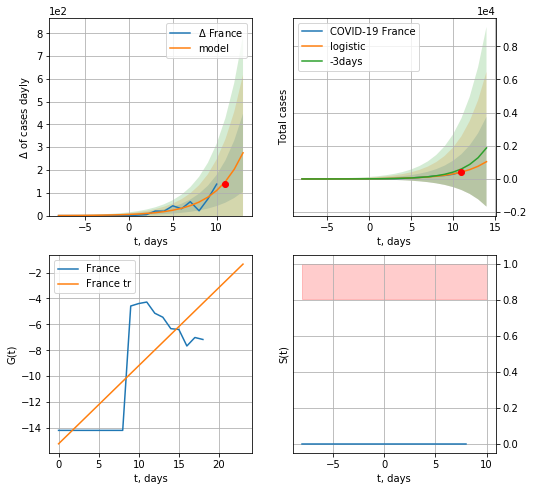

France data at: 2020-05-09
+3 day model MAPE: 0.3579011645535763
model: logistic
coeffs:  [9.13757357e+04 3.09894510e-01 2.83979795e+01]
rational stdev:  2.5989080654975822
forecast at the end of period: +3 days
	 deltaDaycases:  275
	 total cases:  1042 ± 2709
	 total death:  155 ± 1208
trend coefficient of determination: 0.603781
 intercept: -15.217380
 slope: 0.602806


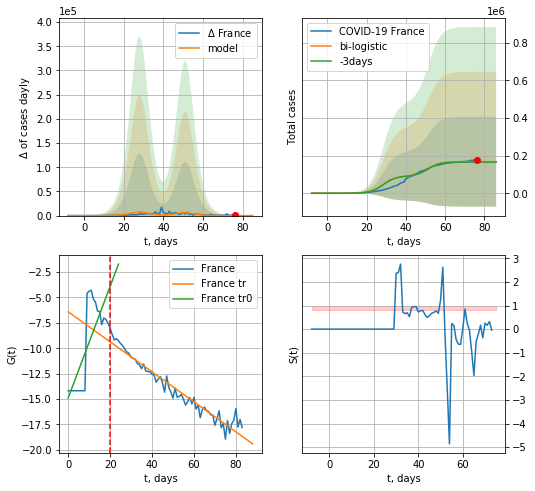

France data at: 2020-05-09
+3 day model MAPE: 0.013793009112946616
model: bi-logistic
coeffs:  [7.64884379e+04 3.19757313e-01 5.14634412e+01] [9.13757357e+04 3.09894510e-01 2.83979795e+01]
rational stdev:  1.421504399114203
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  167862 ± 238617
	 total death:  25000 ± 106612
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.576236
 intercept: -14.895009
 slope: 0.549077
trend coefficient of determination: 0.944636
 intercept: -6.409605
 slope: -0.147661


In [105]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,7*7-dT-4,1.0)
xx = forecast2('France',dfFR,d1,8*7-dT-4,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [106]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

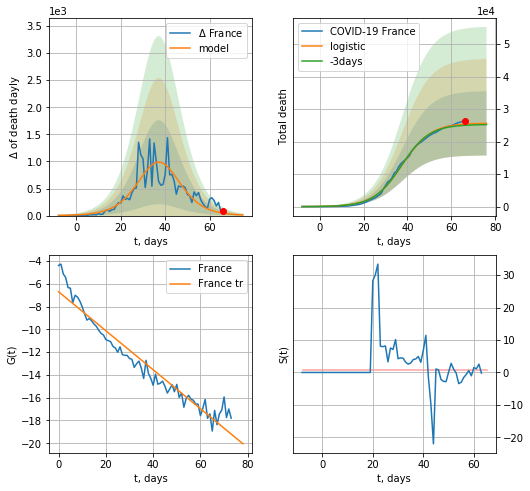

France data at: 2020-05-09
+3 day model MAPE: 0.01456922731024436
model: logistic
coeffs:  [2.56904890e+04 1.53816677e-01 3.75853641e+01]
rational stdev:  0.38610871889204124
forecast at the end of period: +10 days
	 total death:  25620 ± 9892
trend coefficient of determination: 0.937304
 intercept: -6.703257
 slope: -0.171134


In [107]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*8-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


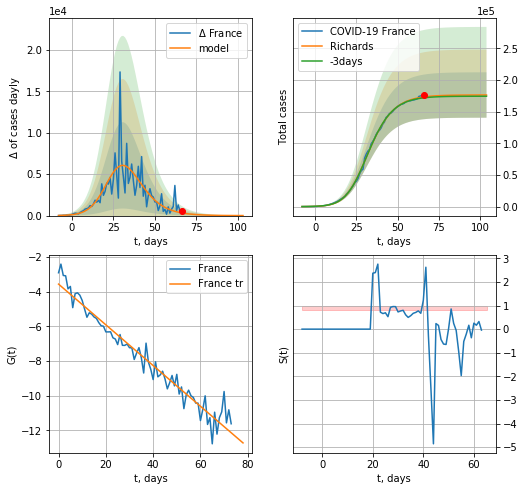

France data at: 2020-05-09
+3 day model MAPE: 0.008489
model: Richards
coeffs: [1.76408099e+05 2.36804916e-01 2.48768325e+01 4.88479409e-01]
rational stdev: 0.203334
forecast at the end of period: +38 days
	 deltaDaycases: 4
	 total cases: 176369 ± 35861
	 total death: 26267 ± 16022
trend coefficient of determination: 0.952325
 intercept: -3.571661
 slope: -0.117382


In [108]:
x = forecastRR('France',dfFR[10:],d1,12*7-dT-4,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


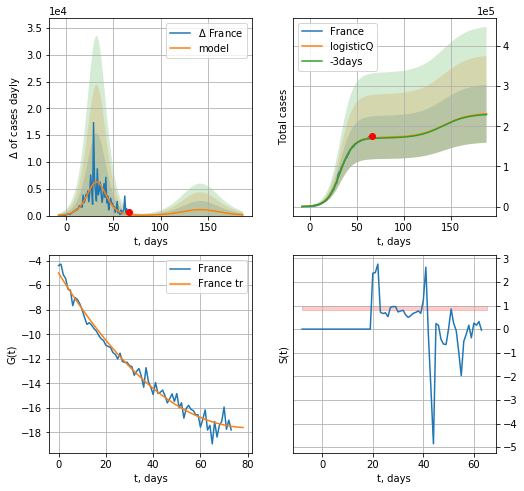

France data at: 2020-05-09
+3 day model MAPE: 0.009280
model: logisticQ
coeffs: [ 1.72295475e+05  1.79468193e-06  3.26773056e+01 -8.12751781e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.312074
forecast at the end of period: +122 days
	 deltaDaycases: 152
	 total cases: 231238 ± 72163
	 total death: 34438 ± 32241
trend coefficient of determination: 0.981095
 intercept_: -5.008680078259415
 coeffs_: [ 0.         -0.31236781  0.00193483]


In [109]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


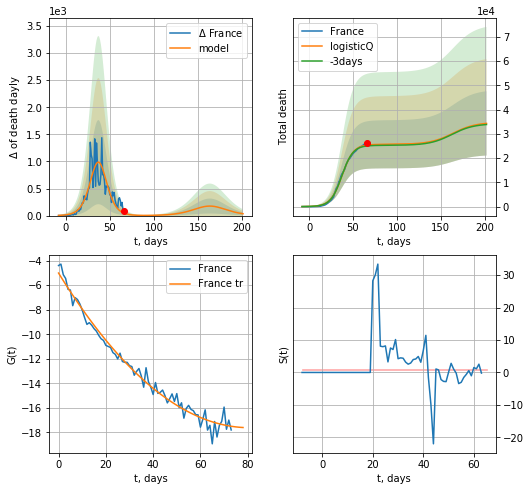

France data at: 2020-05-09
+3 day model MAPE: 0.014605
model: logisticQ
coeffs: [ 2.56894118e+04  1.55601117e-06  3.75852284e+01 -9.87996316e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.386247
forecast at the end of period: +136 days
	 total death: 34336 ± 13262
trend coefficient of determination: 0.981095
 intercept_: -5.008680078259415
 coeffs_: [ 0.         -0.31236781  0.00193483]


In [110]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [111]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [112]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


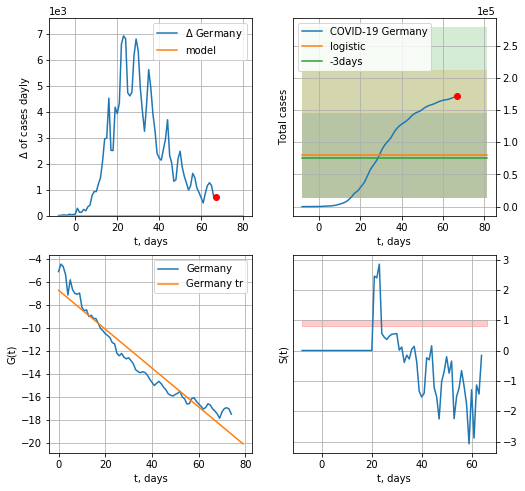

Germany data at: 2020-05-09
+3 day model MAPE: 0.049314042136090655
model: logistic
coeffs:  [ 7.95152500e+04 -3.58373910e+00  1.14849498e+02]
rational stdev:  0.8360262923331142
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  79515 ± 66476
	 total death:  3503 ± 8785
trend coefficient of determination: 0.929380
 intercept: -6.715865
 slope: -0.169135


In [113]:
x = forecast('Germany',dfGR[:],d1,7*8-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


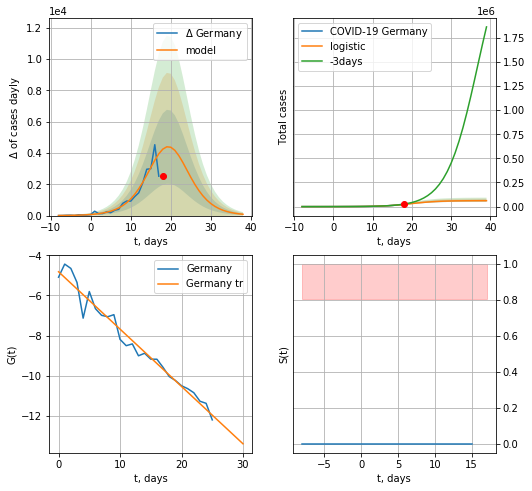

Germany data at: 2020-05-09
+3 day model MAPE: 0.18319320379671997
model: logistic
coeffs:  [6.16394025e+04 2.86275294e-01 1.98444846e+01]
rational stdev:  0.17054836328949527
forecast at the end of period: +21 days
	 deltaDaycases:  84
	 total cases:  61384 ± 10469
	 total death:  2704 ± 1383
trend coefficient of determination: 0.966826
 intercept: -4.817840
 slope: -0.285777


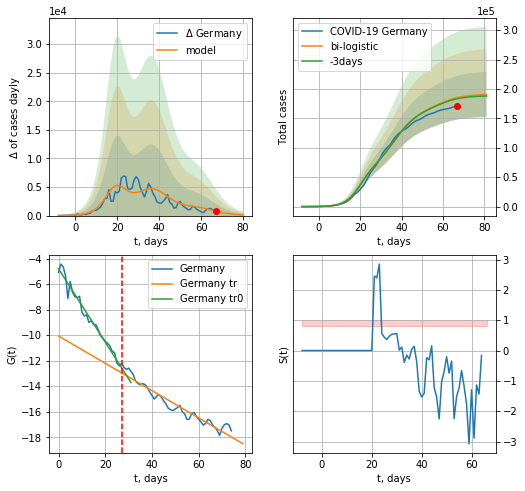

Germany data at: 2020-05-09
+3 day model MAPE: 0.010214823220872844
model: bi-logistic
coeffs:  [1.03615724e+05 1.73347111e-01 3.69932783e+01] [6.16394025e+04 2.86275294e-01 1.98444846e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.20104984909512355
forecast at the end of period: +14 days
	 deltaDaycases:  115
	 total cases:  190531 ± 38306
	 total death:  8395 ± 5063
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970373
 intercept: -4.806769
 slope: -0.287106
trend coefficient of determination: 0.930619
 intercept: -10.070503
 slope: -0.106889


In [114]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,9*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*8-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
          date   cases  active   death
71 2020-05-05  167007   24914  6993.5
72 2020-05-06  168162   20987  7275.0
73 2020-05-07  169430   20338  7392.0
74 2020-05-08  170588   19778  7510.0
75 2020-05-09  171324   20475  7549.0


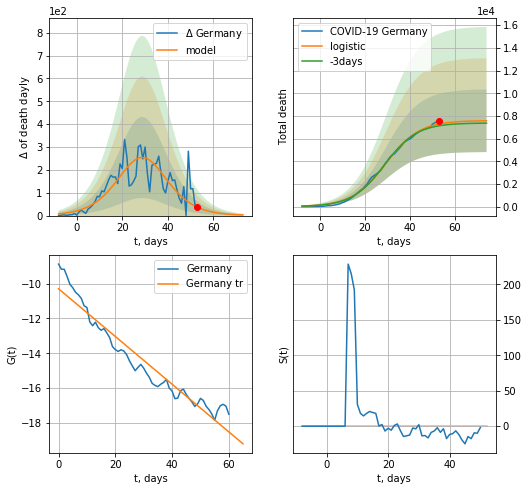

Germany data at: 2020-05-09
+3 day model MAPE: 0.02259275186761632
model: logistic
coeffs:  [7.59094998e+03 1.33901327e-01 2.92231518e+01]
rational stdev:  0.36446256997021687
forecast at the end of period: +21 days
	 total death:  7572 ± 2759
trend coefficient of determination: 0.928806
 intercept: -10.296181
 slope: -0.137021


In [115]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,9*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


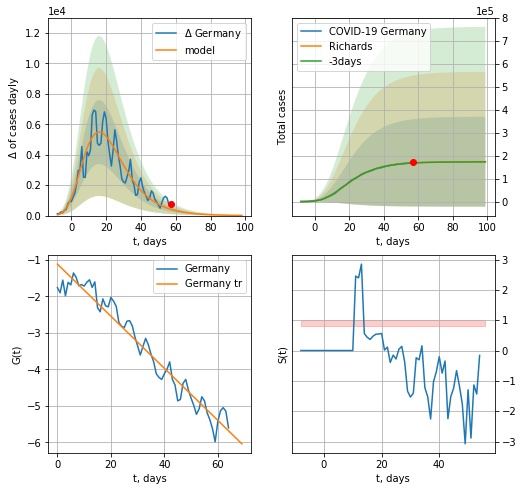

Germany data at: 2020-05-09
+3 day model MAPE: 0.004707
model: Richards
coeffs: [ 1.73857261e+05  6.72021540e+00 -3.38531056e+01  1.28650724e-02]
rational stdev: 1.124898
forecast at the end of period: +42 days
	 deltaDaycases: 12
	 total cases: 173718 ± 195415
	 total death: 7654 ± 25829
trend coefficient of determination: 0.948633
 intercept: -1.118314
 slope: -0.071343


In [116]:
x = forecastRR('Germany',dfGR[10:],d1,12*7-dT,1.0,addpred=False,xcoef=[0.25,1.,5.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


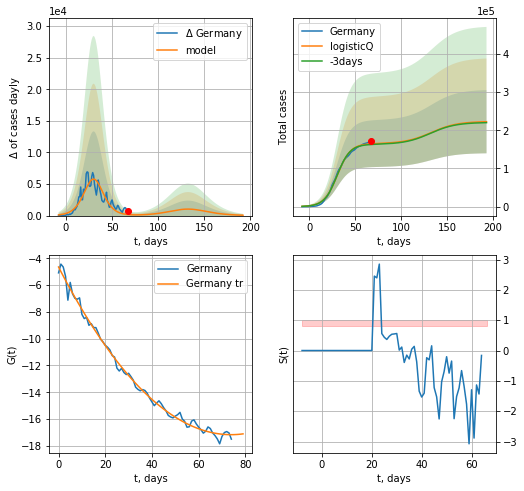

Germany data at: 2020-05-09
+3 day model MAPE: 0.011273
model: logisticQ
coeffs: [ 1.64881950e+05  8.86005097e-07  3.04607168e+01 -1.58274428e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.372127
forecast at the end of period: +126 days
	 deltaDaycases: 59
	 total cases: 222456 ± 82782
	 total death: 9802 ± 10942
trend coefficient of determination: 0.993407
 intercept_: -4.653222142035867
 coeffs_: [ 0.         -0.33868723  0.00229137]


In [117]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: invalid value encountered in true_divide


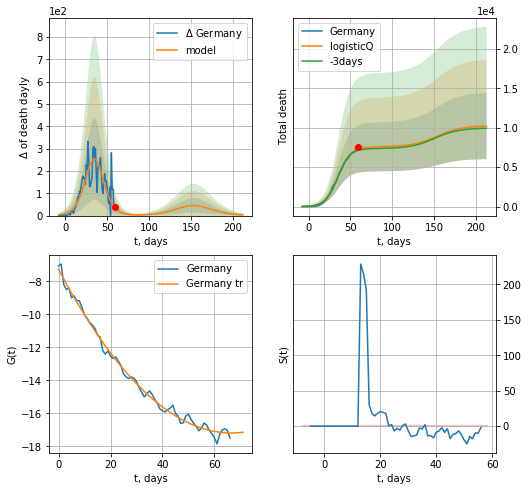

Germany data at: 2020-05-09
+3 day model MAPE: 0.022739
model: logisticQ
coeffs: [ 7.58012902e+03  2.02560691e-05  3.52042418e+01 -6.58242383e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.410573
forecast at the end of period: +154 days
	 total death: 10216 ± 4194
trend coefficient of determination: 0.992620
 intercept_: -7.272246041138411
 coeffs_: [ 0.         -0.29820315  0.00224065]


In [118]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

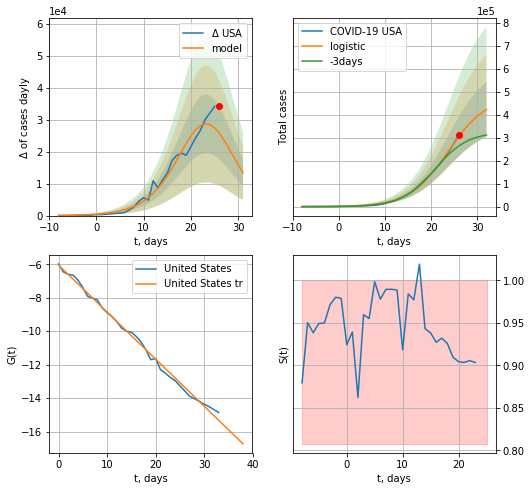

USA data at: 2020-05-09
+3 day model MAPE: 0.19535827238289116
model: logistic
coeffs:  [4.82026100e+05 2.38779089e-01 2.37021772e+01]
rational stdev:  0.2829911701138887
forecast at the end of period: +6 days
	 deltaDaycases:  13405
	 total cases:  423616 ± 119879
	 total death:  25164 ± 21363
trend coefficient of determination: 0.994973
 intercept: -6.048067
 slope: -0.281243


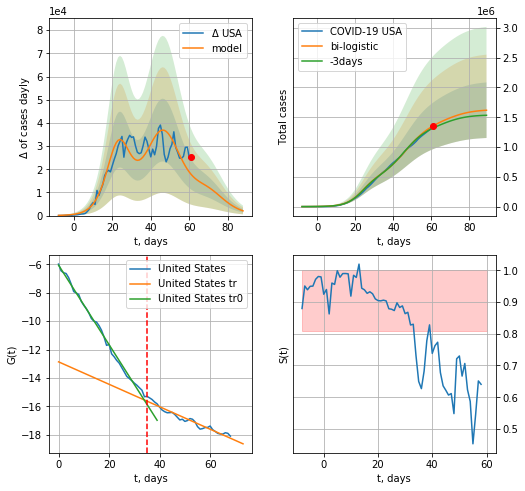

USA data at: 2020-05-09
+3 day model MAPE: 0.029598534727993866
model: bi-logistic
coeffs:  [9.18687538e+05 1.54752580e-01 4.66834722e+01] [4.82026100e+05 2.38779089e-01 2.37021772e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.2881340906538453
forecast at the end of period: +28 days
	 deltaDaycases:  2043
	 total cases:  1617500 ± 466056
	 total death:  96087 ± 83057
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995079
 intercept: -6.063262
 slope: -0.279862
trend coefficient of determination: 0.949823
 intercept: -12.866312
 slope: -0.079002


In [119]:
vL=35
x = forecast('USA',dfUS[:vL],d1,16*3-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,10*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

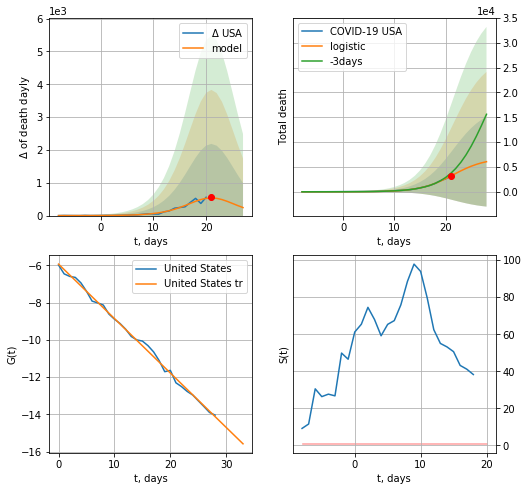

USA data at: 2020-05-09
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +7 days
	 total death:  6060 ± 9047
trend coefficient of determination: 0.996563
 intercept: -5.939898
 slope: -0.291951


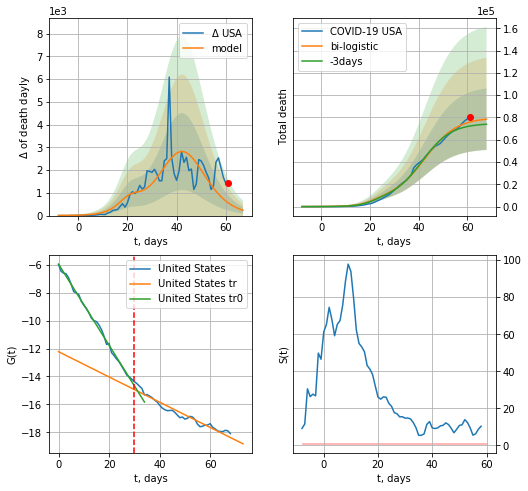

USA data at: 2020-05-09
+3 day model MAPE: 0.05183907129259657
model: bi-logistic
coeffs:  [7.30858160e+04 1.54149537e-01 4.27036013e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.35169187509567523
forecast at the end of period: +7 days
	 deltaDaydeath:  236
	 total death:  78468 ± 27596
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996662
 intercept: -5.952610
 slope: -0.290589
trend coefficient of determination: 0.941640
 intercept: -12.225353
 slope: -0.090396


In [120]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*7-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*7-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


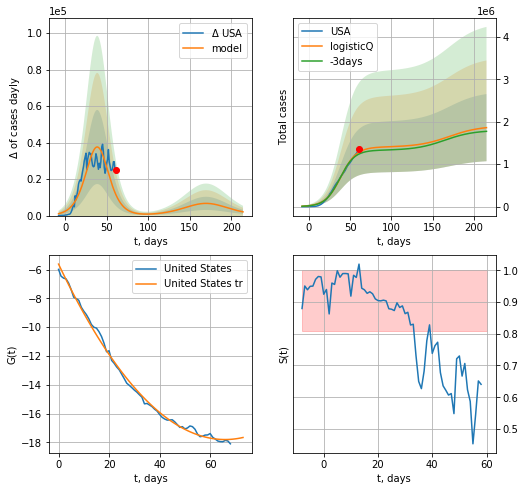

USA data at: 2020-05-09
+3 day model MAPE: 0.036518
model: logisticQ
coeffs: [ 1.40516053e+06  9.74627668e-07  3.89914549e+01 -1.09697012e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.425286
forecast at the end of period: +154 days
	 deltaDaycases: 2047
	 total cases: 1862322 ± 792019
	 total death: 110631 ± 141149
trend coefficient of determination: 0.996653
 intercept_: -5.6233803623755225
 coeffs_: [ 0.         -0.36953791  0.00280424]


In [121]:
x = forecastRRR('USA',dfUS[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


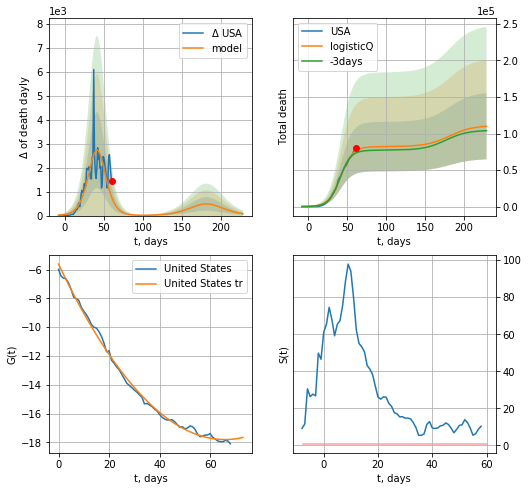

USA data at: 2020-05-09
+3 day model MAPE: 0.043424
model: logisticQ
coeffs: [ 8.20465630e+04  2.32687483e-06  4.16622045e+01 -5.72122599e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.412099
forecast at the end of period: +168 days
	 total death: 109940 ± 45306
trend coefficient of determination: 0.996653
 intercept_: -5.6233803623755225
 coeffs_: [ 0.         -0.36953791  0.00280424]


In [122]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


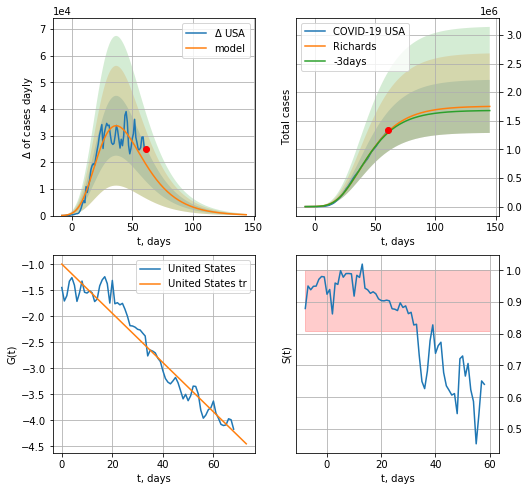

USA data at: 2020-05-09
+3 day model MAPE: 0.016119
model: Richards
coeffs: [ 1.75766251e+06  3.98804794e+00 -4.51517388e+01  1.31710496e-02]
rational stdev: 0.264588
forecast at the end of period: +84 days
	 deltaDaycases: 329
	 total cases: 1751541 ± 463436
	 total death: 104050 ± 82591
trend coefficient of determination: 0.936829
 intercept: -0.996999
 slope: -0.047284


In [123]:
x = forecastRR('USA',dfUS[:],d1,7*18-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


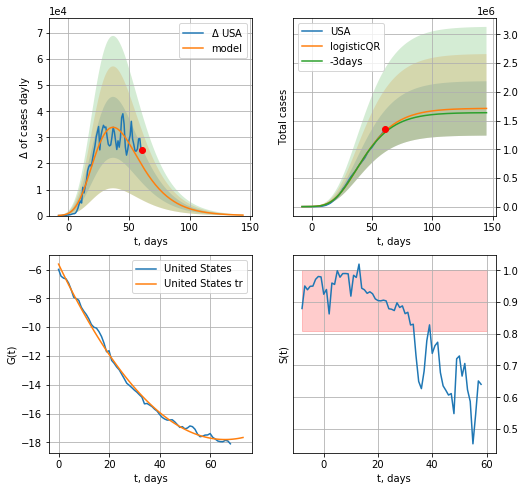

USA data at: 2020-05-09
+3 day model MAPE: 0.017313747515513653
model: logisticQR
coeffs:  [ 1.71387618e+06  1.79035432e-02 -8.68203170e+01 -8.91970807e+02
  2.85285182e-03]
rational stdev:  0.27685886152023376
forecast at the end of period: +84 days
	 deltaDaycases:  186
	 total cases:  1711083 ± 473728
	 total death:  101647 ± 84425
trend coefficient of determination: 0.996653
 intercept_: -5.6233803623755225
 coeffs_: [ 0.         -0.36953791  0.00280424]


In [124]:
x = forecastQR('USA',dfUS[:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
          date   cases  active    death
69 2020-05-05  194990  165219  29427.0
70 2020-05-06  201101  170681  30076.0
71 2020-05-07  206715  175756  30615.0
72 2020-05-08  211364  179779  31241.0
73 2020-05-09  215260  183329  31587.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


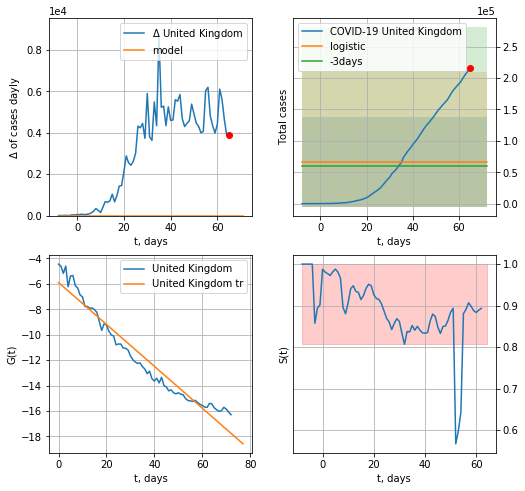

United Kingdom data at: 2020-05-09
+3 day model MAPE: 0.10044337577893607
model: logistic
coeffs:  [ 6.68040271e+04 -4.59088118e+00  1.29792117e+02]
rational stdev:  1.0709841077399747
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  66804 ± 71546
	 total death:  9802 ± 31493
trend coefficient of determination: 0.946051
 intercept: -5.893228
 slope: -0.164722


In [126]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,7*7-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


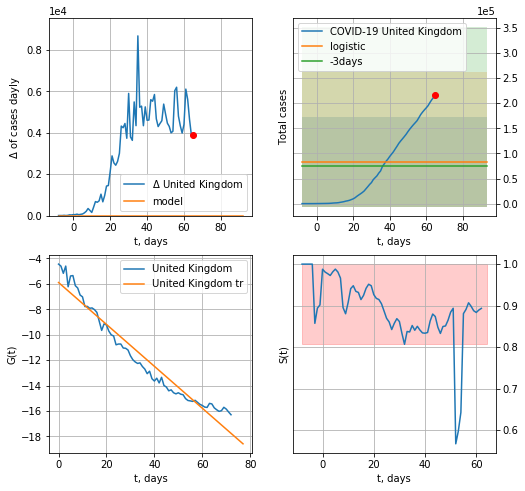

United Kingdom data at: 2020-05-09
+3 day model MAPE: 0.10044337577893607
model: logistic
coeffs:  [ 6.68040271e+04 -4.59088118e+00  1.29792117e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.0709841077399747
forecast at the end of period: +28 days
	 deltaDaycases:  0
	 total cases:  83505 ± 89432
	 total death:  12253 ± 39368
trend coefficient of determination: 0.946051
 intercept: -5.893228
 slope: -0.164722


In [127]:
x = forecast('United Kingdom',dfGB[:],d1,10*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:131: RuntimeWarning: divide by zero encountered in true_divide


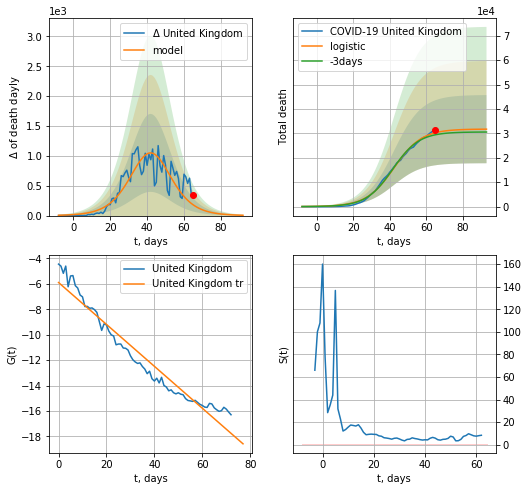

United Kingdom data at: 2020-05-09
+3 day model MAPE: 0.0291664614443551
model: logistic
coeffs:  [3.17694658e+04 1.32285079e-01 4.23769597e+01]
rational stdev:  0.44009528018795396
forecast at the end of period: +28 days
	 total death:  31730 ± 13964
trend coefficient of determination: 0.946051
 intercept: -5.893228
 slope: -0.164722


In [128]:
x = forecast('United Kingdom',dfGB[:],d1,10*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


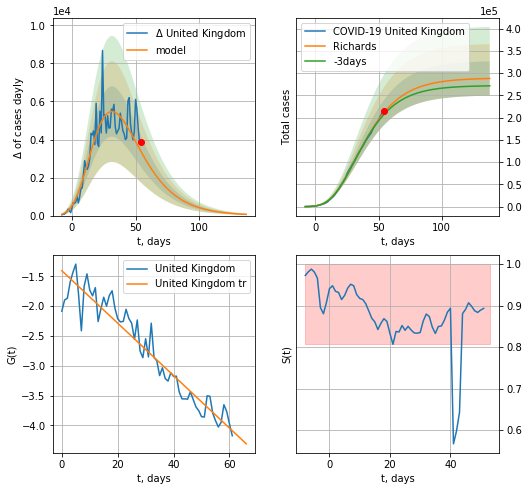

United Kingdom data at: 2020-05-09
+3 day model MAPE: 0.021010
model: Richards
coeffs: [ 2.89306055e+05  3.94412308e+00 -5.17875340e+01  1.31254551e-02]
rational stdev: 0.134080
forecast at the end of period: +84 days
	 deltaDaycases: 63
	 total cases: 288116 ± 38630
	 total death: 42277 ± 17005
trend coefficient of determination: 0.912962
 intercept: -1.407007
 slope: -0.043972


In [130]:
x = forecastRR('United Kingdom',dfGB[11:],d1,18*7-dT,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


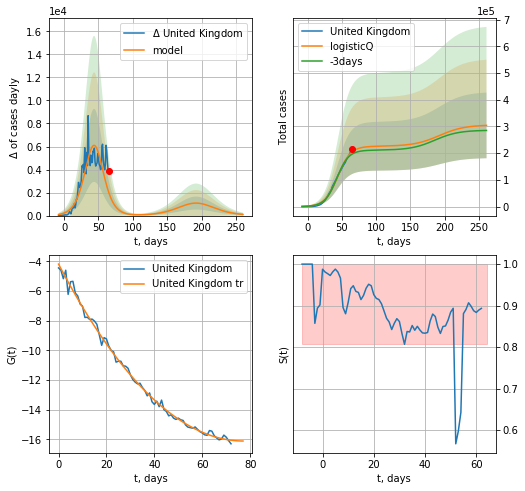

United Kingdom data at: 2020-05-09
+3 day model MAPE: 0.043447
model: logisticQ
coeffs: [ 2.25888343e+05  1.21765992e-06  4.40826557e+01 -8.86843293e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.404272
forecast at the end of period: +196 days
	 deltaDaycases: 100
	 total cases: 304038 ± 122914
	 total death: 44614 ± 54108
trend coefficient of determination: 0.995630
 intercept_: -4.190041607703359
 coeffs_: [ 0.         -0.30867313  0.00199945]


In [132]:
x = forecastRRR('United Kingdom',dfGB[:],d1,34*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: divide by zero encountered in true_divide


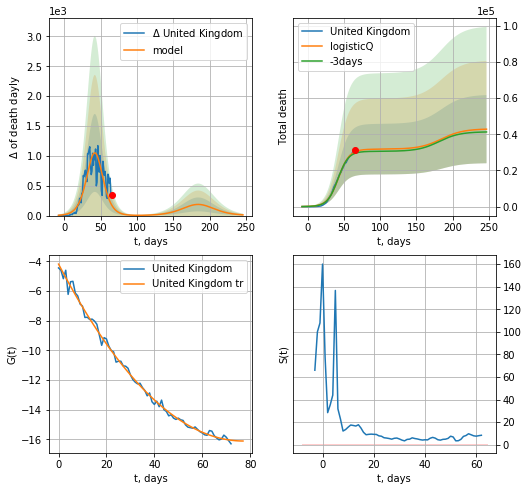

United Kingdom data at: 2020-05-09
+3 day model MAPE: 0.029209
model: logisticQ
coeffs: [ 3.17664556e+04  1.43373586e-06  4.23757458e+01 -9.22040323e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.440125
forecast at the end of period: +182 days
	 total death: 42841 ± 18855
trend coefficient of determination: 0.995630
 intercept_: -4.190041607703359
 coeffs_: [ 0.         -0.30867313  0.00199945]


In [133]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [134]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [169]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [170]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [171]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [172]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [134]:
dT

42

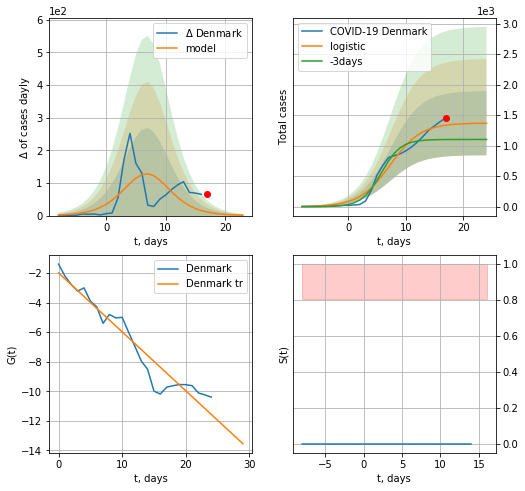

Denmark data at: 2020-05-09
+3 day model MAPE: 0.22309164372685597
model: logistic
coeffs:  [1.36966073e+03 3.75718860e-01 7.30059729e+00]
rational stdev:  0.38476605910227335
forecast at the end of period: +7 days
	 deltaDaycases:  1
	 total cases:  1367 ± 526
	 total death:  69 ± 79
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


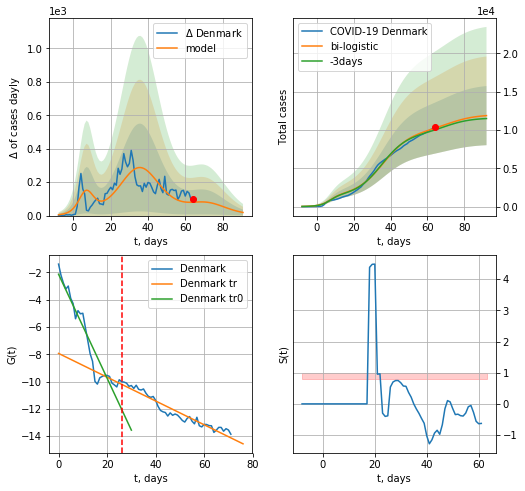

Denmark data at: 2020-05-09
+3 day model MAPE: 0.02272158401828737
model: bi-logistic
coeffs:  [8.51058885e+03 1.34221221e-01 3.59711488e+01] [1.36966073e+03 3.75718860e-01 7.30059729e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.32496453228757693
forecast at the end of period: +28 days
	 deltaDaycases:  18
	 total cases:  11868 ± 3856
	 total death:  604 ± 588
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.929969
 intercept: -7.937503
 slope: -0.087279


In [136]:
vL = 26
x = forecast('Denmark',dfDK[:vL],d1,7*7-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,10*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


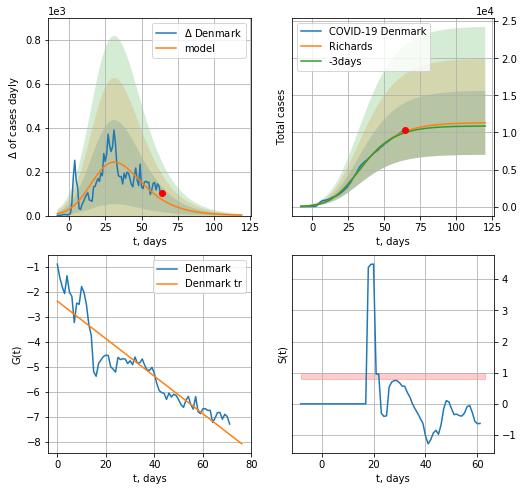

Denmark data at: 2020-05-09
+3 day model MAPE: 0.016869
model: Richards
coeffs: [1.13245732e+04 2.31836894e-01 1.30862364e+01 2.88159650e-01]
rational stdev: 0.381731
forecast at the end of period: +56 days
	 deltaDaycases: 2
	 total cases: 11293 ± 4311
	 total death: 575 ± 658
trend coefficient of determination: 0.858550
 intercept: -2.372446
 slope: -0.075088


In [137]:
x = forecastRR('Denmark',dfDK[:],d1,14*7-dT,1.0)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp


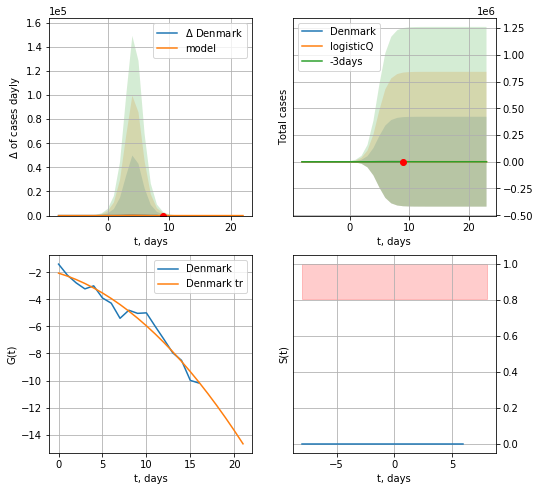

Denmark data at: 2020-05-09
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 862 ± 420260
	 total death: 43 ± 62857
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


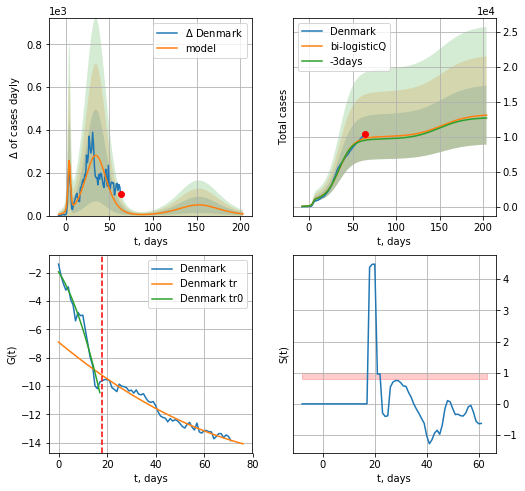

Denmark data at: 2020-05-09
+3 day model MAPE: 0.028160
model: bi-logisticQ
coeffs: [ 9.10814018e+03  7.83710104e-07  3.50454288e+01 -1.57655471e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.321775
forecast at the end of period: +140 days
	 deltaDaycases: 7
	 total cases: 13068 ± 4205
	 total death: 666 ± 642
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.960870
 intercept_: -6.895688006361719
 coeffs_: [ 0.         -0.14209941  0.00062478]


In [138]:
x = forecastRRR('Denmark',dfDK[:18],d1,8*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
          date  cases  active  death
69 2020-05-05   7955    7708  215.0
70 2020-05-06   7996    7748  216.0
71 2020-05-07   8034    7785  217.0
72 2020-05-08   8070    7820  218.0
73 2020-05-09   8099    7848  219.0


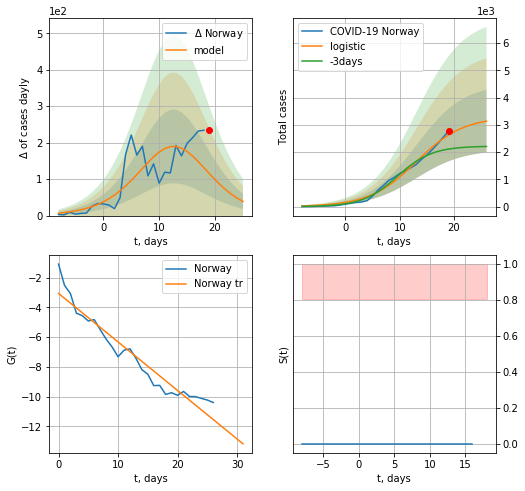

Norway data at: 2020-05-09
+3 day model MAPE: 0.2814819001616187
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.3674391911615601
forecast at the end of period: +7 days
	 deltaDaycases:  38
	 total cases:  3138 ± 1153
	 total death:  84 ± 92
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


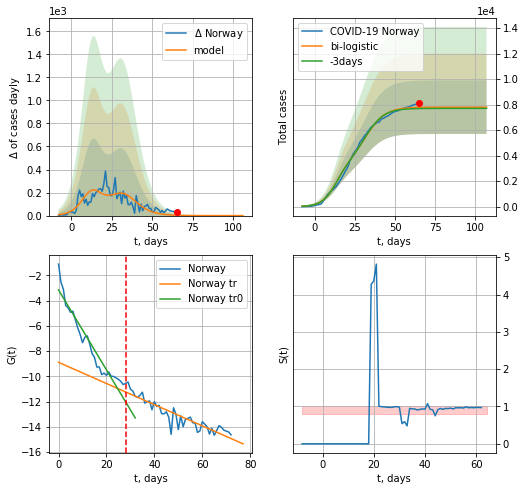

Norway data at: 2020-05-09
+3 day model MAPE: 0.011478152445842403
model: bi-logistic
coeffs:  [4.50094230e+03 1.63999273e-01 3.18782971e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.2691427105639106
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  7798 ± 2099
	 total death:  210 ± 169
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.834016
 intercept: -8.886587
 slope: -0.083907


In [140]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,12*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

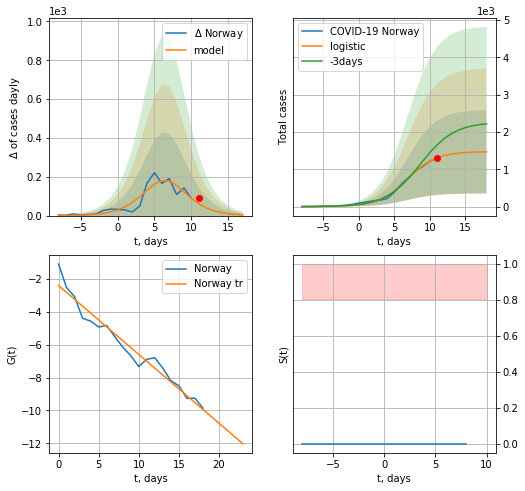

Norway data at: 2020-05-09
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +7 days
	 deltaDaycases:  3
	 total cases:  1468 ± 1115
	 total death:  39 ± 88
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


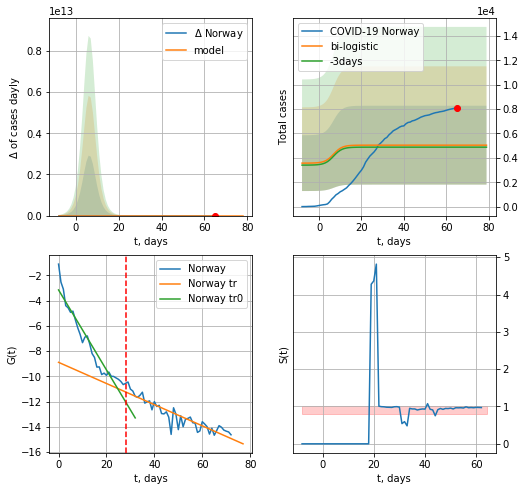

Norway data at: 2020-05-09
+3 day model MAPE: 0.03334122841932956
model: bi-logistic
coeffs:  [ 3.17066631e+03 -2.44438487e+00  1.08888807e+02] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.6416945000484237
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  5041 ± 3235
	 total death:  136 ± 261
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.834016
 intercept: -8.886587
 slope: -0.083907


In [142]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,8*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


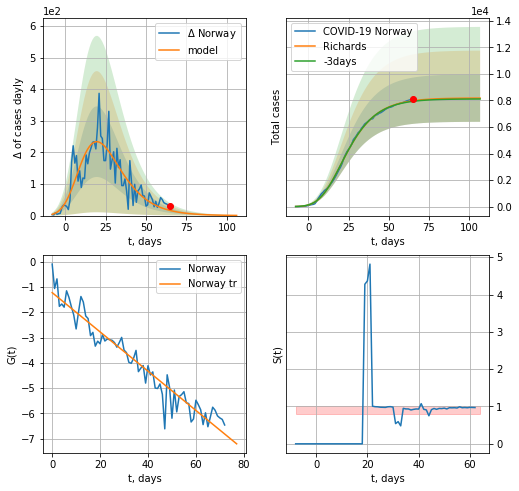

Norway data at: 2020-05-09
+3 day model MAPE: 0.005798
model: Richards
coeffs: [ 8.18597327e+03  8.87865963e-01 -9.40391573e+00  9.15144357e-02]
rational stdev: 0.218633
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 8178 ± 1788
	 total death: 221 ± 144
trend coefficient of determination: 0.930230
 intercept: -1.226921
 slope: -0.077563


In [143]:
x = forecastRR('Norway',dfNG[:],d1,12*7-dT,1.0)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


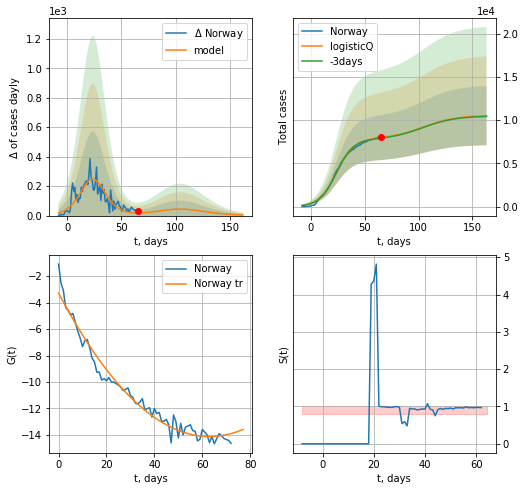

Norway data at: 2020-05-09
+3 day model MAPE: 0.008737
model: logisticQ
coeffs: [ 7.81050415e+03  9.14479551e-07  2.39580297e+01 -1.38373244e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.325297
forecast at the end of period: +98 days
	 deltaDaycases: 4
	 total cases: 10511 ± 3419
	 total death: 284 ± 277
trend coefficient of determination: 0.970363
 intercept_: -3.279803788506335
 coeffs_: [ 0.         -0.3439198   0.00272888]


In [144]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

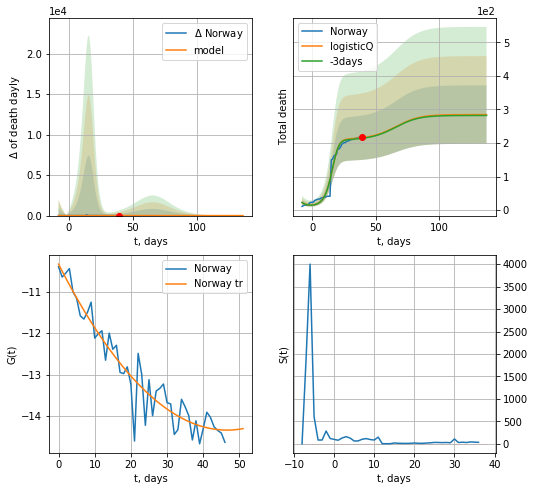

Norway data at: 2020-05-09
+3 day model MAPE: 0.008987
model: logisticQ
coeffs: [ 2.10149646e+02  9.86480570e-03  1.49255455e+01 -1.74668935e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.306258
forecast at the end of period: +98 days
	 total death: 284 ± 87
trend coefficient of determination: 0.910215
 intercept_: -10.338069679699577
 coeffs_: [ 0.         -0.17167675  0.00184216]


In [145]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

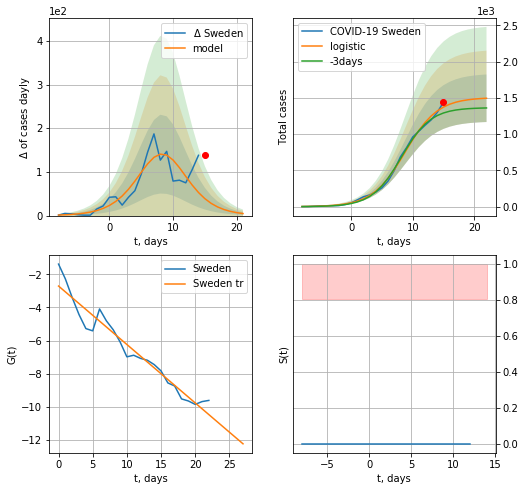

Sweden data at: 2020-05-09
+3 day model MAPE: 0.0730548600677782
model: logistic
coeffs:  [1.50473584e+03 3.76040161e-01 8.77120622e+00]
rational stdev:  0.21926973222081286
forecast at the end of period: +7 days
	 deltaDaycases:  4
	 total cases:  1494 ± 327
	 total death:  185 ± 121
trend coefficient of determination: 0.941971
 intercept: -2.710792
 slope: -0.352814


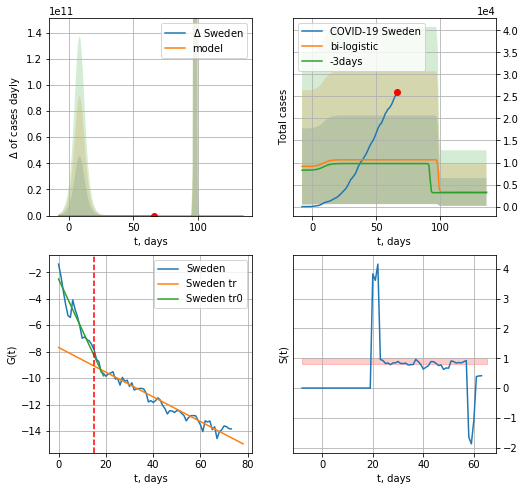

Sweden data at: 2020-05-09
+3 day model MAPE: 0.08786088721473283
model: bi-logistic
coeffs:  [ 7.29372564e+03 -3.41150676e+00  9.84299921e+01] [1.50473584e+03 3.76040161e-01 8.77120622e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.9455563223454991
forecast at the end of period: +70 days
	 deltaDaycases:  0
	 total cases:  3328 ± 3146
	 total death:  413 ± 1171
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.870123
 intercept: -2.515075
 slope: -0.384868
trend coefficient of determination: 0.948038
 intercept: -7.683567
 slope: -0.093331


In [147]:
vL = 15#len(dfSW)-12-dT
x = forecast('Sweden',dfSW[:-9-dT],d1,7*7-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
          date  cases  active   death
70 2020-05-05  23216   16288  2854.0
71 2020-05-06  23918   16903  2941.0
72 2020-05-07  24623   16612  3040.0
73 2020-05-08  25265   17119  3175.0
74 2020-05-09  25921   17730  3220.0


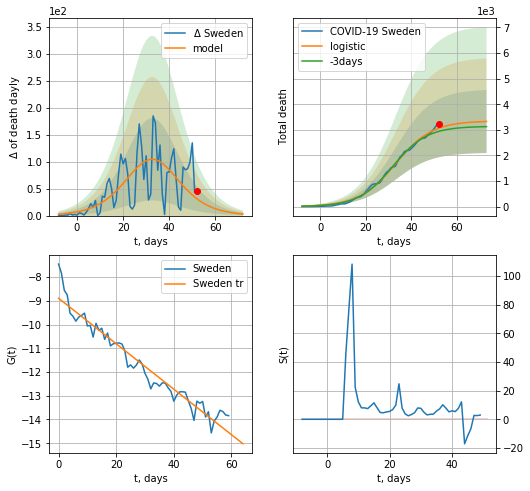

Sweden data at: 2020-05-09
+3 day model MAPE: 0.04405697710969114
model: logistic
coeffs:  [3.34847896e+03 1.24900107e-01 3.30798473e+01]
rational stdev:  0.3703565236230068
forecast at the end of period: +21 days
	 total death:  3325 ± 1231
trend coefficient of determination: 0.940927
 intercept: -8.890207
 slope: -0.095852


In [148]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


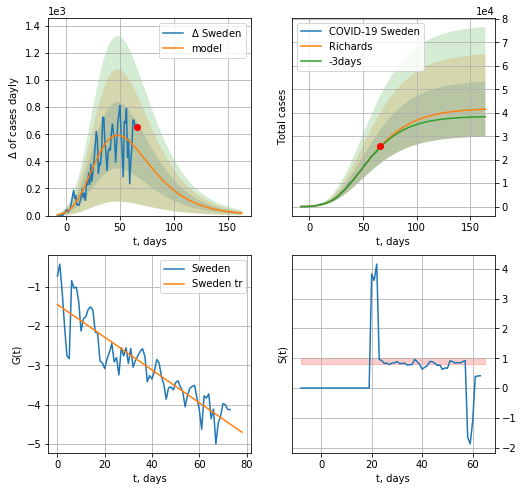

Sweden data at: 2020-05-09
+3 day model MAPE: 0.012127
model: Richards
coeffs: [ 4.19811358e+04  8.90047854e-01 -3.13862226e+01  4.40227403e-02]
rational stdev: 0.281432
forecast at the end of period: +98 days
	 deltaDaycases: 17
	 total cases: 41532 ± 11688
	 total death: 5159 ± 4355
trend coefficient of determination: 0.808700
 intercept: -1.449436
 slope: -0.041655


In [149]:
x = forecastRR('Sweden',dfSW[:],d1,20*7-dT,1.0)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


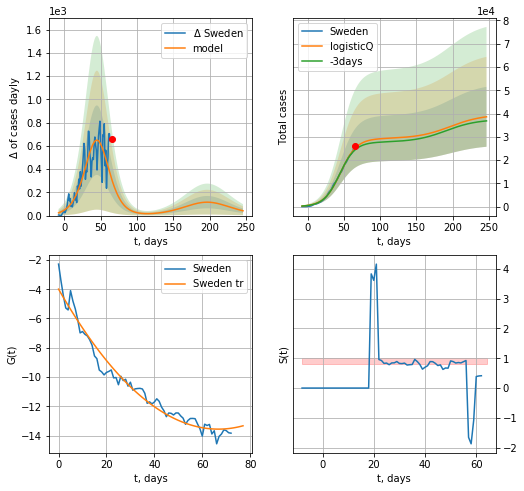

Sweden data at: 2020-05-09
+3 day model MAPE: 0.028915
model: logisticQ
coeffs: [ 2.92415769e+04  1.51170875e-06  4.52134684e+01 -5.86223935e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.333700
forecast at the end of period: +182 days
	 deltaDaycases: 41
	 total cases: 38589 ± 12877
	 total death: 4793 ± 4798
trend coefficient of determination: 0.967741
 intercept_: -3.9928488246108866
 coeffs_: [ 0.         -0.28695985  0.00215116]


In [150]:
x = forecastRRR('Sweden',dfSW[1:],d1,32*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: invalid value encountered in true_divide


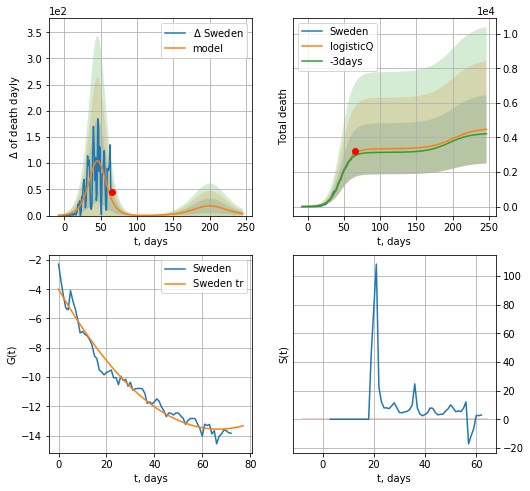

Sweden data at: 2020-05-09
+3 day model MAPE: 0.044105
model: logisticQ
coeffs: [ 3.34589942e+03  2.23763201e-06  4.60651065e+01 -5.58404390e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.441582
forecast at the end of period: +182 days
	 total death: 4469 ± 1973
trend coefficient of determination: 0.967741
 intercept_: -3.9928488246108866
 coeffs_: [ 0.         -0.28695985  0.00215116]


In [151]:
x = forecastRRR('Sweden',dfSW[1:],d1,32*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

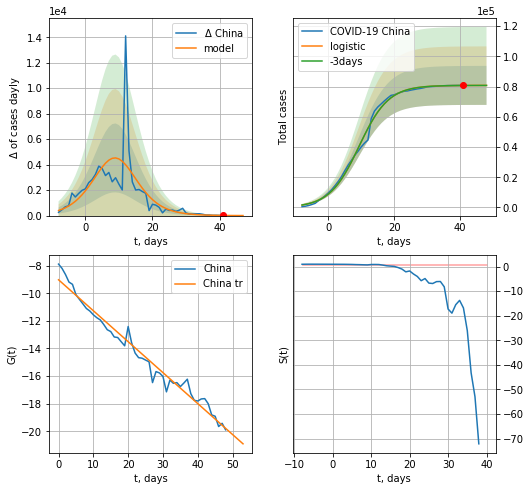

China data at: 2020-05-09
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +7 days
	 deltaDaycases:  3
	 total cases:  80796 ± 12904
	 total death:  4515 ± 2163
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


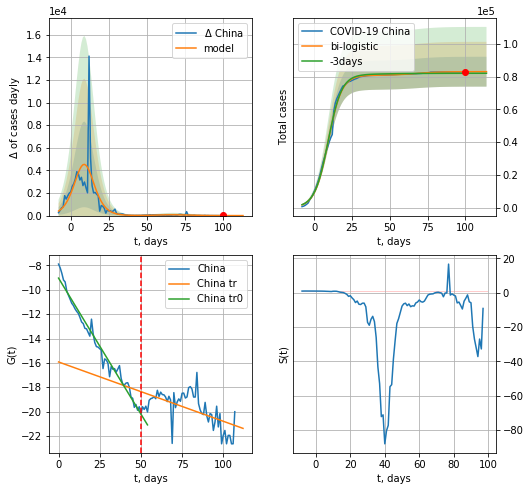

China data at: 2020-05-09
+3 day model MAPE: 0.011595560875797925
model: bi-logistic
coeffs:  [2.17321356e+03 1.28532016e-01 6.76246098e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.10989497221880677
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  82977 ± 9118
	 total death:  4637 ± 1528
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.347984
 intercept: -15.925488
 slope: -0.048716


In [153]:
x = forecast('China',dfCN[:50],d1,7*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
xx = forecast2('China',dfCN[:],d1,8*7-dT,x,1.0,vL=50)

In [154]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

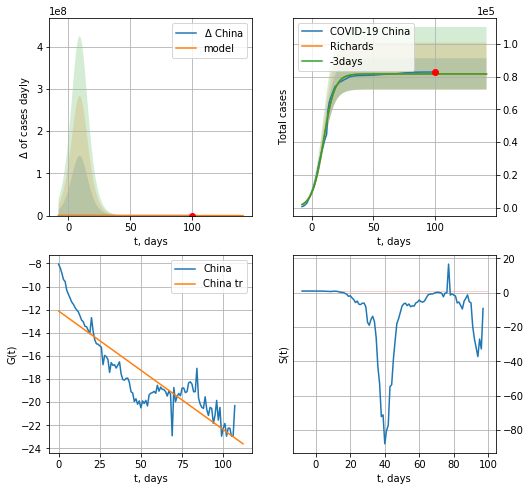

China data at: 2020-05-09
+3 day model MAPE: 0.000639
model: Richards
coeffs: [8.17568036e+04 2.15121365e-01 9.61998368e+00 1.02528169e+00]
rational stdev: 0.117155
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 81756 ± 9578
	 total death: 4569 ± 1605
trend coefficient of determination: 0.790660
 intercept: -12.111000
 slope: -0.102579


In [155]:
x = forecastRR('China',dfCN[:],d1,12*7-dT,1.0)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

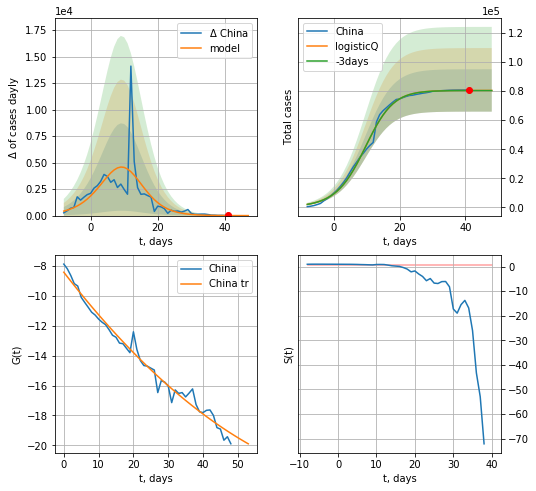

China data at: 2020-05-09
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 80415 ± 14556
	 total death: 4494 ± 2440
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


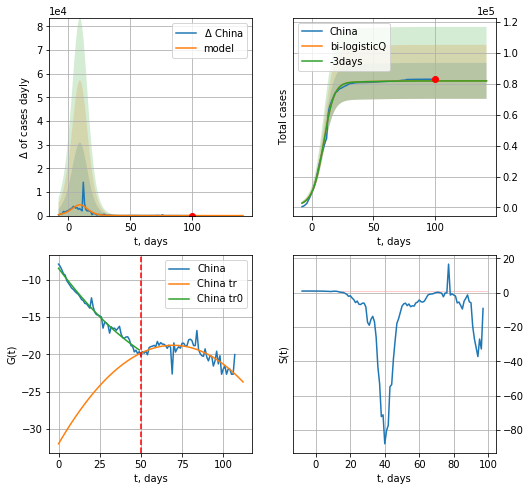

China data at: 2020-05-09
+3 day model MAPE: 0.000759
model: bi-logisticQ
coeffs: [ 1.43638923e+03  7.55374101e-04  2.50506877e+01 -1.67813058e-02]
rational stdev: 0.141952
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 81853 ± 11619
	 total death: 4574 ± 1947
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.595464
 intercept_: -31.973669959248927
 coeffs_: [ 0.          0.37966089 -0.00272867]


In [157]:
x = forecastRRR('China',dfCN[:50],d1,7*7-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,12*7-dT,x,1.0,vL=50)

In [158]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
          date  cases  active  death
80 2020-05-05  10806  1218.0  255.0
81 2020-05-06  10810  1135.0  256.0
82 2020-05-07  10822  1082.0  256.0
83 2020-05-08  10840  1016.0  256.0
84 2020-05-09  10874  1008.0  256.0


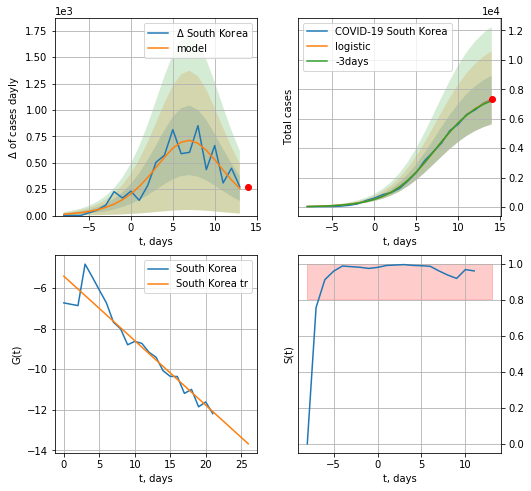

South Korea data at: 2020-05-09
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +0 days
	 deltaDaycases:  256
	 total cases:  7270 ± 1654
	 total death:  171 ± 116
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


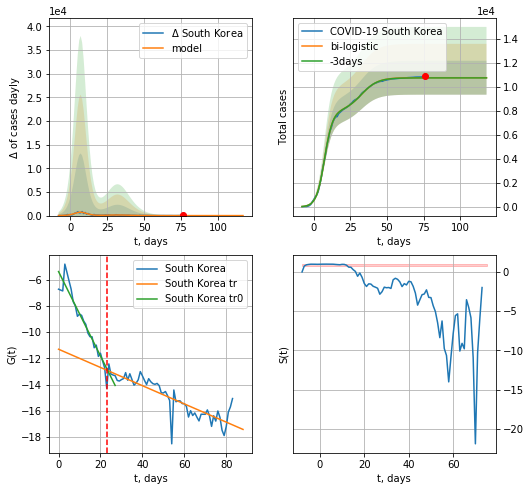

South Korea data at: 2020-05-09
+3 day model MAPE: 0.0013679674623830252
model: bi-logistic
coeffs:  [2.80590984e+03 1.78168266e-01 3.24959924e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.131078943982205
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  10747 ± 1408
	 total death:  253 ± 99
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.740528
 intercept: -11.306485
 slope: -0.069390


In [159]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,6*7-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,12*7-dT,x,1.0,vL=23)

In [160]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

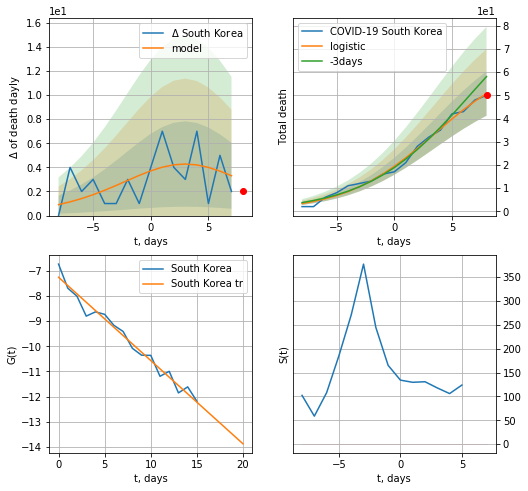

South Korea data at: 2020-05-09
model: logistic
coeffs:  [66.59757424  0.25734808  3.46382915]
rational stdev:  0.18867115045959354
forecast at the end of period: +0 days
	 total death:  50 ± 9
trend coefficient of determination: 0.972428
 intercept: -7.252219
 slope: -0.331355


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:244: RuntimeWarning: divide by zero encountered in true_divide


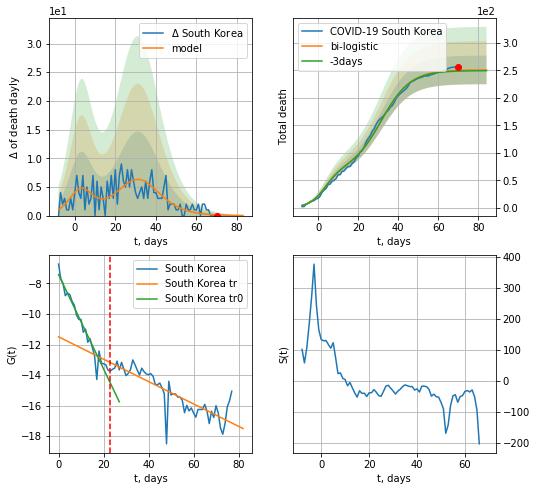

South Korea data at: 2020-05-09
+3 day model MAPE: 0.005812468856042266
model: bi-logistic
coeffs:  [1.84627360e+02 1.36519309e-01 3.16125892e+01] [66.59757424  0.25734808  3.46382915]
rational stdev:  0.10394416743990174
forecast at the end of period: +14 days
	 deltaDaydeath:  0
	 total death:  251 ± 26
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.950305
 intercept: -7.416817
 slope: -0.308862
trend coefficient of determination: 0.718880
 intercept: -11.494638
 slope: -0.073321


In [161]:
x = forecast('South Korea',dfKR[6:23],d1,6*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[6:],d1,8*7-dT,x,1.0,vL=23,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


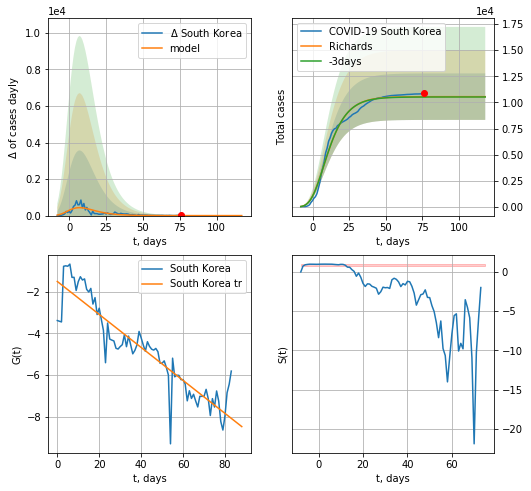

South Korea data at: 2020-05-09
+3 day model MAPE: 0.002924
model: Richards
coeffs: [ 1.05487152e+04  3.00107690e+01 -4.21306908e+01  3.74655135e-03]
rational stdev: 0.210884
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 10548 ± 2224
	 total death: 248 ± 156
trend coefficient of determination: 0.835148
 intercept: -1.507013
 slope: -0.079048


In [162]:
x = forecastRR('South Korea',dfKR[:],d1,12*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


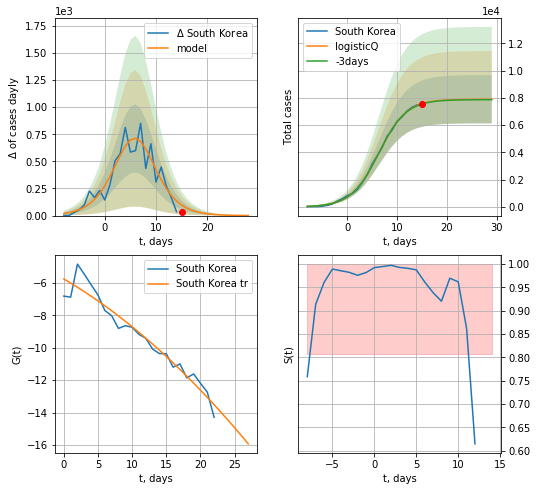

South Korea data at: 2020-05-09
+3 day model MAPE: 0.003444
model: logisticQ
coeffs: [ 7.90024888e+03  7.99722084e-05  6.33808286e+00 -4.52403663e+03]
rational stdev: 0.223765
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 7898 ± 1767
	 total death: 185 ± 124
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


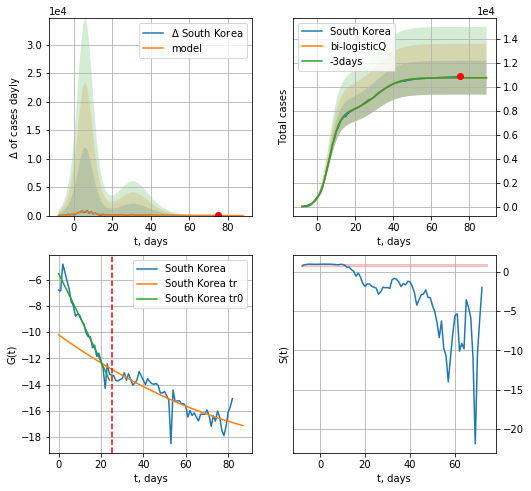

South Korea data at: 2020-05-09
+3 day model MAPE: 0.001345
model: bi-logisticQ
coeffs: [ 2.84903527e+03  1.55764813e-06  3.13018550e+01 -1.12257972e+05]
rational stdev: 0.130904
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 10749 ± 1407
	 total death: 253 ± 99
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.936575
 intercept_: -5.550309986859278
 coeffs_: [ 0.         -0.32029791 -0.00074495]
trend coefficient of determination: 0.742175
 intercept_: -10.212452475644078
 coeffs_: [ 0.         -0.11450291  0.00040333]


In [163]:
vL=25
x = forecastRRR('South Korea',dfKR[1:vL],d1,8*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,8*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


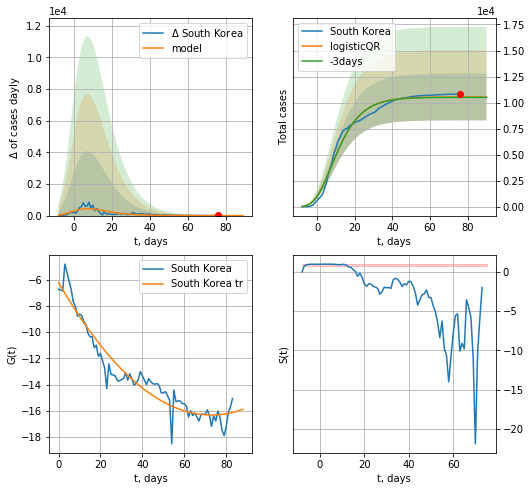

South Korea data at: 2020-05-09
+3 day model MAPE: 0.0029869407334787543
model: logisticQR
coeffs:  [ 1.05411825e+04  1.49272379e-01 -6.63503236e+01 -2.19328113e+03
  3.30147120e-04]
rational stdev:  0.21264450826754988
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  10540 ± 2241
	 total death:  248 ± 158
trend coefficient of determination: 0.924062
 intercept_: -6.228710159594449
 coeffs_: [ 0.         -0.27653468  0.0018957 ]


In [164]:
x = forecastQR('South Korea',dfKR[:],d1,8*7-dT,1.0)

SG
           date  cases  active  death
103 2020-05-05  19410   17873   18.0
104 2020-05-06  20198   18544   20.0
105 2020-05-07  20939   19207   20.0
106 2020-05-08  21707   19647   20.0
107 2020-05-09  22460   20144   20.0


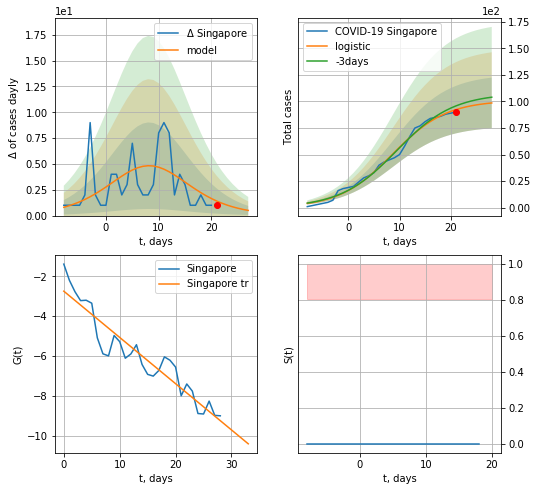

Singapore data at: 2020-05-09
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  98 ± 23
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


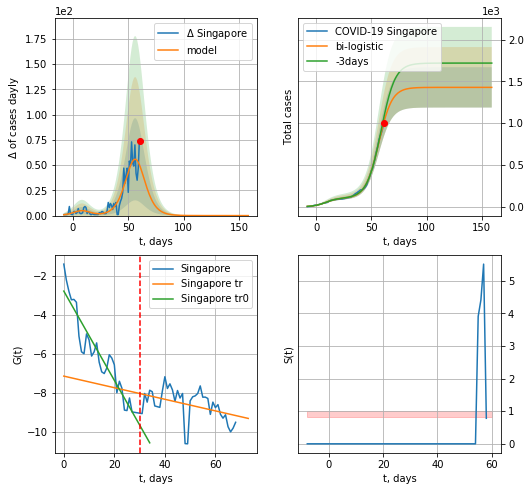

Singapore data at: 2020-05-09
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +98 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  1 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


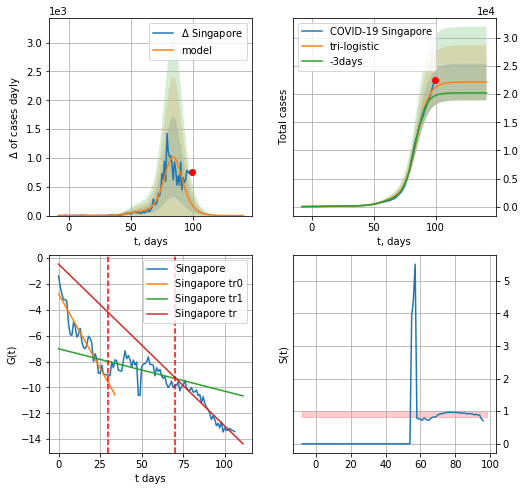

Singapore data at: 2020-05-09
+3 day model MAPE: 0.07322156181889129
model: tri-logistic
coeffs:  [2.07437770e+04 1.96238394e-01 8.44327693e+01] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.14733262958773255
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  22171 ± 3266
	 total death:  19 ± 8
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.930413
 intercept: -0.467251
 slope: -0.125119


In [166]:
vL = 30
vL1 = 70
dfSG = read_df(pd.DataFrame(),"SG")
x = forecast('Singapore',dfSG[:vL],d1,7*7-dT,1.0)
xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Singapore",dfSG,d1,12*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


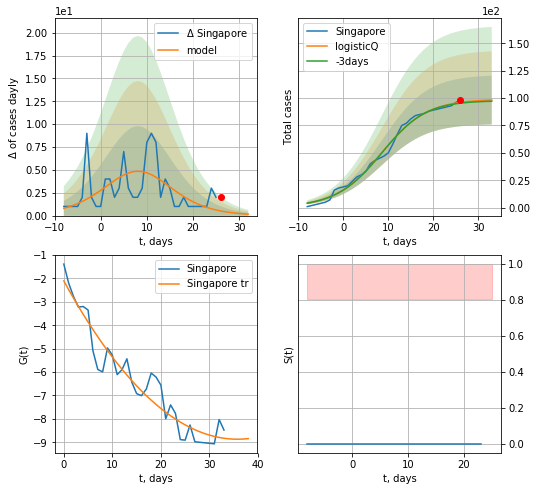

Singapore data at: 2020-05-09
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


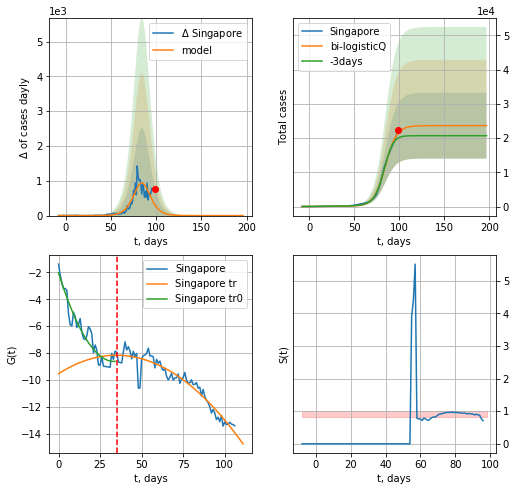

Singapore data at: 2020-05-09
+3 day model MAPE: 0.079027
model: bi-logisticQ
coeffs: [ 2.35408956e+04  2.95559332e-05  8.45595486e+01 -5.28621006e+03]
S.Korea scenario coeffs: [0.35, 0.5, 4.0, 1.0]
rational stdev: 0.406499
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 23639 ± 9609
	 total death: 21 ± 25
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.910187
 intercept_: -9.543338733314867
 coeffs_: [ 0.          0.07905278 -0.00113556]


In [168]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*7-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=[0.35,.5,4.,1.],vL=vL)

In [169]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


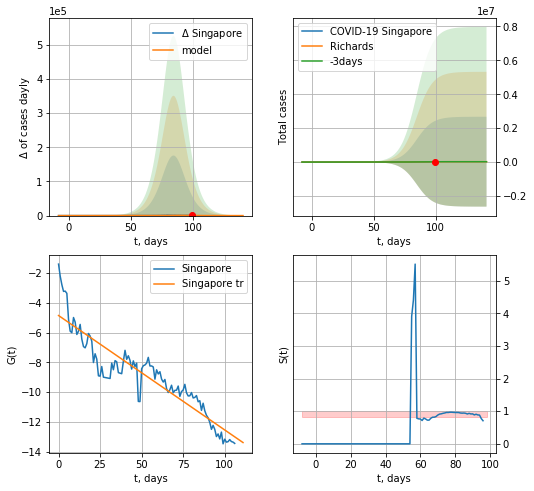

Singapore data at: 2020-05-09
+3 day model MAPE: 0.081744
model: Richards
coeffs: [2.39082927e+04 1.54256720e-01 8.46965380e+01 1.00304643e+00]
rational stdev: 110.806962
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 23904 ± 2648770
	 total death: 21 ± 6980
trend coefficient of determination: 0.841861
 intercept: -4.845405
 slope: -0.076954


In [170]:
x = forecastRR('Singapore',dfSG[:],d1,12*7-dT,1.0)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


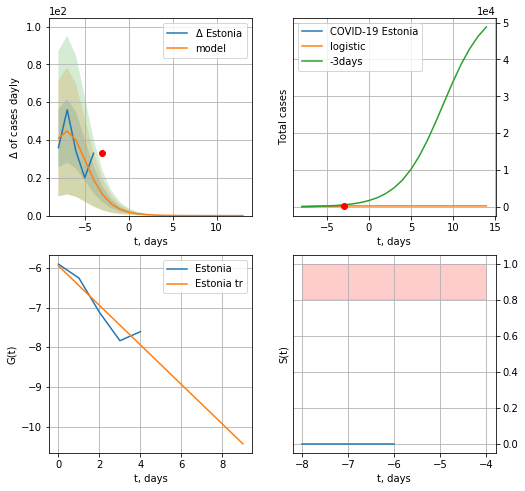

Estonia data at: 2020-05-09
+3 day model MAPE: 0.6707560476295664
model: logistic
coeffs:  [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.028784635346108894
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  9 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463


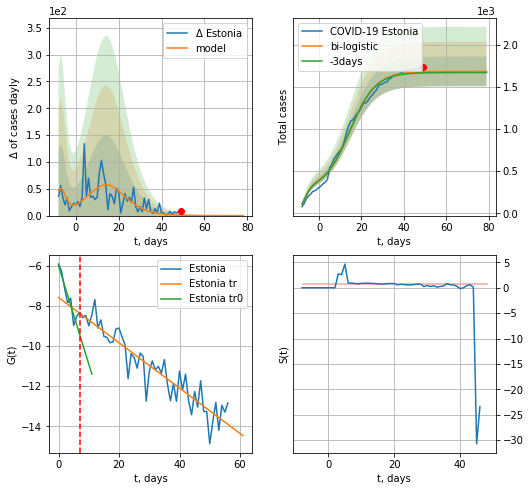

Estonia data at: 2020-05-09
+3 day model MAPE: 0.00794949922571111
model: bi-logistic
coeffs:  [1.40657882e+03 1.63389152e-01 1.46625029e+01] [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.10450535951945014
forecast at the end of period: +30 days
	 deltaDaycases:  0
	 total cases:  1684 ± 176
	 total death:  58 ± 18
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.894917
 intercept: -5.986038
 slope: -0.491580
trend coefficient of determination: 0.858851
 intercept: -7.571361
 slope: -0.113111


In [171]:
shift = 1.0
x = forecast('Estonia',dfES[1:7],d1,17,1.)
xx = forecast2('Estonia',dfES[1:],d1,12*6-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


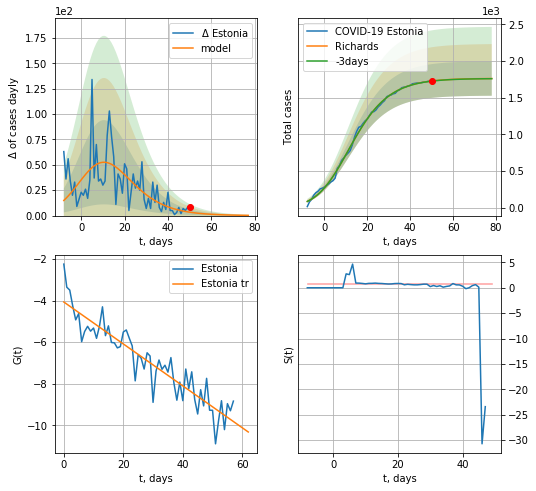

Estonia data at: 2020-05-09
+3 day model MAPE: 0.000915
model: Richards
coeffs: [1.76291375e+03 2.14374182e-01 3.20988091e+00 4.62755650e-01]
rational stdev: 0.133140
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 1760 ± 234
	 total death: 60 ± 23
trend coefficient of determination: 0.851605
 intercept: -4.067741
 slope: -0.100721


In [172]:
x = forecastRR('Estonia',dfES[:],d1,7*10-dT,1.)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
#xx = forecast2R('Estonia',dfES[:],d1,7*5-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


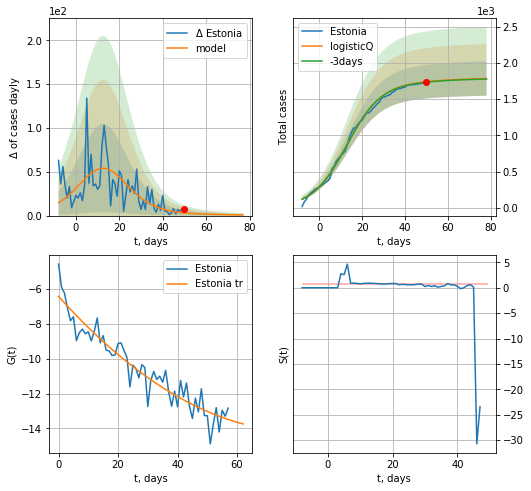

Estonia data at: 2020-05-09
+3 day model MAPE: 0.003753
model: logisticQ
coeffs: [ 1.72196364e+03  1.94748139e-06  1.29471571e+01 -6.40743568e+04]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.133104
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 1784 ± 237
	 total death: 61 ± 24
trend coefficient of determination: 0.897209
 intercept_: -6.439905695040058
 coeffs_: [ 0.         -0.18974353  0.00116186]


In [176]:
x = forecastRRR('Estonia',dfES[:],d1,7*10-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
          date  cases  active  death
59 2020-05-05  900.0     419   17.0
60 2020-05-06  909.0     427   18.0
61 2020-05-07  928.0     446   18.1
62 2020-05-08  930.0     448   18.2
63 2020-05-09  930.0     448   18.0


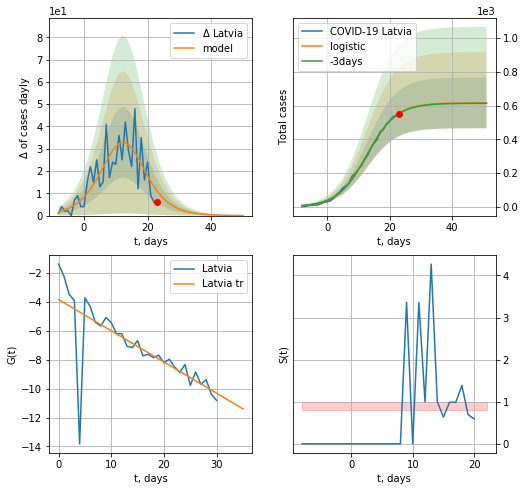

Latvia data at: 2020-05-09
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +28 days
	 deltaDaycases:  0
	 total cases:  615 ± 150
	 total death:  11 ± 8
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:478: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

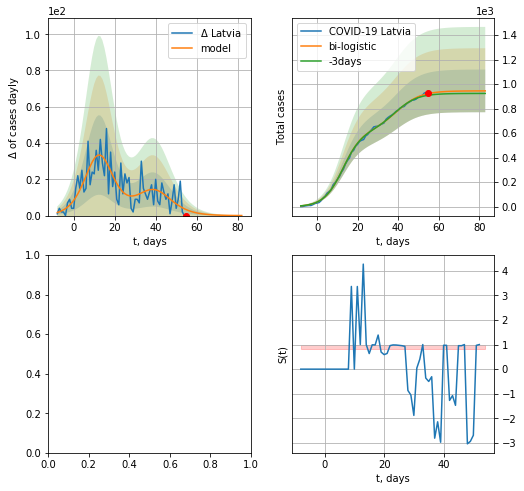

In [177]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
x = forecast('Latvia',dfLV[:vL],d1,10*7-dT,1.)
xx=forecast2('Latvia',dfLV[:],d1,10*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


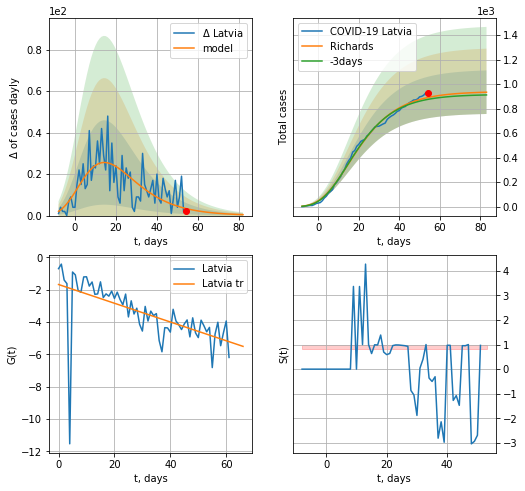

Latvia data at: 2020-05-08
+3 day model MAPE: 0.017658
model: Richards
coeffs: [ 9.39641901e+02  1.09971060e+01 -5.23980747e+01  6.76321435e-03]
rational stdev: 0.190106
forecast at the end of period: +29 days
	 deltaDaycases: 0
	 total cases: 933 ± 177
	 total death: 18 ± 10
trend coefficient of determination: 0.349116
 intercept: -1.678717
 slope: -0.057944


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


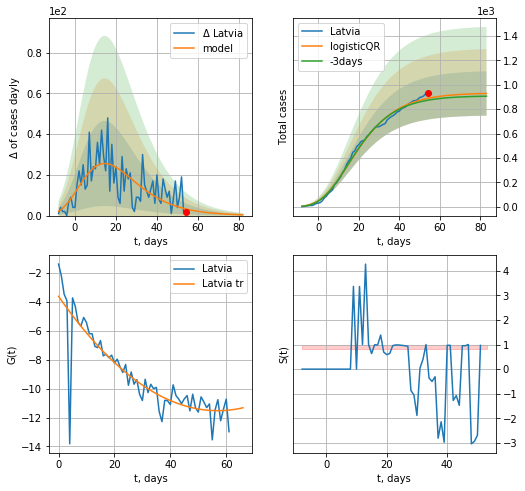

Latvia data at: 2020-05-08
+3 day model MAPE: 0.018047797933703112
model: logisticQR
coeffs:  [ 9.33603547e+02  4.33852989e-02 -8.17006140e+01 -1.26721492e+03
  1.24734565e-03]
rational stdev:  0.19589099613547012
forecast at the end of period: +29 days
	 deltaDaycases:  0
	 total cases:  929 ± 182
	 total death:  18 ± 10
trend coefficient of determination: 0.754835
 intercept_: -3.613337912229211
 coeffs_: [ 0.         -0.27781265  0.00243951]


In [416]:
x = forecastRR('Latvia',dfLV[:],d1,7*10-dT,1.)
x = forecastQR('Latvia',dfLV[:],d1,7*10-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


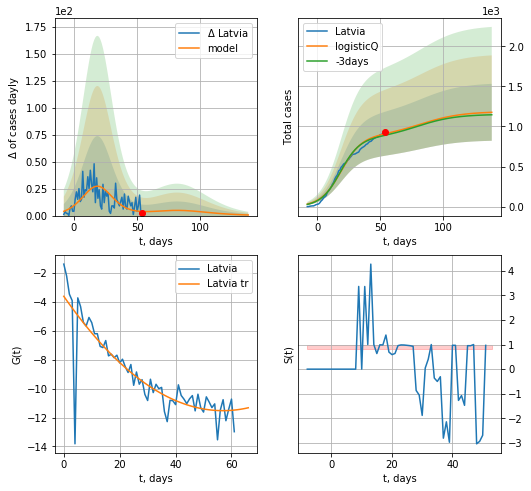

Latvia data at: 2020-05-08
+3 day model MAPE: 0.021227
model: logisticQ
coeffs: [ 8.75968533e+02  6.13426385e-07  1.89636920e+01 -1.99960570e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.301616
forecast at the end of period: +85 days
	 deltaDaycases: 0
	 total cases: 1176 ± 354
	 total death: 22 ± 19
trend coefficient of determination: 0.754835
 intercept_: -3.613337912229211
 coeffs_: [ 0.         -0.27781265  0.00243951]


In [417]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


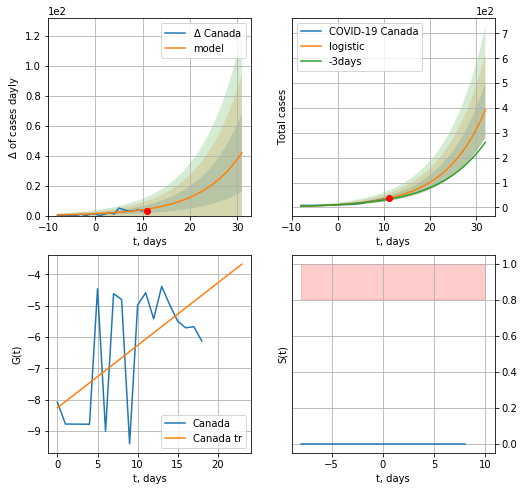

Canada data at: 2020-05-09
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  27 ± 22
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


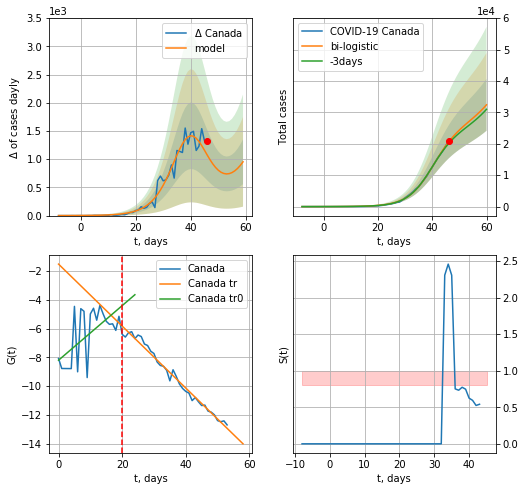

Canada data at: 2020-05-09
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +14 days
	 deltaDaycases:  953
	 total cases:  32410 ± 8262
	 total death:  2246 ± 1717
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


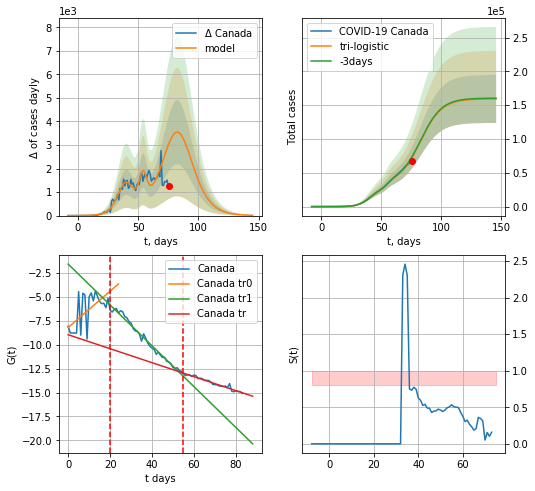

Canada data at: 2020-05-09
+3 day model MAPE: 0.014296512439566414
model: tri-logistic
coeffs:  [1.00391706e+04 4.69908941e-01 5.45909447e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  0.22295799663407018
forecast at the end of period: +70 days
	 deltaDaycases:  11
	 total cases:  159296 ± 35516
	 total death:  11042 ± 7385
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.950898
 intercept: -8.958429
 slope: -0.073039


In [178]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,8*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
          date    cases  active   death
80 2020-05-05  62046.0   31010  4043.0
81 2020-05-06  63496.0   31093  4232.0
82 2020-05-07  64922.0   31542  4408.0
83 2020-05-08  66434.0   31459  4569.0
84 2020-05-09  67702.0   31760  4693.0


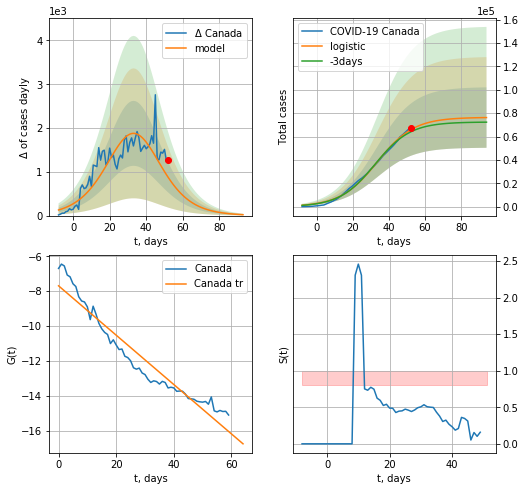

Canada data at: 2020-05-09
+3 day model MAPE: 0.029614337917563748
model: logistic
coeffs:  [7.64514098e+04 9.83237054e-02 3.35665525e+01]
rational stdev:  0.3390473837482806
forecast at the end of period: +42 days
	 deltaDaycases:  20
	 total cases:  76251 ± 25852
	 total death:  5285 ± 5375
trend coefficient of determination: 0.928981
 intercept: -7.690301
 slope: -0.141588


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


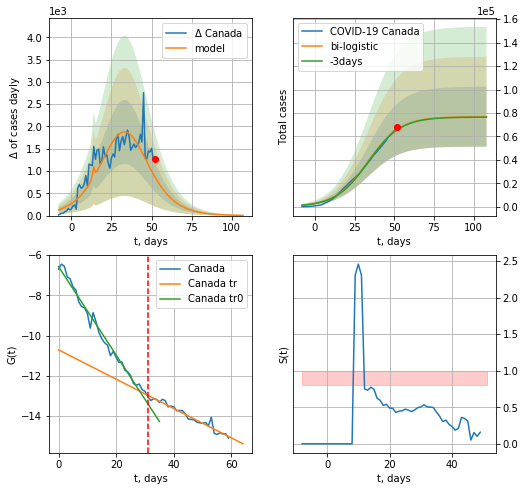

Canada data at: 2020-05-09
+3 day model MAPE: 0.005670403017702484
model: bi-logistic
coeffs:  [377.63319695   3.02574677  14.27907955] [7.64514098e+04 9.83237054e-02 3.35665525e+01]
rational stdev:  0.33278878753893104
forecast at the end of period: +56 days
	 deltaDaycases:  5
	 total cases:  76778 ± 25550
	 total death:  5322 ± 5313
bi-logistic approximation splitting point: 31
trend0 coefficient of determination: 0.983688
 intercept: -6.573152
 slope: -0.220036
trend coefficient of determination: 0.950898
 intercept: -10.711359
 slope: -0.073039


In [179]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,14*7-dT,x,1.,vL=31,cases='cases')

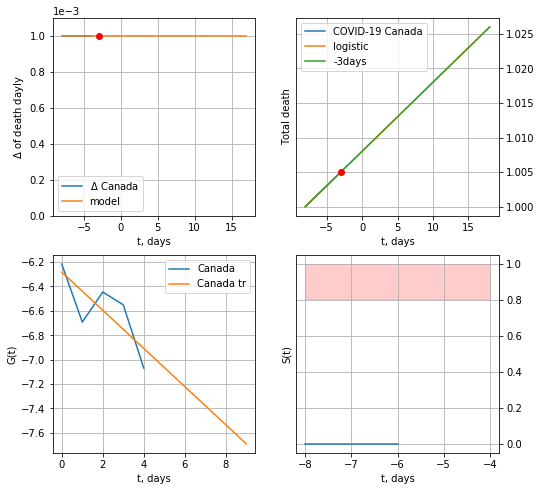

Canada data at: 2020-05-09
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


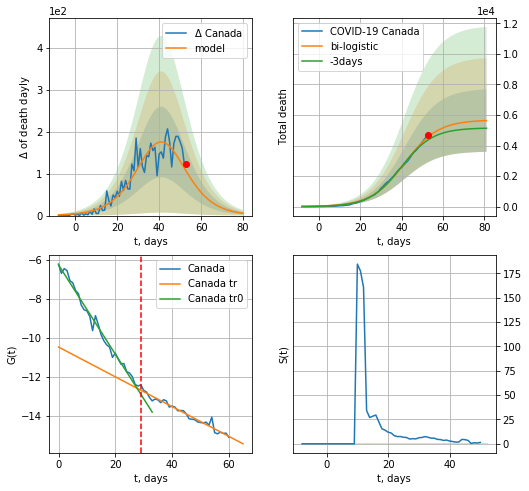

Canada data at: 2020-05-09
+3 day model MAPE: 0.04895458927897385
model: bi-logistic
coeffs:  [5.67583309e+03 1.23876983e-01 4.14489219e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.36297283472515357
forecast at the end of period: +28 days
	 deltaDaydeath:  5
	 total death:  5634 ± 2045
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.959450
 intercept: -10.471792
 slope: -0.076354


In [180]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,10*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


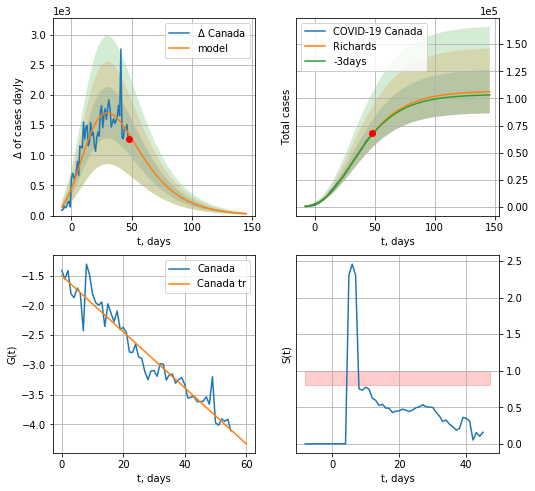

Canada data at: 2020-05-09
+3 day model MAPE: 0.007610
model: Richards
coeffs: [ 1.06859317e+05  3.69923055e+00 -7.14966019e+01  1.17849232e-02]
rational stdev: 0.187549
forecast at the end of period: +98 days
	 deltaDaycases: 30
	 total cases: 106170 ± 19912
	 total death: 7359 ± 4140
trend coefficient of determination: 0.931653
 intercept: -1.501588
 slope: -0.047112


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


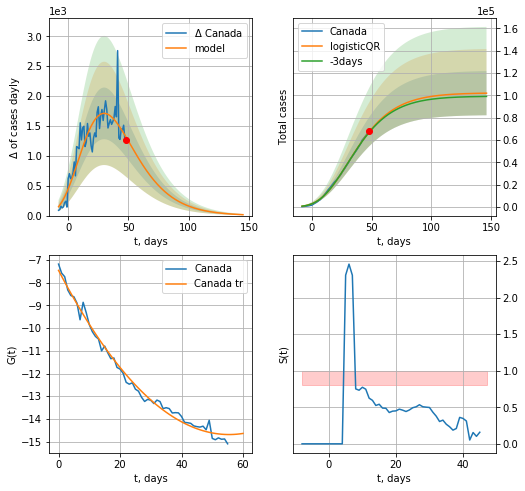

Canada data at: 2020-05-09
+3 day model MAPE: 0.008508384965190118
model: logisticQR
coeffs:  [ 1.02099246e+05  1.01825455e-02 -1.08154203e+02 -8.00388416e+02
  4.63036369e-03]
rational stdev:  0.19426737847756756
forecast at the end of period: +98 days
	 deltaDaycases:  15
	 total cases:  101837 ± 19783
	 total death:  7059 ± 4114
trend coefficient of determination: 0.990194
 intercept_: -7.451651245746089
 coeffs_: [ 0.         -0.26112846  0.00235453]


In [181]:
x = forecastRR('Canada',dfCA[28:],d1,14*7,1.)
x = forecastQR('Canada',dfCA[28:],d1,14*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


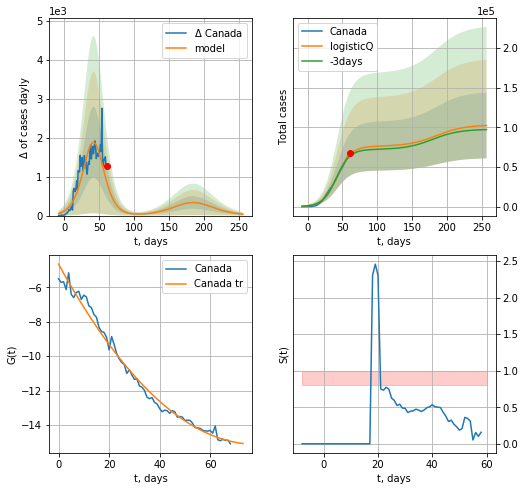

Canada data at: 2020-05-09
+3 day model MAPE: 0.030249
model: logisticQ
coeffs: [ 7.60930839e+04  1.25406451e-06  4.24504977e+01 -7.89120717e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.405242
forecast at the end of period: +196 days
	 deltaDaycases: 36
	 total cases: 102315 ± 41462
	 total death: 7092 ± 8621
trend coefficient of determination: 0.987119
 intercept_: -4.6391287360274704
 coeffs_: [ 0.         -0.26823544  0.00171494]


In [182]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
          date  cases  active   death
64 2020-05-05  25702   22885  1074.0
65 2020-05-06  26182   23017  1089.0
66 2020-05-07  26715   23352  1105.0
67 2020-05-08  27268   23732  1114.0
68 2020-05-09  27406   23781  1126.0


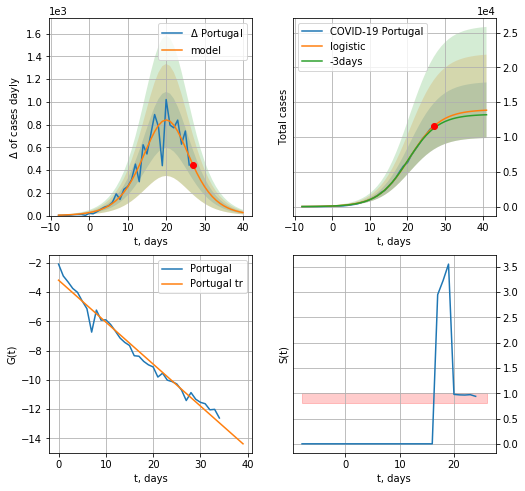

Portugal data at: 2020-05-09
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +14 days
	 deltaDaycases:  26
	 total cases:  13845 ± 3988
	 total death:  568 ± 490
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


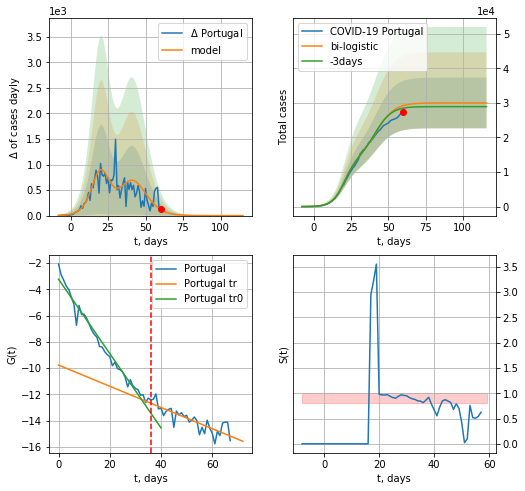

Portugal data at: 2020-05-09
+3 day model MAPE: 0.027727224940824396
model: bi-logistic
coeffs:  [1.28360599e+04 1.80931438e-01 4.08125032e+01] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.24442383222705102
forecast at the end of period: +56 days
	 deltaDaycases:  0
	 total cases:  29988 ± 7329
	 total death:  1232 ± 903
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.684877
 intercept: -9.762565
 slope: -0.080601


In [183]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,8*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


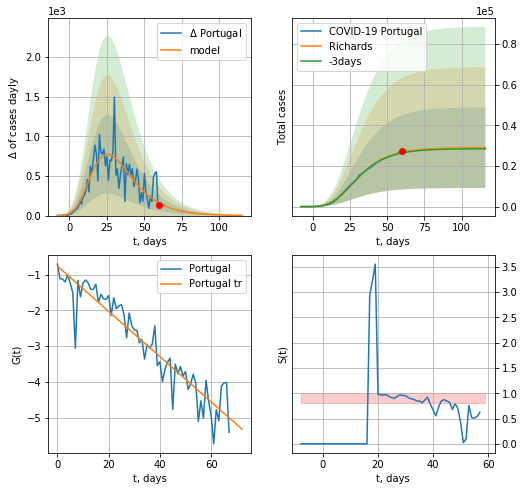

Portugal data at: 2020-05-09
+3 day model MAPE: 0.012384
model: Richards
coeffs: [ 2.90054956e+04  6.24173519e+00 -3.51466076e+01  1.16794715e-02]
rational stdev: 0.683723
forecast at the end of period: +56 days
	 deltaDaycases: 3
	 total cases: 28964 ± 19803
	 total death: 1190 ± 2440
trend coefficient of determination: 0.880803
 intercept: -0.765432
 slope: -0.063285


In [184]:
x = forecastRR('Portugal',dfPT[:],d1,14*7-dT,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


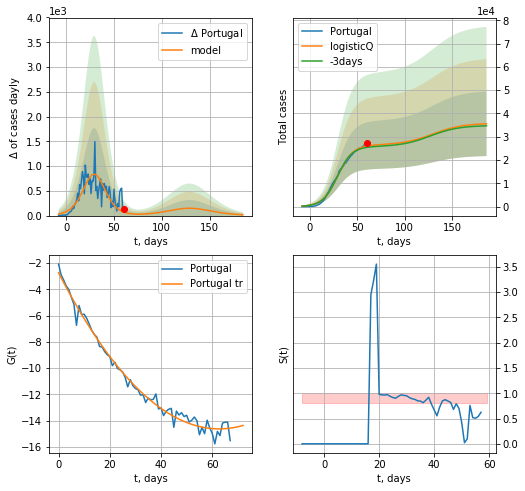

Portugal data at: 2020-05-09
+3 day model MAPE: 0.023069
model: logisticQ
coeffs: [ 2.64466946e+04  8.69418278e-07  2.96788724e+01 -1.45237000e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.389941
forecast at the end of period: +126 days
	 deltaDaycases: 15
	 total cases: 35563 ± 13867
	 total death: 1461 ± 1709
trend coefficient of determination: 0.986172
 intercept_: -2.738933266927422
 coeffs_: [ 0.         -0.37891746  0.00302199]


In [185]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

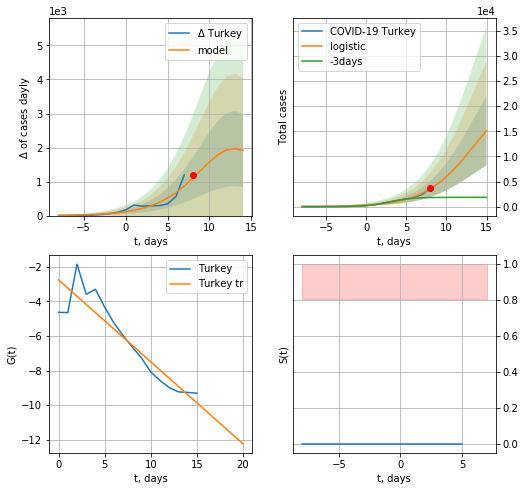

Turkey data at: 2020-05-09
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +7 days
	 deltaDaycases:  1915
	 total cases:  15126 ± 6885
	 total death:  412 ± 562
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


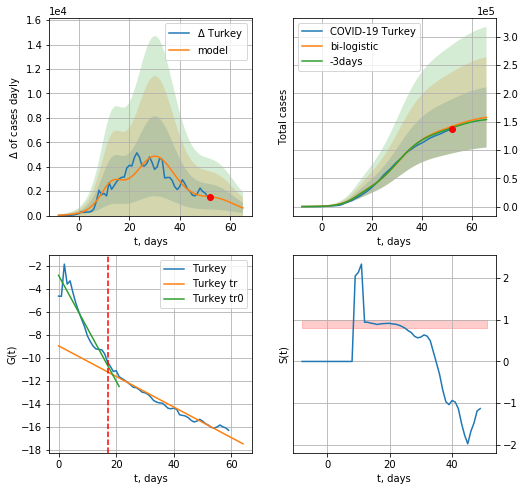

Turkey data at: 2020-05-09
+3 day model MAPE: 0.018384586100757983
model: bi-logistic
coeffs:  [1.09757767e+05 1.74060311e-01 3.06364540e+01] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.33782327799759865
forecast at the end of period: +14 days
	 deltaDaycases:  624
	 total cases:  157628 ± 53250
	 total death:  4298 ± 4355
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.964939
 intercept: -8.959515
 slope: -0.133397


In [187]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*7-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,8*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


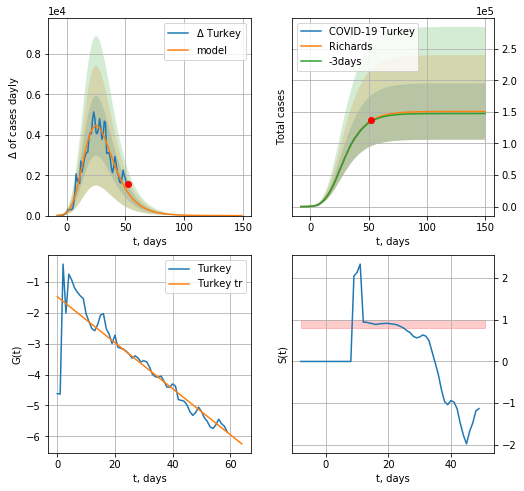

Turkey data at: 2020-05-09
+3 day model MAPE: 0.009306
model: Richards
coeffs: [1.50668336e+05 7.28344536e-01 2.07846384e-01 1.16719162e-01]
rational stdev: 0.296483
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 150664 ± 44669
	 total death: 4108 ± 3653
trend coefficient of determination: 0.791892
 intercept: -1.474405
 slope: -0.074501


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


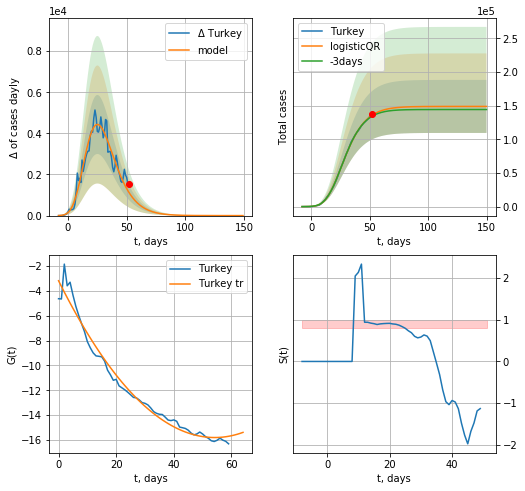

Turkey data at: 2020-05-09
+3 day model MAPE: 0.012015785617078872
model: logisticQR
coeffs:  [ 1.48750376e+05  1.36790207e-02 -3.58924991e+01 -2.91161220e+02
  1.58294982e-02]
rational stdev:  0.2645966408227625
forecast at the end of period: +98 days
	 deltaDaycases:  0
	 total cases:  148750 ± 39358
	 total death:  4056 ± 3219
trend coefficient of determination: 0.977211
 intercept_: -3.177460378740779
 coeffs_: [ 0.         -0.46621825  0.00430244]


In [188]:
x = forecastRR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1])
x = forecastQR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


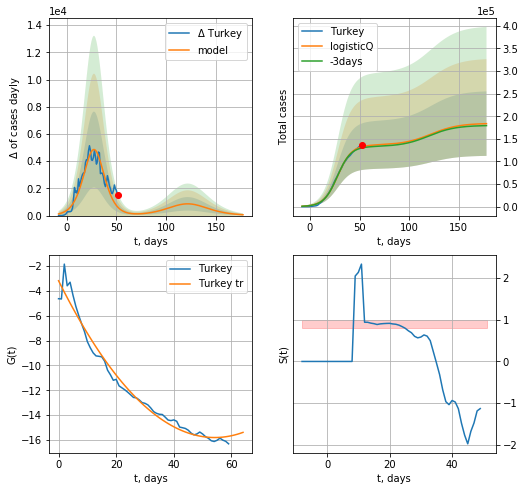

Turkey data at: 2020-05-09
+3 day model MAPE: 0.020697
model: logisticQ
coeffs: [ 1.36243693e+05  1.74471141e-06  2.79772074e+01 -8.17447093e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.388623
forecast at the end of period: +126 days
	 deltaDaycases: 61
	 total cases: 183648 ± 71370
	 total death: 5007 ± 5837
trend coefficient of determination: 0.977211
 intercept_: -3.177460378740779
 coeffs_: [ 0.         -0.46621825  0.00430244]


In [189]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [190]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.01935483870967742

In [191]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

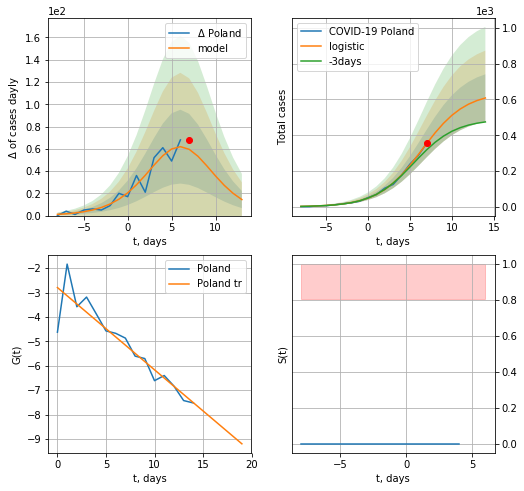

Poland data at: 2020-05-09
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +7 days
	 deltaDaycases:  14
	 total cases:  608 ± 132
	 total death:  30 ± 19
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


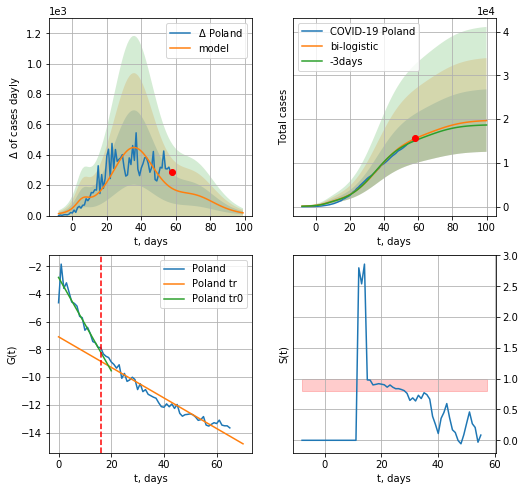

Poland data at: 2020-05-09
+3 day model MAPE: 0.030900456544565493
model: bi-logistic
coeffs:  [1.53332674e+04 1.15173317e-01 3.59564072e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.36301988156561377
forecast at the end of period: +42 days
	 deltaDaycases:  18
	 total cases:  19652 ± 7134
	 total death:  985 ± 1072
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.936837
 intercept: -7.084781
 slope: -0.110399


In [192]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*7-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,12*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


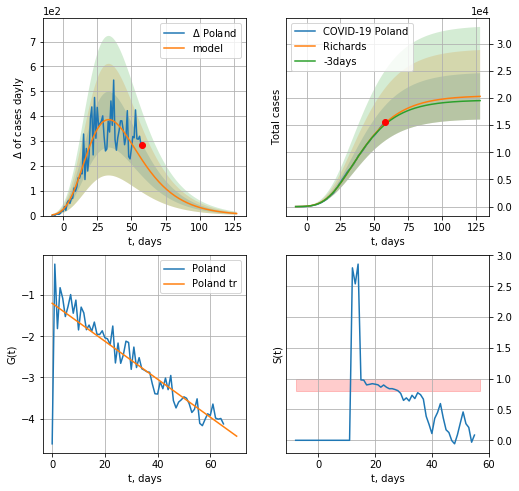

Poland data at: 2020-05-09
+3 day model MAPE: 0.014611
model: Richards
coeffs: [ 2.04335999e+04  4.00051186e+00 -5.03416923e+01  1.29187459e-02]
rational stdev: 0.210147
forecast at the end of period: +70 days
	 deltaDaycases: 8
	 total cases: 20277 ± 4261
	 total death: 1017 ± 641
trend coefficient of determination: 0.754256
 intercept: -1.198196
 slope: -0.046158


In [193]:
x =  forecastRR('Poland',dfPL[:],d1,16*7-dT)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


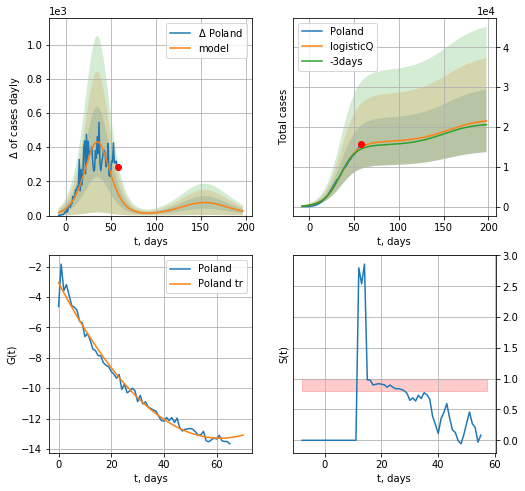

Poland data at: 2020-05-09
+3 day model MAPE: 0.034675
model: logisticQ
coeffs: [ 1.62922515e+04  1.29688623e-06  3.54721423e+01 -8.14779634e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.365184
forecast at the end of period: +140 days
	 deltaDaycases: 25
	 total cases: 21540 ± 7866
	 total death: 1080 ± 1183
trend coefficient of determination: 0.984742
 intercept_: -3.06123366536461
 coeffs_: [ 0.         -0.33371207  0.00272115]


In [194]:
x =  forecastRRR('Poland',dfPL[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
          date    cases  active  death
73 2020-05-05  16289.0    5586  238.0
74 2020-05-06  16310.0    5434  239.0
75 2020-05-07  16381.0    5268  240.0
76 2020-05-08  16436.0    4962  245.0
77 2020-05-09  16454.0    4831  247.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


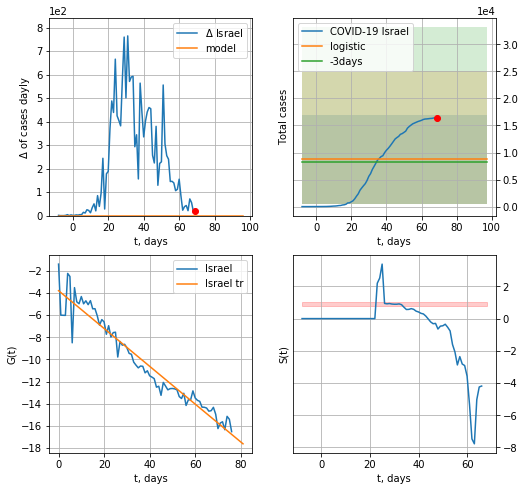

Israel data at: 2020-05-09
+3 day model MAPE: 0.05725268209525777
model: logistic
coeffs:  [ 6.97748808e+03 -3.54677820e+00  1.04295583e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.9359607077001
forecast at the end of period: +28 days
	 deltaDaycases:  0
	 total cases:  8721 ± 8163
	 total death:  130 ± 365
trend coefficient of determination: 0.933877
 intercept: -3.785663
 slope: -0.170887


In [195]:
dfIS = read_df(pd.DataFrame(),"IS")
x = forecast('Israel',dfIS[:],d1,10*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


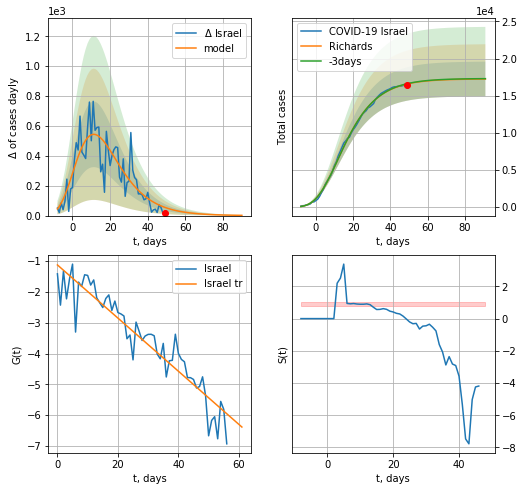

Israel data at: 2020-05-09
+3 day model MAPE: 0.002301
model: Richards
coeffs: [ 1.72597873e+04  7.37568357e+00 -3.98022692e+01  1.16929968e-02]
rational stdev: 0.135684
forecast at the end of period: +42 days
	 deltaDaycases: 1
	 total cases: 17241 ± 2339
	 total death: 258 ± 105
trend coefficient of determination: 0.878843
 intercept: -1.123295
 slope: -0.086279


In [196]:
x = forecastRR('Israel',dfIS[20:],d1,12*7-dT)
#xx = forecast2R('Israel',dfIS[:],d1,7*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


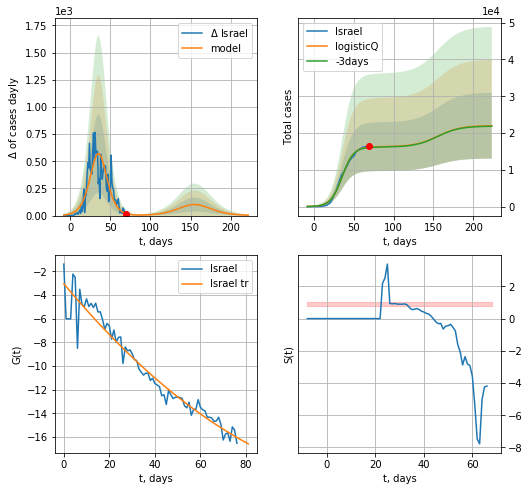

Israel data at: 2020-05-09
+3 day model MAPE: 0.006568
model: logisticQ
coeffs: [ 1.62810072e+04  9.69906244e-07  3.56763663e+01 -1.44785676e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.406938
forecast at the end of period: +154 days
	 deltaDaycases: 3
	 total cases: 21998 ± 8952
	 total death: 330 ± 402
trend coefficient of determination: 0.941562
 intercept_: -3.045997938250361
 coeffs_: [ 0.         -0.23007236  0.00077884]


In [197]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


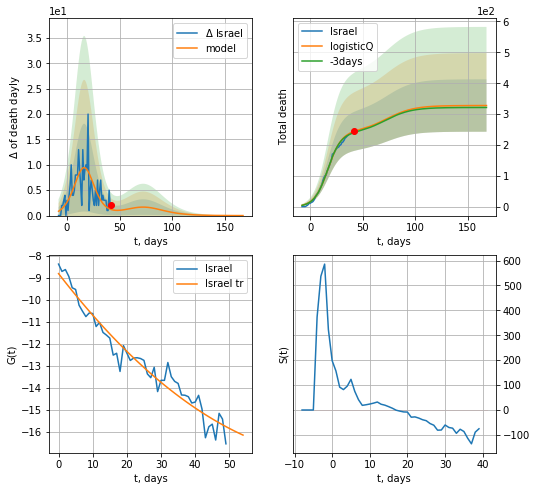

Israel data at: 2020-05-09
+3 day model MAPE: 0.015519
model: logisticQ
coeffs: [ 2.42267610e+02  9.33442970e-06  1.67176401e+01 -1.65718639e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.258468
forecast at the end of period: +126 days
	 total death: 328 ± 84
trend coefficient of determination: 0.950818
 intercept_: -8.815847414899968
 coeffs_: [ 0.         -0.19999679  0.00119493]


In [198]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


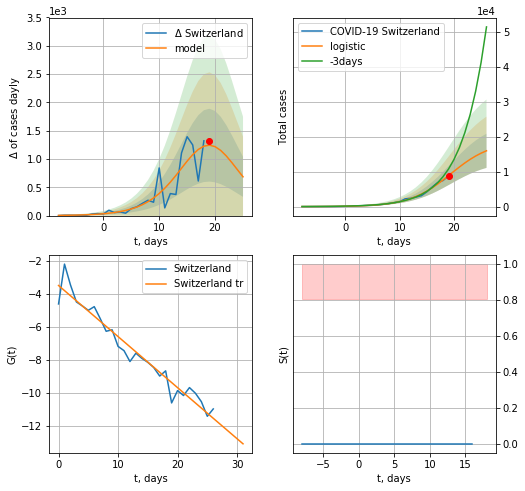

Switzerland data at: 2020-05-09
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +7 days
	 deltaDaycases:  685
	 total cases:  15957 ± 4883
	 total death:  965 ± 886
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


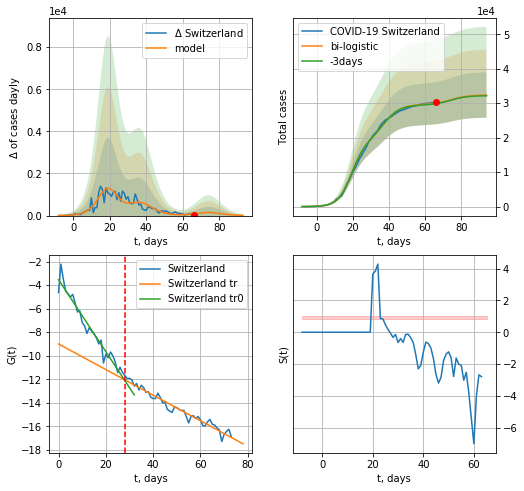

Switzerland data at: 2020-05-09
+3 day model MAPE: 0.005526738591158917
model: bi-logistic
coeffs:  [1.09584962e+04 2.13543727e-01 3.72998552e+01] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.20364416915480968
forecast at the end of period: +28 days
	 deltaDaycases:  10
	 total cases:  32361 ± 6590
	 total death:  1957 ± 1195
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.954802
 intercept: -8.998969
 slope: -0.108740


In [200]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*7-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*10-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


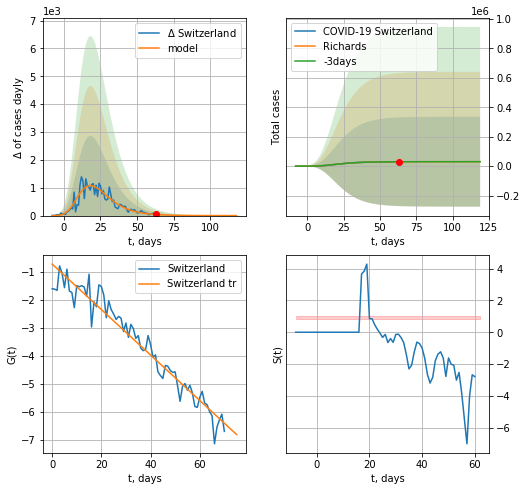

Switzerland data at: 2020-05-09
+3 day model MAPE: 0.001195
model: Richards
coeffs: [ 3.05219575e+04  6.55768821e+00 -2.50382469e+01  1.47299228e-02]
rational stdev: 9.996570
forecast at the end of period: +56 days
	 deltaDaycases: 0
	 total cases: 30520 ± 305096
	 total death: 1846 ± 55361
trend coefficient of determination: 0.944128
 intercept: -0.723398
 slope: -0.081010


In [201]:
x = forecastRR('Switzerland',dfSZ[3:],d1,7*14-dT)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


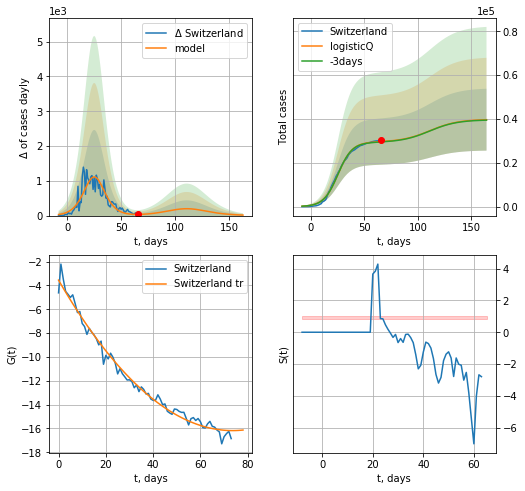

Switzerland data at: 2020-05-09
+3 day model MAPE: 0.005696
model: logisticQ
coeffs: [ 2.94476388e+04  9.43696552e-07  2.55285509e+01 -1.59936460e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.355710
forecast at the end of period: +98 days
	 deltaDaycases: 14
	 total cases: 39690 ± 14118
	 total death: 2401 ± 2562
trend coefficient of determination: 0.985548
 intercept_: -3.5584667361487234
 coeffs_: [ 0.         -0.34289208  0.0023295 ]


In [202]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=True,xcoef=koreaCoeffs)

In [203]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
          date    cases  active  death
56 2020-05-05  13184.0   10760  327.0
57 2020-05-06  13691.0   10955  340.0
58 2020-05-07  14195.0   11128  361.0
59 2020-05-08  14710.0   11425  376.0
60 2020-05-09  14710.0   11425  376.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:478: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

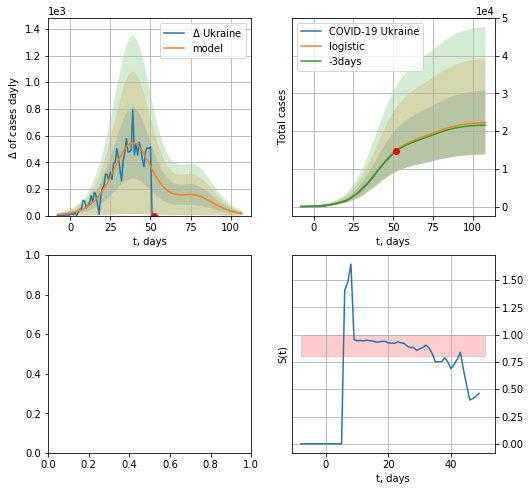

In [204]:
dfUR = read_df(pd.DataFrame(),"Ukr")
x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:131: RuntimeWarning: invalid value encountered in true_divide


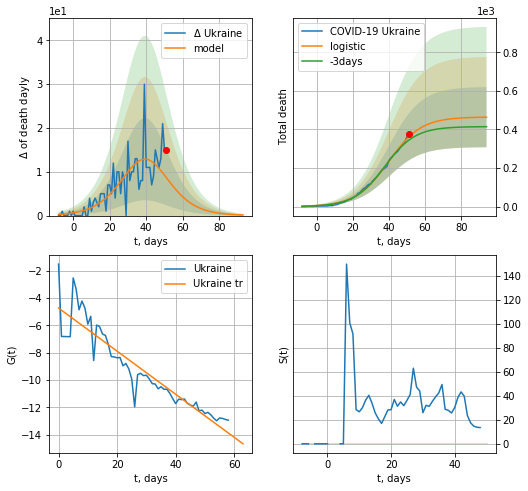

Ukraine data at: 2020-05-08
+3 day model MAPE: 0.05337418589270003
model: logistic
coeffs:  [4.64751066e+02 1.10944844e-01 3.98030241e+01]
rational stdev:  0.3364010631548778
forecast at the end of period: +43 days
	 total death:  463 ± 155
trend coefficient of determination: 0.860167
 intercept: -4.725702
 slope: -0.158042


In [387]:
x=forecast('Ukraine',dfUR[:],d1,12*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


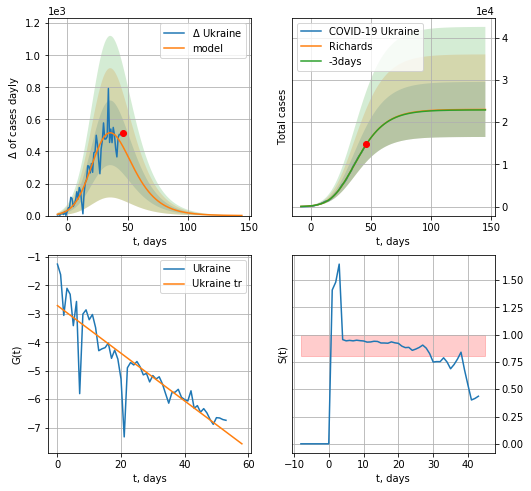

Ukraine data at: 2020-05-08
+3 day model MAPE: 0.000264
model: Richards
coeffs: [2.30132034e+04 2.02538839e-01 2.14549587e+01 3.53169098e-01]
rational stdev: 0.283205
forecast at the end of period: +99 days
	 deltaDaycases: 0
	 total cases: 23003 ± 6514
	 total death: 585 ± 497
trend coefficient of determination: 0.794433
 intercept: -2.713479
 slope: -0.083684


In [388]:
x=forecastRR('Ukraine',dfUR[5:],d1,7*20-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


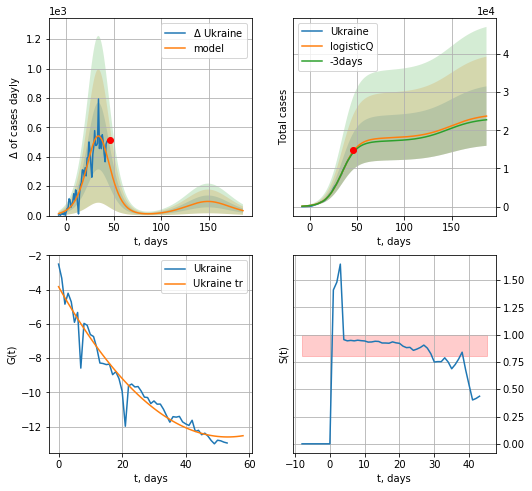

Ukraine data at: 2020-05-08
+3 day model MAPE: 0.022607
model: logisticQ
coeffs: [ 1.79660044e+04  5.09377647e-06  3.43413718e+01 -2.36271343e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.328334
forecast at the end of period: +141 days
	 deltaDaycases: 33
	 total cases: 23728 ± 7790
	 total death: 603 ± 593
trend coefficient of determination: 0.945914
 intercept_: -3.8319723451873386
 coeffs_: [ 0.         -0.32966422  0.00310016]


In [389]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*26-dT,addpred=True,xcoef=koreaCoeffs)

In [74]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

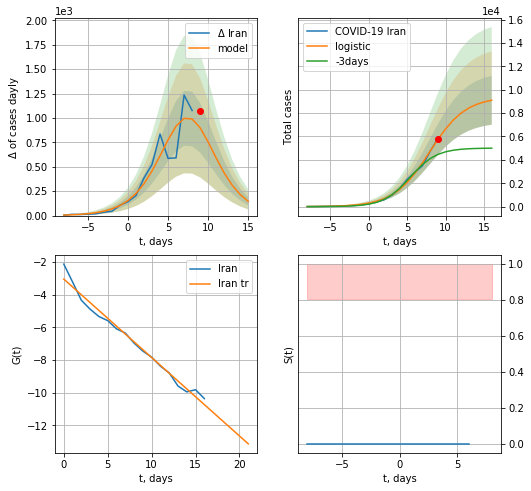

Iran data at: 2020-05-09
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +7 days
	 deltaDaycases:  145
	 total cases:  9101 ± 2090
	 total death:  564 ± 388
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


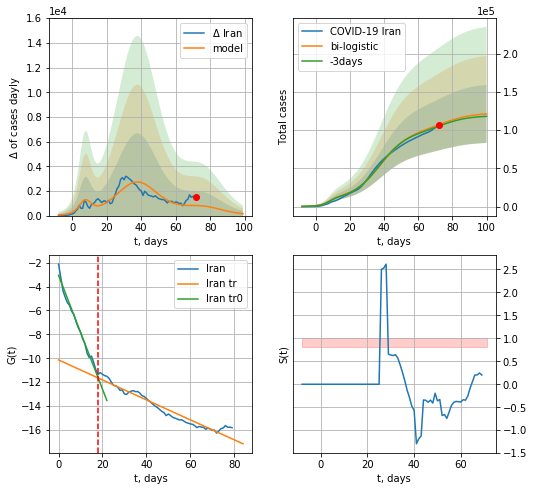

Iran data at: 2020-05-09
+3 day model MAPE: 0.01699595917312563
model: bi-logistic
coeffs:  [9.04182338e+04 1.19477206e-01 3.80048925e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3130385508419611
forecast at the end of period: +28 days
	 deltaDaycases:  152
	 total cases:  121136 ± 37920
	 total death:  7514 ± 7056
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.942400
 intercept: -10.143793
 slope: -0.083584


In [206]:
x = forecast('Iran',dfIN[:18],d1,7*7-dT)
xx = forecast2('Iran',dfIN[:],d1,10*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


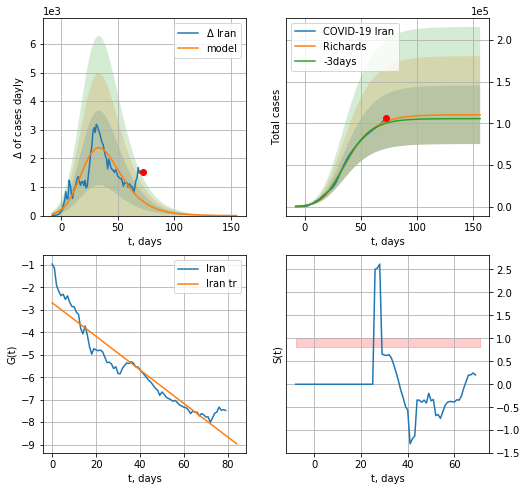

Iran data at: 2020-05-09
+3 day model MAPE: 0.021746
model: Richards
coeffs: [1.10314833e+05 2.37448174e-01 1.44751889e+01 2.79599468e-01]
rational stdev: 0.318842
forecast at the end of period: +84 days
	 deltaDaycases: 2
	 total cases: 110282 ± 35162
	 total death: 6840 ± 6542
trend coefficient of determination: 0.904097
 intercept: -2.682205
 slope: -0.074769


In [208]:
x = forecastRR('Iran',dfIN[:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


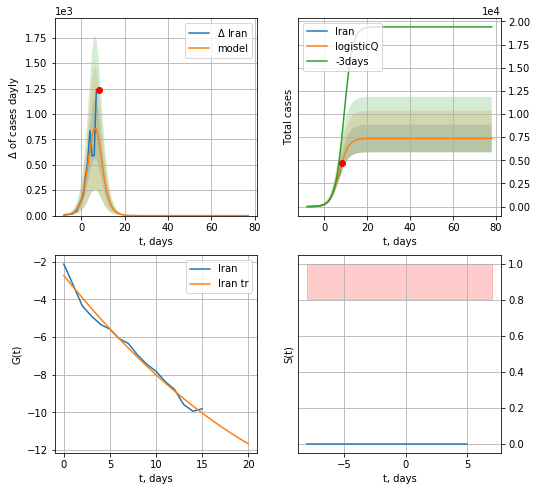

Iran data at: 2020-05-09
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +70 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 457 ± 278
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


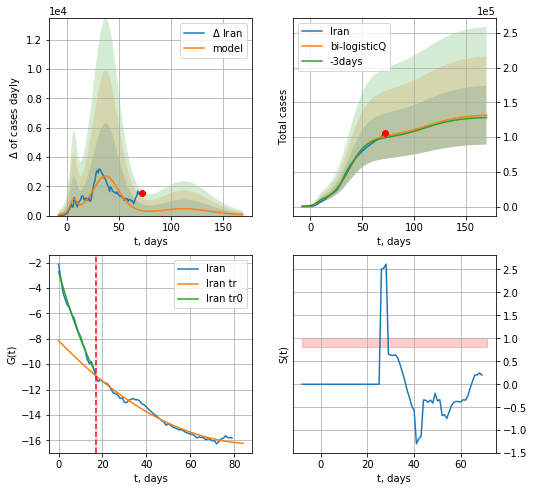

Iran data at: 2020-05-09
+3 day model MAPE: 0.024431
model: bi-logisticQ
coeffs: [ 9.28448857e+04  6.99627680e-07  3.76298401e+01 -1.64768386e+05]
S.Korea scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.321360
forecast at the end of period: +98 days
	 deltaDaycases: 66
	 total cases: 131548 ± 42274
	 total death: 8160 ± 7866
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.978487
 intercept_: -8.139777950624238
 coeffs_: [ 0.         -0.17944388  0.00098939]


In [209]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=[0.35,.5,3,1])
xx = forecast2RRR('Iran',dfIN[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,3,1],vL=17)

RS
          date     cases  active   death
66 2020-05-05  155370.0  134054  1451.0
67 2020-05-06  165929.0  143065  1537.0
68 2020-05-07  177160.0  151732  1625.0
69 2020-05-08  187859.0  159528  1723.0
70 2020-05-09  198676.0  164933  1827.0


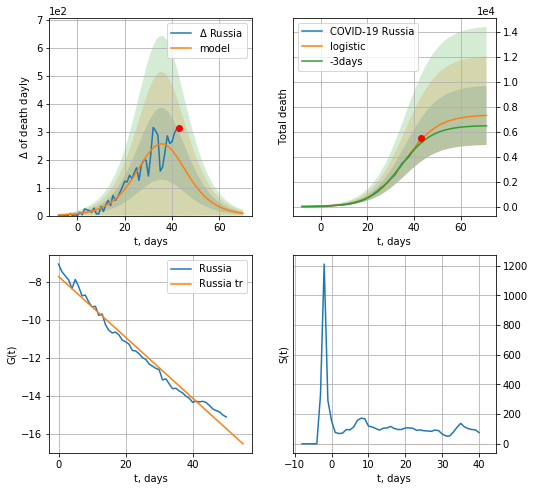

Russia data at: 2020-05-09
+3 day model MAPE: 0.05328864754743123
model: logistic
coeffs:  [7.35372447e+03 1.39585967e-01 3.60240572e+01]
rational stdev:  0.323454913569639
forecast at the end of period: +28 days
	 total death:  7298 ± 2360
trend coefficient of determination: 0.980604
 intercept: -7.727234
 slope: -0.159860


In [210]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,10*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

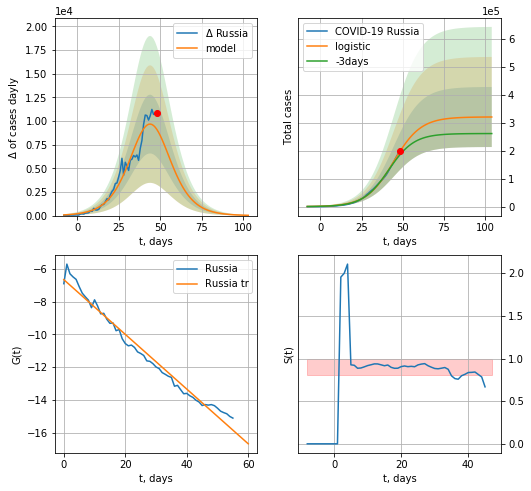

Russia data at: 2020-05-09
+3 day model MAPE: 0.06990772990762303
model: logistic
coeffs:  [3.21114897e+05 1.20639587e-01 4.43838009e+01]
rational stdev:  0.3350537913098675
forecast at the end of period: +56 days
	 deltaDaycases:  30
	 total cases:  320873 ± 107509
	 total death:  2950 ± 2965
trend coefficient of determination: 0.978353
 intercept: -6.652805
 slope: -0.167124


In [211]:
x = forecast('Russia',dfRS[14:],d1,14*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


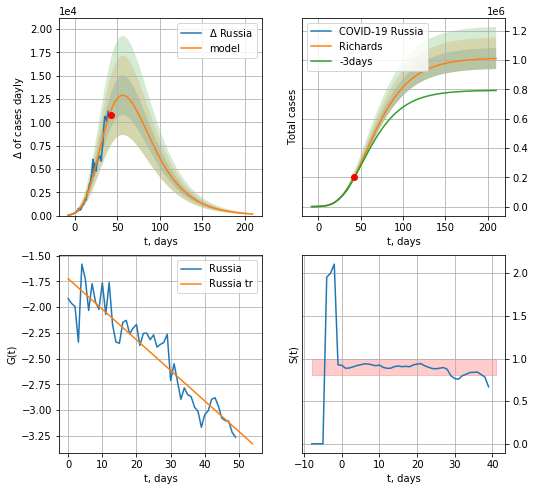

Russia data at: 2020-05-09
+3 day model MAPE: 0.025523
model: Richards
coeffs: [ 1.01480520e+06  1.21142784e+00 -4.43125039e+01  2.89391800e-02]
rational stdev: 0.071050
forecast at the end of period: +168 days
	 deltaDaycases: 167
	 total cases: 1010107 ± 71768
	 total death: 9288 ± 1979
trend coefficient of determination: 0.870587
 intercept: -1.724963
 slope: -0.029684


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


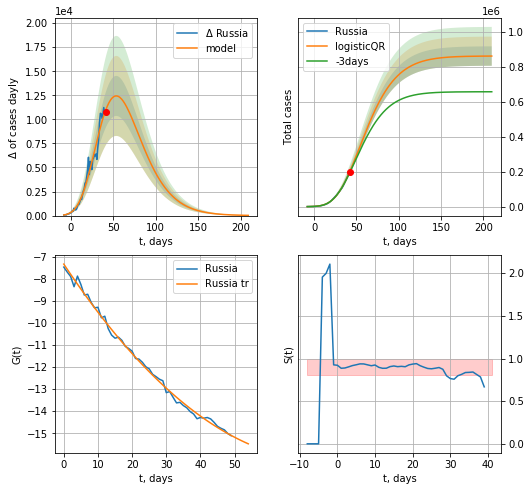

Russia data at: 2020-05-09
+3 day model MAPE: 0.02775580325378641
model: logisticQR
coeffs:  [ 8.61736042e+05  7.63333445e-03 -1.12544244e+02 -4.42668369e+02
  7.80043676e-03]
rational stdev:  0.06453594934568746
forecast at the end of period: +168 days
	 deltaDaycases:  23
	 total cases:  861338 ± 55587
	 total death:  7920 ± 1533
trend coefficient of determination: 0.995977
 intercept_: -7.342192982286182
 coeffs_: [ 0.         -0.23292269  0.00152399]


In [212]:
x = forecastRR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


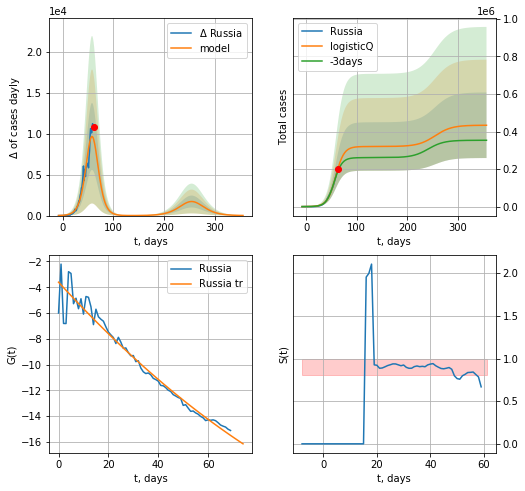

Russia data at: 2020-05-09
+3 day model MAPE: 0.070202
model: logisticQ
coeffs: [ 3.20285743e+05  4.95669775e-06  5.83400885e+01 -2.43241047e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.402951
forecast at the end of period: +294 days
	 deltaDaycases: 14
	 total cases: 433485 ± 174673
	 total death: 3986 ± 4818
trend coefficient of determination: 0.957431
 intercept_: -3.6095025593281376
 coeffs_: [ 0.         -0.21099221  0.00056241]


In [214]:
x = forecastRRR('Russia',dfRS[:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

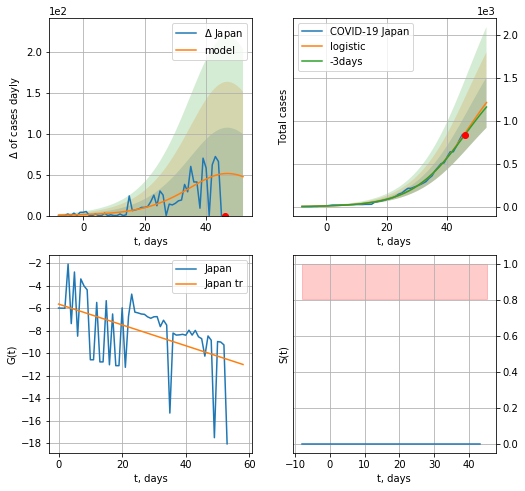

Japan data at: 2020-05-09
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +7 days
	 deltaDaycases:  47
	 total cases:  1211 ± 293
	 total death:  46 ± 33
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


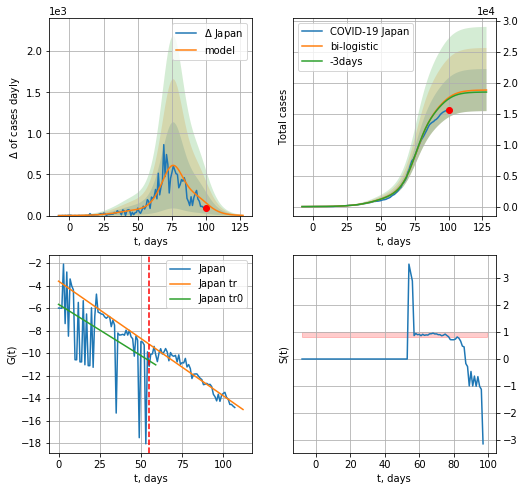

Japan data at: 2020-05-09
+3 day model MAPE: 0.011924992628955395
model: bi-logistic
coeffs:  [1.35699957e+04 1.71793902e-01 7.61107014e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
scenario coeffs:  [0.25, 1.0, 1.25]
rational stdev:  0.18057467403883448
forecast at the end of period: +28 days
	 deltaDaycases:  2
	 total cases:  18815 ± 3397
	 total death:  729 ± 394
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.901549
 intercept: -3.612409
 slope: -0.101845


In [216]:
x = forecast('Japan',dfJP[:55],d1,7*7-dT)
xx = forecast2('Japan',dfJP[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.25],vL=55)

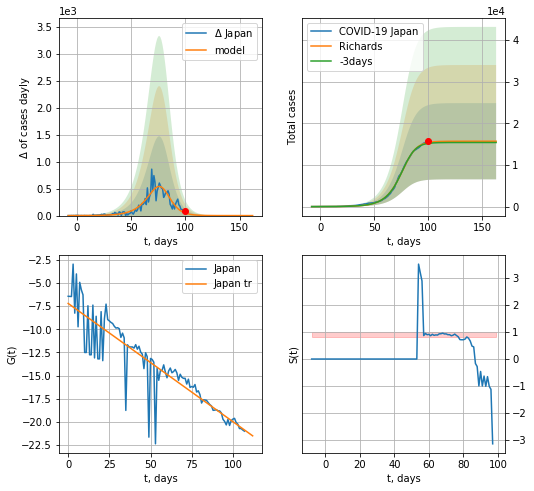

Japan data at: 2020-05-09
+3 day model MAPE: 0.015080
model: Richards
coeffs: [1.56935491e+04 1.00654205e-01 7.93124469e+01 1.63664547e+00]
rational stdev: 0.582720
forecast at the end of period: +63 days
	 deltaDaycases: 0
	 total cases: 15693 ± 9144
	 total death: 608 ± 1062
trend coefficient of determination: 0.804070
 intercept: -7.217984
 slope: -0.127470


In [217]:
x = forecastRR('Japan',dfJP[:],d1,15*7-dT)

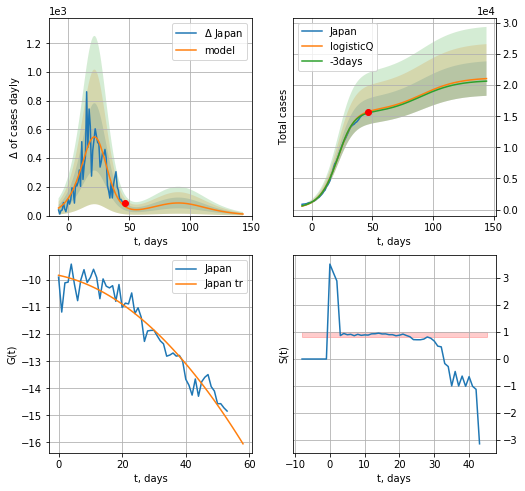

Japan data at: 2020-05-09
+3 day model MAPE: 0.014071
model: logisticQ
coeffs: [ 1.56723424e+04  7.50594347e-04  2.06884845e+01 -1.63363239e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.131534
forecast at the end of period: +98 days
	 deltaDaycases: 10
	 total cases: 21055 ± 2769
	 total death: 815 ± 321
trend coefficient of determination: 0.935491
 intercept_: -9.822492819696999
 coeffs_: [ 0.         -0.02478359 -0.00142423]


In [218]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


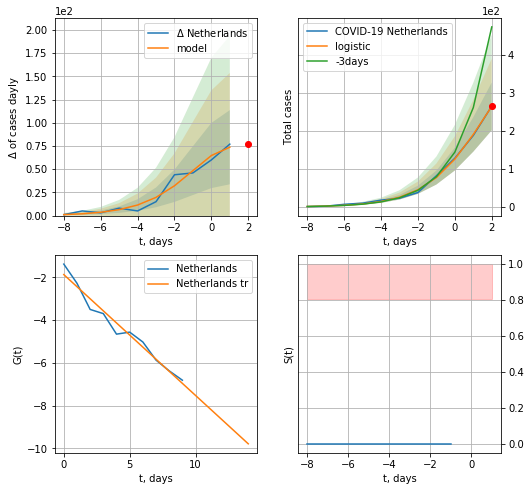

Netherlands data at: 2020-05-09
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +0 days
	 deltaDaycases:  73
	 total cases:  264 ± 62
	 total death:  33 ± 23
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:230: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


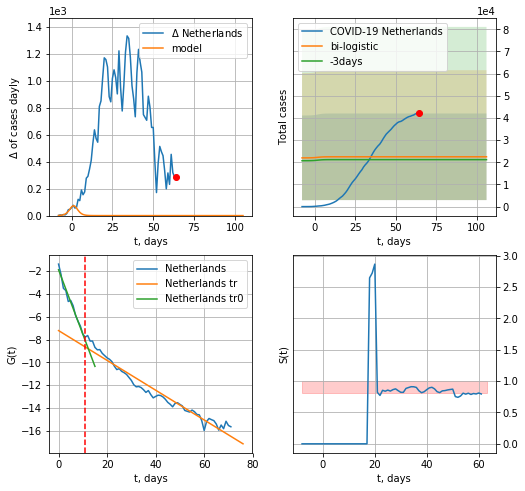

Netherlands data at: 2020-05-09
+3 day model MAPE: 0.06070857761103853
model: bi-logistic
coeffs:  [ 1.75871843e+04 -3.97613066e+00  1.26646259e+02] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8689456615164309
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  22471 ± 19526
	 total death:  2874 ± 7492
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.956547
 intercept: -7.211748
 slope: -0.130591


In [219]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,6*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
          date  cases  active   death
68 2020-05-05  41087   35669  5168.0
69 2020-05-06  41319   35865  5204.0
70 2020-05-07  41774   36236  5288.0
71 2020-05-08  42093   36484  5359.0
72 2020-05-09  42382   36710  5422.0


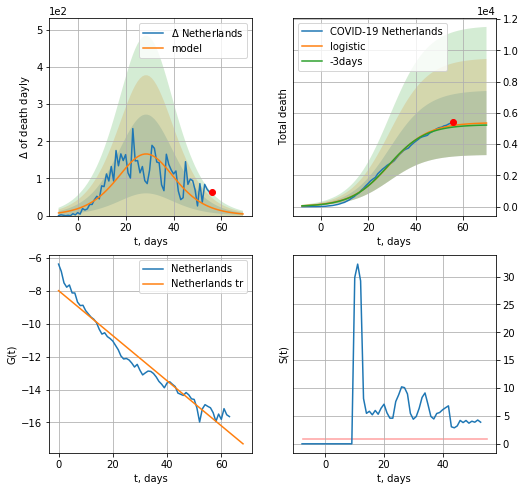

Netherlands data at: 2020-05-09
+3 day model MAPE: 0.020668262413505077
model: logistic
coeffs:  [5.38389423e+03 1.23252178e-01 2.90186513e+01]
rational stdev:  0.3834855964350494
forecast at the end of period: +14 days
	 total death:  5349 ± 2051
trend coefficient of determination: 0.952307
 intercept: -7.989951
 slope: -0.136845


In [220]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,8*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


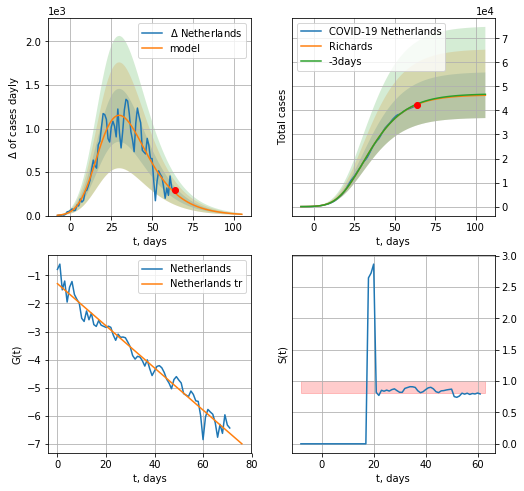

Netherlands data at: 2020-05-09
+3 day model MAPE: 0.004054
model: Richards
coeffs: [4.65170089e+04 5.31464985e-01 2.46089515e+00 1.35171893e-01]
rational stdev: 0.204730
forecast at the end of period: +42 days
	 deltaDaycases: 15
	 total cases: 46315 ± 9482
	 total death: 5925 ± 3639
trend coefficient of determination: 0.969452
 intercept: -1.293686
 slope: -0.074956


In [221]:
x = forecastRR('Netherlands',dfNL[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


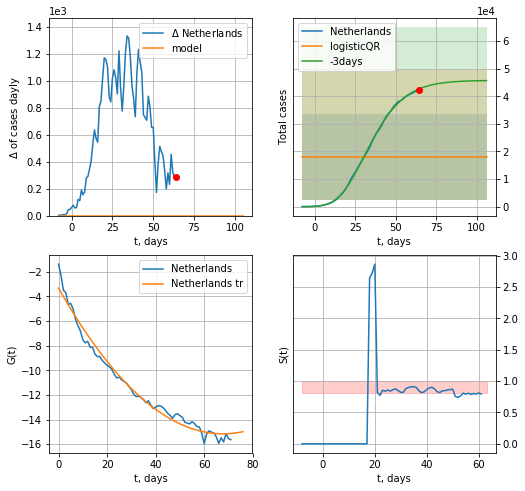

Netherlands data at: 2020-05-09
+3 day model MAPE: 0.5793771458551896
model: logisticQR
coeffs:  [ 1.80065890e+04  6.17536362e+00 -1.27674122e+03  1.10048801e+03
 -2.50270015e+00]
rational stdev:  0.8722637937000988
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  18006 ± 15706
	 total death:  2303 ± 6026
trend coefficient of determination: 0.980445
 intercept_: -3.329116312527038
 coeffs_: [ 0.         -0.34915218  0.00257628]


In [222]:
x = forecastQR('Netherlands',dfNL[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


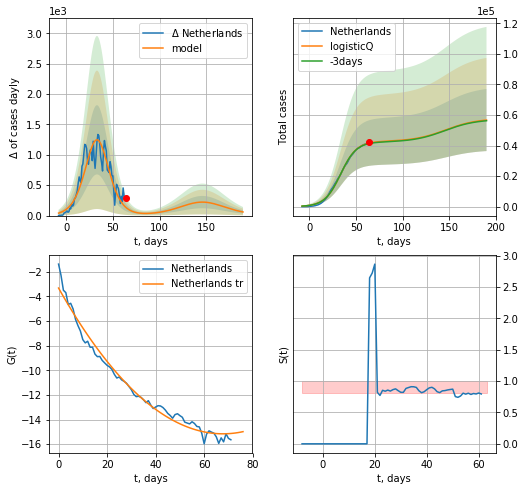

Netherlands data at: 2020-05-09
+3 day model MAPE: 0.008101
model: logisticQ
coeffs: [ 4.26622108e+04  1.28831930e-06  3.35177742e+01 -9.07158960e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.358576
forecast at the end of period: +126 days
	 deltaDaycases: 59
	 total cases: 56709 ± 20334
	 total death: 7254 ± 7803
trend coefficient of determination: 0.980445
 intercept_: -3.329116312527038
 coeffs_: [ 0.         -0.34915218  0.00257628]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: invalid value encountered in true_divide


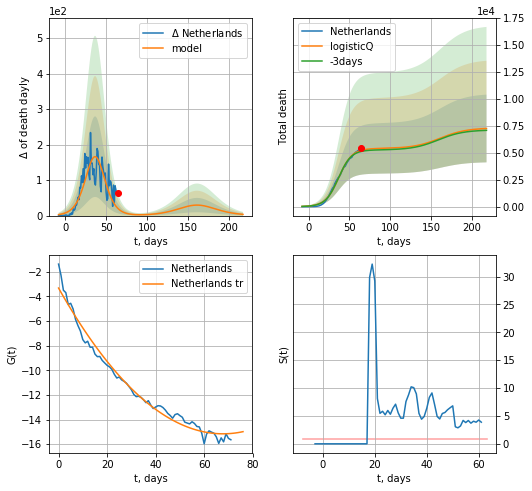

Netherlands data at: 2020-05-09
+3 day model MAPE: 0.020760
model: logisticQ
coeffs: [ 5.38042547e+03  1.15689160e-06  3.70058053e+01 -1.06673694e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.433489
forecast at the end of period: +154 days
	 total death: 7231 ± 3134
trend coefficient of determination: 0.980445
 intercept_: -3.329116312527038
 coeffs_: [ 0.         -0.34915218  0.00257628]


In [223]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [224]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


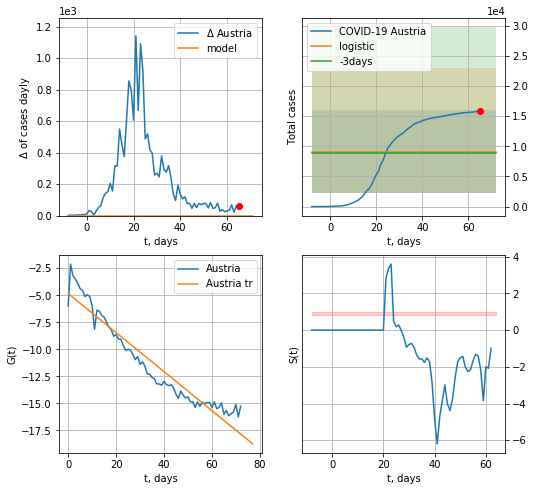

Austria data at: 2020-05-09
+3 day model MAPE: 0.0366158836016115
model: logistic
coeffs:  [ 8.59837850e+03 -2.95666583e+00  1.09109287e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.7538360308480814
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  9135 ± 6886
	 total death:  354 ± 800
trend coefficient of determination: 0.921129
 intercept: -4.843773
 slope: -0.180418


In [225]:
x = forecast('Austria',dfAT[:],d1,7*7-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


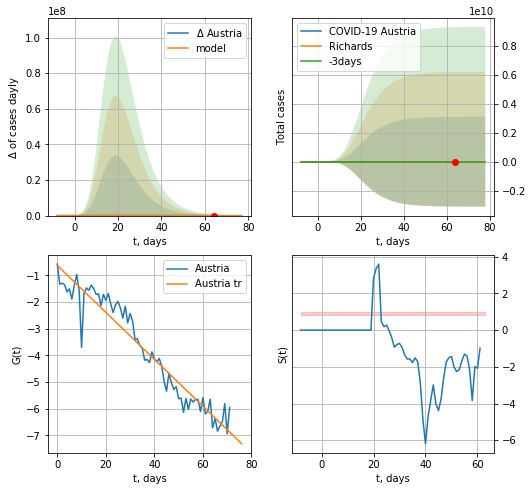

Austria data at: 2020-05-09
+3 day model MAPE: 0.005124
model: Richards
coeffs: [ 1.55211049e+04  3.48610949e+00 -5.37407813e+00  3.79022586e-02]
rational stdev: 200333.205503
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 15514 ± 3108045043
	 total death: 602 ± 361801769
trend coefficient of determination: 0.925693
 intercept: -0.623920
 slope: -0.088096


In [226]:
x = forecastRR('Austria',dfAT[1:],d1,8*7-dT,addpred=False,xcoef=[0.25,1.,2.2,1.])
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


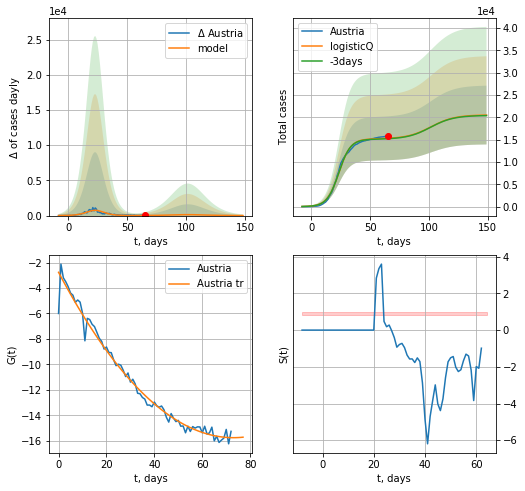

Austria data at: 2020-05-09
+3 day model MAPE: 0.006167
model: logisticQ
coeffs: [ 1.51899519e+04  1.19670540e-06  2.33337072e+01 -1.66209288e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.320979
forecast at the end of period: +84 days
	 deltaDaycases: 4
	 total cases: 20522 ± 6587
	 total death: 797 ± 767
trend coefficient of determination: 0.980908
 intercept_: -2.767708921436421
 coeffs_: [ 0.         -0.35588273  0.00243716]


In [227]:
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


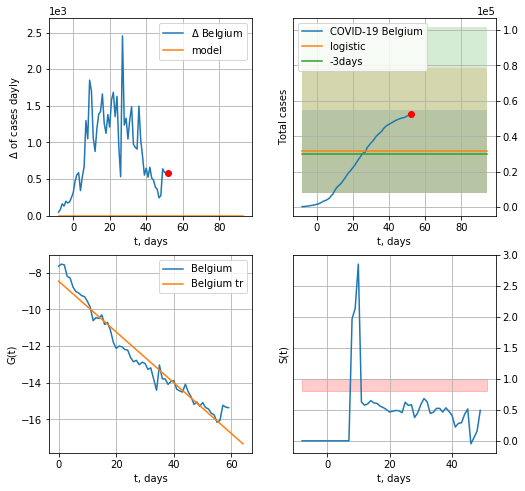

Belgium data at: 2020-05-09
+3 day model MAPE: 0.05817396830895119
model: logistic
coeffs:  [ 2.52120165e+04 -5.25186309e+00  1.94821847e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.7434298632403571
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  31515 ± 23429
	 total death:  5141 ± 11465
trend coefficient of determination: 0.951353
 intercept: -8.463981
 slope: -0.138679


In [228]:
vL=9
x = forecast('Belgium',dfBG[vL:],d1,12*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
          date  cases  active   death
65 2020-05-05  50509   30052  8016.0
66 2020-05-06  50781   29711  8339.0
67 2020-05-07  51420   30025  8415.0
68 2020-05-08  52011   30289  8521.0
69 2020-05-09  52596   30604  8581.0


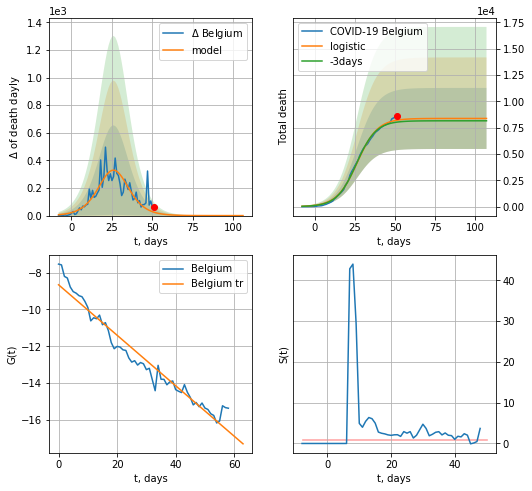

Belgium data at: 2020-05-09
+3 day model MAPE: 0.023340265115372676
model: logistic
coeffs:  [8.37390038e+03 1.57429585e-01 2.64046446e+01]
rational stdev:  0.3460258537264337
forecast at the end of period: +56 days
	 total death:  8373 ± 2897
trend coefficient of determination: 0.949938
 intercept: -8.657937
 slope: -0.137249


In [229]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,14*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


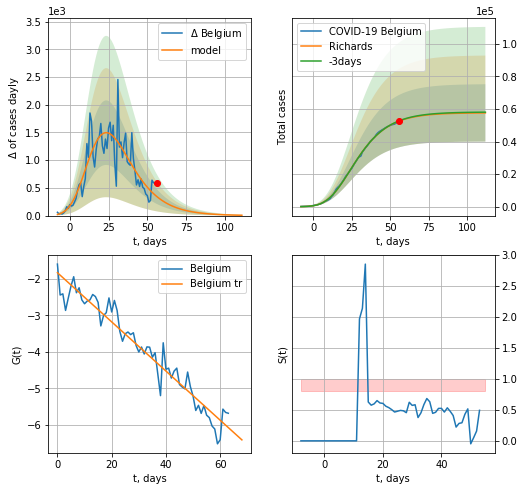

Belgium data at: 2020-05-09
+3 day model MAPE: 0.003555
model: Richards
coeffs: [ 5.76895932e+04  6.82757807e-01 -5.86358820e+00  1.08843489e-01]
rational stdev: 0.305844
forecast at the end of period: +56 days
	 deltaDaycases: 6
	 total cases: 57606 ± 17618
	 total death: 9398 ± 8622
trend coefficient of determination: 0.935437
 intercept: -1.829439
 slope: -0.067388


In [230]:
x = forecastRR('Belgium',dfBG[5:],d1,14*7-dT,addpred=False,xcoef=[0.25,1.,2.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


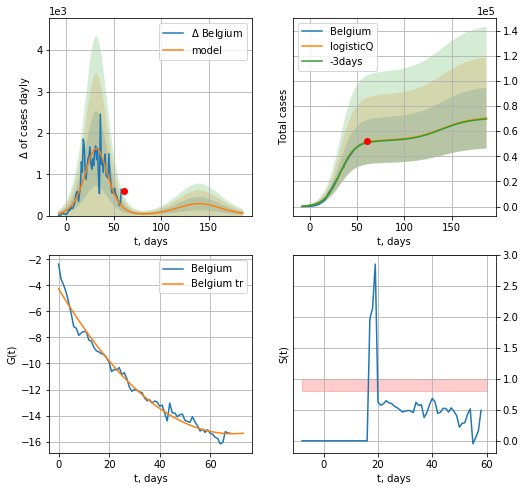

Belgium data at: 2020-05-09
+3 day model MAPE: 0.009395
model: logisticQ
coeffs: [ 5.27006817e+04  1.45590987e-06  3.21471124e+01 -8.44719033e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.343677
forecast at the end of period: +126 days
	 deltaDaycases: 58
	 total cases: 70393 ± 24192
	 total death: 11484 ± 11840
trend coefficient of determination: 0.979275
 intercept_: -4.259320990195651
 coeffs_: [ 0.         -0.32390604  0.00235525]


In [231]:
x = forecastRRR('Belgium',dfBG[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

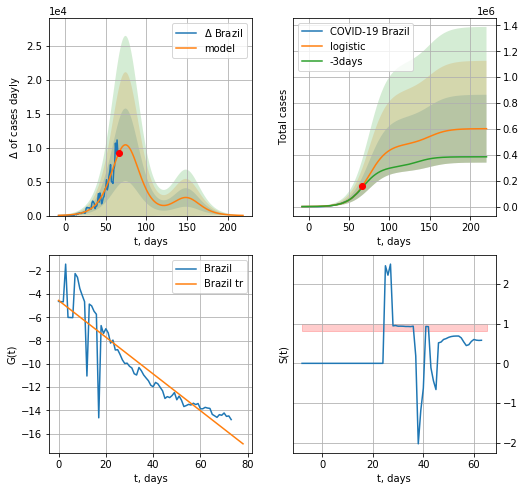

Brazil data at: 2020-05-09
+3 day model MAPE: 0.07157881040173228
model: logistic
coeffs:  [4.81602819e+05 8.63392834e-02 7.48268629e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.4354849614891905
forecast at the end of period: +154 days
	 deltaDaycases:  25
	 total cases:  601725 ± 262042
	 total death:  41086 ± 53677
trend coefficient of determination: 0.833613
 intercept: -4.540068
 slope: -0.158159


In [233]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


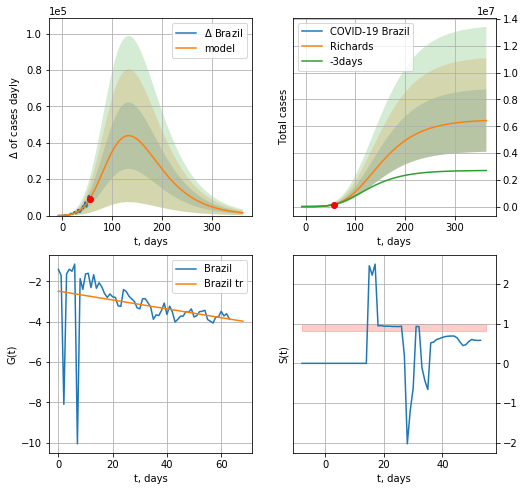

Brazil data at: 2020-05-09
+3 day model MAPE: 0.044789
model: Richards
coeffs: [6.50319044e+06 2.22431886e-01 5.58802137e+00 8.60954745e-02]
rational stdev: 0.362790
forecast at the end of period: +308 days
	 deltaDaycases: 1506
	 total cases: 6424773 ± 2330840
	 total death: 438689 ± 477455
trend coefficient of determination: 0.092827
 intercept: -2.486087
 slope: -0.021924


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


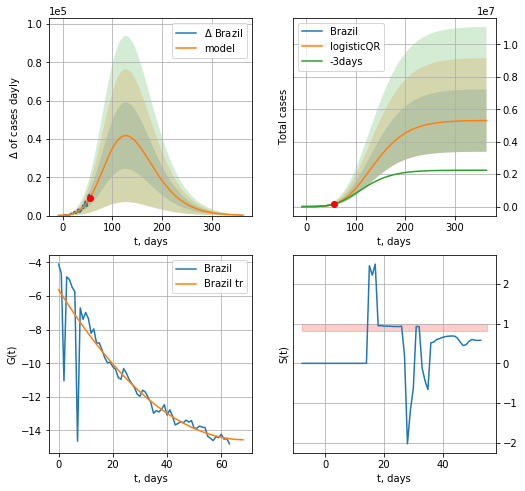

Brazil data at: 2020-05-09
+3 day model MAPE: 0.042359969877370354
model: logisticQR
coeffs:  [ 5.31363898e+06  1.81659963e-03 -2.71325452e+02 -2.71703235e+02
  1.49405918e-02]
rational stdev:  0.36265790755800614
forecast at the end of period: +308 days
	 deltaDaycases:  216
	 total cases:  5307470 ± 1924796
	 total death:  362399 ± 394280
trend coefficient of determination: 0.824988
 intercept_: -5.611538080645806
 coeffs_: [ 0.        -0.2592337  0.0018781]


In [234]:
x = forecastRR('Brazil',dfBZ[10:],d1,50*7-dT)
x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


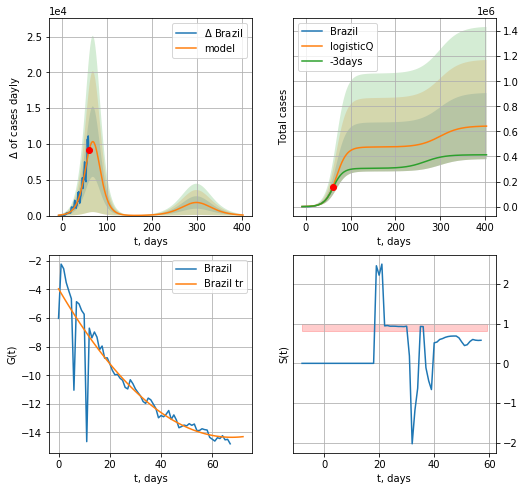

Brazil data at: 2020-05-09
+3 day model MAPE: 0.072278
model: logisticQ
coeffs: [ 4.75545422e+05  8.88385531e-06  6.85620552e+01 -9.71391216e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.410943
forecast at the end of period: +343 days
	 deltaDaycases: 78
	 total cases: 642177 ± 263898
	 total death: 43848 ± 54057
trend coefficient of determination: 0.856538
 intercept_: -3.955652845359074
 coeffs_: [ 0.         -0.3071708   0.00227228]


In [235]:
x = forecastRRR('Brazil',dfBZ[6:],d1,55*7-dT,addpred=True,xcoef=koreaCoeffs)

In [236]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

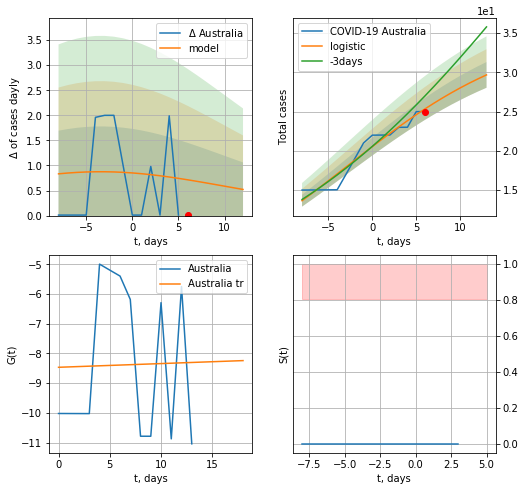

Australia data at: 2020-05-09
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  29 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


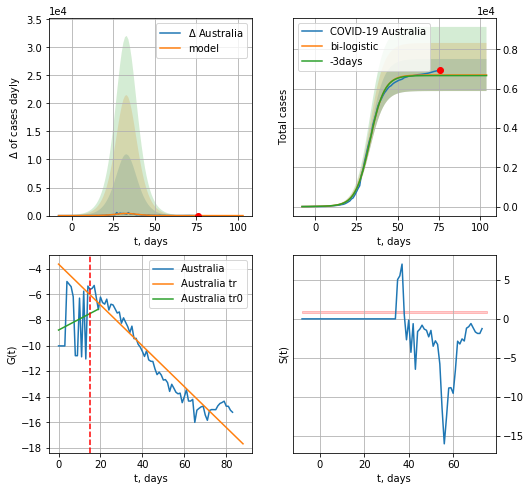

Australia data at: 2020-05-09
+3 day model MAPE: 0.004409321842666857
model: bi-logistic
coeffs:  [6.66122167e+03 2.28112422e-01 3.32680790e+01] [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.1216218885194079
forecast at the end of period: +28 days
	 deltaDaycases:  0
	 total cases:  6697 ± 814
	 total death:  93 ± 33
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.926901
 intercept: -3.635897
 slope: -0.159483


In [238]:
x = forecast('Australia',dfAS[:15],d1,7*7-dT,pMAPE=False)
xx = forecast2('Australia',dfAS[:],d1,10*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


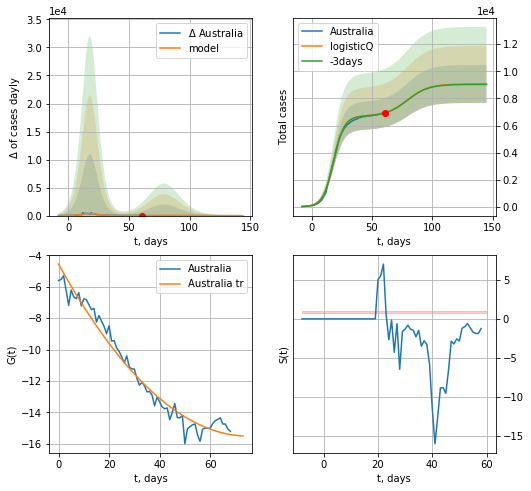

Australia data at: 2020-05-09
+3 day model MAPE: 0.004056
model: logisticQ
coeffs: [ 6.70068453e+03  2.28178843e-06  1.82137361e+01 -9.87426849e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.154489
forecast at the end of period: +84 days
	 deltaDaycases: 0
	 total cases: 9072 ± 1401
	 total death: 126 ± 58
trend coefficient of determination: 0.970196
 intercept_: -4.560538688716139
 coeffs_: [ 0.         -0.29093094  0.00193322]


In [240]:
x = forecastRRR('Australia',dfAS[15:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)

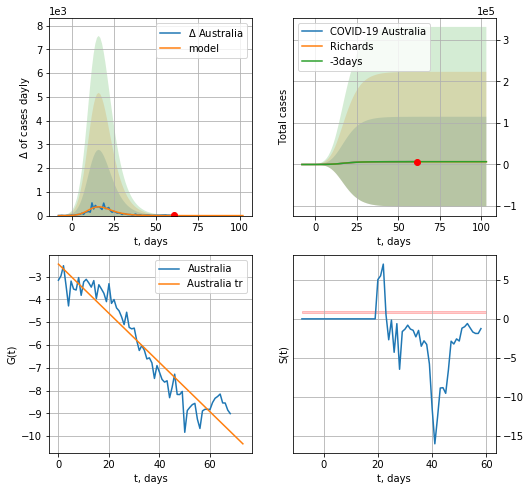

Australia data at: 2020-05-09
+3 day model MAPE: 0.004372
model: Richards
coeffs: [6.77033339e+03 5.70090773e-01 9.39794622e+00 2.99663624e-01]
rational stdev: 15.977991
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 6770 ± 108176
	 total death: 94 ± 4505
trend coefficient of determination: 0.912936
 intercept: -2.451735
 slope: -0.107998


In [241]:
x = forecastRR('Australia',dfAS[15:],d1,12*7-dT,addpred=False,xcoef=koreaCoeffs)

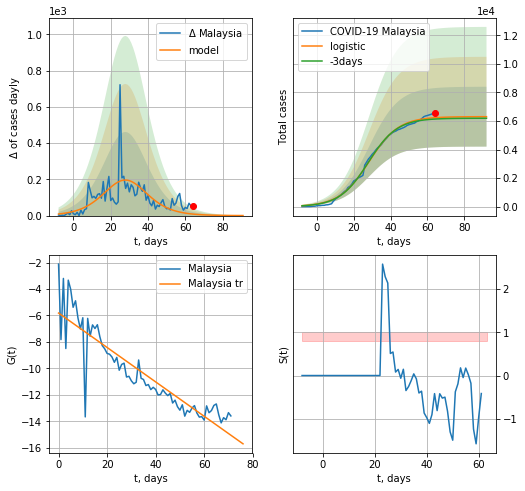

Malaysia data at: 2020-05-09
+3 day model MAPE: 0.01579444223101189
model: logistic
coeffs:  [6.30239106e+03 1.24603688e-01 2.83161117e+01]
rational stdev:  0.3327157400555568
forecast at the end of period: +28 days
	 deltaDaycases:  0
	 total cases:  6300 ± 2096
	 total death:  103 ± 102
trend coefficient of determination: 0.803023
 intercept: -5.819995
 slope: -0.130071


In [242]:
x = forecast('Malaysia',dfML[:],d1,10*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

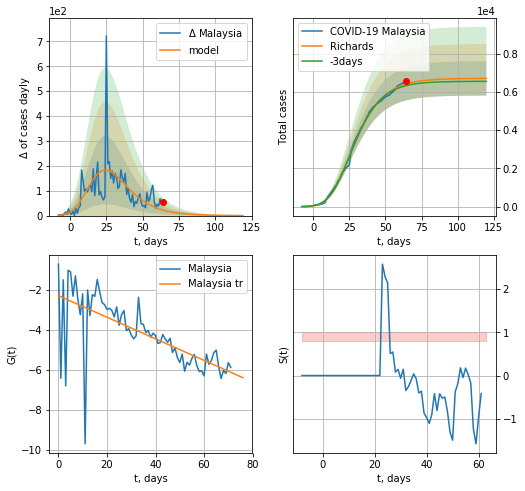

Malaysia data at: 2020-05-09
+3 day model MAPE: 0.013817
model: Richards
coeffs: [ 6.71251926e+03  6.46728982e-01 -2.03016674e+00  1.21421124e-01]
rational stdev: 0.133952
forecast at the end of period: +56 days
	 deltaDaycases: 0
	 total cases: 6708 ± 898
	 total death: 109 ± 43
trend coefficient of determination: 0.449387
 intercept: -2.283111
 slope: -0.053920


In [243]:
x = forecastRR('Malaysia',dfML[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


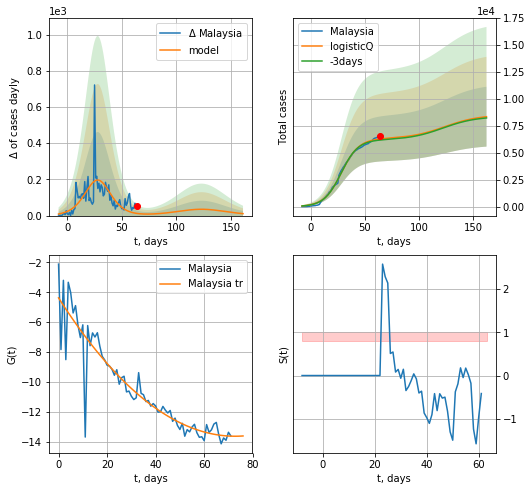

Malaysia data at: 2020-05-09
+3 day model MAPE: 0.015833
model: logisticQ
coeffs: [ 6.30213701e+03  1.00924092e-06  2.83159519e+01 -1.23412633e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.332799
forecast at the end of period: +98 days
	 deltaDaycases: 10
	 total cases: 8351 ± 2779
	 total death: 136 ± 135
trend coefficient of determination: 0.853011
 intercept_: -4.375122785576974
 coeffs_: [ 0.         -0.25393352  0.00174466]


In [244]:
x = forecastRRR('Malaysia',dfML[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
          date   cases  active  death
67 2020-05-05  1488.0     151   21.0
68 2020-05-06  1489.0     136   21.0
69 2020-05-07  1490.0     122   21.0
70 2020-05-08  1492.0     103   21.0
71 2020-05-09  1494.0     102   21.0


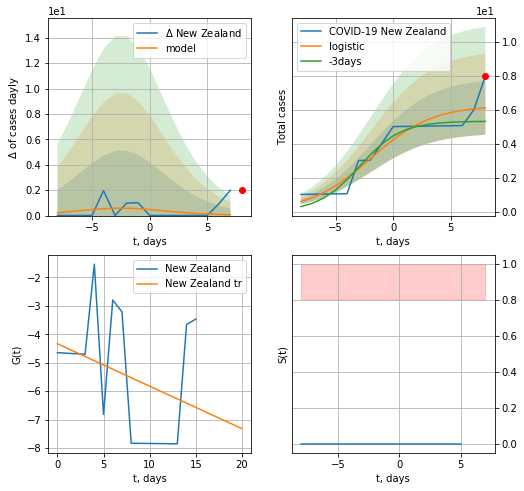

New Zealand data at: 2020-05-09
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +0 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


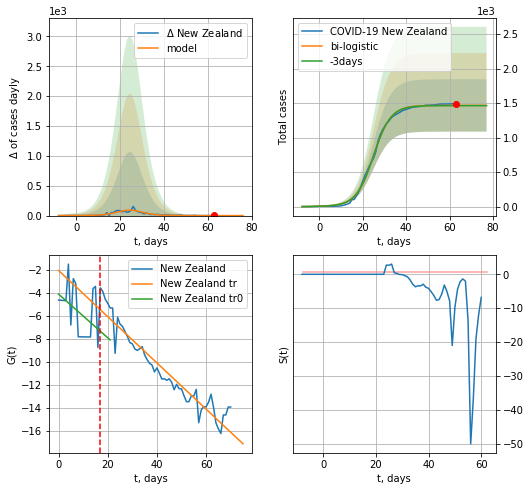

New Zealand data at: 2020-05-09
+3 day model MAPE: 0.002436243438717255
model: bi-logistic
coeffs:  [1.46125000e+03 2.50902123e-01 2.49287915e+01] [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.2584767620992575
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  1467 ± 379
	 total death:  20 ± 15
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.914210
 intercept: -2.080058
 slope: -0.200439


In [245]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
x = forecast('New Zealand',dfZL[:vL],d1,6*7-dT,pMAPE=False)
xx = forecast2('New Zealand',dfZL[:],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#

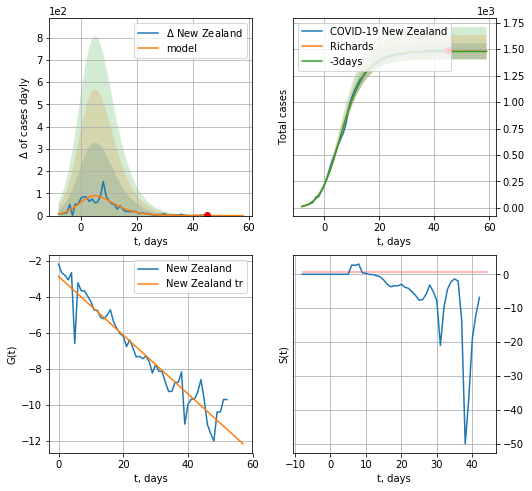

New Zealand data at: 2020-05-09
+3 day model MAPE: 0.001715
model: Richards
coeffs: [1.48051202e+03 4.68770743e-01 1.18833483e+00 4.20317821e-01]
rational stdev: 0.051744
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 1480 ± 76
	 total death: 20 ± 3
trend coefficient of determination: 0.914984
 intercept: -2.860241
 slope: -0.162892


In [246]:
x = forecastRR('New Zealand',dfZL[18:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


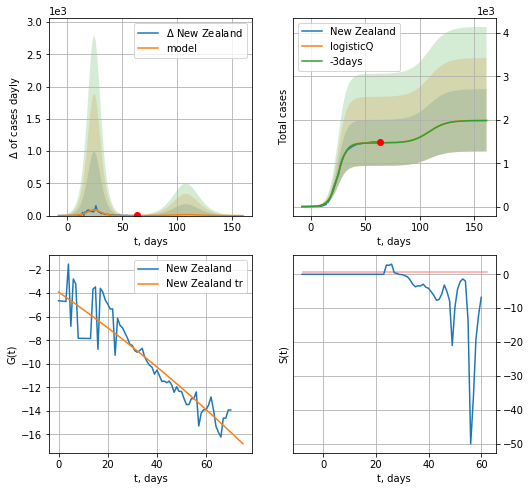

New Zealand data at: 2020-05-09
+3 day model MAPE: 0.002405
model: logisticQ
coeffs: [ 1.46814946e+03  3.64168458e-06  2.48853448e+01 -6.81641270e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.361241
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 1987 ± 717
	 total death: 27 ± 29
trend coefficient of determination: 0.861027
 intercept_: -3.903998668158285
 coeffs_: [ 0.         -0.14475959 -0.00036157]


In [248]:
x = forecastRRR('New Zealand',dfZL[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
          date    cases  active  death
67 2020-05-05  18350.0   14472  107.0
68 2020-05-06  19255.0   14755  112.0
69 2020-05-07  20168.0   14985  116.0
70 2020-05-08  21101.0   15496  121.0
71 2020-05-09  22052.0   15876  126.0


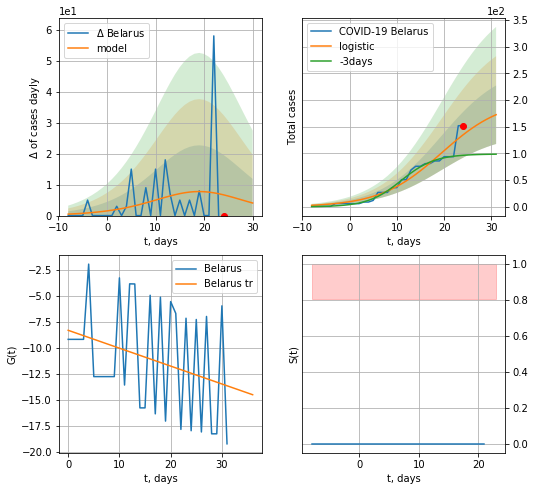

Belarus data at: 2020-05-09
+3 day model MAPE: 0.45662004942481244
model: logistic
coeffs:  [2.01843698e+02 1.53900219e-01 1.94560978e+01]
rational stdev:  0.31755857499649554
forecast at the end of period: +7 days
	 deltaDaycases:  4
	 total cases:  172 ± 54
	 total death:  0 ± 0
trend coefficient of determination: 0.089858
 intercept: -8.339930
 slope: -0.172092


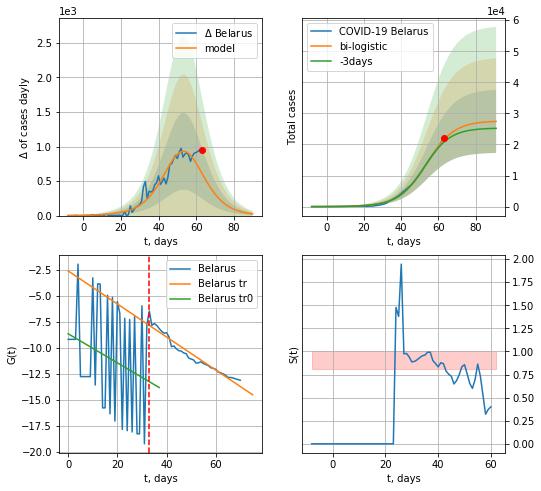

Belarus data at: 2020-05-09
+3 day model MAPE: 0.041695248031667374
model: bi-logistic
coeffs:  [2.73795250e+04 1.36154925e-01 5.37378591e+01] [2.01843698e+02 1.53900219e-01 1.94560978e+01]
rational stdev:  0.3698461197023277
forecast at the end of period: +28 days
	 deltaDaycases:  24
	 total cases:  27411 ± 10137
	 total death:  156 ± 173
bi-logistic approximation splitting point: 33
trend0 coefficient of determination: 0.064228
 intercept: -8.674644
 slope: -0.139700
trend coefficient of determination: 0.943735
 intercept: -2.631723
 slope: -0.158804


In [250]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:33],d1,7*7-dT)
xx = forecast2('Belarus',dfBR[:],d1,10*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=33)

BR
          date    cases  active  death
67 2020-05-05  18350.0   14472  107.0
68 2020-05-06  19255.0   14755  112.0
69 2020-05-07  20168.0   14985  116.0
70 2020-05-08  21101.0   15496  121.0
71 2020-05-09  22052.0   15876  126.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:131: RuntimeWarning: invalid value encountered in true_divide


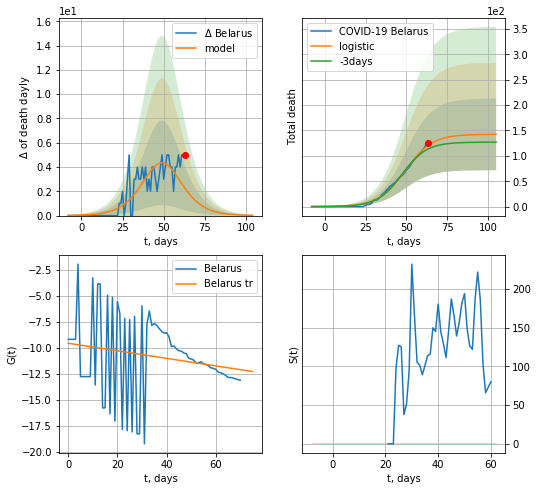

Belarus data at: 2020-05-09
+3 day model MAPE: 0.06522770847267108
model: logistic
coeffs:  [1.42438311e+02 1.22078462e-01 4.94112581e+01]
rational stdev:  0.4958449242581411
forecast at the end of period: +42 days
	 total death:  142 ± 70
trend coefficient of determination: 0.038003
 intercept: -9.587554
 slope: -0.036255


In [251]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,12*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


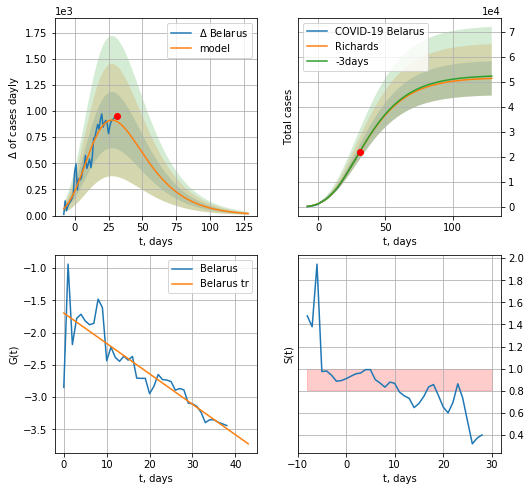

Belarus data at: 2020-05-09
+3 day model MAPE: 0.003146
model: Richards
coeffs: [ 5.17747838e+04  1.64323948e+00 -4.42444261e+01  2.96332173e-02]
rational stdev: 0.133320
forecast at the end of period: +98 days
	 deltaDaycases: 18
	 total cases: 51397 ± 6852
	 total death: 293 ± 117
trend coefficient of determination: 0.772998
 intercept: -1.696024
 slope: -0.047132


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


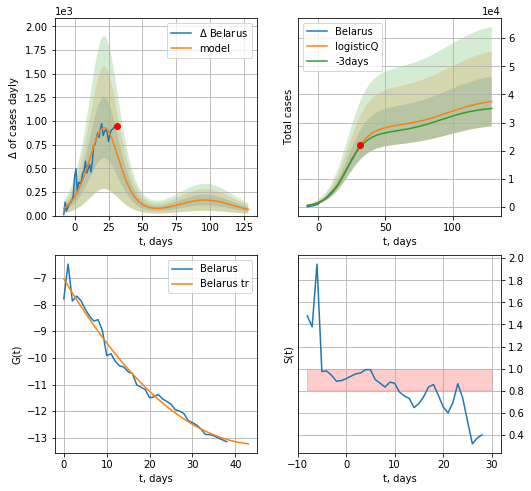

Belarus data at: 2020-05-09
+3 day model MAPE: 0.033755
model: logisticQ
coeffs: [ 2.84802179e+04  5.31082074e-06  2.21670580e+01 -2.44475621e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.235573
forecast at the end of period: +98 days
	 deltaDaycases: 64
	 total cases: 37482 ± 8829
	 total death: 214 ± 151
trend coefficient of determination: 0.980531
 intercept_: -7.037321098897282
 coeffs_: [ 0.         -0.26948894  0.0029219 ]


In [252]:
x = forecastRR('Belarus',dfBR[32:],d1,20*7-dT)
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


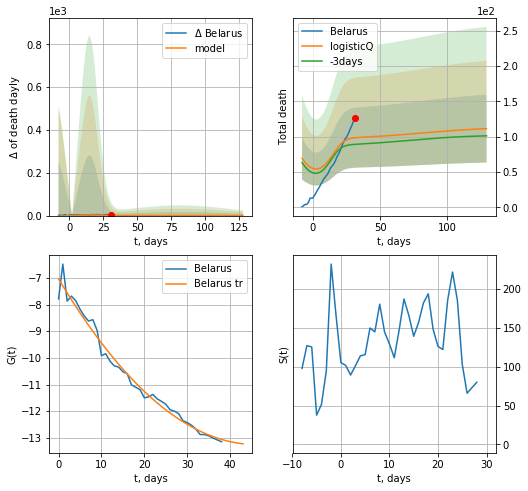

Belarus data at: 2020-05-09
+3 day model MAPE: 0.105230
model: logisticQ
coeffs: [ 8.37494336e+01  6.67477560e-03  6.00015984e+00 -1.04594533e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430866
forecast at the end of period: +98 days
	 total death: 111 ± 48
trend coefficient of determination: 0.980531
 intercept_: -7.037321098897282
 coeffs_: [ 0.         -0.26948894  0.0029219 ]


In [256]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

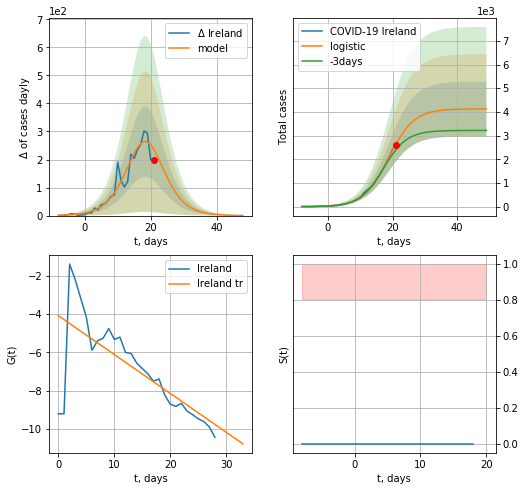

Ireland data at: 2020-05-09
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +28 days
	 deltaDaycases:  0
	 total cases:  4125 ± 1154
	 total death:  262 ± 219
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


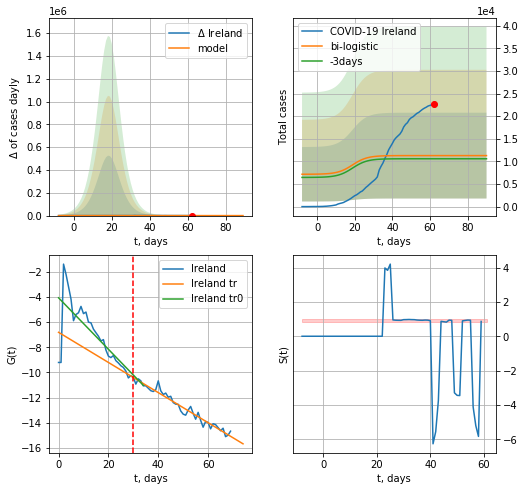

Ireland data at: 2020-05-09
+3 day model MAPE: 0.06625265259031538
model: bi-logistic
coeffs:  [5723.45839399   -6.21257461  163.6650948 ] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.84079630623573
forecast at the end of period: +28 days
	 deltaDaycases:  0
	 total cases:  11281 ± 9485
	 total death:  716 ± 1806
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.956406
 intercept: -6.812721
 slope: -0.119865


In [257]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,10*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


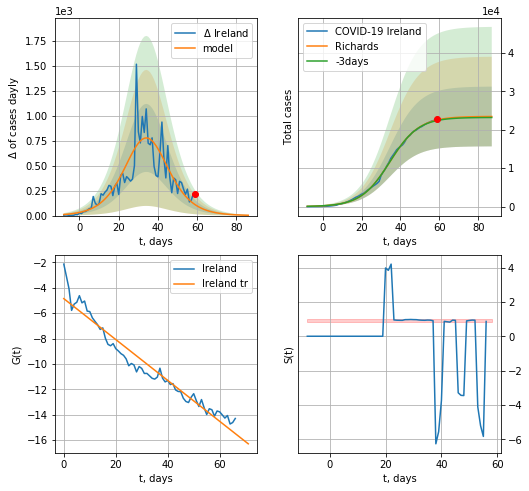

Ireland data at: 2020-05-09
+3 day model MAPE: 0.007114
model: Richards
coeffs: [2.34612817e+04 1.36120548e-01 3.42314606e+01 9.63001417e-01]
rational stdev: 0.331388
forecast at the end of period: +28 days
	 deltaDaycases: 3
	 total cases: 23437 ± 7766
	 total death: 1489 ± 1480
trend coefficient of determination: 0.945116
 intercept: -4.853601
 slope: -0.161276


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


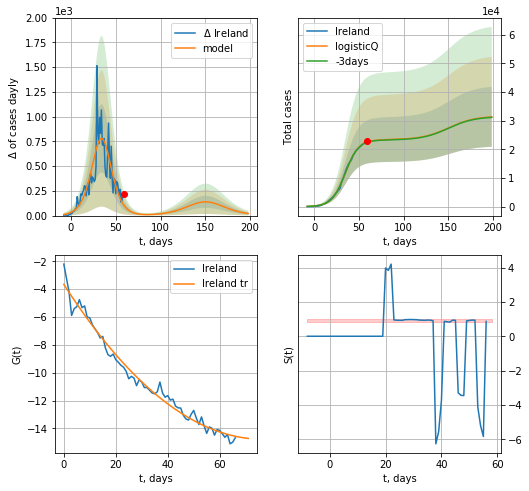

Ireland data at: 2020-05-09
+3 day model MAPE: 0.004861
model: logisticQ
coeffs: [ 2.33795986e+04  1.01546135e-05  3.45896209e+01 -1.31210001e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.333973
forecast at the end of period: +140 days
	 deltaDaycases: 20
	 total cases: 31346 ± 10468
	 total death: 1991 ± 1994
trend coefficient of determination: 0.981086
 intercept_: -3.6513742740888286
 coeffs_: [ 0.         -0.29038539  0.00189339]


In [258]:
x = forecastRR('Ireland',dfIR[3:],d1,10*7-dT)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

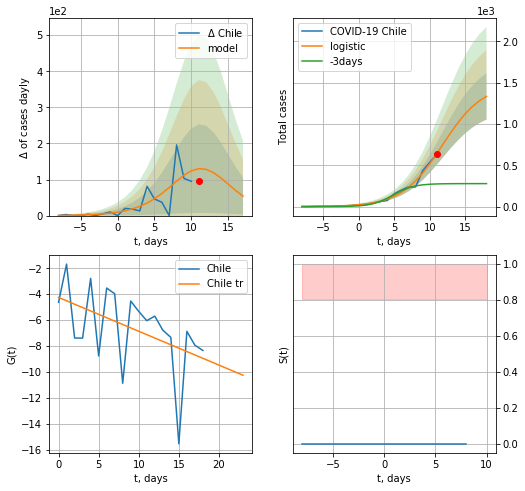

Chile data at: 2020-05-09
+3 day model MAPE: 1.7934705345739388
model: logistic
coeffs:  [1.48202088e+03 3.52936511e-01 1.17607351e+01]
rational stdev:  0.2100967778814968
forecast at the end of period: +7 days
	 deltaDaycases:  53
	 total cases:  1334 ± 280
	 total death:  14 ± 8
trend coefficient of determination: 0.220917
 intercept: -4.249067
 slope: -0.261154


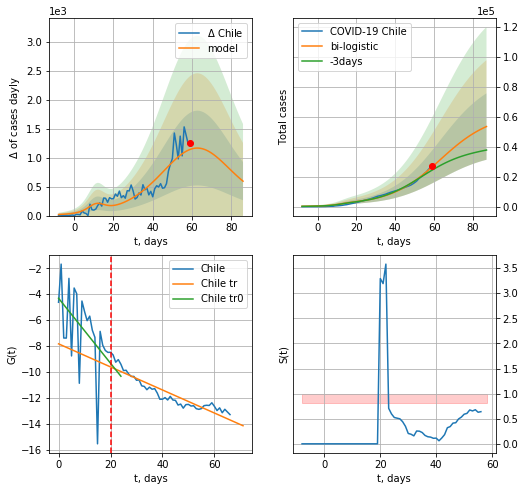

Chile data at: 2020-05-09
+3 day model MAPE: 0.09985350320816366
model: bi-logistic
coeffs:  [5.90685890e+04 7.84915546e-02 6.30272325e+01] [1.48202088e+03 3.52936511e-01 1.17607351e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.41471720310584576
forecast at the end of period: +28 days
	 deltaDaycases:  595
	 total cases:  53399 ± 22145
	 total death:  596 ± 741
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.233377
 intercept: -4.310588
 slope: -0.250901
trend coefficient of determination: 0.865211
 intercept: -7.833144
 slope: -0.089008


In [260]:
vL=20
x = forecast('Chile',dfCL[:vL],d1,7*7-dT)
xx = forecast2('Chile',dfCL[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


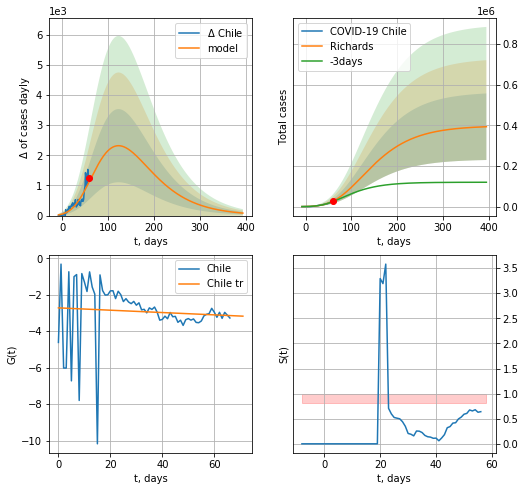

Chile data at: 2020-05-09
+3 day model MAPE: 0.082414
model: Richards
coeffs: [ 3.98383549e+05  8.52087863e-01 -1.25348670e+02  1.87574685e-02]
rational stdev: 0.416563
forecast at the end of period: +336 days
	 deltaDaycases: 82
	 total cases: 393227 ± 163803
	 total death: 4391 ± 5487
trend coefficient of determination: 0.006174
 intercept: -2.718697
 slope: -0.006406


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


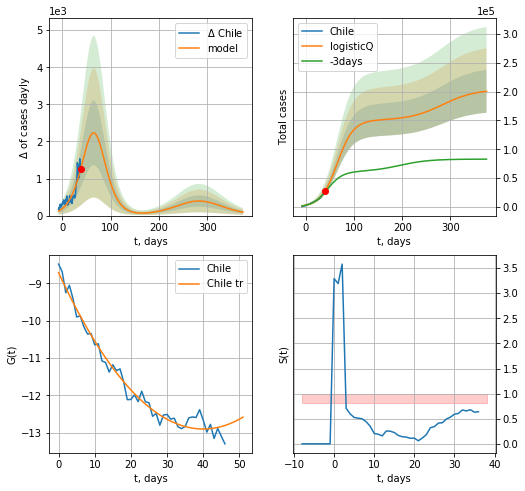

Chile data at: 2020-05-09
+3 day model MAPE: 0.075675
model: logisticQ
coeffs: [ 1.50473117e+05  9.55704265e-06  6.49991918e+01 -6.13530392e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.185432
forecast at the end of period: +336 days
	 deltaDaycases: 93
	 total cases: 200452 ± 37170
	 total death: 2238 ± 1244
trend coefficient of determination: 0.975936
 intercept_: -8.710426326032703
 coeffs_: [ 0.         -0.20944197  0.00261866]


In [263]:
x = forecastRR('Chile',dfCL[:],d1,54*7-dT)
x = forecastRRR('Chile',dfCL[20:],d1,54*7-dT,addpred=True,xcoef=koreaCoeffs)

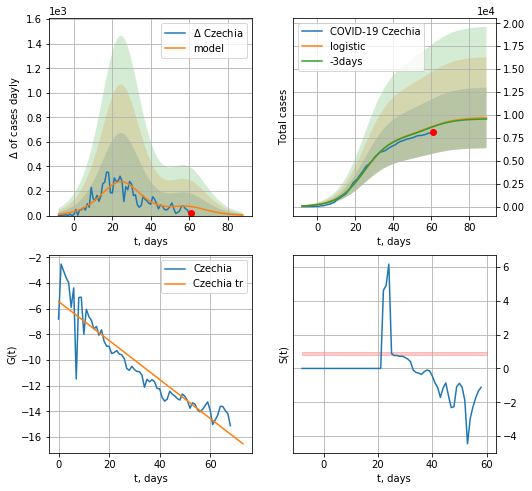

Czechia data at: 2020-05-09
+3 day model MAPE: 0.0070186221373209874
model: logistic
coeffs:  [7.76829070e+03 1.41456302e-01 2.48502842e+01]
scenario coeffs:  [0.25, 1.0, 2.4]
rational stdev:  0.3418538794556706
forecast at the end of period: +28 days
	 deltaDaycases:  4
	 total cases:  9679 ± 3308
	 total death:  330 ± 338
trend coefficient of determination: 0.867471
 intercept: -5.439781
 slope: -0.151785


In [264]:
x = forecast('Czechia',dfCH[:],d1,10*7-dT,shift=1.,addpred=True,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


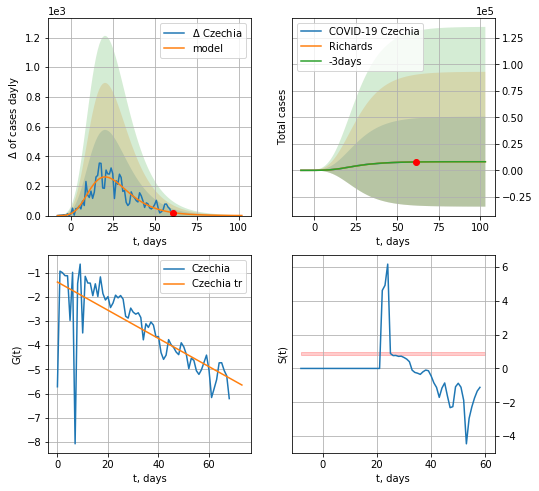

Czechia data at: 2020-05-09
+3 day model MAPE: 0.006242
model: Richards
coeffs: [ 8.19811702e+03  7.89300333e+00 -3.09001151e+01  1.10195319e-02]
rational stdev: 5.179726
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 8191 ± 42430
	 total death: 279 ± 4335
trend coefficient of determination: 0.534123
 intercept: -1.389547
 slope: -0.058314


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


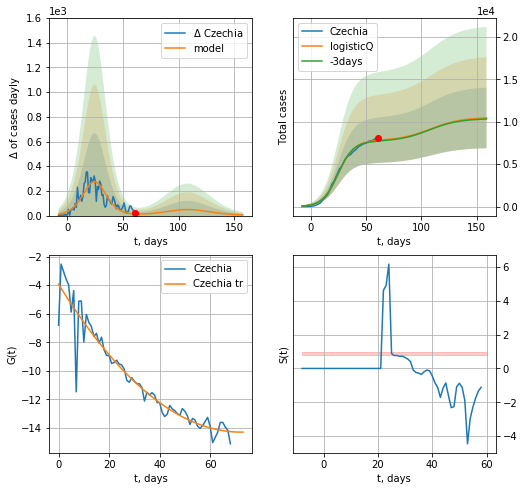

Czechia data at: 2020-05-09
+3 day model MAPE: 0.012806
model: logisticQ
coeffs: [ 7.76811401e+03  9.21480655e-07  2.48502631e+01 -1.53437692e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.341953
forecast at the end of period: +98 days
	 deltaDaycases: 5
	 total cases: 10446 ± 3572
	 total death: 356 ± 365
trend coefficient of determination: 0.914586
 intercept_: -3.933536248804055
 coeffs_: [ 0.         -0.28669447  0.00198411]


In [265]:
x = forecastRR('Czechia',dfCH[:],d1,12*7-dT)
x = forecastRRR('Czechia',dfCH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

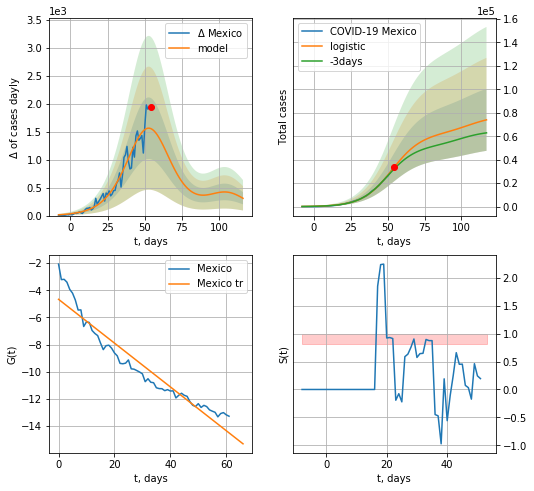

Mexico data at: 2020-05-09
+3 day model MAPE: 0.04748114922271091
model: logistic
coeffs:  [6.23866109e+04 9.99188844e-02 5.29744759e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.35701786790993106
forecast at the end of period: +63 days
	 deltaDaycases:  309
	 total cases:  73996 ± 26418
	 total death:  7415 ± 7941
trend coefficient of determination: 0.920959
 intercept: -4.668137
 slope: -0.161031


In [266]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


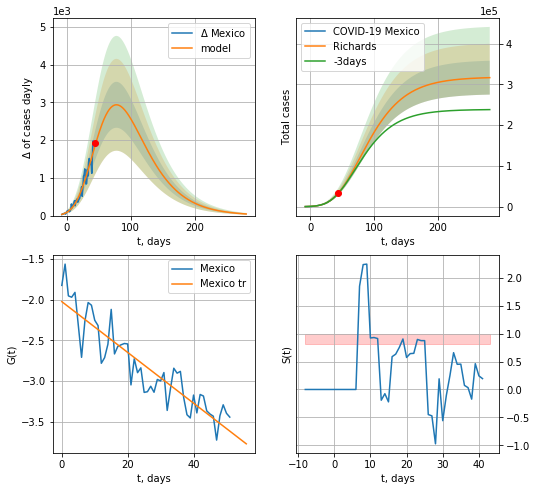

Mexico data at: 2020-05-09
+3 day model MAPE: 0.012955
model: Richards
coeffs: [ 3.17897035e+05  4.50769964e-01 -3.25489412e+01  5.73342632e-02]
rational stdev: 0.131145
forecast at the end of period: +238 days
	 deltaDaycases: 42
	 total cases: 316267 ± 41476
	 total death: 31692 ± 12468
trend coefficient of determination: 0.831642
 intercept: -2.025262
 slope: -0.031236


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


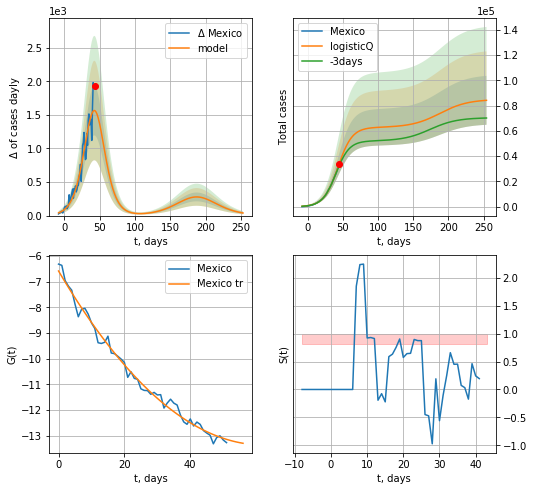

Mexico data at: 2020-05-09
+3 day model MAPE: 0.047439
model: logisticQ
coeffs: [ 6.27572376e+04  9.17708781e-06  4.30849255e+01 -1.08299658e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.229969
forecast at the end of period: +210 days
	 deltaDaycases: 38
	 total cases: 84204 ± 19364
	 total death: 8438 ± 5821
trend coefficient of determination: 0.989409
 intercept_: -6.590574066318244
 coeffs_: [ 0.         -0.21752878  0.00174763]


In [267]:
x = forecastRR('Mexico',dfMX[10:],d1,40*7-dT,addpred=False,xcoef=[.25,1.,2.])#
x = forecastRRR('Mexico',dfMX[10:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
          date   cases  active  death     tests
57 2020-05-05  1428.0     662   48.0  156493.0
58 2020-05-06  1433.0     645   49.0  164088.0
59 2020-05-07  1436.0     622   49.1  172191.0
60 2020-05-08  1444.0     563   49.2  180332.0
61 2020-05-09  1444.0     567   49.0       NaN


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:478: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

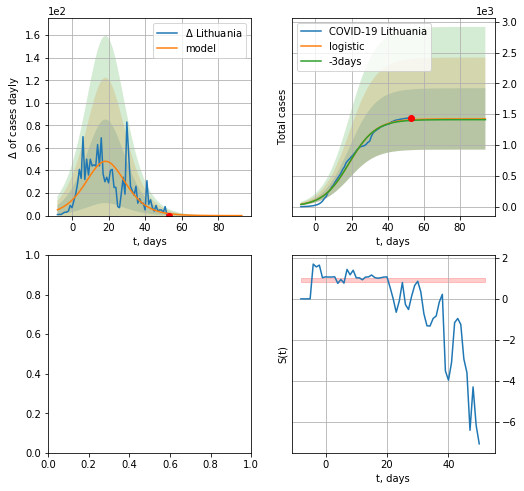

In [268]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
x = forecast('Lithuania',dfLT[:],d1,6*7-1)
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

LT
          date   cases  active  death     tests
56 2020-05-04  1423.0     678   46.0  149106.0
57 2020-05-05  1428.0     662   48.0  156493.0
58 2020-05-06  1433.0     645   49.0  164088.0
59 2020-05-07  1436.0     622   49.1  172191.0
60 2020-05-08  1444.0     563   49.2  180332.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


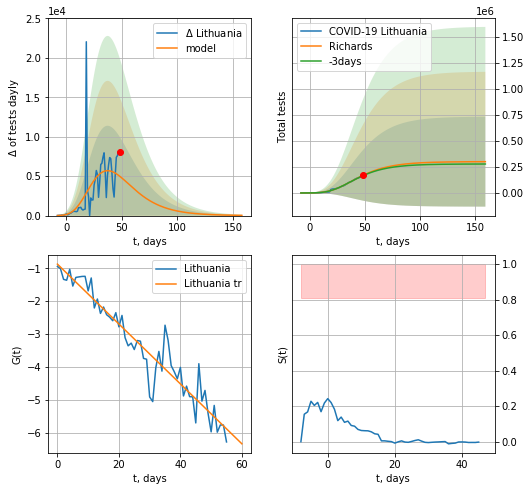

Lithuania data at: 2020-05-08
+3 day model MAPE: 0.018229
model: Richards
coeffs: [ 3.00815169e+05  3.43413490e+00 -4.32342884e+01  1.50973471e-02]
rational stdev: 1.436241
forecast at the end of period: +111 days
	 total tests: 300258 ± 431243
trend coefficient of determination: 0.912173
 intercept: -0.871954
 slope: -0.091104


In [409]:
dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)
x = forecastRR('Lithuania',dfLT[3:-1],d1,16*7-1,cases='tests')
#plt.grid()

In [410]:
#np.diff(dfLT["cases"])

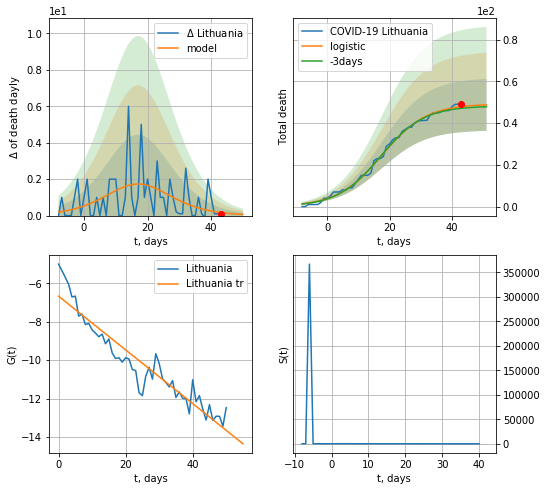

Lithuania data at: 2020-05-08
+3 day model MAPE: 0.01678615172713022
model: logistic
coeffs:  [49.20103137  0.14094009 17.52012281]
rational stdev:  0.2552730158236092
forecast at the end of period: +8 days
	 total death:  48 ± 12
trend coefficient of determination: 0.893478
 intercept: -6.671252
 slope: -0.139698


In [411]:
x = forecast('Lithuania',dfLT[9:],d1,7*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


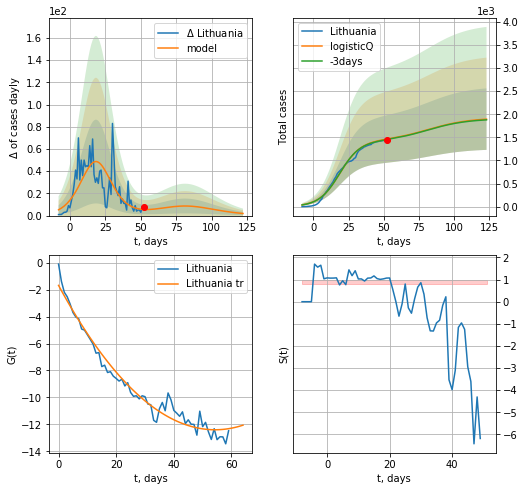

Lithuania data at: 2020-05-08
+3 day model MAPE: 0.007864
model: logisticQ
coeffs: [ 1.41997026e+03  8.23758448e-07  1.87716829e+01 -1.65022416e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.351442
forecast at the end of period: +71 days
	 deltaDaycases: 1
	 total cases: 1894 ± 665
	 total death: 64 ± 67
trend coefficient of determination: 0.967195
 intercept_: -1.6847406455830347
 coeffs_: [ 0.         -0.39461988  0.00363381]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


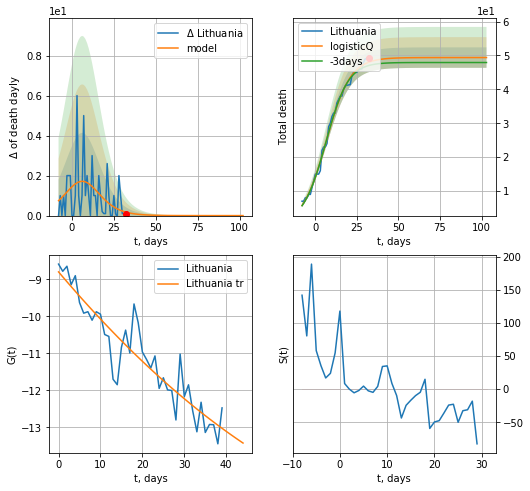

Lithuania data at: 2020-05-08
+3 day model MAPE: 0.021534
model: logisticQ
coeffs: [ 4.93773716e+01  9.49143597e-06  6.58533441e+00 -1.46290814e+04]
rational stdev: 0.061083
forecast at the end of period: +71 days
	 total death: 49 ± 3
trend coefficient of determination: 0.854025
 intercept_: -8.800966110474116
 coeffs_: [ 0.         -0.13367474  0.00065237]


In [412]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


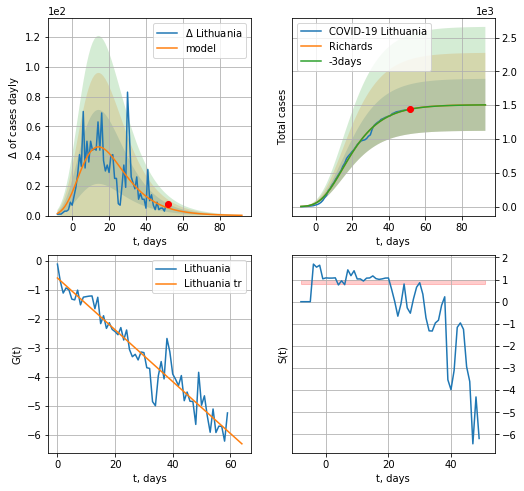

Lithuania data at: 2020-05-08
+3 day model MAPE: 0.000372
model: Richards
coeffs: [ 1.50739741e+03  1.12694124e+01 -4.38264719e+01  7.42601333e-03]
rational stdev: 0.255343
forecast at the end of period: +41 days
	 deltaDaycases: 0
	 total cases: 1505 ± 384
	 total death: 51 ± 39
trend coefficient of determination: 0.920642
 intercept: -0.584754
 slope: -0.089583


In [413]:
x = forecastRR('Lithuania',dfLT[:],d1,6*7-1)
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


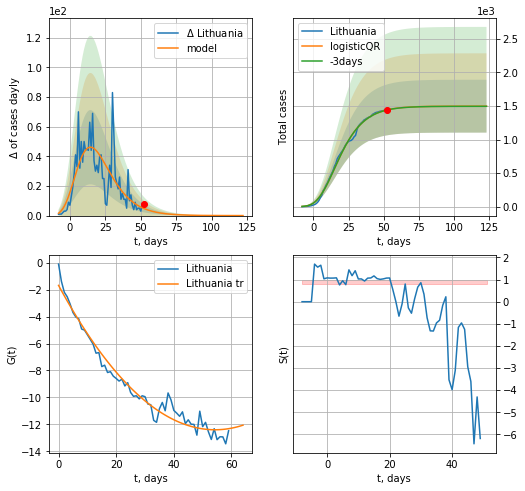

Lithuania data at: 2020-05-08
+3 day model MAPE: 0.0009626803794984396
model: logisticQR
coeffs:  [ 1.49739389e+03  4.97549100e-02 -6.87334578e+01 -9.65112644e+02
  1.58541147e-03]
rational stdev:  0.26306010841913285
forecast at the end of period: +71 days
	 deltaDaycases:  0
	 total cases:  1497 ± 393
	 total death:  51 ± 40
trend coefficient of determination: 0.967195
 intercept_: -1.6847406455830347
 coeffs_: [ 0.         -0.39461988  0.00363381]


In [414]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
          date   cases  active  death
59 2020-05-05  3840.0     332   96.0
60 2020-05-06  3851.0     301   98.0
61 2020-05-07  3859.0     254  100.0
62 2020-05-08  3871.0     245  100.0
63 2020-05-09  3877.0     226  101.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


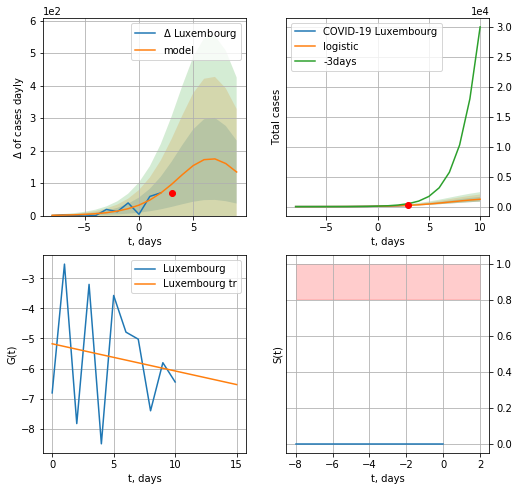

Luxembourg data at: 2020-05-09
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +7 days
	 deltaDaycases:  134
	 total cases:  1226 ± 394
	 total death:  31 ± 29
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


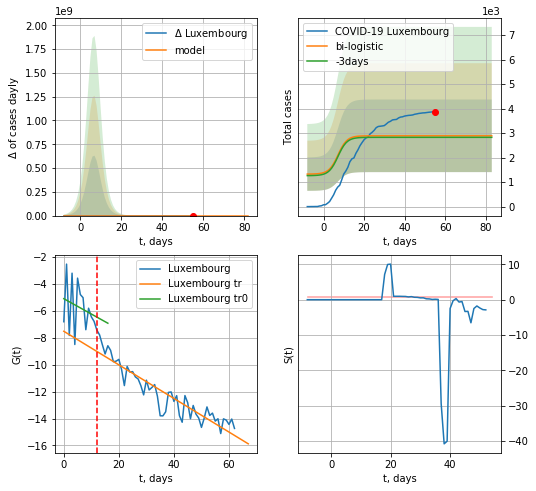

Luxembourg data at: 2020-05-09
+3 day model MAPE: 0.02203722970032891
model: bi-logistic
coeffs:  [1179.69019581   -5.27700672  213.43824224] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.5121822613338494
forecast at the end of period: +28 days
	 deltaDaycases:  0
	 total cases:  2890 ± 1480
	 total death:  75 ± 115
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.853470
 intercept: -7.518274
 slope: -0.124745


In [269]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,7*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,10*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


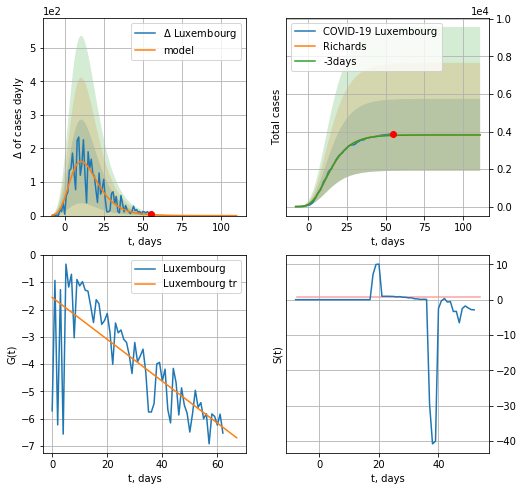

Luxembourg data at: 2020-05-09
+3 day model MAPE: 0.003821
model: Richards
coeffs: [ 3.83223101e+03  1.65022451e+01 -3.21311188e+01  6.96795523e-03]
rational stdev: 0.499694
forecast at the end of period: +56 days
	 deltaDaycases: 0
	 total cases: 3832 ± 1914
	 total death: 99 ± 148
trend coefficient of determination: 0.559165
 intercept: -1.560227
 slope: -0.076691


In [270]:
x = forecastRR("Luxembourg",dfLX[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


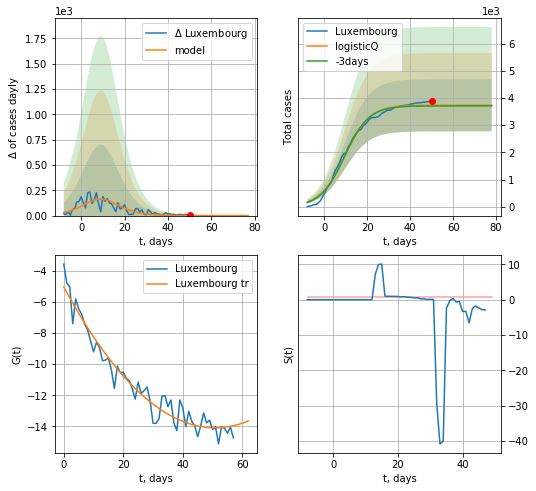

Luxembourg data at: 2020-05-09
+3 day model MAPE: 0.006920
model: logisticQ
coeffs: [ 3.73234673e+03  1.02359305e-06  9.49667263e+00 -1.70666937e+05]
rational stdev: 0.256987
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 3732 ± 959
	 total death: 97 ± 74
trend coefficient of determination: 0.946245
 intercept_: -5.036711932376882
 coeffs_: [ 0.         -0.35588722  0.00349976]


In [271]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,10*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
          date    cases   active   death
66 2020-05-05  23835.0  26879.0  1569.0
67 2020-05-06  27172.0  24369.0  1618.0
68 2020-05-07  27982.0  25211.0  1654.0
69 2020-05-08  28818.0  23681.0  1704.0
70 2020-05-09  29071.0  23921.0  1717.0


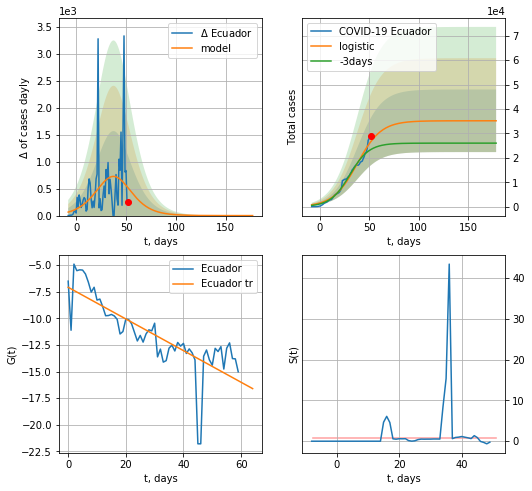

Ecuador data at: 2020-05-09
+3 day model MAPE: 0.15291584948594192
model: logistic
coeffs:  [3.51667361e+04 8.28085006e-02 3.79093021e+01]
rational stdev:  0.3643407982215925
forecast at the end of period: +126 days
	 deltaDaycases:  0
	 total cases:  35166 ± 12812
	 total death:  2077 ± 2270
trend coefficient of determination: 0.628012
 intercept: -7.091942
 slope: -0.148572


In [272]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[10:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


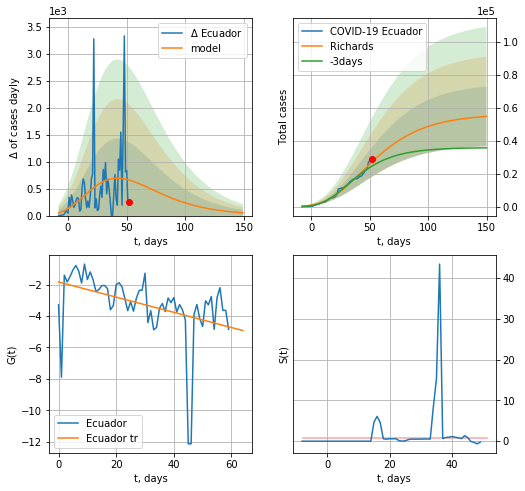

Ecuador data at: 2020-05-09
+3 day model MAPE: 0.109534
model: Richards
coeffs: [ 5.63262318e+04  3.61990365e+00 -9.63068474e+01  9.29682408e-03]
rational stdev: 0.330424
forecast at the end of period: +98 days
	 deltaDaycases: 50
	 total cases: 54824 ± 18115
	 total death: 3238 ± 3209
trend coefficient of determination: 0.164604
 intercept: -1.827284
 slope: -0.048379


In [273]:
x = forecastRR("Ecuador",dfED[10:],d1,20*7-dT,addpred=False,xcoef=[0.35,.5,4.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


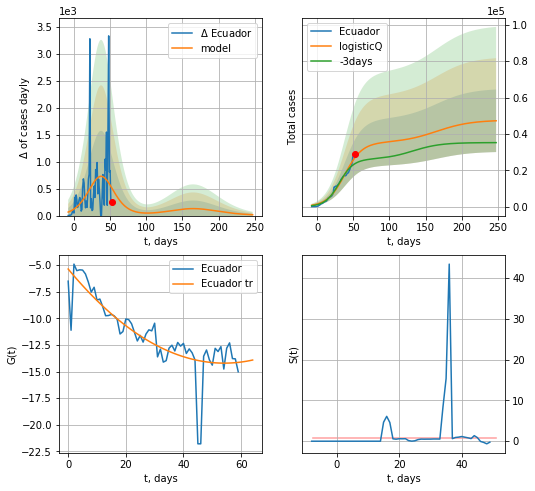

Ecuador data at: 2020-05-09
+3 day model MAPE: 0.150561
model: logisticQ
coeffs: [ 3.51502260e+04  7.64422534e-07  3.78971083e+01 -1.08310608e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.364330
forecast at the end of period: +196 days
	 deltaDaycases: 15
	 total cases: 47216 ± 17202
	 total death: 2788 ± 3047
trend coefficient of determination: 0.690047
 intercept_: -5.37499650629104
 coeffs_: [ 0.         -0.32622385  0.00301136]


In [274]:
x = forecastRRR("Ecuador",dfED[10:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
          date   cases  active  death
70 2020-05-05  5412.0    1666  246.0
71 2020-05-06  5573.0    1821  252.0
72 2020-05-07  5673.0    1918  255.0
73 2020-05-08  5738.0    1478  260.0
74 2020-05-09  5880.0    1615  265.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


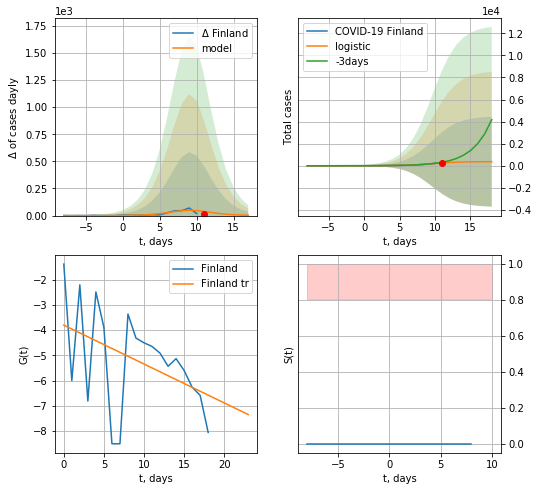

Finland data at: 2020-05-09
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +7 days
	 deltaDaycases:  2
	 total cases:  369 ± 4070
	 total death:  16 ± 529
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


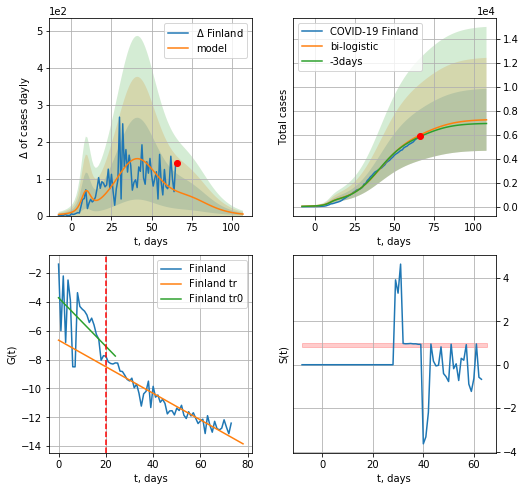

Finland data at: 2020-05-09
+3 day model MAPE: 0.02325823443461315
model: bi-logistic
coeffs:  [5.53308063e+03 1.08775621e-01 4.10979337e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.35685077082842015
forecast at the end of period: +42 days
	 deltaDaycases:  4
	 total cases:  7252 ± 2588
	 total death:  326 ± 349
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.898776
 intercept: -6.653251
 slope: -0.092063


In [276]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,7*7-dT)
xx = forecast2("Finland",dfFI[:],d1,12*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


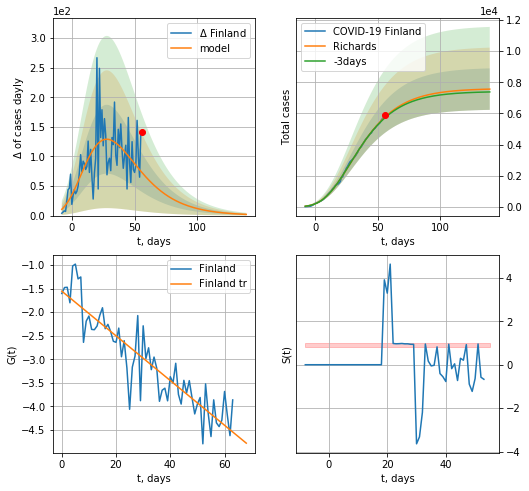

Finland data at: 2020-05-09
+3 day model MAPE: 0.008967
model: Richards
coeffs: [ 7.60131290e+03  2.92168395e+00 -6.05671007e+01  1.59362471e-02]
rational stdev: 0.176131
forecast at the end of period: +84 days
	 deltaDaycases: 1
	 total cases: 7559 ± 1331
	 total death: 340 ± 179
trend coefficient of determination: 0.815503
 intercept: -1.555638
 slope: -0.047385


In [277]:
x = forecastRR("Finland",dfFI[10:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


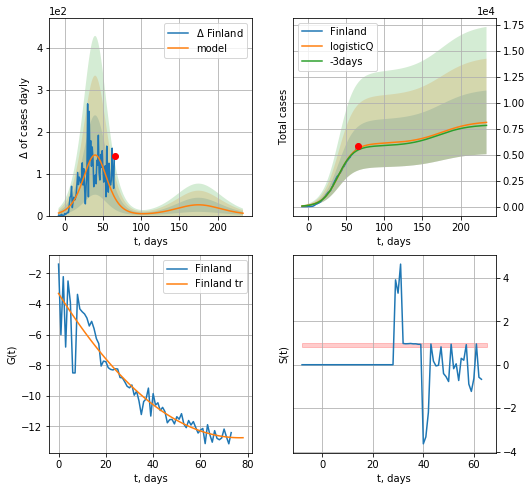

Finland data at: 2020-05-09
+3 day model MAPE: 0.026837
model: logisticQ
coeffs: [ 6.07869543e+03  1.05677179e-06  4.02094174e+01 -9.00417683e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.377925
forecast at the end of period: +168 days
	 deltaDaycases: 5
	 total cases: 8109 ± 3064
	 total death: 365 ± 413
trend coefficient of determination: 0.892519
 intercept_: -3.3042675774304158
 coeffs_: [ 0.         -0.24602932  0.00160397]


In [278]:
x = forecastRRR("Finland",dfFI[:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

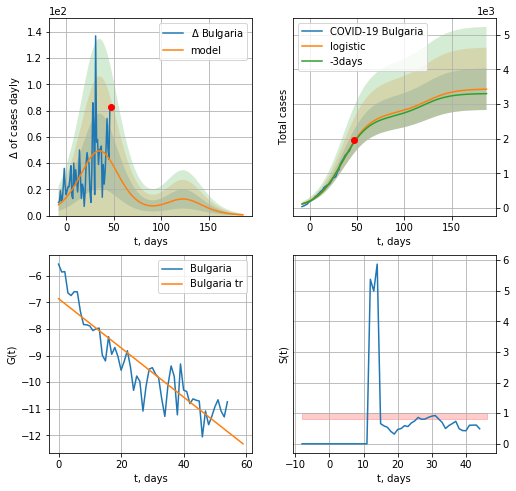

Bulgaria data at: 2020-05-09
+3 day model MAPE: 0.012241000064960431
model: logistic
coeffs:  [2.75054768e+03 7.16426952e-02 3.54506432e+01]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.17476930885204814
forecast at the end of period: +140 days
	 deltaDaycases:  0
	 total cases:  3430 ± 599
	 total death:  157 ± 82
trend coefficient of determination: 0.828372
 intercept: -6.860750
 slope: -0.092507


In [279]:
x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


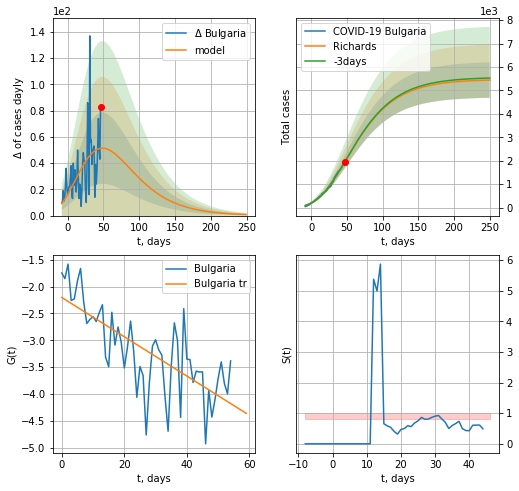

Bulgaria data at: 2020-05-09
+3 day model MAPE: 0.001765
model: Richards
coeffs: [ 5.47104322e+03  8.70810195e-01 -8.65469055e+01  2.97728207e-02]
rational stdev: 0.138958
forecast at the end of period: +203 days
	 deltaDaycases: 0
	 total cases: 5441 ± 756
	 total death: 250 ± 104
trend coefficient of determination: 0.537074
 intercept: -2.202971
 slope: -0.036588


In [280]:
x = forecastRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=False,xcoef=[0.25,1.,4.5])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


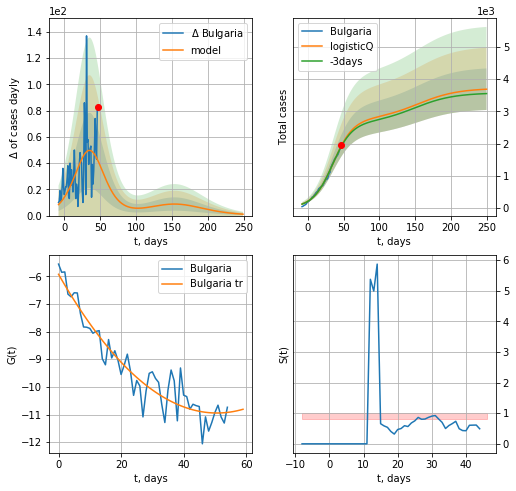

Bulgaria data at: 2020-05-09
+3 day model MAPE: 0.011824
model: logisticQ
coeffs: [ 2.74498204e+03  3.08658886e-06  3.53923959e+01 -2.32195489e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.174940
forecast at the end of period: +203 days
	 deltaDaycases: 1
	 total cases: 3687 ± 645
	 total death: 169 ± 88
trend coefficient of determination: 0.903023
 intercept_: -5.929558128455415
 coeffs_: [ 0.         -0.19795472  0.00195299]


In [281]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
          date  cases  active  death
68 2020-05-05   2989   173.0   55.0
69 2020-05-06   2992   165.0   55.0
70 2020-05-07   3000   161.0   55.0
71 2020-05-08   3004   161.0   56.0
72 2020-05-09   3009   159.0   56.0


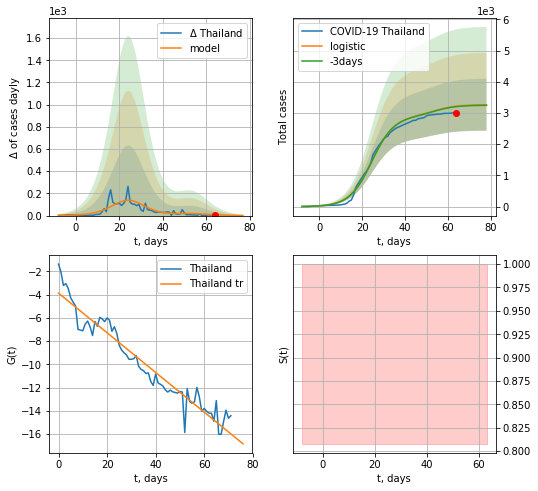

Thailand data at: 2020-05-09
+3 day model MAPE: 0.0053052943355034
model: logistic
coeffs:  [2.90555119e+03 1.91107488e-01 2.45845647e+01]
scenario coeffs:  [0.125, 1.0, 2.2]
rational stdev:  0.25446171386593225
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  3264 ± 830
	 total death:  60 ± 45
trend coefficient of determination: 0.929115
 intercept: -3.880417
 slope: -0.170331


In [282]:
dfTH = read_df(pd.DataFrame(),"TH")
x = forecast("Thailand",dfTH[:],d1,8*7-dT,addpred=True,xcoef=[0.25/2,1.,2.2])
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [283]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


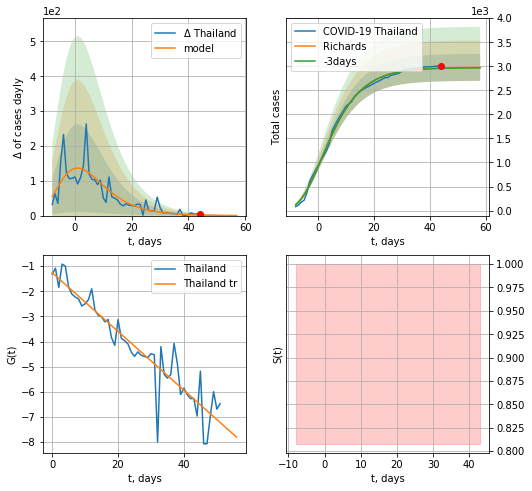

Thailand data at: 2020-05-09
+3 day model MAPE: 0.003154
model: Richards
coeffs: [ 2.97954321e+03  1.44986767e+01 -3.65531733e+01  8.63181841e-03]
rational stdev: 0.094211
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 2977 ± 280
	 total death: 55 ± 15
trend coefficient of determination: 0.869458
 intercept: -1.259140
 slope: -0.116939


In [284]:
x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/6,.5,4,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


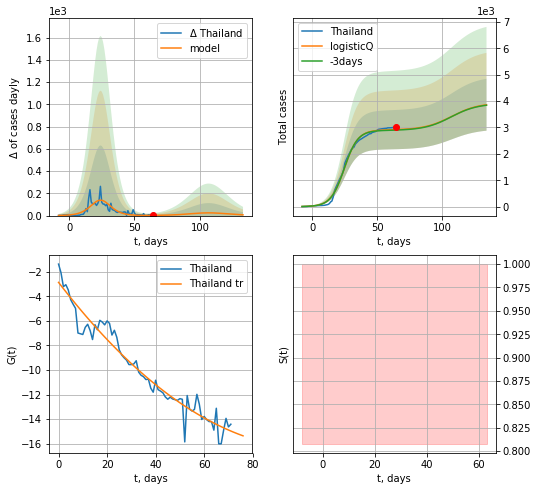

Thailand data at: 2020-05-09
+3 day model MAPE: 0.006242
model: logisticQ
coeffs: [ 2.90550965e+03  2.90766275e-06  2.45852735e+01 -6.56670494e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.254682
forecast at the end of period: +70 days
	 deltaDaycases: 6
	 total cases: 3862 ± 983
	 total death: 71 ± 54
trend coefficient of determination: 0.945537
 intercept_: -2.872738636804246
 coeffs_: [ 0.         -0.25672073  0.00121687]


In [285]:
x = forecastRRR("Thailand",dfTH[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)

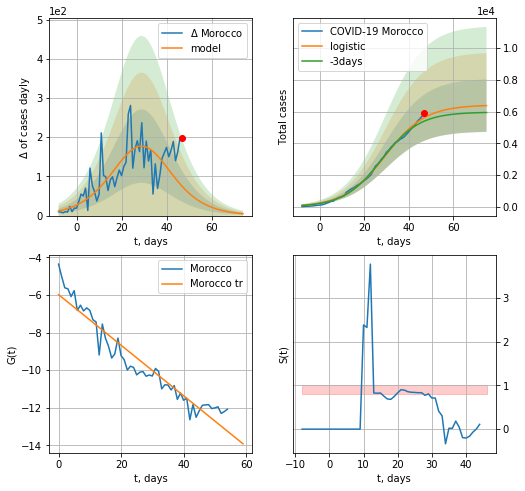

Morocco data at: 2020-05-09
+3 day model MAPE: 0.04304832535081425
model: logistic
coeffs:  [6.42249433e+03 1.10458594e-01 2.93760431e+01]
rational stdev:  0.2590487648792633
forecast at the end of period: +28 days
	 deltaDaycases:  4
	 total cases:  6381 ± 1653
	 total death:  200 ± 155
trend coefficient of determination: 0.916719
 intercept: -5.983988
 slope: -0.134480


In [286]:
x = forecast("Morocco",dfMR[5:],d1,10*7-dT)

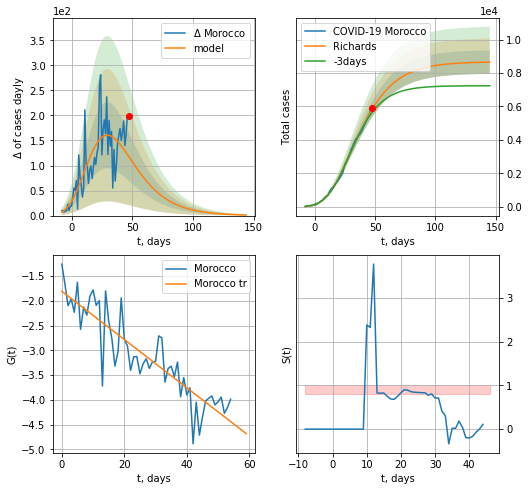

Morocco data at: 2020-05-09
+3 day model MAPE: 0.033892
model: Richards
coeffs: [ 8.67023247e+03  7.57792134e-01 -2.14356230e+01  6.87277579e-02]
rational stdev: 0.081101
forecast at the end of period: +98 days
	 deltaDaycases: 1
	 total cases: 8648 ± 701
	 total death: 272 ± 66
trend coefficient of determination: 0.788269
 intercept: -1.806775
 slope: -0.048752


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


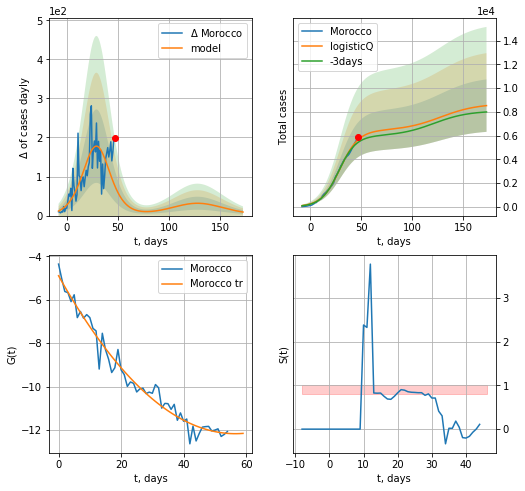

Morocco data at: 2020-05-09
+3 day model MAPE: 0.042802
model: logisticQ
coeffs: [ 6.41961651e+03  2.81811520e-06  2.93678280e+01 -3.91892303e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.259220
forecast at the end of period: +126 days
	 deltaDaycases: 9
	 total cases: 8520 ± 2208
	 total death: 268 ± 208
trend coefficient of determination: 0.969894
 intercept_: -4.898233355115407
 coeffs_: [ 0.         -0.25743392  0.00227727]


In [287]:
x = forecastRR("Morocco",dfMR[5:],d1,20*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1])
x = forecastRRR("Morocco",dfMR[5:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

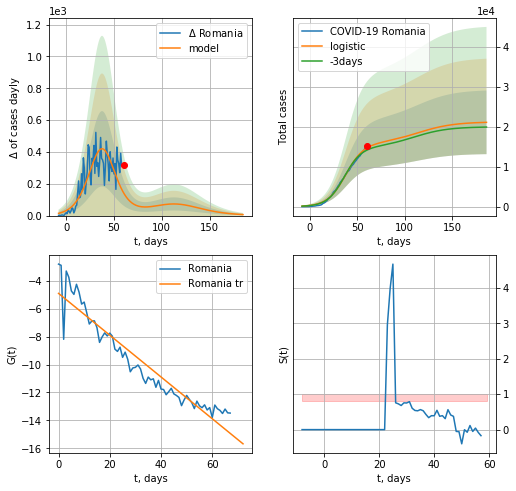

Romania data at: 2020-05-09
+3 day model MAPE: 0.03851781409028721
model: logistic
coeffs:  [1.57319104e+04 1.05518592e-01 3.78740452e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3774547697351111
forecast at the end of period: +126 days
	 deltaDaycases:  6
	 total cases:  21119 ± 7971
	 total death:  1310 ± 1483
trend coefficient of determination: 0.903584
 intercept: -4.901910
 slope: -0.149750


In [288]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


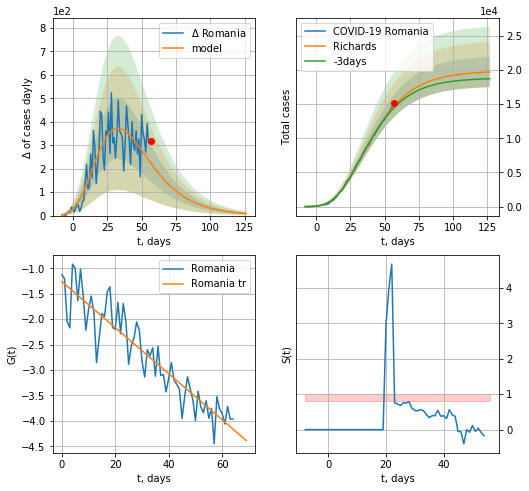

Romania data at: 2020-05-09
+3 day model MAPE: 0.018940
model: Richards
coeffs: [ 1.98750731e+04  4.68699447e+00 -5.49402036e+01  1.09169535e-02]
rational stdev: 0.111749
forecast at the end of period: +70 days
	 deltaDaycases: 8
	 total cases: 19710 ± 2202
	 total death: 1223 ± 410
trend coefficient of determination: 0.851444
 intercept: -1.262950
 slope: -0.045236


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


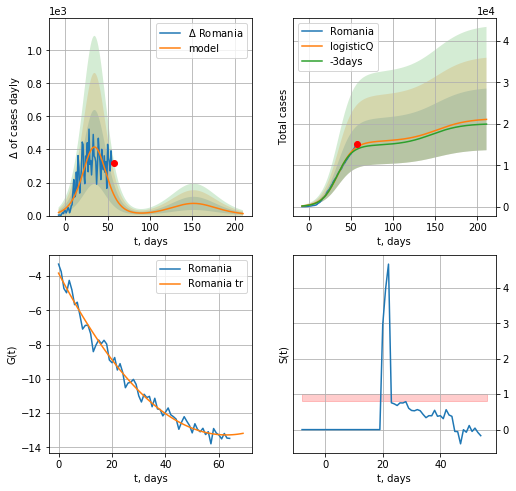

Romania data at: 2020-05-09
+3 day model MAPE: 0.039374
model: logisticQ
coeffs: [ 1.57406492e+04  1.12339901e-06  3.48884952e+01 -9.37465640e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.353458
forecast at the end of period: +154 days
	 deltaDaycases: 12
	 total cases: 21080 ± 7451
	 total death: 1308 ± 1386
trend coefficient of determination: 0.986363
 intercept_: -3.826832842513266
 coeffs_: [ 0.         -0.30112971  0.00239846]


In [289]:
x = forecastRR("Romania",dfRM[8:],d1,16*7-dT)
xx = forecastRRR("Romania",dfRM[8:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

In [290]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
          date    cases  active     death
87 2020-05-05  1052341  434135  110111.0
88 2020-05-06  1064763  420214  111849.0
89 2020-05-07  1074908  416066  113018.0
90 2020-05-08  1085278  412975  114289.0
91 2020-05-09  1093386  409685  115049.0


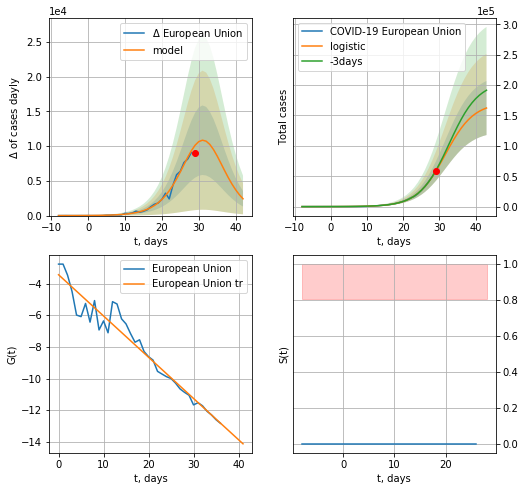

European Union data at: 2020-05-09
+3 day model MAPE: 0.026654473576493115
model: logistic
coeffs:  [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.2741183518342743
forecast at the end of period: +14 days
	 deltaDaycases:  2418
	 total cases:  162249 ± 44475
	 total death:  17072 ± 14039
trend coefficient of determination: 0.946316
 intercept: -3.442935
 slope: -0.260531


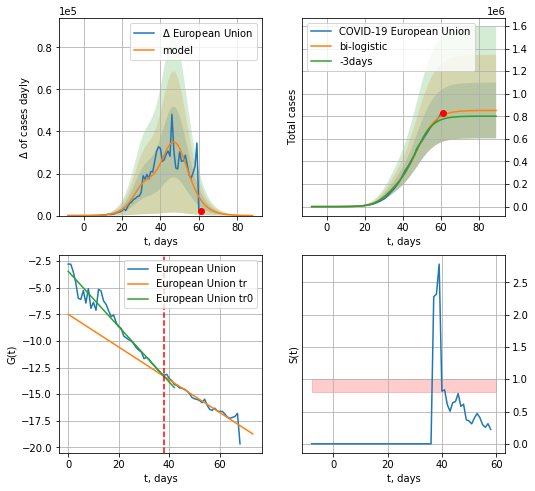

European Union data at: 2020-05-09
+3 day model MAPE: 0.04651829112234155
model: bi-logistic
coeffs:  [6.80547246e+05 2.01837730e-01 4.76694046e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.28952183224371997
forecast at the end of period: +28 days
	 deltaDaycases:  36
	 total cases:  851591 ± 246554
	 total death:  89606 ± 77828
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend coefficient of determination: 0.919561
 intercept: -7.491452
 slope: -0.154009


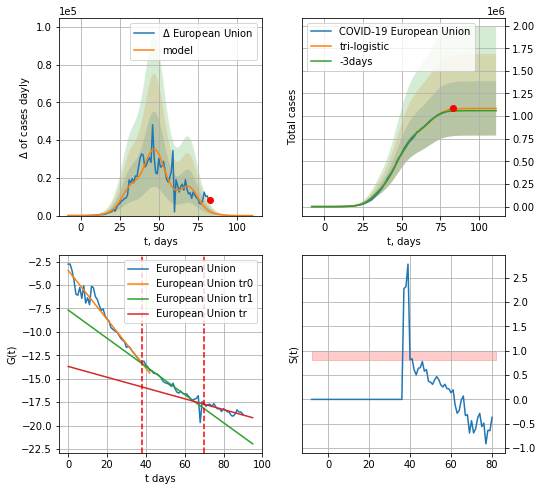

European Union data at: 2020-05-09
+3 day model MAPE: 0.01951109421419983
model: tri-logistic
coeffs:  [2.33642827e+05 2.38647882e-01 6.97993041e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01 6.80547246e+05
 2.01837730e-01 4.76694046e+01]
forecast rational stdev:  0.27646189689039896
forecast at the end of period: +28 days
	 deltaDaycases:  3
	 total cases:  1085382 ± 300066
	 total death:  114206 ± 94720
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend1 coefficient of determination: 0.917498
 intercept: -7.673048
 slope: -0.150226
trend coefficient of determination: 0.740525
 intercept: -13.687911
 slope: -0.057568


In [291]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,8*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,10*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,10*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


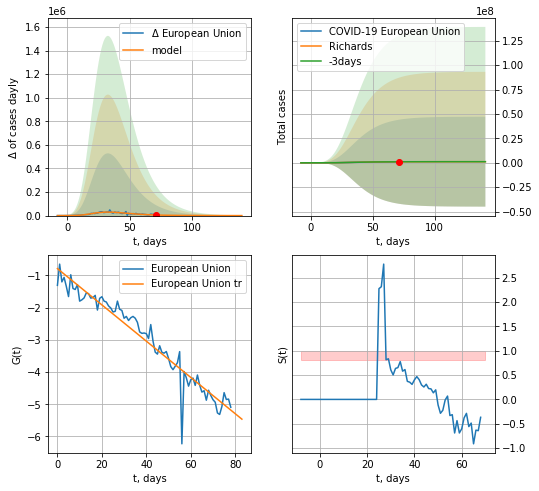

European Union data at: 2020-05-09
+3 day model MAPE: 0.005985
model: Richards
coeffs: [ 1.15343958e+06  5.17467273e+00 -2.79369182e+01  1.36330702e-02]
rational stdev: 39.926752
forecast at the end of period: +70 days
	 deltaDaycases: 41
	 total cases: 1152875 ± 46030571
	 total death: 121308 ± 14530303
trend coefficient of determination: 0.927675
 intercept: -0.785855
 slope: -0.056355


In [292]:
x = forecastRR("European Union",dfEU[12:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


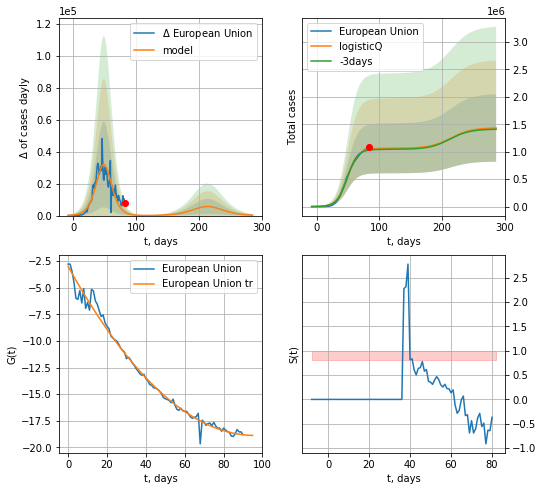

European Union data at: 2020-05-09
+3 day model MAPE: 0.014959
model: logisticQ
coeffs: [ 1.06162329e+06  9.02895258e-07  4.90535854e+01 -1.33514781e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.428575
forecast at the end of period: +203 days
	 deltaDaycases: 287
	 total cases: 1432963 ± 614131
	 total death: 150780 ± 193861
trend coefficient of determination: 0.987680
 intercept_: -2.9919925241480545
 coeffs_: [ 0.         -0.33029909  0.00171597]


In [293]:
x = forecastRRR("European Union",dfEU[:],d1,35*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


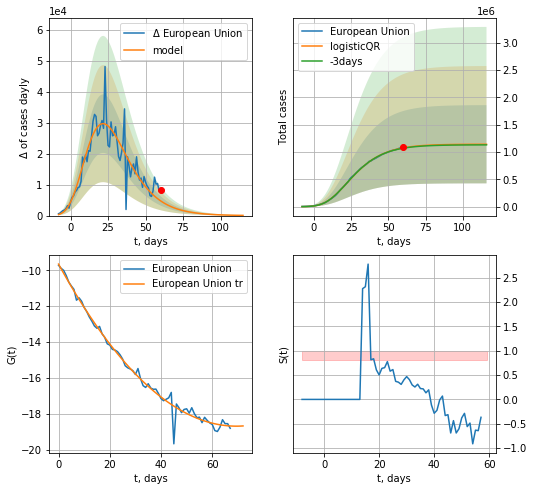

European Union data at: 2020-05-09
+3 day model MAPE: 0.0062744308773042086
model: logisticQR
coeffs:  [ 1.14295751e+06  1.85595221e-02 -6.48334460e+01 -9.56709537e+02
  3.58065094e-03]
rational stdev:  0.6270632258727908
forecast at the end of period: +56 days
	 deltaDaycases:  69
	 total cases:  1142153 ± 716202
	 total death:  120180 ± 226081
trend coefficient of determination: 0.986920
 intercept_: -9.651795319846713
 coeffs_: [ 0.         -0.26033568  0.00187478]


In [294]:
x = forecastQR("European Union",dfEU[23:],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,2.5,1.,1])

In [287]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [723]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [724]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [725]:
#dfIC[:]

IC
          date   cases  active  death
65 2020-05-05  1799.7      56  10.00
66 2020-05-06  1799.8      39  10.00
67 2020-05-07  1801.0      36  10.00
68 2020-05-08  1801.2      26  10.01
69 2020-05-09  1801.3      18  10.02


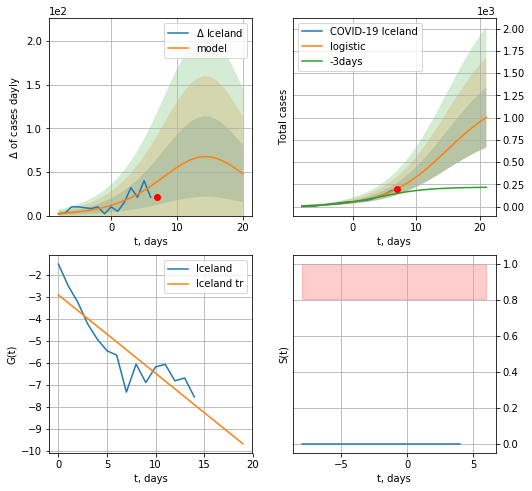

Iceland data at: 2020-05-09
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +14 days
	 deltaDaycases:  47
	 total cases:  1003 ± 338
	 total death:  5 ± 5
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


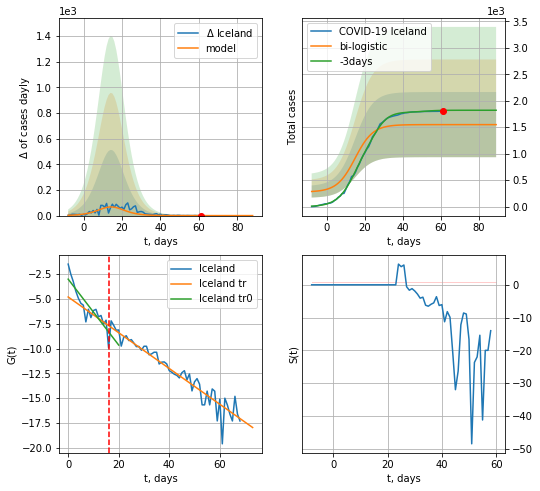

Iceland data at: 2020-05-09
+3 day model MAPE: 0.14821037012650537
model: bi-logistic
coeffs:  [260.51131606  -3.17485399 102.89247503] [1.27194861e+03 2.12945173e-01 1.48141483e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.3970381384462825
forecast at the end of period: +28 days
	 deltaDaycases:  0
	 total cases:  1548 ± 614
	 total death:  8 ± 9
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.772657
 intercept: -3.017482
 slope: -0.331878
trend coefficient of determination: 0.904726
 intercept: -4.812897
 slope: -0.179975


In [296]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
x = forecast("Iceland",dfIC[:vL],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
xx = forecast2("Iceland",dfIC[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


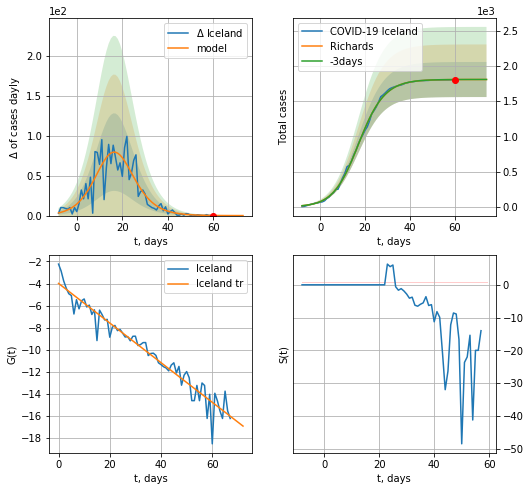

Iceland data at: 2020-05-09
+3 day model MAPE: 0.000327
model: Richards
coeffs: [1.80572371e+03 1.95559306e-01 1.60706106e+01 8.62430569e-01]
rational stdev: 0.137707
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 1805 ± 248
	 total death: 10 ± 4
trend coefficient of determination: 0.941507
 intercept: -3.991718
 slope: -0.180000


In [297]:
x = forecastRR("Iceland",dfIC[1:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


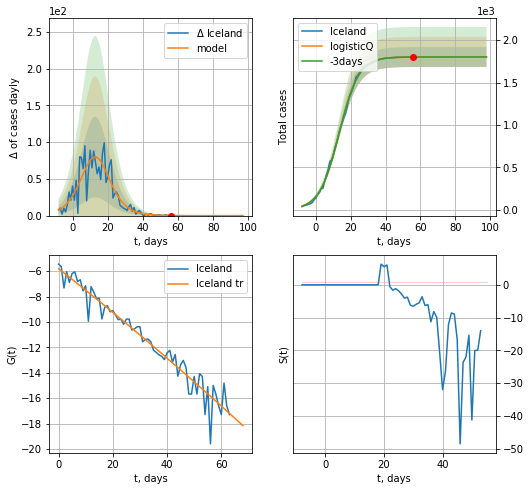

Iceland data at: 2020-05-09
+3 day model MAPE: 0.000029
model: logisticQ
coeffs: [ 1.80196106e+03  9.52672363e-06  1.33193786e+01 -1.85987822e+04]
rational stdev: 0.065620
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 1801 ± 118
	 total death: 10 ± 1
trend coefficient of determination: 0.940651
 intercept_: -5.797807936004534
 coeffs_: [ 0.         -0.16825284 -0.0002015 ]


In [298]:
x = forecastRRR("Iceland",dfIC[5:],d1,12*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


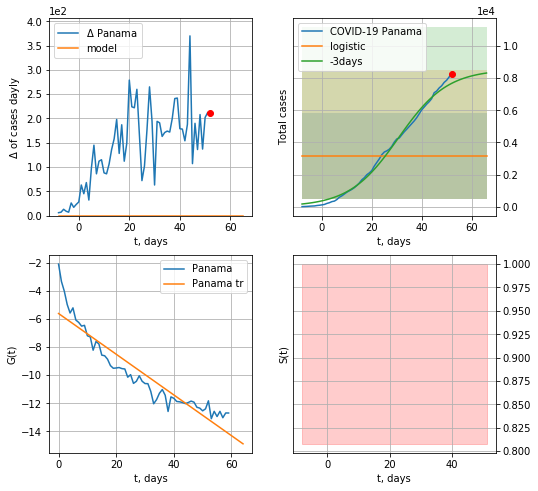

Panama data at: 2020-05-09
+3 day model MAPE: 0.5921112146035058
model: logistic
coeffs:  [ 3.16088524e+03 -2.11727488e+00  8.01813250e+01]
rational stdev:  0.8467164151328255
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  3160 ± 2676
	 total death:  90 ± 228
trend coefficient of determination: 0.871114
 intercept: -5.612039
 slope: -0.144770


In [299]:
#dfPM = read_df(pd.DataFrame(),"PM")
x = forecast("Panama",dfPM[:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


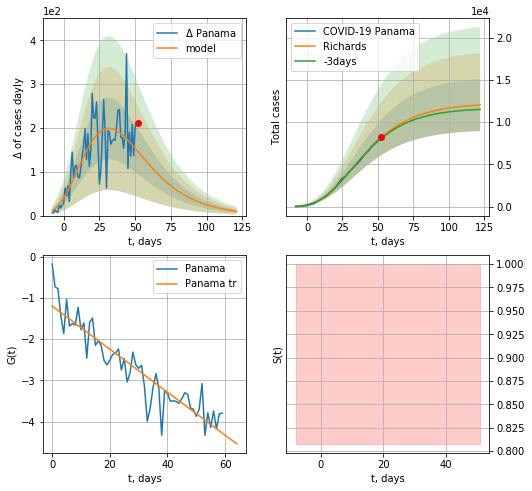

Panama data at: 2020-05-09
+3 day model MAPE: 0.013967
model: Richards
coeffs: [ 1.22453086e+04  3.14443888e+00 -6.36076247e+01  1.41527565e-02]
rational stdev: 0.255983
forecast at the end of period: +70 days
	 deltaDaycases: 9
	 total cases: 12023 ± 3077
	 total death: 344 ± 264
trend coefficient of determination: 0.848385
 intercept: -1.199515
 slope: -0.052179


In [300]:
x = forecastRR("Panama",dfPM[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


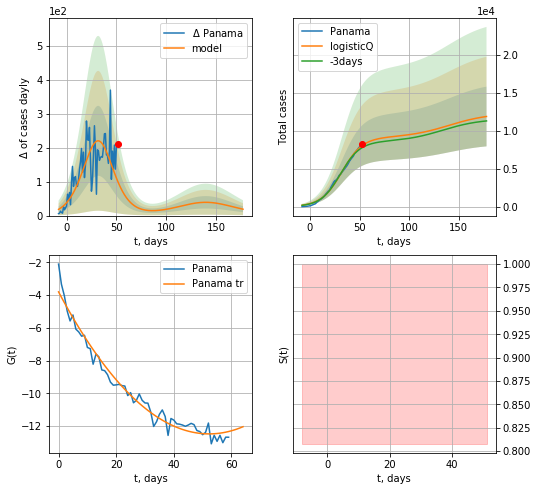

Panama data at: 2020-05-09
+3 day model MAPE: 0.035048
model: logisticQ
coeffs: [ 9.09070662e+03  1.18190809e-06  3.21443576e+01 -8.17965376e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.331378
forecast at the end of period: +126 days
	 deltaDaycases: 18
	 total cases: 11870 ± 3933
	 total death: 339 ± 337
trend coefficient of determination: 0.972244
 intercept_: -3.798219701858147
 coeffs_: [ 0.         -0.3324439   0.00318123]


In [301]:
x = forecastRRR("Panama",dfPM[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

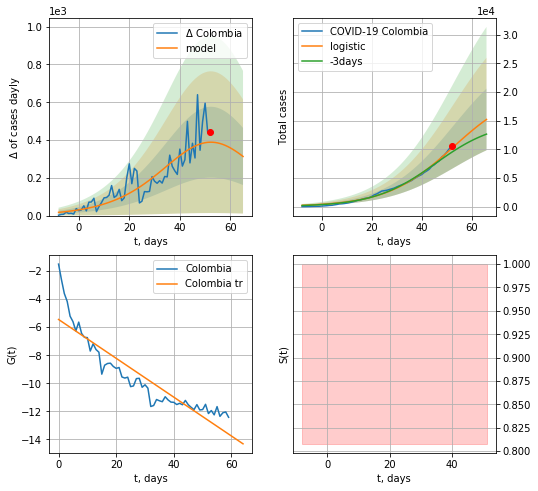

Colombia data at: 2020-05-09
+3 day model MAPE: 0.0802065913668516
model: logistic
coeffs:  [2.08824377e+04 7.44570003e-02 5.27831136e+01]
rational stdev:  0.3538716681459987
forecast at the end of period: +14 days
	 deltaDaycases:  313
	 total cases:  15200 ± 5379
	 total death:  644 ± 683
trend coefficient of determination: 0.834273
 intercept: -5.449261
 slope: -0.138486


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


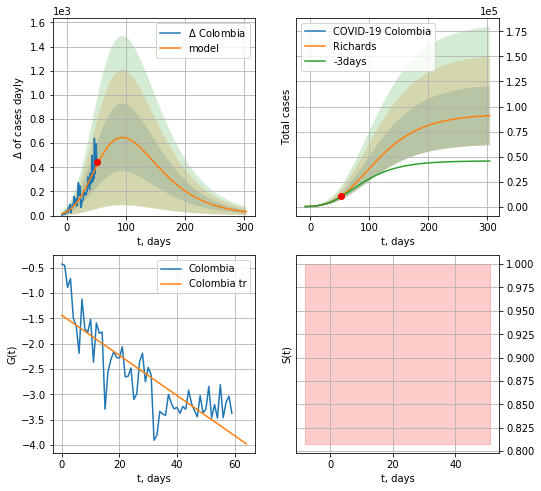

Colombia data at: 2020-05-09
+3 day model MAPE: 0.055514
model: Richards
coeffs: [ 9.25520601e+04  8.35580687e-01 -1.01611678e+02  2.30100358e-02]
rational stdev: 0.324898
forecast at the end of period: +252 days
	 deltaDaycases: 31
	 total cases: 90916 ± 29538
	 total death: 3854 ± 3756
trend coefficient of determination: 0.675706
 intercept: -1.439961
 slope: -0.039651


In [302]:
x = forecast("Colombia",dfCB[:],d1,8*7-dT)
x = forecastRR("Colombia",dfCB[:],d1,42*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


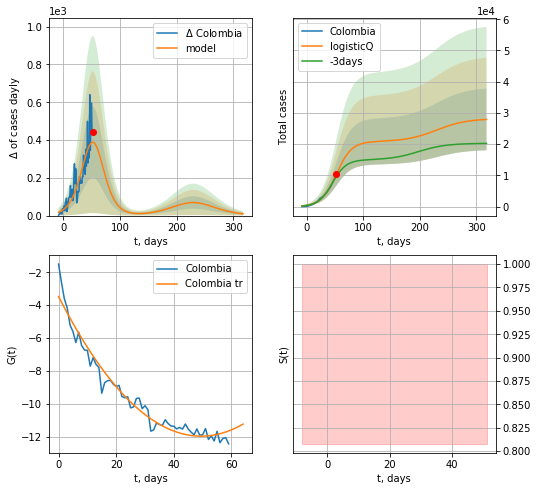

Colombia data at: 2020-05-09
+3 day model MAPE: 0.079886
model: logisticQ
coeffs: [ 2.08012441e+04  3.04262518e-06  5.26814548e+01 -2.44788824e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.353892
forecast at the end of period: +266 days
	 deltaDaycases: 9
	 total cases: 27909 ± 9877
	 total death: 1183 ± 1255
trend coefficient of determination: 0.960070
 intercept_: -3.471660920179361
 coeffs_: [ 0.         -0.3431041   0.00346843]


In [303]:
x = forecastRRR("Colombia",dfCB[:],d1,44*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
          date   cases  active  death
62 2020-05-05  4838.0  2301.0  470.0
63 2020-05-06  4997.0  2324.0  476.0
64 2020-05-07  5182.0  2376.0  483.0
65 2020-05-08  5369.0  2414.0  488.0
66 2020-05-09  5558.0  2518.0  494.0


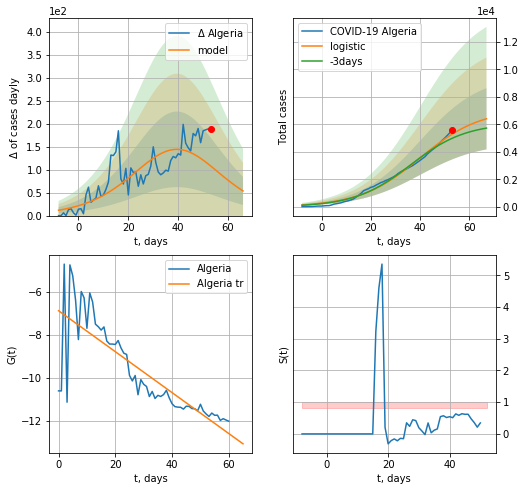

Algeria data at: 2020-05-09
+3 day model MAPE: 0.06549443183401091
model: logistic
coeffs:  [7.11546675e+03 8.12465705e-02 3.99631569e+01]
rational stdev:  0.3475216569396634
forecast at the end of period: +14 days
	 deltaDaycases:  53
	 total cases:  6403 ± 2225
	 total death:  569 ± 593
trend coefficient of determination: 0.672892
 intercept: -6.885503
 slope: -0.094826


In [304]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,8*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


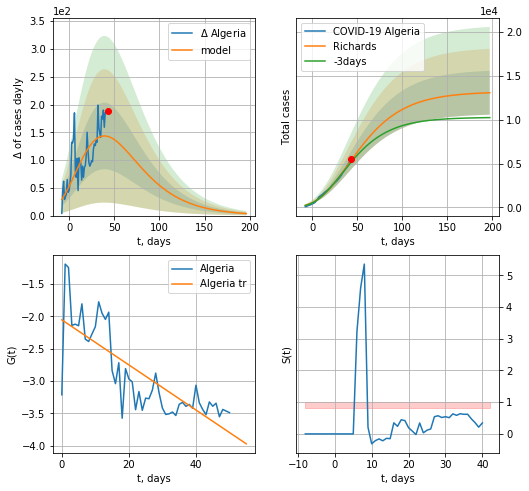

Algeria data at: 2020-05-09
+3 day model MAPE: 0.041116
model: Richards
coeffs: [ 1.31940736e+04  2.34832011e+00 -1.07309938e+02  1.26634657e-02]
rational stdev: 0.191401
forecast at the end of period: +154 days
	 deltaDaycases: 3
	 total cases: 13072 ± 2502
	 total death: 1161 ± 666
trend coefficient of determination: 0.627948
 intercept: -2.053335
 slope: -0.034917


In [306]:
x = forecastRR("Algeria",dfAR[15:],d1,28*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


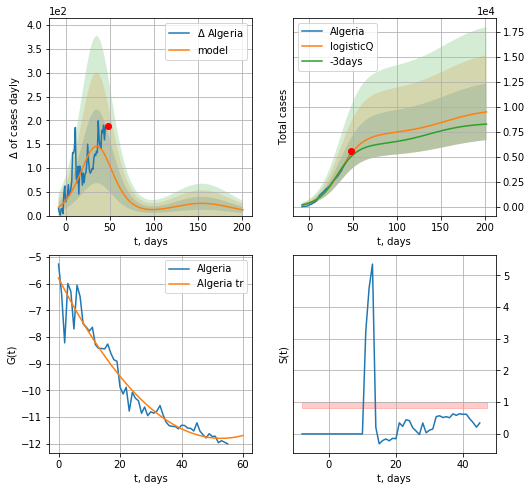

Algeria data at: 2020-05-09
+3 day model MAPE: 0.061466
model: logisticQ
coeffs: [ 7.26283170e+03  1.41818662e-06  3.55368887e+01 -5.61308041e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.297796
forecast at the end of period: +154 days
	 deltaDaycases: 11
	 total cases: 9496 ± 2828
	 total death: 844 ± 754
trend coefficient of determination: 0.946759
 intercept_: -5.791670482278622
 coeffs_: [ 0.         -0.22704307  0.00214535]


In [307]:
x = forecastRRR("Algeria",dfAR[10:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

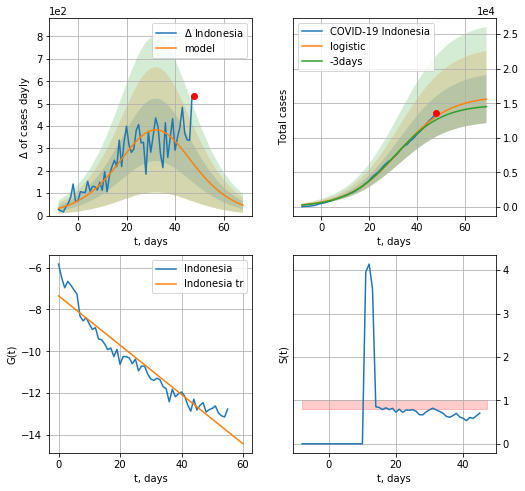

Indonesia data at: 2020-05-09
+3 day model MAPE: 0.03964029472419729
model: logistic
coeffs:  [1.60822477e+04 9.52839565e-02 3.25232677e+01]
rational stdev:  0.222847166927322
forecast at the end of period: +21 days
	 deltaDaycases:  46
	 total cases:  15599 ± 3476
	 total death:  1096 ± 732
trend coefficient of determination: 0.925941
 intercept: -7.348609
 slope: -0.117994


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


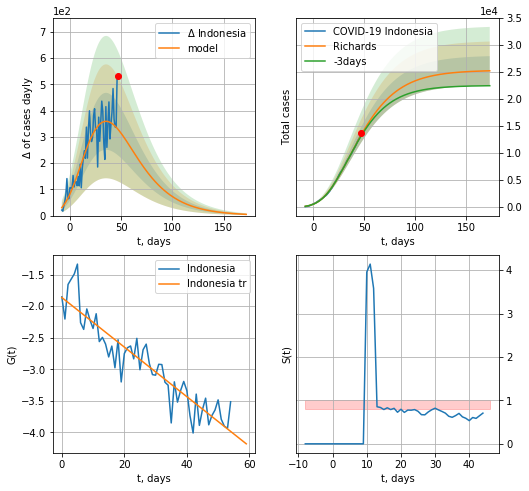

Indonesia data at: 2020-05-09
+3 day model MAPE: 0.016413
model: Richards
coeffs: [ 2.53061332e+04  1.37186598e+00 -5.52563018e+01  2.85203650e-02]
rational stdev: 0.107282
forecast at the end of period: +126 days
	 deltaDaycases: 4
	 total cases: 25189 ± 2702
	 total death: 1770 ± 569
trend coefficient of determination: 0.849782
 intercept: -1.863305
 slope: -0.039272


In [308]:
x = forecast("Indonesia",dfIE[5:],d1,9*7-dT)
x = forecastRR("Indonesia",dfIE[6:],d1,24*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


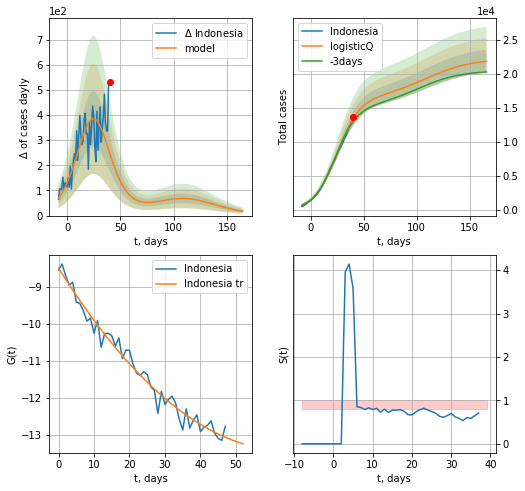

Indonesia data at: 2020-05-09
+3 day model MAPE: 0.033925
model: logisticQ
coeffs: [ 1.64326860e+04  9.00338155e-06  2.50699466e+01 -1.02658990e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.076918
forecast at the end of period: +126 days
	 deltaDaycases: 17
	 total cases: 21865 ± 1681
	 total death: 1536 ± 354
trend coefficient of determination: 0.975600
 intercept_: -8.495977969219519
 coeffs_: [ 0.         -0.15276241  0.00118478]


In [309]:
x = forecastRRR("Indonesia",dfIE[13:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


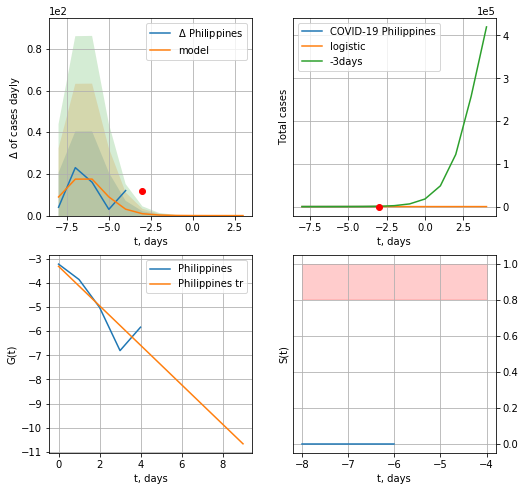

Philippines data at: 2020-05-09
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  4 ± 2
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


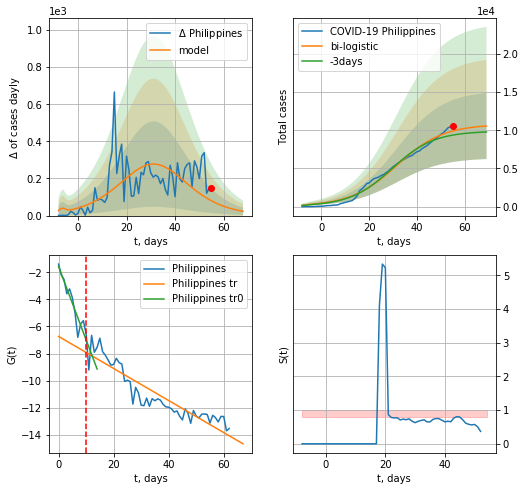

Philippines data at: 2020-05-09
+3 day model MAPE: 0.05948000995432763
model: bi-logistic
coeffs:  [1.07221286e+04 1.03667056e-01 3.16326048e+01] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.4096278385339091
forecast at the end of period: +14 days
	 deltaDaycases:  23
	 total cases:  10565 ± 4327
	 total death:  701 ± 861
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.841637
 intercept: -6.734304
 slope: -0.118623


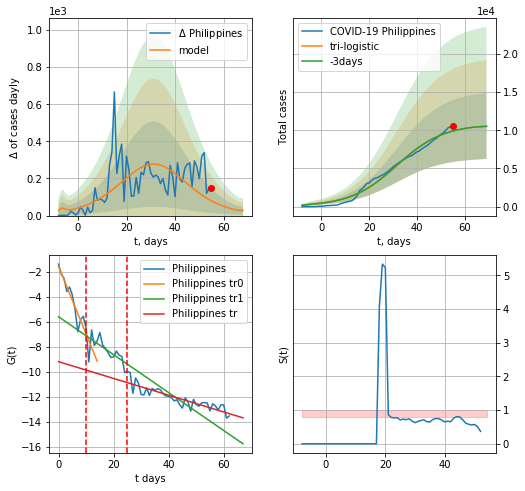

Philippines data at: 2020-05-09
+3 day model MAPE: 2.9559130432493566e-10
model: tri-logistic
coeffs:  [32.48471764  1.48031461 70.04512982] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  1.07221286e+04
  1.03667056e-01  3.16326048e+01]
forecast rational stdev:  0.4096278385338976
forecast at the end of period: +14 days
	 deltaDaycases:  27
	 total cases:  10571 ± 4330
	 total death:  701 ± 861
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.760445
 intercept: -9.198911
 slope: -0.067125


In [311]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,7*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,8*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


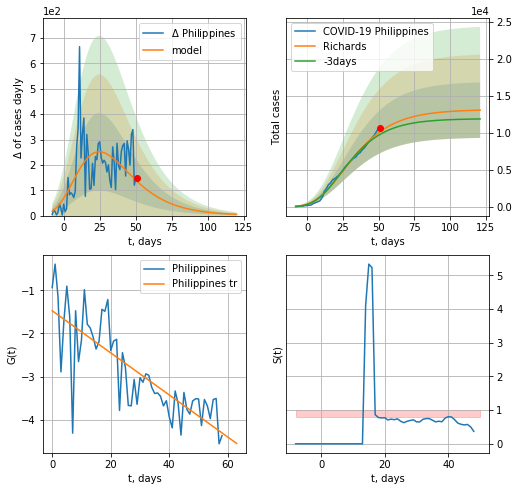

Philippines data at: 2020-05-09
+3 day model MAPE: 0.040204
model: Richards
coeffs: [ 1.31624983e+04  5.49837290e+00 -6.40775454e+01  9.49654923e-03]
rational stdev: 0.287634
forecast at the end of period: +70 days
	 deltaDaycases: 4
	 total cases: 13074 ± 3760
	 total death: 867 ± 748
trend coefficient of determination: 0.642888
 intercept: -1.474365
 slope: -0.048767


In [312]:
x = forecastRR("Philippines",dfPH[4:],d1,16*7-dT,addpred=False,xcoef=[0.25,1.,2.3])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


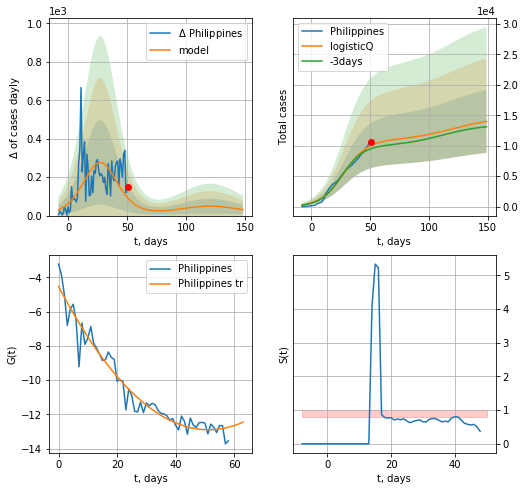

Philippines data at: 2020-05-09
+3 day model MAPE: 0.056677
model: logisticQ
coeffs: [ 1.08741286e+04  8.92975872e-07  2.76971806e+01 -1.13344359e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.369729
forecast at the end of period: +98 days
	 deltaDaycases: 30
	 total cases: 13987 ± 5171
	 total death: 928 ± 1029
trend coefficient of determination: 0.945421
 intercept_: -4.525677695091449
 coeffs_: [ 0.         -0.32702323  0.00319214]


In [313]:
x = forecastRRR("Philippines",dfPH[4:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
          date  cases  active  death
66 2020-05-05   2642    1122  146.0
67 2020-05-06   2663    1142  147.0
68 2020-05-07   2678    1156  148.0
69 2020-05-08   2691    1167  150.0
70 2020-05-09   2710    1185  151.0


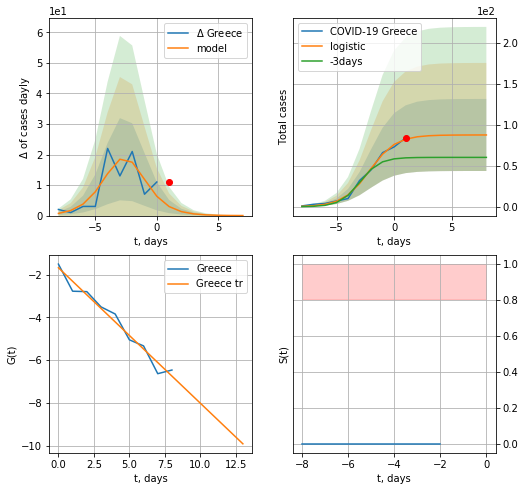

Greece data at: 2020-05-09
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  4 ± 6
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


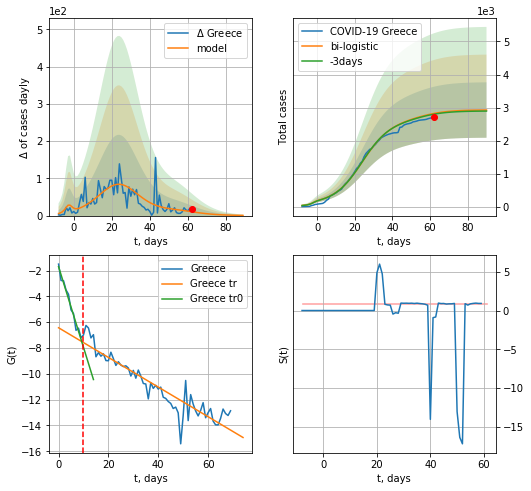

Greece data at: 2020-05-09
+3 day model MAPE: 0.008146570080908027
model: bi-logistic
coeffs:  [2.52477865e+03 1.32421335e-01 2.40313026e+01] [87.54984336  0.87627722 -2.15069813]
scenario coeffs:  [0.125, 1.0, 2.3]
rational stdev:  0.2868361591564469
forecast at the end of period: +28 days
	 deltaDaycases:  0
	 total cases:  2924 ± 838
	 total death:  162 ± 139
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.856397
 intercept: -6.434063
 slope: -0.114873


In [315]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,7*7-dT)
xx = forecast2("Greece",dfGC[:],d1,10*7-dT,x,addpred=True,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


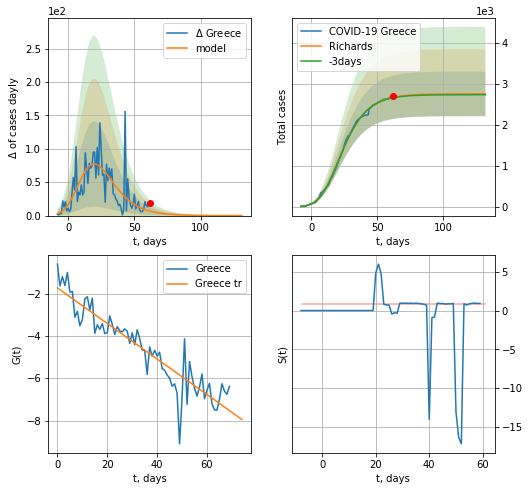

Greece data at: 2020-05-09
+3 day model MAPE: 0.005067
model: Richards
coeffs: [ 2.75662561e+03  4.60594079e-01 -5.05637618e-01  1.80237285e-01]
rational stdev: 0.197771
forecast at the end of period: +70 days
	 deltaDaycases: 0
	 total cases: 2756 ± 545
	 total death: 153 ± 90
trend coefficient of determination: 0.847795
 intercept: -1.728169
 slope: -0.084093


In [316]:
x = forecastRR("Greece",dfGC[:],d1,16*7-dT,addpred=False,xcoef=[.35/4,.5,4,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


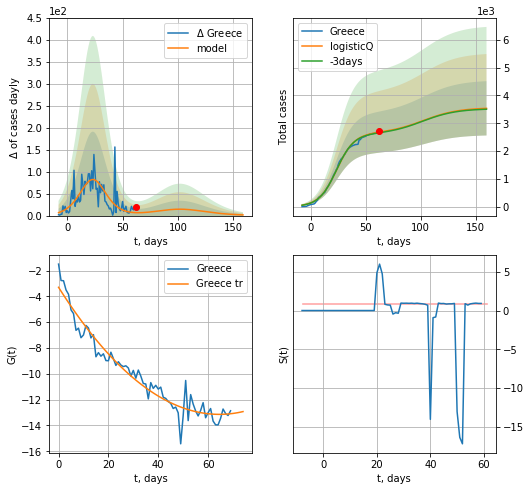

Greece data at: 2020-05-09
+3 day model MAPE: 0.008758
model: logisticQ
coeffs: [ 2.62969310e+03  1.07698462e-06  2.34804034e+01 -1.15307907e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.276020
forecast at the end of period: +98 days
	 deltaDaycases: 1
	 total cases: 3536 ± 976
	 total death: 197 ± 163
trend coefficient of determination: 0.940435
 intercept_: -3.2998526600425553
 coeffs_: [ 0.         -0.30530759  0.00236747]


In [317]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
          date  cases  active  death
60 2020-05-05   3111    1979  373.0
61 2020-05-06   3150    1966  383.0
62 2020-05-07   3178    1921  392.0
63 2020-05-08   3213    1904  405.0
64 2020-05-09   3263    1917  413.0


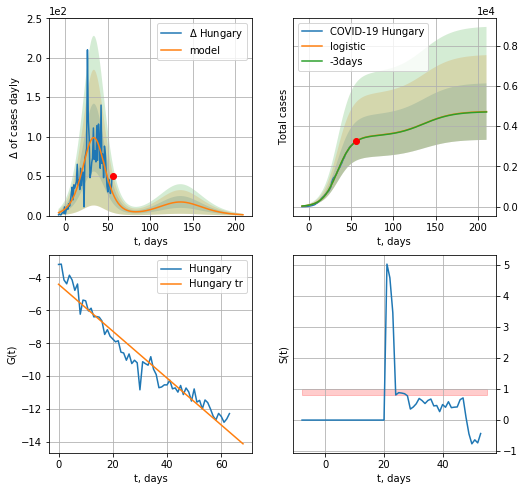

Hungary data at: 2020-05-09
+3 day model MAPE: 0.0024973251223746537
model: logistic
coeffs:  [3.51232792e+03 1.12322219e-01 3.39666358e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.29706515703350855
forecast at the end of period: +154 days
	 deltaDaycases:  1
	 total cases:  4722 ± 1402
	 total death:  597 ± 532
trend coefficient of determination: 0.945110
 intercept: -4.421906
 slope: -0.142361


In [318]:
dfHG = read_df(pd.DataFrame(),"HG")
x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


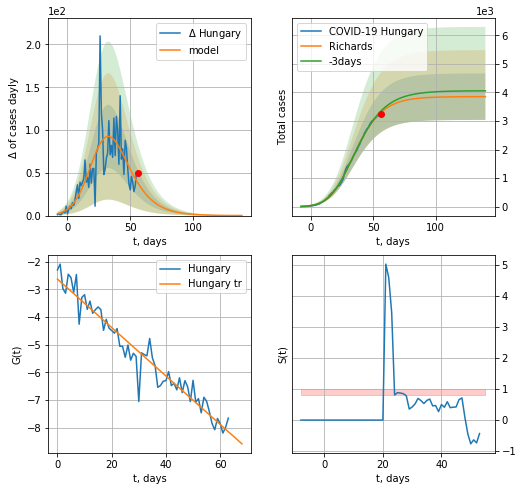

Hungary data at: 2020-05-09
+3 day model MAPE: 0.015778
model: Richards
coeffs: [3.85435179e+03 1.83787009e-01 2.22799205e+01 4.29244529e-01]
rational stdev: 0.211323
forecast at the end of period: +84 days
	 deltaDaycases: 0
	 total cases: 3853 ± 814
	 total death: 487 ± 308
trend coefficient of determination: 0.937285
 intercept: -2.628163
 slope: -0.087551


In [319]:
x = forecastRR("Hungary",dfHG[:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


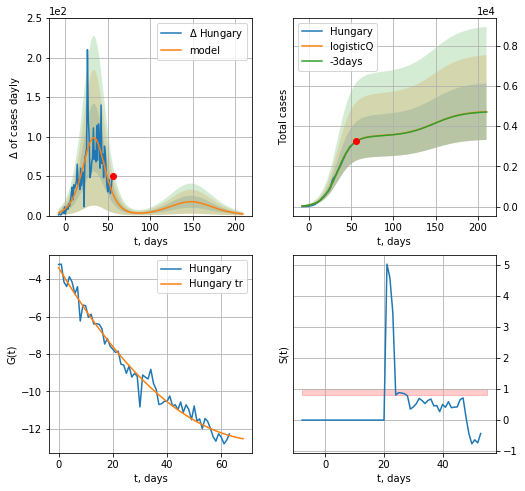

Hungary data at: 2020-05-09
+3 day model MAPE: 0.002547
model: logisticQ
coeffs: [ 3.51118191e+03  2.95310905e-06  3.39612551e+01 -3.80108288e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.297328
forecast at the end of period: +154 days
	 deltaDaycases: 2
	 total cases: 4718 ± 1402
	 total death: 597 ± 532
trend coefficient of determination: 0.977444
 intercept_: -3.3860665792807136
 coeffs_: [ 0.         -0.24262581  0.00159169]


In [320]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


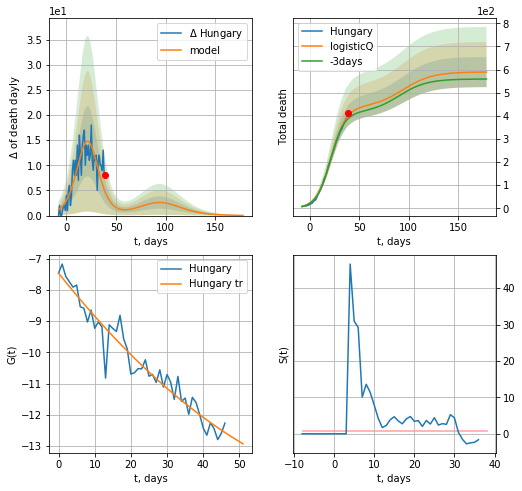

Hungary data at: 2020-05-09
+3 day model MAPE: 0.034351
model: logisticQ
coeffs: [ 4.35419122e+02  5.87957304e-05  2.16268216e+01 -2.27650628e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.110468
forecast at the end of period: +140 days
	 total death: 589 ± 65
trend coefficient of determination: 0.937990
 intercept_: -7.466922761764399
 coeffs_: [ 0.         -0.14544714  0.00075136]


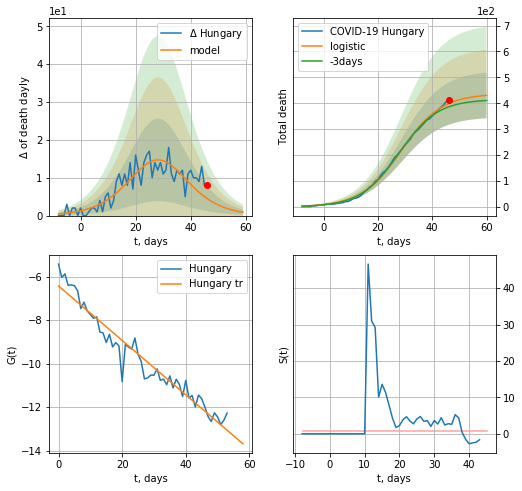

Hungary data at: 2020-05-09
+3 day model MAPE: 0.034169606354157486
model: logistic
coeffs:  [4.36838390e+02 1.34755330e-01 2.86653541e+01]
rational stdev:  0.20467306288059445
forecast at the end of period: +14 days
	 total death:  430 ± 88
trend coefficient of determination: 0.940182
 intercept: -6.432020
 slope: -0.124987


In [321]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,8*7-dT,cases='death')

MT
          date  cases  active  death
58 2020-05-05  482.0      74    5.0
59 2020-05-06  484.0      72    5.0
60 2020-05-07  486.0      68    5.0
61 2020-05-08  489.0      65    5.0
62 2020-05-09  490.0      58    5.0


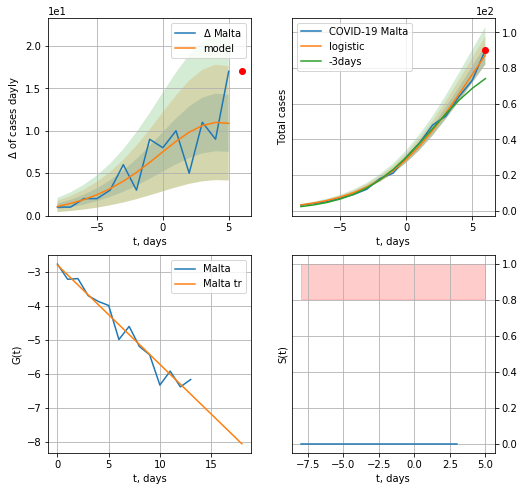

Malta data at: 2020-05-09
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +0 days
	 deltaDaycases:  10
	 total cases:  87 ± 5
	 total death:  0 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


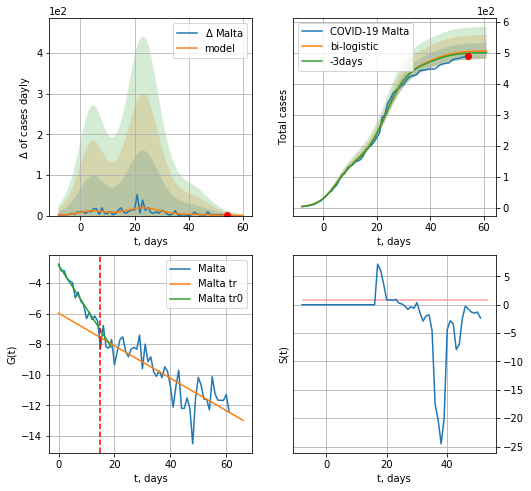

Malta data at: 2020-05-09
+3 day model MAPE: 0.011024523879231814
model: bi-logistic
coeffs:  [3.19728965e+02 2.38131762e-01 2.36650692e+01] [147.79636191   0.29837112   4.7799048 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.05101550961098509
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  506 ± 25
	 total death:  5 ± 0
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.703450
 intercept: -5.978319
 slope: -0.106080


In [322]:
dfMT = read_df(pd.DataFrame(),"MT")
x = forecast("Malta",dfMT[:15],d1,6*7-dT,pMAPE=False)
xx = forecast2("Malta",dfMT[:],d1,7*7-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


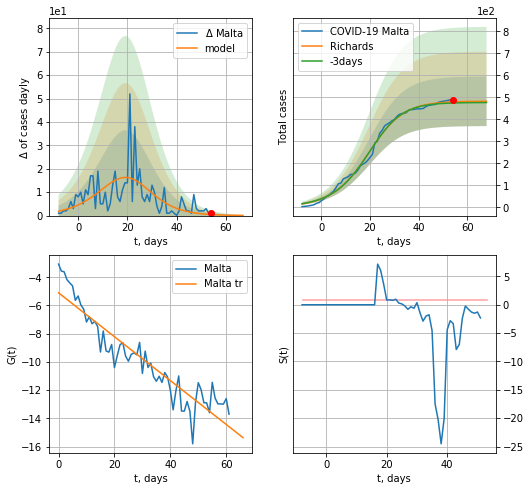

Malta data at: 2020-05-09
+3 day model MAPE: 0.010489
model: Richards
coeffs: [4.82680532e+02 1.18764446e-01 2.09862915e+01 1.21221444e+00]
rational stdev: 0.233965
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 482 ± 112
	 total death: 4 ± 2
trend coefficient of determination: 0.862180
 intercept: -5.102627
 slope: -0.155566


In [323]:
x = forecastRR("Malta",dfMT[:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


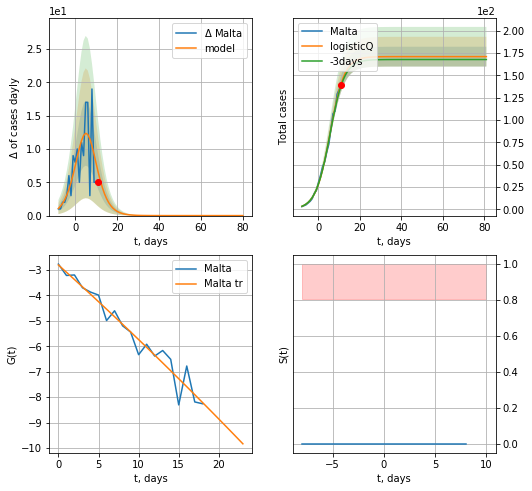

Malta data at: 2020-05-09
+3 day model MAPE: 0.017372
model: logisticQ
coeffs: [ 1.70905491e+02  1.60191203e-04  5.61725093e+00 -1.80321010e+03]
rational stdev: 0.064892
forecast at the end of period: +70 days
	 deltaDaycases: 0
	 total cases: 170 ± 11
	 total death: 1 ± 0
trend coefficient of determination: 0.945272
 intercept_: -2.8075452596601114
 coeffs_: [ 0.         -0.2833994  -0.00095541]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


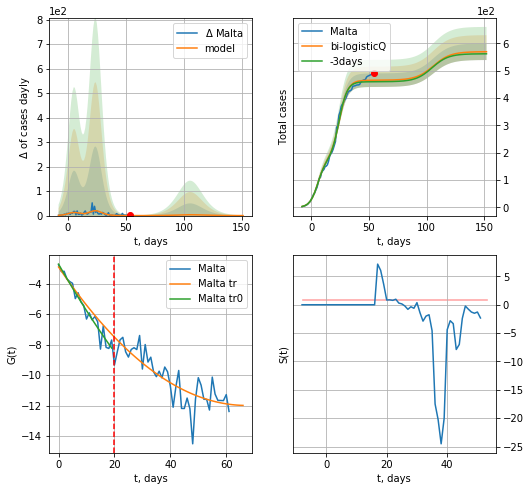

Malta data at: 2020-05-09
+3 day model MAPE: 0.012230
model: bi-logisticQ
coeffs: [ 2.94417658e+02  1.37300619e-06  2.42924282e+01 -1.94670441e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.053187
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 569 ± 30
	 total death: 5 ± 0
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.942709
 intercept_: -2.7278514236597555
 coeffs_: [ 0.         -0.32197154  0.00170311]
trend coefficient of determination: 0.671772
 intercept_: -2.915997143313694
 coeffs_: [ 0.         -0.27021418  0.00201029]


In [324]:
x = forecastRRR("Malta",dfMT[:20],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,20*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=20)

SL
          date  cases  active  death
56 2020-05-05   1421   655.0   25.0
57 2020-05-06   1429   642.0   25.0
58 2020-05-07   1445   613.0   26.0
59 2020-05-08   1455   524.0   26.0
60 2020-05-09   1455   510.0   26.0


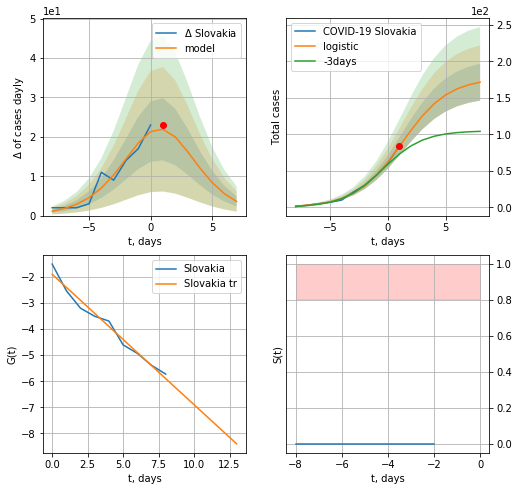

Slovakia data at: 2020-05-09
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +7 days
	 deltaDaycases:  3
	 total cases:  171 ± 25
	 total death:  3 ± 1
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:478: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

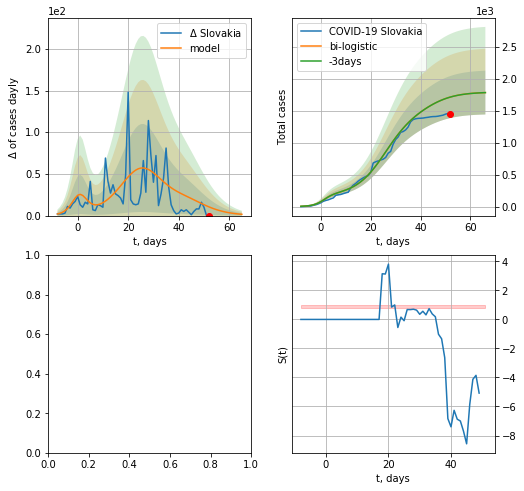

In [326]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
x = forecast("Slovakia",dfSL[:10],d1,7*7-dT,pMAPE=False)
xx = forecast2("Slovakia",dfSL[:],d1,8*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


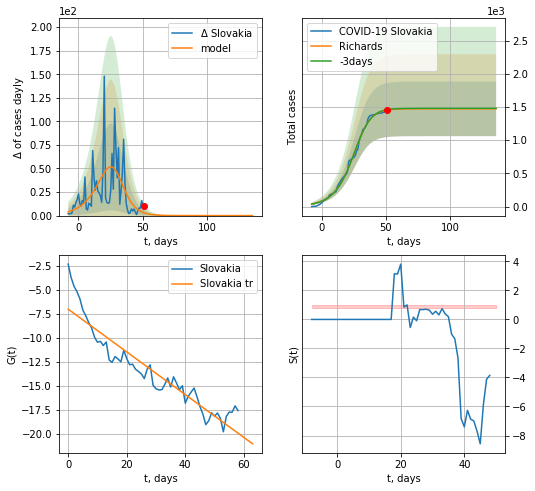

Slovakia data at: 2020-05-08
+3 day model MAPE: 0.004086
model: Richards
coeffs: [1.47225441e+03 9.92230501e-02 2.87558925e+01 1.73141093e+00]
rational stdev: 0.279113
forecast at the end of period: +85 days
	 deltaDaycases: 0
	 total cases: 1472 ± 410
	 total death: 26 ± 21
trend coefficient of determination: 0.875114
 intercept: -7.008461
 slope: -0.223038


In [317]:
x = forecastRR("Slovakia",dfSL[:],d1,18*7-dT)

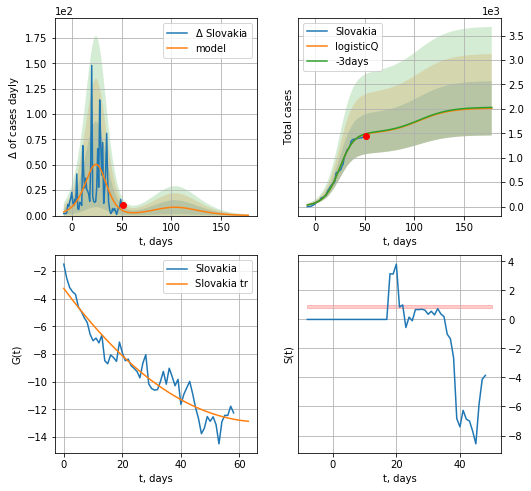

Slovakia data at: 2020-05-08
+3 day model MAPE: 0.006651
model: logisticQ
coeffs: [ 1.48846253e+03  5.51251211e-04  2.38238166e+01 -2.20367801e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.276111
forecast at the end of period: +127 days
	 deltaDaycases: 0
	 total cases: 2010 ± 555
	 total death: 35 ± 28
trend coefficient of determination: 0.909929
 intercept_: -3.2618318406075604
 coeffs_: [ 0.         -0.28551703  0.00211129]


In [318]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
          date   cases  active  death
60 2020-05-04  1439.8  1101.0   97.0
61 2020-05-05  1445.0  1103.0   98.0
62 2020-05-06  1448.0  1103.0   99.0
63 2020-05-07  1449.0  1103.0   99.0
64 2020-05-08  1450.0  1098.0  100.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


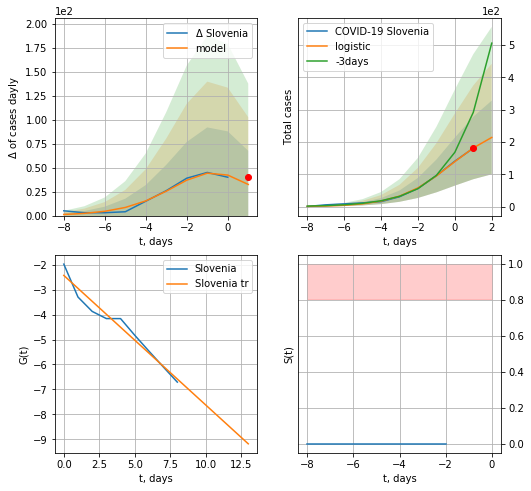

Slovenia data at: 2020-05-08
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +1 days
	 deltaDaycases:  32
	 total cases:  214 ± 113
	 total death:  14 ± 22
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


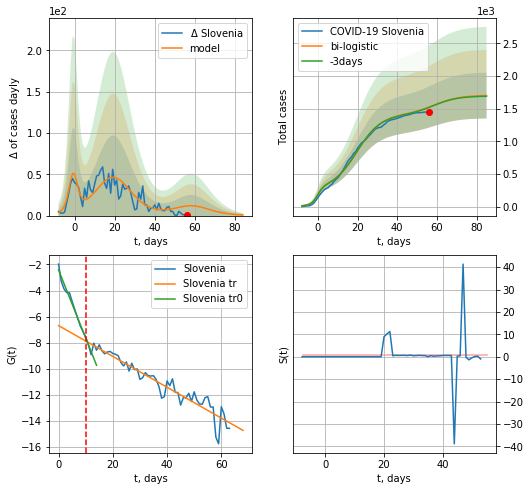

Slovenia data at: 2020-05-08
+3 day model MAPE: 0.0030917381440800085
model: bi-logistic
coeffs:  [1.15552822e+03 1.60803307e-01 1.96339394e+01] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.2059691632019197
forecast at the end of period: +29 days
	 deltaDaycases:  0
	 total cases:  1701 ± 350
	 total death:  117 ± 72
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.910767
 intercept: -6.686797
 slope: -0.118128


In [319]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
x = forecast("Slovenia",dfSV[:10],d1,6*7-dT,pMAPE=False)
xx = forecast2("Slovenia",dfSV[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


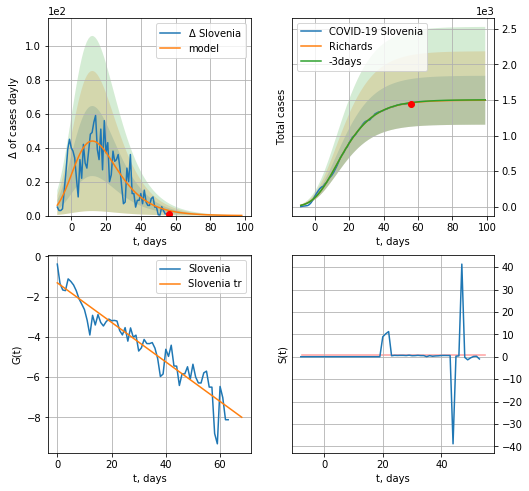

Slovenia data at: 2020-05-08
+3 day model MAPE: 0.002213
model: Richards
coeffs: [ 1.49736465e+03  7.31975814e-01 -1.29838572e+01  1.15321367e-01]
rational stdev: 0.229638
forecast at the end of period: +43 days
	 deltaDaycases: 0
	 total cases: 1496 ± 343
	 total death: 103 ± 70
trend coefficient of determination: 0.900376
 intercept: -1.318052
 slope: -0.098210


In [320]:
x = forecastRR("Slovenia",dfSV[:],d1,12*7-dT)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp


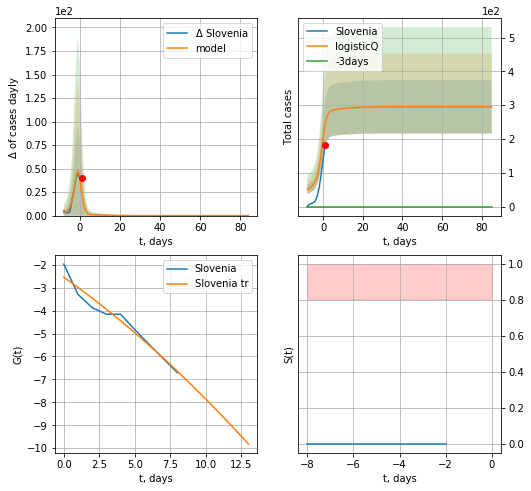

Slovenia data at: 2020-05-09
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +84 days
	 deltaDaycases: 0
	 total cases: 295 ± 78
	 total death: 20 ± 16
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


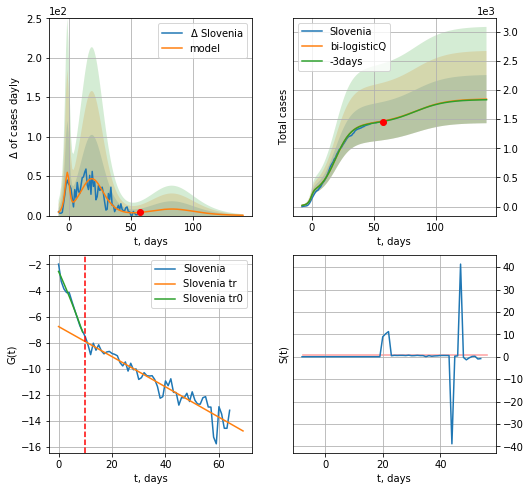

Slovenia data at: 2020-05-09
+3 day model MAPE: 0.005027
model: bi-logisticQ
coeffs: [ 1.20287212e+03  9.15174143e-07  1.91335232e+01 -1.69103626e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.223919
forecast at the end of period: +84 days
	 deltaDaycases: 0
	 total cases: 1842 ± 412
	 total death: 127 ± 85
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.907627
 intercept_: -6.759979885798388
 coeffs_: [ 0.00000000e+00 -1.15026408e-01 -1.36557959e-05]


In [327]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
          date  cases  active  death
56 2020-05-05   9677  7754.0  200.0
57 2020-05-06   9791  7617.0  203.0
58 2020-05-07   9848  7482.0  206.0
59 2020-05-08   9943  7281.0  209.0
60 2020-05-09  10032  7087.0  213.0


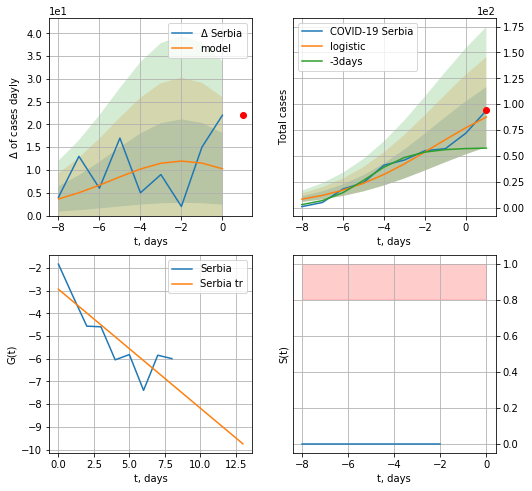

Serbia data at: 2020-05-09
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +0 days
	 deltaDaycases:  10
	 total cases:  87 ± 29
	 total death:  1 ± 0
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


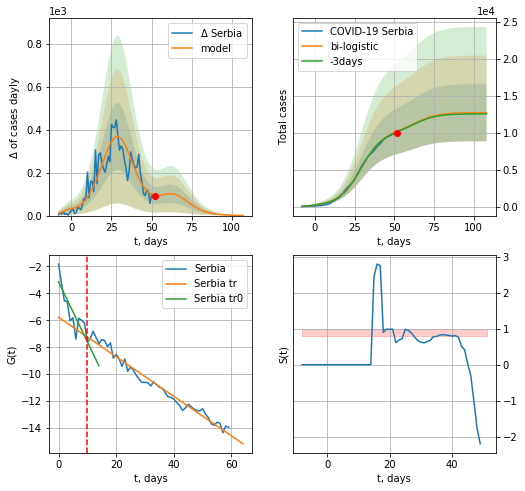

Serbia data at: 2020-05-09
+3 day model MAPE: 0.008610453394357115
model: bi-logistic
coeffs:  [1.00823080e+04 1.45350657e-01 2.90942791e+01] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.30431073816435517
forecast at the end of period: +56 days
	 deltaDaycases:  0
	 total cases:  12718 ± 3870
	 total death:  270 ± 246
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.973487
 intercept: -5.777576
 slope: -0.146725


In [329]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,6*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


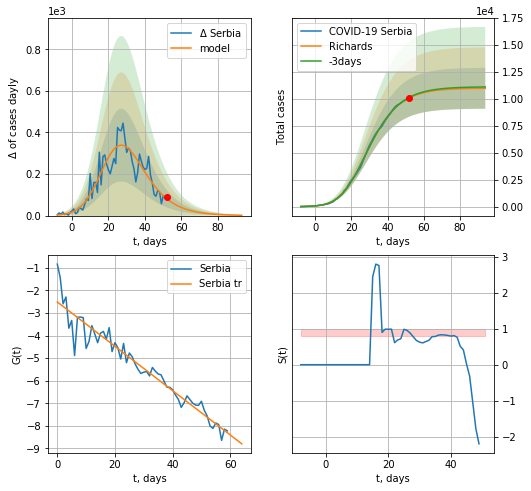

Serbia data at: 2020-05-09
+3 day model MAPE: 0.005047
model: Richards
coeffs: [1.09736893e+04 2.62053718e-01 1.77623457e+01 3.79655520e-01]
rational stdev: 0.172804
forecast at the end of period: +42 days
	 deltaDaycases: 1
	 total cases: 10959 ± 1893
	 total death: 232 ± 120
trend coefficient of determination: 0.929382
 intercept: -2.511044
 slope: -0.098206


In [330]:
x = forecastRR("Serbia",dfSB[:],d1,12*7-dT)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


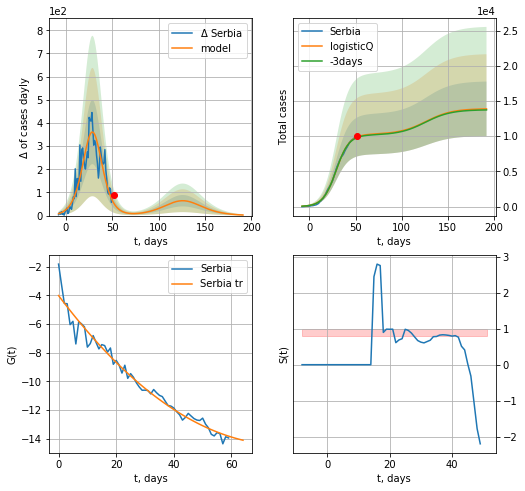

Serbia data at: 2020-05-09
+3 day model MAPE: 0.008552
model: logisticQ
coeffs: [ 1.02728330e+04  2.64918334e-06  2.90004275e+01 -5.29969892e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.279596
forecast at the end of period: +140 days
	 deltaDaycases: 2
	 total cases: 13876 ± 3879
	 total death: 294 ± 246
trend coefficient of determination: 0.970208
 intercept_: -4.022105008715947
 coeffs_: [ 0.         -0.2666966   0.00170755]


In [331]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
          date  cases  active  death
66 2020-05-05   2112   469.0   83.0
67 2020-05-06   2119   433.0   85.0
68 2020-05-07   2125   398.0   86.0
69 2020-05-08   2161   386.0   86.0
70 2020-05-09   2176   363.0   87.0


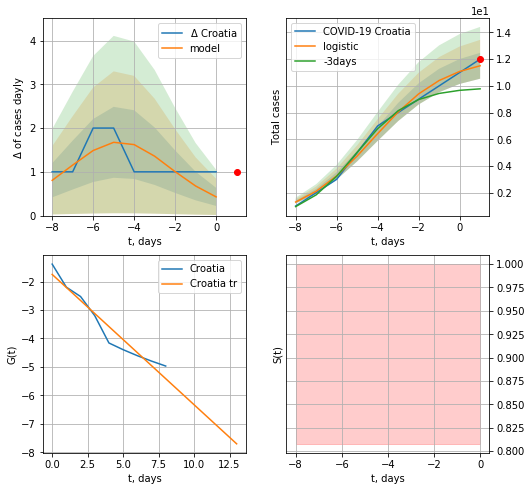

Croatia data at: 2020-05-09
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +0 days
	 deltaDaycases:  0
	 total cases:  11 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


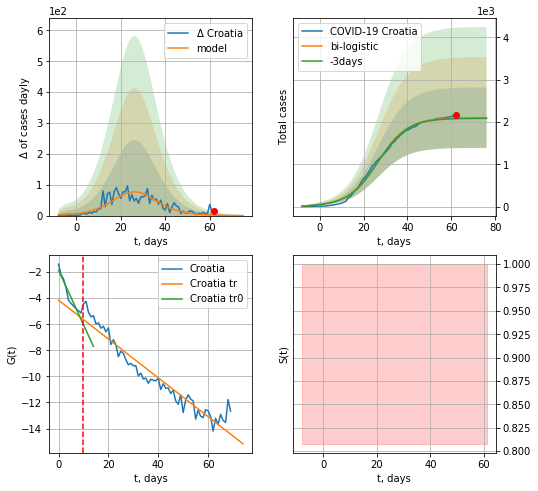

Croatia data at: 2020-05-09
+3 day model MAPE: 0.007996520908882136
model: bi-logistic
coeffs:  [2.09420476e+03 1.46958435e-01 2.66332824e+01] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.3396988297987478
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  2104 ± 715
	 total death:  84 ± 85
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.924808
 intercept: -4.152141
 slope: -0.148917


In [332]:
dfCT = read_df(pd.DataFrame(),"CT")
x = forecast("Croatia",dfCT[:10],d1,6*7-dT,pMAPE=False)
xx = forecast2("Croatia",dfCT[:],d1,8*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


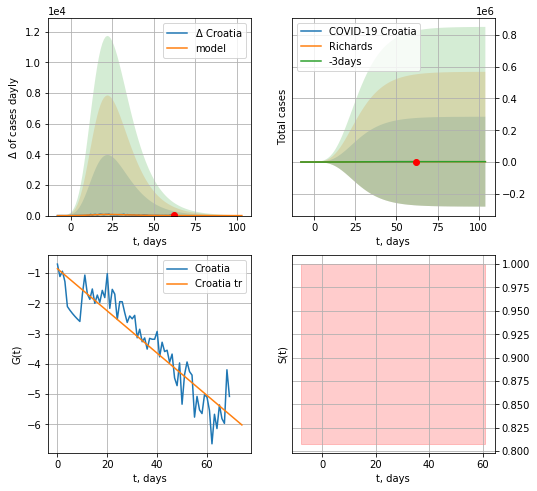

Croatia data at: 2020-05-09
+3 day model MAPE: 0.001281
model: Richards
coeffs: [ 2.21423998e+03  6.75890191e+00 -2.50372433e+01  1.33876064e-02]
rational stdev: 127.792838
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 2212 ± 282784
	 total death: 88 ± 33737
trend coefficient of determination: 0.851797
 intercept: -0.855418
 slope: -0.069832


In [333]:
x = forecastRR("Croatia",dfCT[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


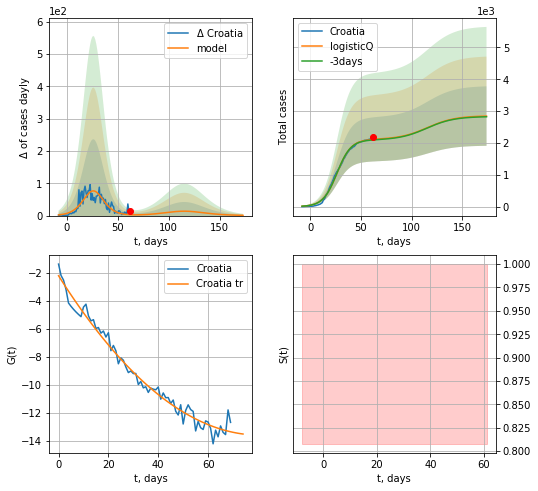

Croatia data at: 2020-05-09
+3 day model MAPE: 0.007830
model: logisticQ
coeffs: [ 2.10901466e+03  1.17984098e-06  2.65498743e+01 -1.22938761e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.328136
forecast at the end of period: +112 days
	 deltaDaycases: 0
	 total cases: 2845 ± 933
	 total death: 113 ± 111
trend coefficient of determination: 0.978244
 intercept_: -2.2152449676395936
 coeffs_: [ 0.         -0.28125798  0.00174166]


In [334]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
          date  cases  active  death
60 2020-05-05   7201    5019  452.0
61 2020-05-06   7588    5304  469.0
62 2020-05-07   7981    5612  482.0
63 2020-05-08   8476    6028  503.0
64 2020-05-09   8964    6448  514.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


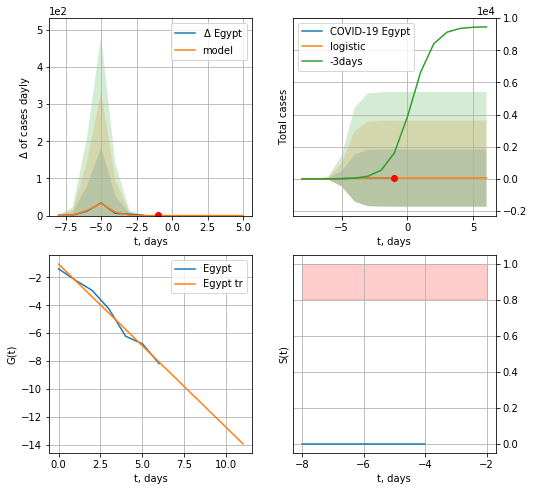

Egypt data at: 2020-05-09
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  3 ± 273
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


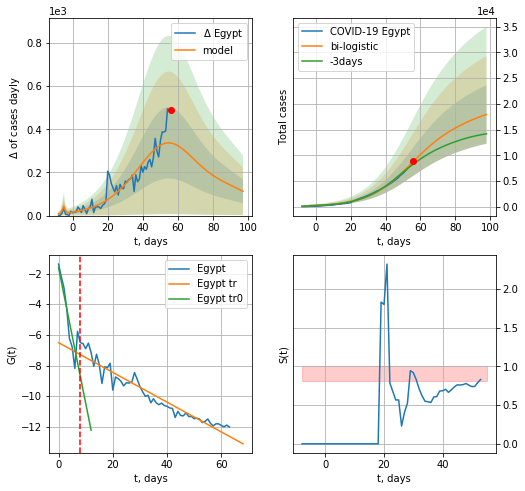

Egypt data at: 2020-05-09
+3 day model MAPE: 0.068664584657574
model: bi-logistic
coeffs:  [1.58512404e+04 8.15587145e-02 5.41211462e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.3167989907123259
forecast at the end of period: +42 days
	 deltaDaycases:  112
	 total cases:  17935 ± 5682
	 total death:  1028 ± 977
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.923654
 intercept: -6.507582
 slope: -0.097013


In [336]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*7-dT)
xx = forecast2("Egypt",dfEG[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


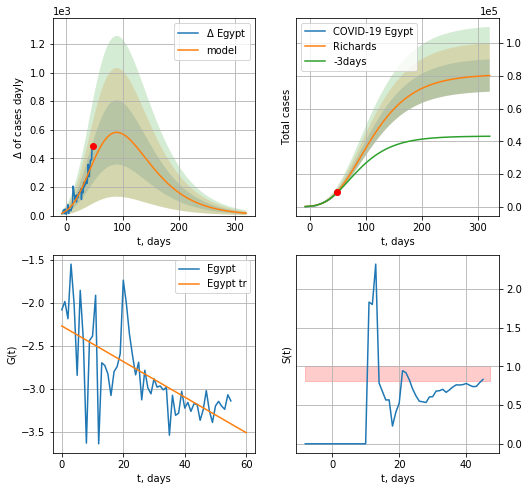

Egypt data at: 2020-05-09
+3 day model MAPE: 0.045593
model: Richards
coeffs: [ 8.10737007e+04  7.84106236e-01 -9.61651535e+01  2.51984579e-02]
rational stdev: 0.123412
forecast at the end of period: +273 days
	 deltaDaycases: 16
	 total cases: 80231 ± 9901
	 total death: 4600 ± 1703
trend coefficient of determination: 0.460631
 intercept: -2.270043
 slope: -0.020650


In [337]:
x = forecastRR("Egypt",dfEG[8:],d1,45*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


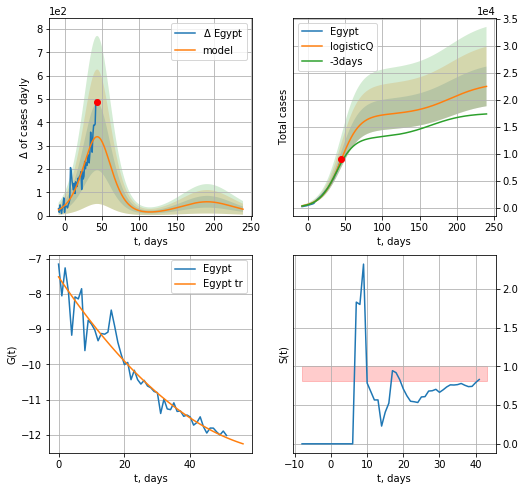

Egypt data at: 2020-05-09
+3 day model MAPE: 0.070796
model: logisticQ
coeffs: [ 1.72068496e+04  3.37360343e-05  4.39054647e+01 -2.28302946e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.163745
forecast at the end of period: +196 days
	 deltaDaycases: 27
	 total cases: 22504 ± 3685
	 total death: 1290 ± 633
trend coefficient of determination: 0.942712
 intercept_: -7.516513107439081
 coeffs_: [ 0.         -0.1388606   0.00097096]


In [338]:
x = forecastRRR("Egypt",dfEG[12:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
          date  cases  active  death
63 2020-05-05   2431   758.0  102.0
64 2020-05-06   2480   776.0  102.0
65 2020-05-07   2543   815.0  102.0
66 2020-05-08   2603   838.0  104.0
67 2020-05-09   2679   870.0  107.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


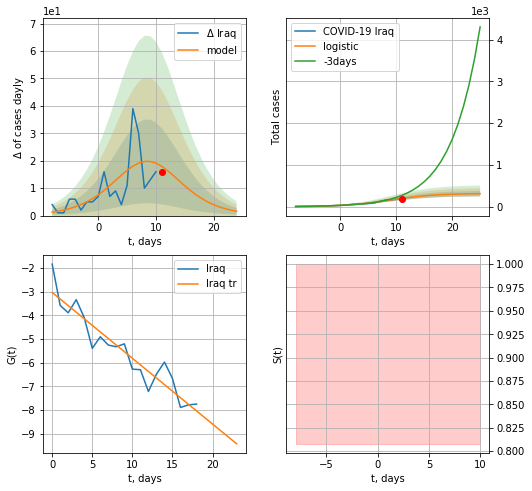

Iraq data at: 2020-05-09
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +14 days
	 deltaDaycases:  1
	 total cases:  311 ± 64
	 total death:  12 ± 7
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


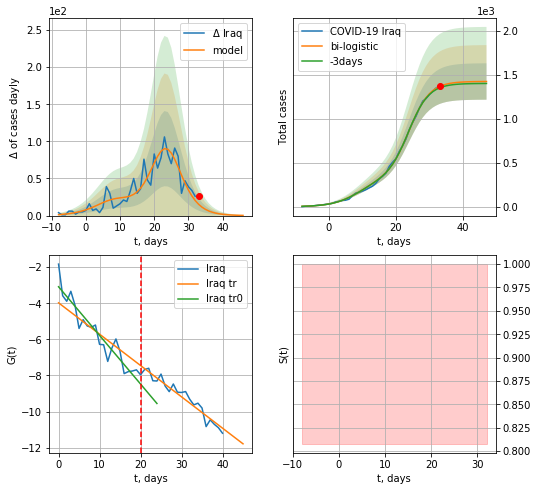

Iraq data at: 2020-05-09
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  1425 ± 207
	 total death:  56 ± 24
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


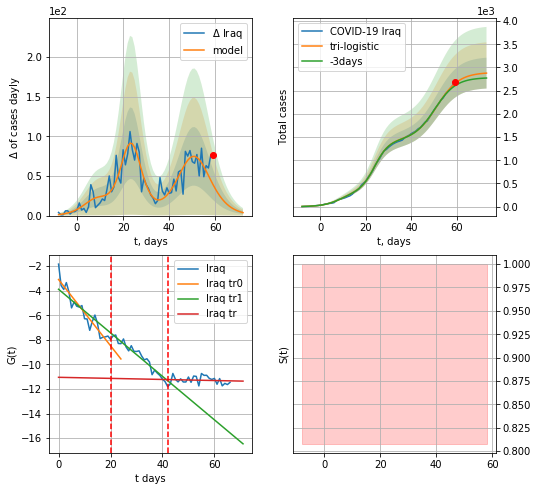

Iraq data at: 2020-05-09
+3 day model MAPE: 0.020932436283697096
model: tri-logistic
coeffs:  [1.46859293e+03 2.03805529e-01 5.11517373e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.11534001207594241
forecast at the end of period: +14 days
	 deltaDaycases:  3
	 total cases:  2877 ± 331
	 total death:  114 ± 39
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.009944
 intercept: -11.044681
 slope: -0.004371


In [339]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
x = forecast("Iraq",dfIQ[:vL],d1,8*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


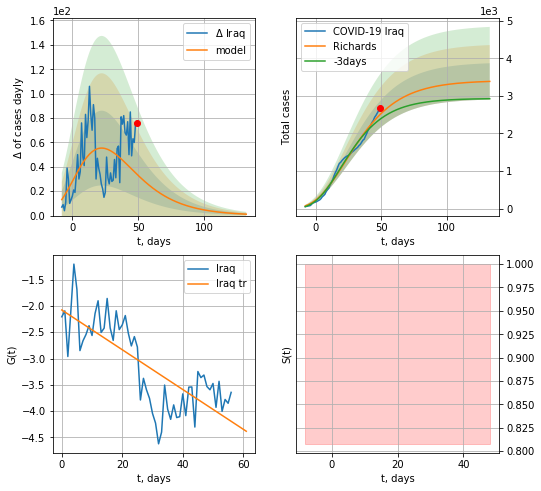

Iraq data at: 2020-05-09
+3 day model MAPE: 0.054800
model: Richards
coeffs: [ 3.41112789e+03  4.32869167e+00 -8.05524511e+01  1.02466946e-02]
rational stdev: 0.142798
forecast at the end of period: +84 days
	 deltaDaycases: 1
	 total cases: 3385 ± 483
	 total death: 135 ± 57
trend coefficient of determination: 0.585592
 intercept: -2.078093
 slope: -0.037772


In [340]:
x = forecastRR("Iraq",dfIQ[10:],d1,18*7-dT)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


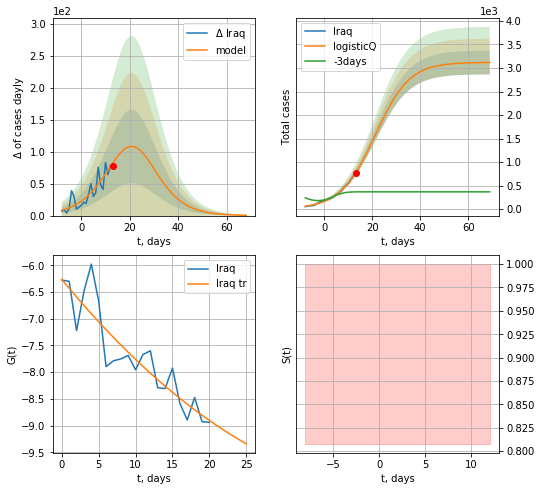

Iraq data at: 2020-05-09
+3 day model MAPE: 1.325310
model: logisticQ
coeffs: [ 3.12023575e+03  1.31776194e-04  2.10594687e+01 -1.03469115e+03]
rational stdev: 0.080850
forecast at the end of period: +56 days
	 deltaDaycases: 0
	 total cases: 3117 ± 252
	 total death: 124 ± 30
trend coefficient of determination: 0.824005
 intercept_: -6.262912434952875
 coeffs_: [ 0.         -0.16770647  0.00178172]


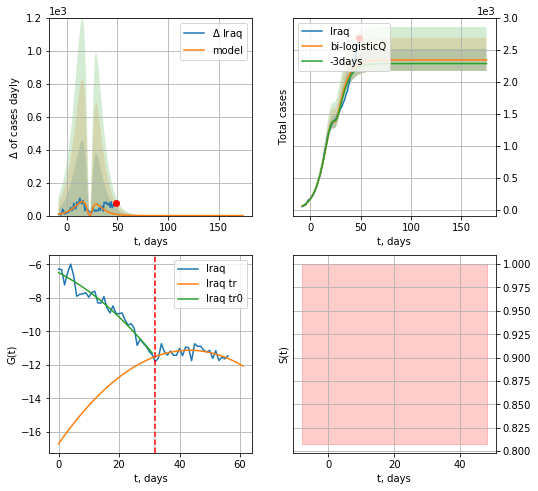

Iraq data at: 2020-05-09
+3 day model MAPE: 0.025525
model: bi-logisticQ
coeffs: [-7.78647968e+02  1.04045065e-02  2.29656284e+01 -3.01528057e+01]
rational stdev: 0.073259
forecast at the end of period: +126 days
	 deltaDaycases: 0
	 total cases: 2341 ± 171
	 total death: 93 ± 20
bi-logisticQ approximation splitting point: 32
trend coefficient of determination: 0.943011
 intercept_: -6.485709272215987
 coeffs_: [ 0.         -0.09183938 -0.00203399]
trend coefficient of determination: 0.257181
 intercept_: -16.713880159401764
 coeffs_: [ 0.          0.25860108 -0.00299058]


In [341]:
x = forecastRRR("Iraq",dfIQ[10:32],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[10:],d1,24*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=32)

In [342]:
#len(dfAR)

AR
          date   cases  active  death
62 2020-05-05  4838.0  2301.0  470.0
63 2020-05-06  4997.0  2324.0  476.0
64 2020-05-07  5182.0  2376.0  483.0
65 2020-05-08  5369.0  2414.0  488.0
66 2020-05-09  5558.0  2518.0  494.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


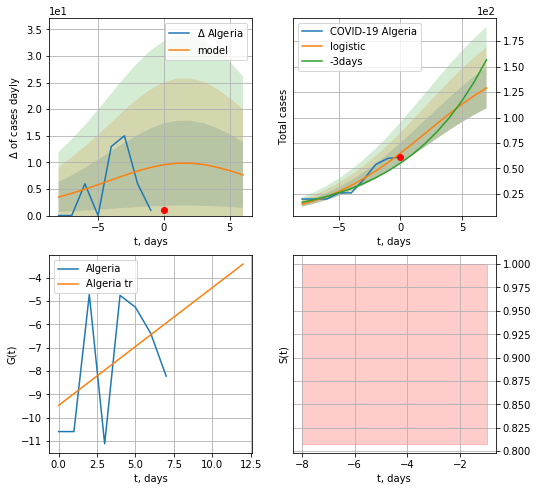

Algeria data at: 2020-05-09
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +7 days
	 deltaDaycases:  7
	 total cases:  129 ± 19
	 total death:  11 ± 5
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


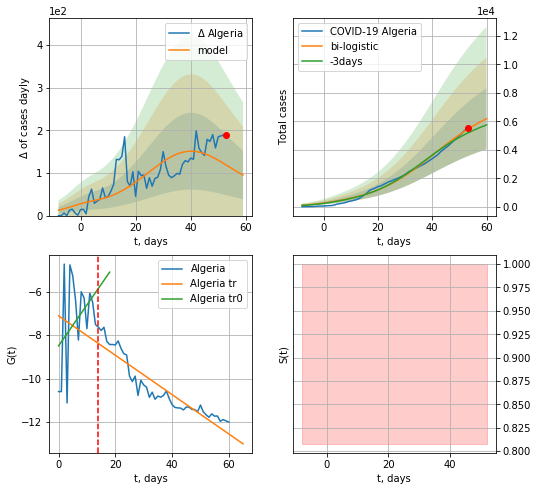

Algeria data at: 2020-05-09
+3 day model MAPE: 0.054856794152638805
model: bi-logistic
coeffs:  [6.77228145e+03 8.66556572e-02 3.99913859e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.34726388380359
forecast at the end of period: +7 days
	 deltaDaycases:  95
	 total cases:  6180 ± 2146
	 total death:  549 ± 571
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.865875
 intercept: -7.109076
 slope: -0.090675


In [344]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*7-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


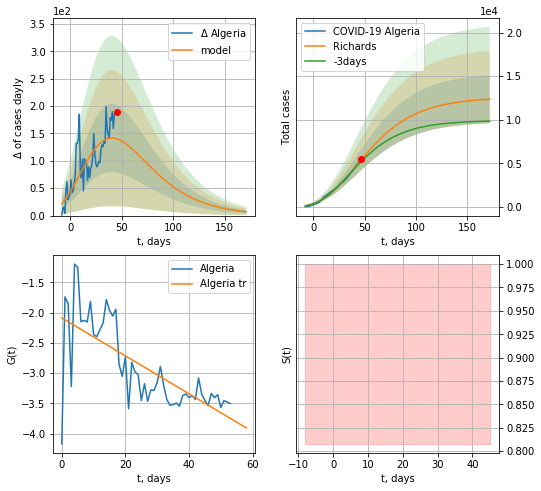

Algeria data at: 2020-05-09
+3 day model MAPE: 0.042280
model: Richards
coeffs: [ 1.25878734e+04  2.16571705e+00 -9.70522263e+01  1.42181428e-02]
rational stdev: 0.223239
forecast at the end of period: +126 days
	 deltaDaycases: 6
	 total cases: 12366 ± 2760
	 total death: 1099 ± 736
trend coefficient of determination: 0.503171
 intercept: -2.087177
 slope: -0.031362


In [345]:
x = forecastRR("Algeria",dfAR[12:],d1,24*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


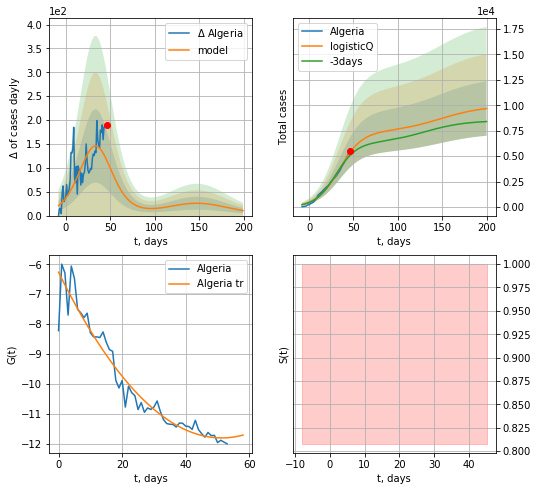

Algeria data at: 2020-05-09
+3 day model MAPE: 0.059309
model: logisticQ
coeffs: [ 7.36178776e+03  1.38359023e-06  3.39173517e+01 -5.68126260e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.275710
forecast at the end of period: +154 days
	 deltaDaycases: 10
	 total cases: 9675 ± 2667
	 total death: 859 ± 710
trend coefficient of determination: 0.938277
 intercept_: -6.266773462470054
 coeffs_: [ 0.         -0.21603869  0.00210596]


In [346]:
x = forecastRRR("Algeria",dfAR[12:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
          date  cases  active  death
54 2020-05-05  878.0   567.0   15.0
55 2020-05-06  883.0   572.0   15.0
56 2020-05-07  889.0   474.0   15.0
57 2020-05-08  891.0   476.0   15.0
58 2020-05-09  892.0   476.0   15.0


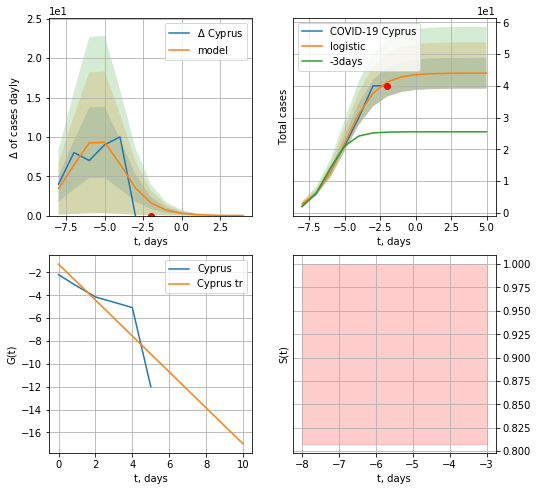

Cyprus data at: 2020-05-09
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  44 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


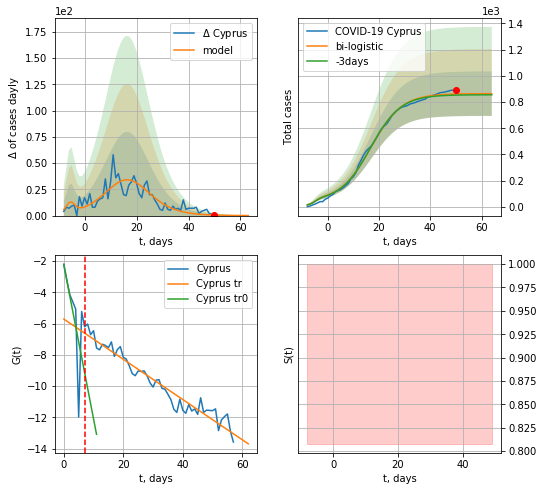

Cyprus data at: 2020-05-09
+3 day model MAPE: 0.009836033601449225
model: bi-logistic
coeffs:  [8.20371521e+02 1.66606172e-01 1.68572644e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.19647126076989838
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  864 ± 169
	 total death:  14 ± 8
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.940280
 intercept: -5.713240
 slope: -0.128805


In [348]:
dfCP = read_df(pd.DataFrame(),"CP")
x = forecast("Cyprus",dfCP[:7],d1,7*7-dT)
xx = forecast2("Cyprus",dfCP[:],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


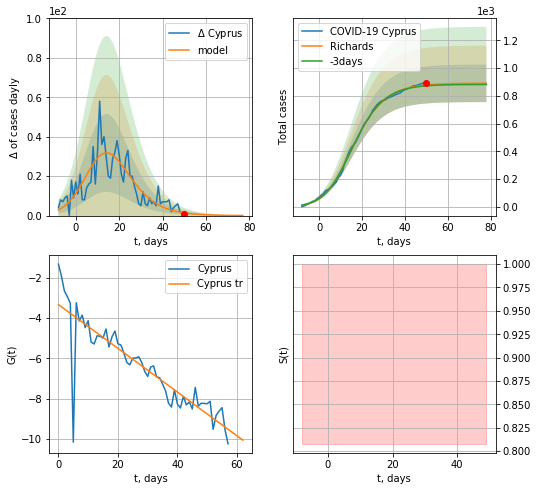

Cyprus data at: 2020-05-09
+3 day model MAPE: 0.007837
model: Richards
coeffs: [8.90493722e+02 2.37776826e-01 9.05306560e+00 5.08943537e-01]
rational stdev: 0.152082
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 890 ± 135
	 total death: 14 ± 6
trend coefficient of determination: 0.767942
 intercept: -3.330332
 slope: -0.108703


In [349]:
x = forecastRR("Cyprus",dfCP[:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


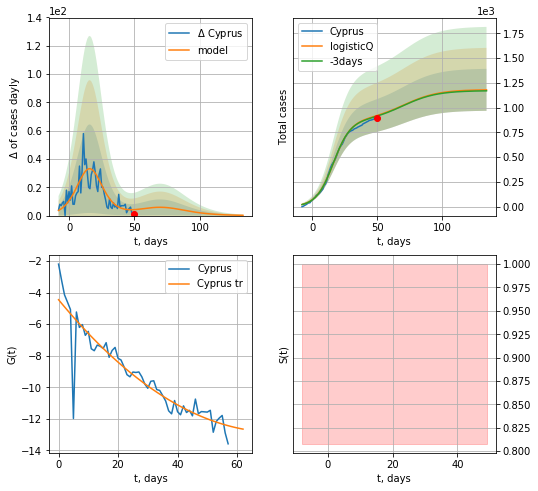

Cyprus data at: 2020-05-09
+3 day model MAPE: 0.006618
model: logisticQ
coeffs: [ 8.72596917e+02  2.18747163e-06  1.61487966e+01 -6.87164516e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.179379
forecast at the end of period: +84 days
	 deltaDaycases: 0
	 total cases: 1179 ± 211
	 total death: 19 ± 10
trend coefficient of determination: 0.846536
 intercept_: -4.4530536051125384
 coeffs_: [ 0.         -0.229072    0.00156102]


In [350]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
          date  cases   active   death
59 2020-05-05  51189  34332.0  1444.0
60 2020-05-06  54817  35757.0  1533.0
61 2020-05-07  58526  38511.0  1627.0
62 2020-05-08  61847  41121.0  1714.0
63 2020-05-09  65015  42955.0  1814.0


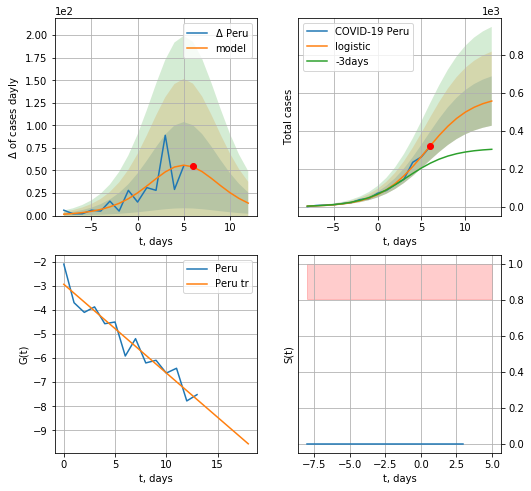

Peru data at: 2020-05-09
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +7 days
	 deltaDaycases:  13
	 total cases:  556 ± 130
	 total death:  15 ± 10
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


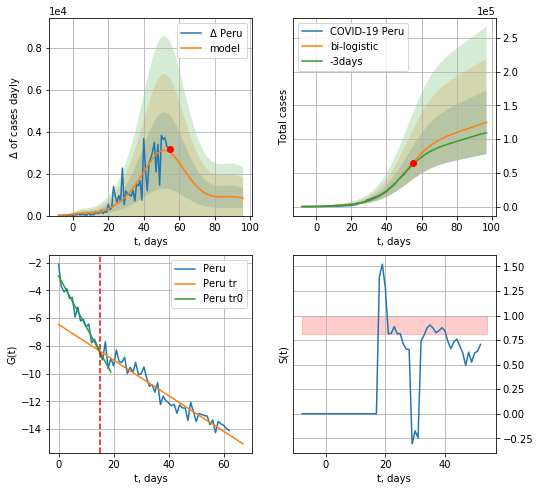

Peru data at: 2020-05-09
+3 day model MAPE: 0.048986564751462854
model: bi-logistic
coeffs:  [1.08596964e+05 1.13564603e-01 5.19503624e+01] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.37757623810211666
forecast at the end of period: +42 days
	 deltaDaycases:  826
	 total cases:  124767 ± 47109
	 total death:  3481 ± 3943
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.930065
 intercept: -6.448953
 slope: -0.128521


In [352]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*7-dT)
xx = forecast2("Peru",dfPU[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


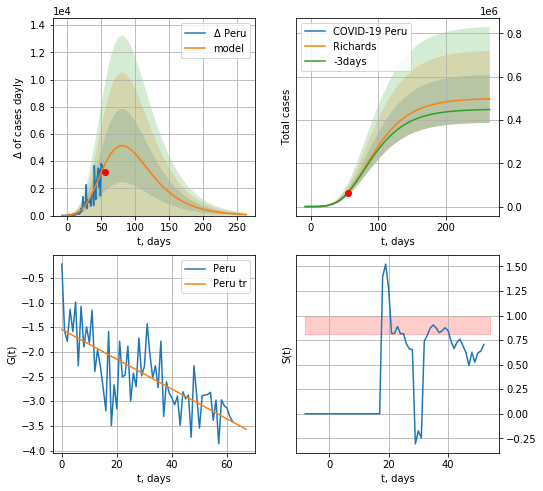

Peru data at: 2020-05-09
+3 day model MAPE: 0.009552
model: Richards
coeffs: [ 5.00743020e+05  8.17764464e-01 -3.70261704e+01  3.47102541e-02]
rational stdev: 0.222348
forecast at the end of period: +210 days
	 deltaDaycases: 78
	 total cases: 498021 ± 110734
	 total death: 13895 ± 9268
trend coefficient of determination: 0.532805
 intercept: -1.545726
 slope: -0.030216


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


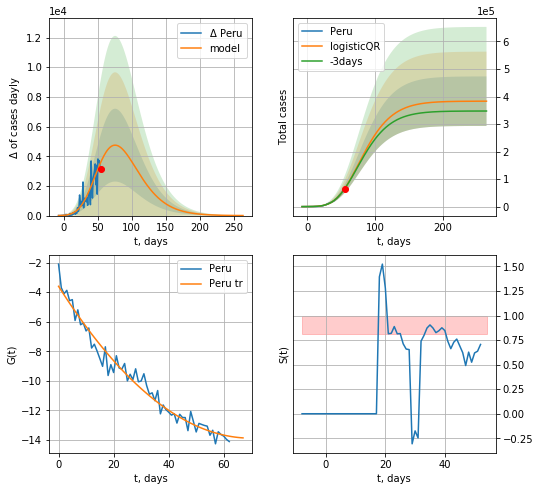

Peru data at: 2020-05-09
+3 day model MAPE: 0.010644316547462156
model: logisticQR
coeffs:  [ 3.83087864e+05  7.26379969e-03 -1.80260688e+02 -2.61005217e+02
  7.89306957e-03]
rational stdev:  0.23483873629145902
forecast at the end of period: +210 days
	 deltaDaycases:  4
	 total cases:  383016 ± 89947
	 total death:  10686 ± 7528
trend coefficient of determination: 0.969035
 intercept_: -3.6008046720810247
 coeffs_: [ 0.         -0.29369826  0.00209914]


In [353]:
x = forecastRR("Peru",dfPU[:],d1,36*7-dT)
x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


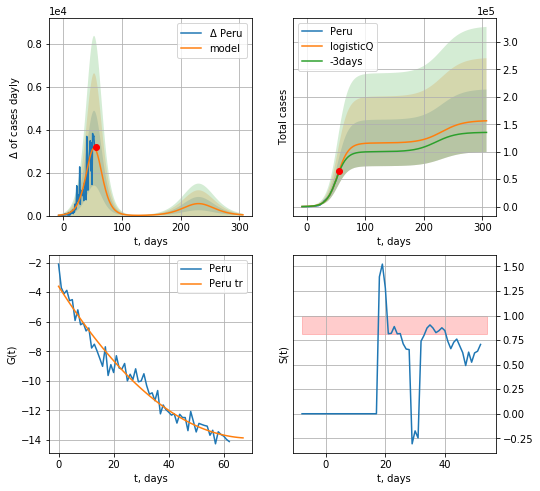

Peru data at: 2020-05-09
+3 day model MAPE: 0.042296
model: logisticQ
coeffs: [ 1.15849951e+05  5.61118214e-06  5.29355240e+01 -1.92482473e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.364690
forecast at the end of period: +252 days
	 deltaDaycases: 35
	 total cases: 156242 ± 56980
	 total death: 4359 ± 4769
trend coefficient of determination: 0.969035
 intercept_: -3.6008046720810247
 coeffs_: [ 0.         -0.29369826  0.00209914]


In [355]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,42*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
          date  cases   active   death
66 2020-05-05  49436  33558.0  1695.0
67 2020-05-06  53025  35909.0  1785.0
68 2020-05-07  56409  37729.0  1890.0
69 2020-05-08  59765  39882.0  1986.0
70 2020-05-09  62939  41472.0  2109.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


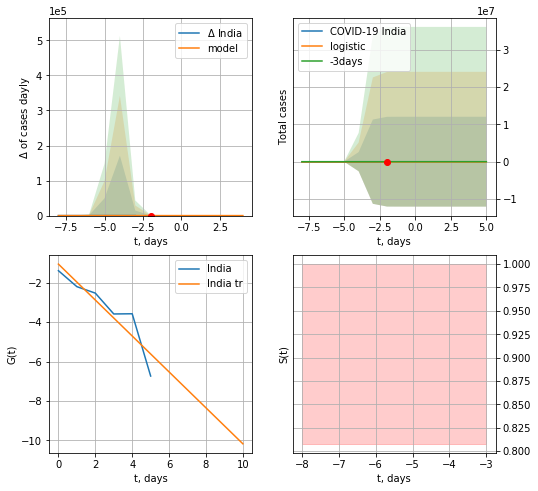

India data at: 2020-05-09
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


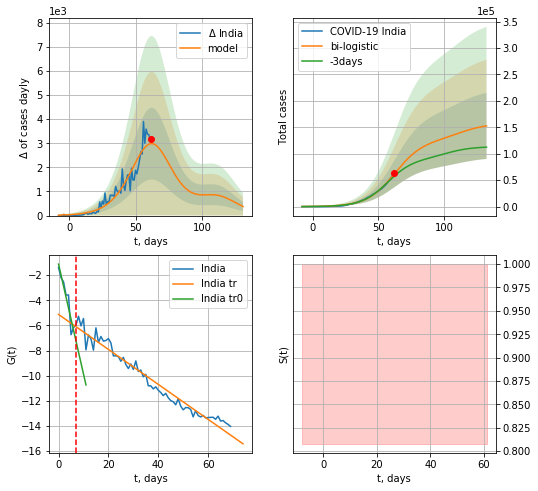

India data at: 2020-05-09
+3 day model MAPE: 0.08296948109182357
model: bi-logistic
coeffs:  [1.25670817e+05 9.42329521e-02 6.24344238e+01] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.4090831204296672
forecast at the end of period: +70 days
	 deltaDaycases:  377
	 total cases:  152665 ± 62452
	 total death:  5115 ± 6277
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.959584
 intercept: -5.123699
 slope: -0.139208


In [357]:
dfID = read_df(pd.DataFrame(),"ID")
x = forecast("India",dfID[:7],d1,7*7-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


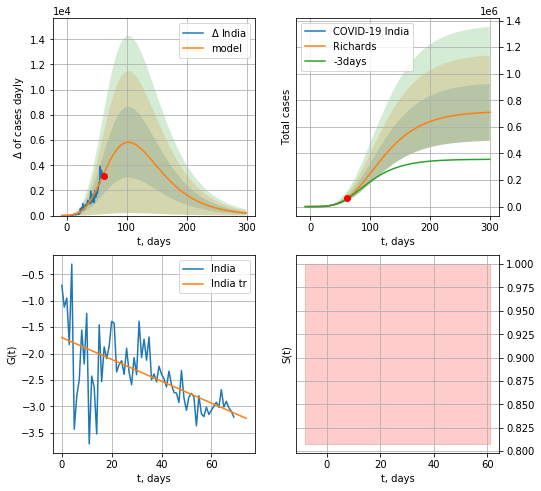

India data at: 2020-05-09
+3 day model MAPE: 0.050066
model: Richards
coeffs: [ 7.18906069e+05  1.15196875e+00 -7.39970702e+01  1.93171684e-02]
rational stdev: 0.301923
forecast at the end of period: +238 days
	 deltaDaycases: 200
	 total cases: 709920 ± 214341
	 total death: 23788 ± 21546
trend coefficient of determination: 0.375112
 intercept: -1.695436
 slope: -0.020684


In [358]:
x = forecastRR("India",dfID[:],d1,40*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


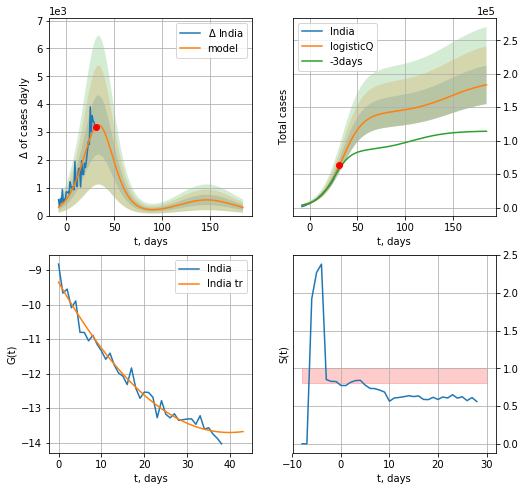

India data at: 2020-05-09
+3 day model MAPE: 0.087348
model: logisticQ
coeffs: [ 1.41026215e+05  7.91474494e-05  3.36210178e+01 -1.12695934e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.157181
forecast at the end of period: +154 days
	 deltaDaycases: 292
	 total cases: 183519 ± 28845
	 total death: 6149 ± 2899
trend coefficient of determination: 0.975446
 intercept_: -9.347576893446664
 coeffs_: [ 0.         -0.21884129  0.00274531]


In [359]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
          date   cases  active  death
62 2020-05-05  5020.0  3284.0  264.0
63 2020-05-06  5208.0  3411.0  273.0
64 2020-05-07  5371.0  3488.0  282.0
65 2020-05-08  5611.0  3659.0  293.0
66 2020-05-09  5776.0  3748.0  300.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


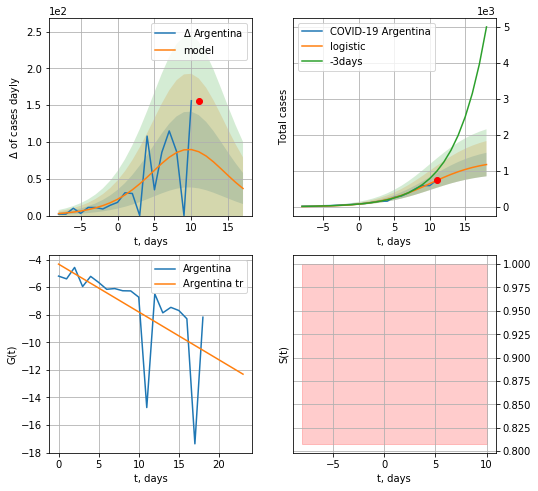

Argentina data at: 2020-05-09
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +7 days
	 deltaDaycases:  36
	 total cases:  1172 ± 325
	 total death:  60 ± 49
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


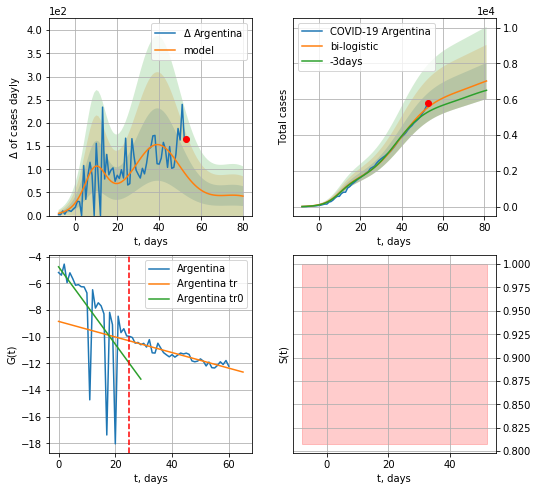

Argentina data at: 2020-05-09
+3 day model MAPE: 0.05321591259589642
model: bi-logistic
coeffs:  [5.04498880e+03 1.20495509e-01 3.95334572e+01] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.14313574962077003
forecast at the end of period: +28 days
	 deltaDaycases:  42
	 total cases:  7020 ± 1004
	 total death:  364 ± 156
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.851198
 intercept: -8.855370
 slope: -0.058383


In [361]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*7-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,10*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


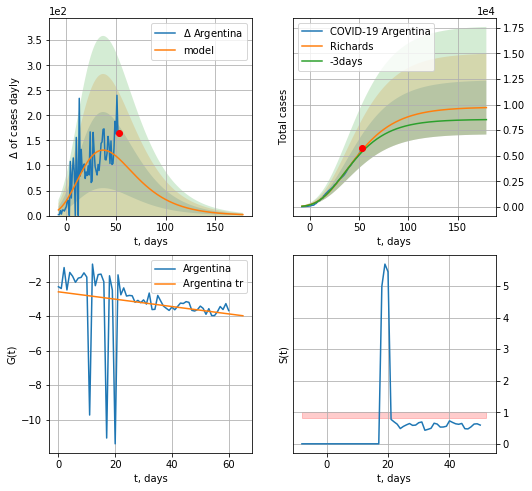

Argentina data at: 2020-05-09
+3 day model MAPE: 0.032653
model: Richards
coeffs: [ 9.75763769e+03  2.65086381e+00 -7.91515378e+01  1.38368104e-02]
rational stdev: 0.271304
forecast at the end of period: +126 days
	 deltaDaycases: 2
	 total cases: 9703 ± 2632
	 total death: 503 ± 409
trend coefficient of determination: 0.039517
 intercept: -2.586932
 slope: -0.021358


In [362]:
x = forecastRR('Argentina',dfAG[5:].fillna(0),d1,24*7-dT,1.0)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


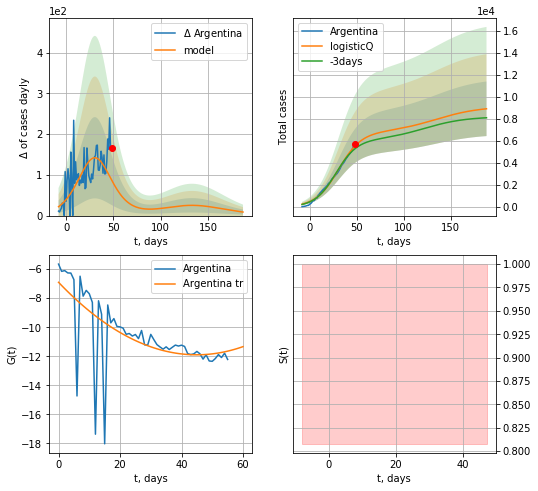

Argentina data at: 2020-05-09
+3 day model MAPE: 0.049200
model: logisticQ
coeffs: [ 6.76015625e+03  1.40922462e-06  3.07205312e+01 -5.90400506e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.277615
forecast at the end of period: +140 days
	 deltaDaycases: 8
	 total cases: 8929 ± 2478
	 total death: 463 ± 385
trend coefficient of determination: 0.382613
 intercept_: -6.905504362299873
 coeffs_: [ 0.         -0.22220831  0.00247352]


In [363]:
x = forecastRRR('Argentina',dfAG[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


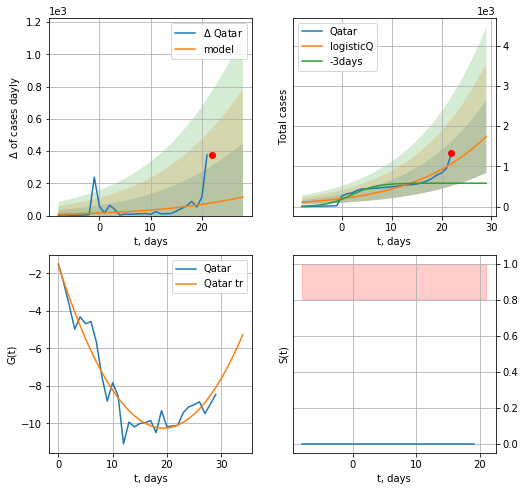

Qatar data at: 2020-05-09
+3 day model MAPE: 0.969413
model: logisticQ
coeffs: [ 1.17152185e+04  1.38701641e-05  5.07935568e+01 -5.73629534e+03]
rational stdev: 0.519403
forecast at the end of period: +7 days
	 deltaDaycases: 115
	 total cases: 1745 ± 906
	 total death: 1 ± 1
trend coefficient of determination: 0.927713
 intercept_: -1.5731660703847918
 coeffs_: [ 0.         -0.89771885  0.02321841]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


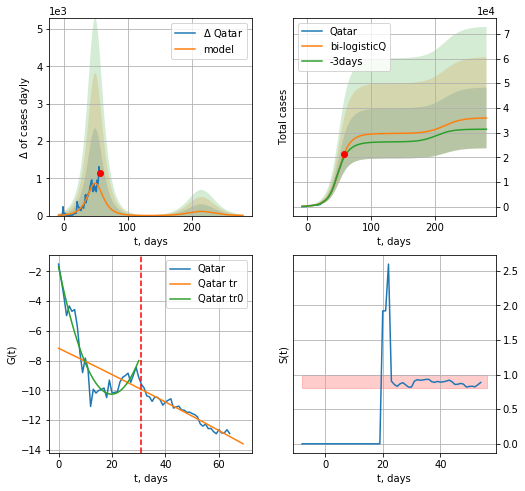

Qatar data at: 2020-05-09
+3 day model MAPE: 0.062437
model: bi-logisticQ
coeffs: [ 1.79152566e+04  5.21359748e-06  4.94411008e+01 -2.70474837e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.342455
forecast at the end of period: +224 days
	 deltaDaycases: 4
	 total cases: 35915 ± 12299
	 total death: 21 ± 21
bi-logisticQ approximation splitting point: 31
trend coefficient of determination: 0.919409
 intercept_: -1.6852707465713292
 coeffs_: [ 0.         -0.86529683  0.02183056]
trend coefficient of determination: 0.951948
 intercept_: -7.168703797340779
 coeffs_: [ 0.00000000e+00 -8.66359196e-02 -9.50458154e-05]


In [365]:
vL=31
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*7-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


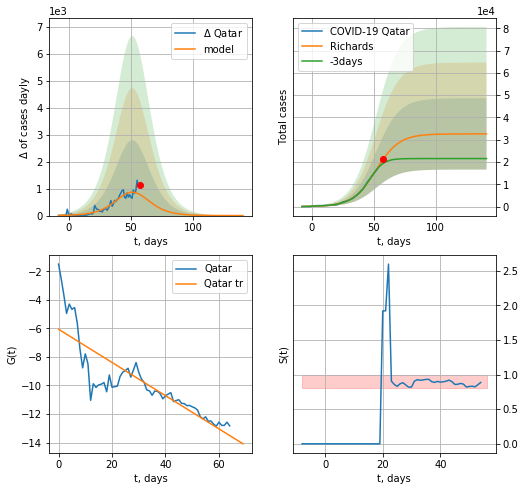

Qatar data at: 2020-05-09
+3 day model MAPE: 0.103903
model: Richards
coeffs: [3.26380682e+04 1.07042621e-01 5.15731085e+01 9.92224523e-01]
rational stdev: 0.490324
forecast at the end of period: +84 days
	 deltaDaycases: 0
	 total cases: 32635 ± 16002
	 total death: 19 ± 27
trend coefficient of determination: 0.723540
 intercept: -6.058822
 slope: -0.116337


In [366]:
x = forecastRR('Qatar',dfQR[:].fillna(0),d1,18*7-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])

In [367]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
          date    cases  active  death
80 2020-05-05  15192.0   11893  146.0
81 2020-05-06  15738.0   12222  157.0
82 2020-05-07  16240.0   12503  165.0
83 2020-05-08  16793.0   12782  174.0
84 2020-05-09  17417.0   12937  185.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


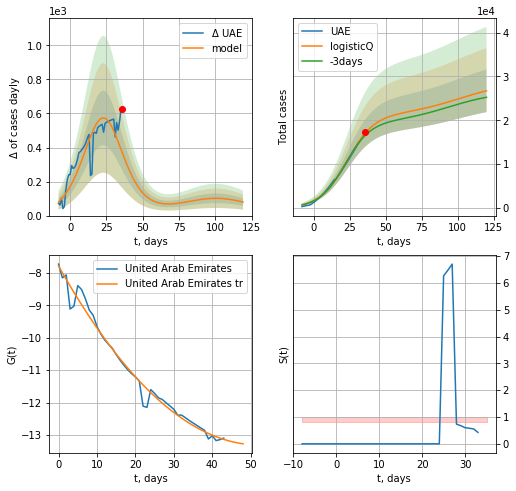

UAE data at: 2020-05-09
+3 day model MAPE: 0.033988
model: logisticQ
coeffs: [ 2.12047949e+04  2.82019911e-06  2.31894686e+01 -3.79660801e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.181714
forecast at the end of period: +84 days
	 deltaDaycases: 79
	 total cases: 26723 ± 4856
	 total death: 283 ± 154
trend coefficient of determination: 0.980536
 intercept_: -7.787916701940736
 coeffs_: [ 0.         -0.21122604  0.00202059]


In [368]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


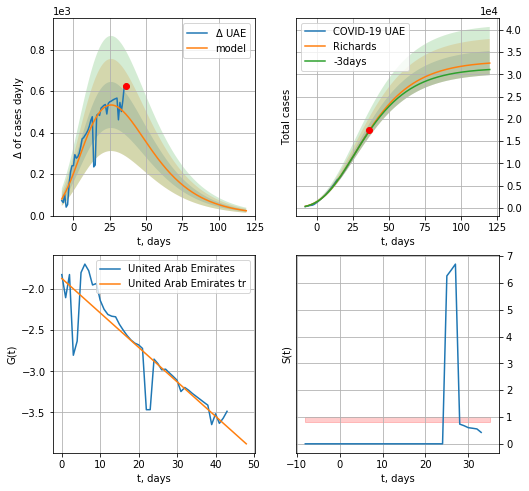

UAE data at: 2020-05-09
+3 day model MAPE: 0.009952
model: Richards
coeffs: [ 3.30220707e+04  2.73880639e+00 -6.67043283e+01  1.61718504e-02]
rational stdev: 0.083198
forecast at the end of period: +84 days
	 deltaDaycases: 23
	 total cases: 32503 ± 2704
	 total death: 345 ± 86
trend coefficient of determination: 0.825237
 intercept: -1.870984
 slope: -0.041909


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


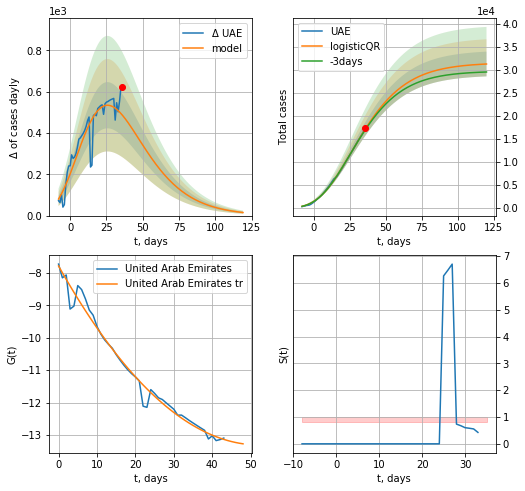

UAE data at: 2020-05-09
+3 day model MAPE: 0.011198613514773172
model: logisticQR
coeffs:  [ 3.15176016e+04  8.24937803e-03 -1.04095334e+02 -8.92533047e+02
  5.34269822e-03]
rational stdev:  0.08579787117853964
forecast at the end of period: +84 days
	 deltaDaycases:  14
	 total cases:  31251 ± 2681
	 total death:  331 ± 85
trend coefficient of determination: 0.980536
 intercept_: -7.787916701940736
 coeffs_: [ 0.         -0.21122604  0.00202059]


In [369]:
x = forecastRR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [370]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
          date    cases  active  death
63 2020-05-05  30251.0   24620  200.0
64 2020-05-06  31938.0   24946  209.0
65 2020-05-07  33731.0   25714  219.0
66 2020-05-08  35432.0   26083  229.0
67 2020-05-09  37136.0   26753  239.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


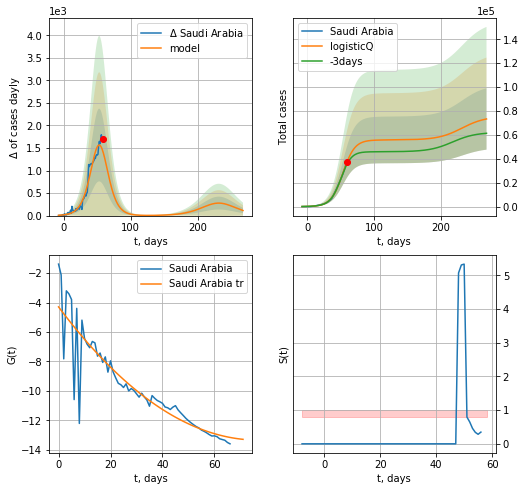

Saudi Arabia data at: 2020-05-09
+3 day model MAPE: 0.051234
model: logisticQ
coeffs: [ 5.57992493e+04  1.67942412e-05  5.32639684e+01 -6.63385813e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.350081
forecast at the end of period: +210 days
	 deltaDaycases: 112
	 total cases: 73346 ± 25677
	 total death: 472 ± 495
trend coefficient of determination: 0.817796
 intercept_: -4.294351324633505
 coeffs_: [ 0.         -0.23557774  0.00153169]


In [371]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


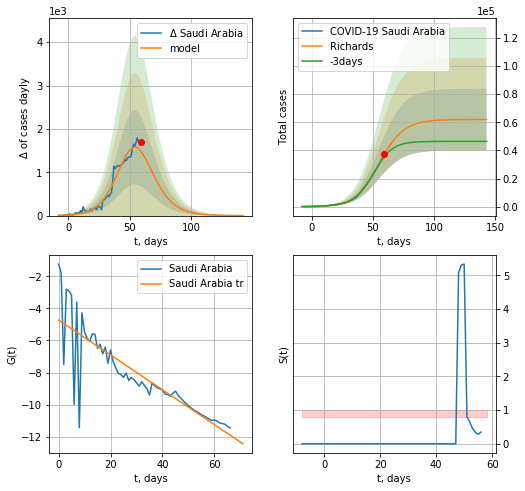

Saudi Arabia data at: 2020-05-09
+3 day model MAPE: 0.054735
model: Richards
coeffs: [6.20659538e+04 1.19777098e-01 5.20480170e+01 7.93853128e-01]
rational stdev: 0.353799
forecast at the end of period: +84 days
	 deltaDaycases: 1
	 total cases: 62052 ± 21954
	 total death: 399 ± 423
trend coefficient of determination: 0.723299
 intercept: -4.728662
 slope: -0.108527


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


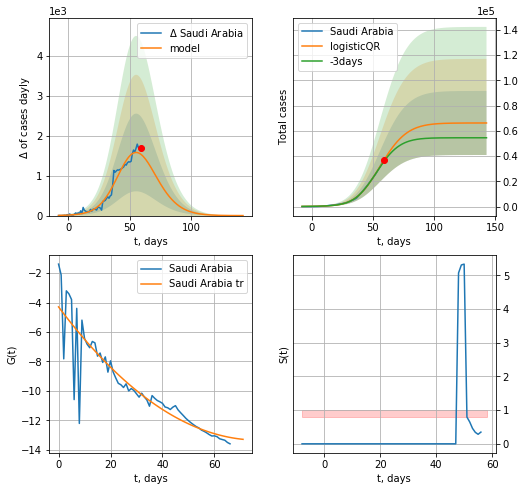

Saudi Arabia data at: 2020-05-09
+3 day model MAPE: 0.033904095478147975
model: logisticQR
coeffs:  [ 6.62826962e+04  4.29848523e-03 -2.66086004e+01 -2.03822710e+00
  1.17439568e-01]
rational stdev:  0.38292676786858837
forecast at the end of period: +84 days
	 deltaDaycases:  0
	 total cases:  66280 ± 25380
	 total death:  426 ± 489
trend coefficient of determination: 0.817796
 intercept_: -4.294351324633505
 coeffs_: [ 0.         -0.23557774  0.00153169]


In [372]:
x = forecastRR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
          date  cases  active  death
49 2020-04-28  619.0       0      0
50 2020-04-29  649.0       0      0
51 2020-04-30  663.0       0      0
52 2020-05-01  690.0       0      0
53 2020-05-02  702.0       0      0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


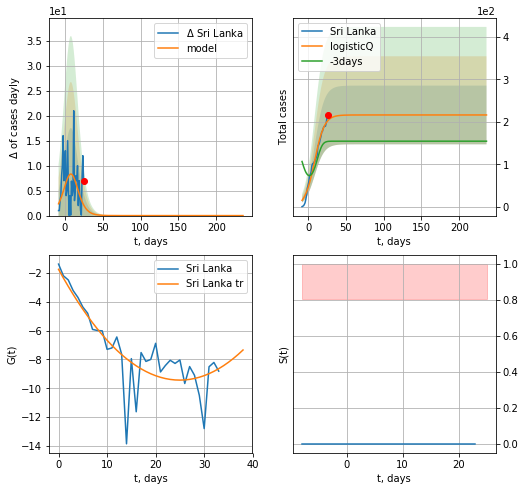

Sri Lanka data at: 2020-05-09
+3 day model MAPE: 0.324795
model: logisticQ
coeffs: [ 2.16378650e+02  6.51099157e-05  8.63891239e+00 -2.35705824e+03]
rational stdev: 0.318765
forecast at the end of period: +210 days
	 deltaDaycases: 0
	 total cases: 216 ± 68
	 total death: 2 ± 1
trend coefficient of determination: 0.700492
 intercept_: -1.7495743977322356
 coeffs_: [ 0.         -0.61543768  0.0123203 ]


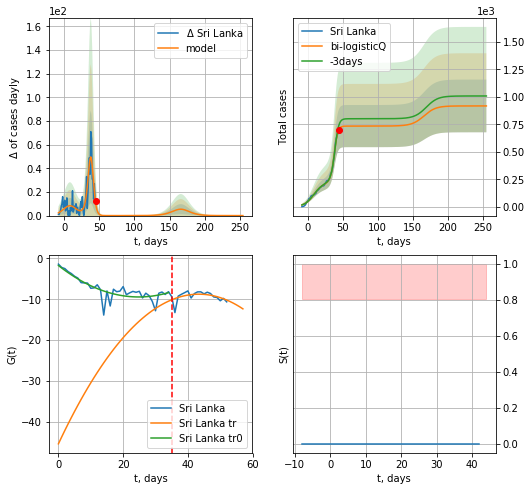

Sri Lanka data at: 2020-05-09
+3 day model MAPE: 0.062838
model: bi-logisticQ
coeffs: [ 5.18033887e+02  4.95277952e-03  3.80543331e+01 -3.87676409e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.261390
forecast at the end of period: +210 days
	 deltaDaycases: 0
	 total cases: 917 ± 239
	 total death: 9 ± 7
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.700900
 intercept_: -1.7291427146735243
 coeffs_: [ 0.         -0.62059696  0.01251448]
trend coefficient of determination: 0.356970
 intercept_: -45.35102800084556
 coeffs_: [ 0.          1.68688112 -0.01943157]


In [373]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 35
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,36*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

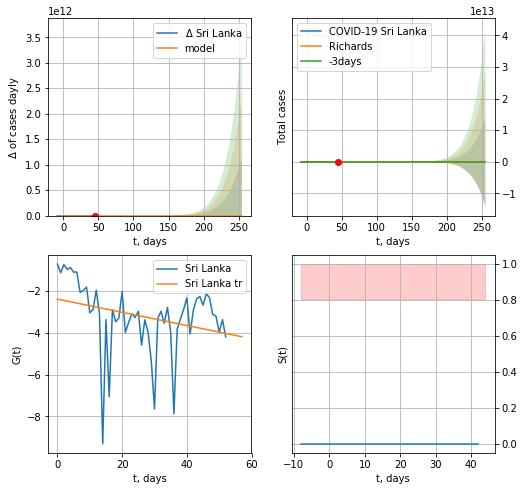

Sri Lanka data at: 2020-05-09
+3 day model MAPE: 1.000000
model: Richards
coeffs: [4.46105073e+02 3.48947501e-01 1.30751802e-01 1.91221241e-02]
rational stdev: 205193802976327.718750
forecast at the end of period: +210 days
	 deltaDaycases: 0
	 total cases: 0 ± 14228869409716
	 total death: 0 ± 0
trend coefficient of determination: 0.080211
 intercept: -2.384018
 slope: -0.031605


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


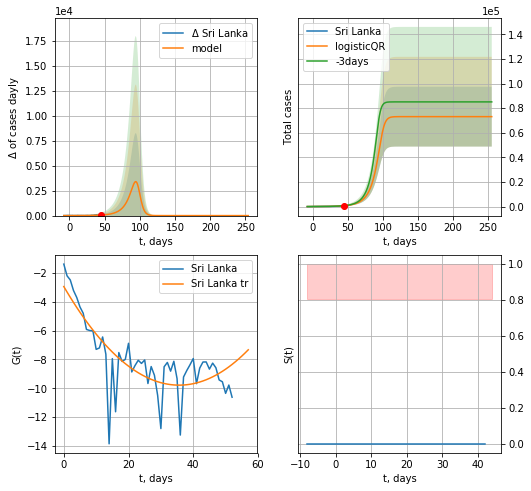

Sri Lanka data at: 2020-05-09
+3 day model MAPE: 0.05518169076740634
model: logisticQR
coeffs:  [ 7.31338913e+04  3.14273708e-04  9.79417920e+01 -2.30767672e+02
  2.83954838e+00]
rational stdev:  0.33242925378994026
forecast at the end of period: +210 days
	 deltaDaycases:  0
	 total cases:  73133 ± 24311
	 total death:  777 ± 774
trend coefficient of determination: 0.612466
 intercept_: -2.9436925942027994
 coeffs_: [ 0.         -0.38378893  0.00538271]


In [374]:
x = forecastRR('Sri Lanka',dfSri[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('Sri Lanka',dfSri[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
          date    cases  active  death
64 2020-05-01  18092.0   11207  417.0
65 2020-05-02  19022.0   11813  437.0
66 2020-05-03  20084.0   12443  457.0
67 2020-05-04  20941.0   13047  476.0
68 2020-05-05  22049.0   13714  514.0


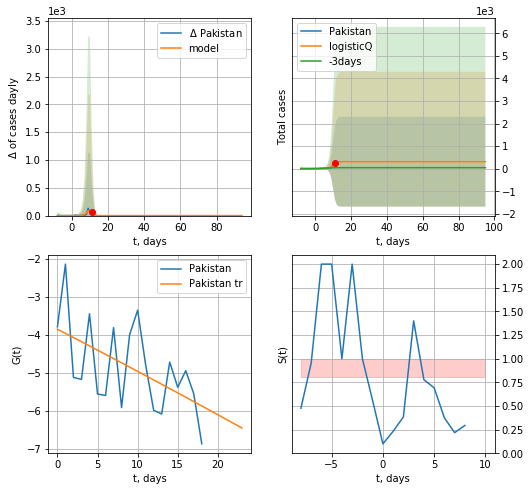

Pakistan data at: 2020-05-09
+3 day model MAPE: 5.954391
model: logisticQ
coeffs: [ 3.10300107e+02  5.80299152e-02  9.88962591e+00 -1.18245381e+01]
rational stdev: 6.420495
forecast at the end of period: +84 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


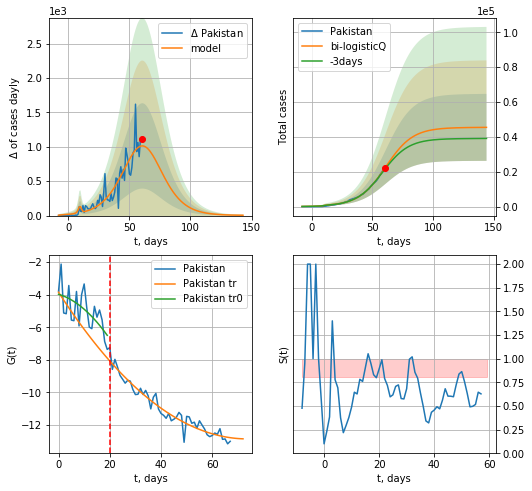

Pakistan data at: 2020-05-09
+3 day model MAPE: 0.033918
model: bi-logisticQ
coeffs: [ 4.51325915e+04  5.22299699e-06  6.10158487e+01 -1.71298715e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.422516
forecast at the end of period: +84 days
	 deltaDaycases: 5
	 total cases: 45483 ± 19217
	 total death: 986 ± 1249
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.936260
 intercept_: -3.856647542116999
 coeffs_: [ 0.         -0.24367244  0.00165147]


In [375]:
dfPS = read_df(pd.DataFrame(),"PS")
vL= 20
x = forecastRRR('Pakistan',dfPS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Pakistan',dfPS[:],d1,18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


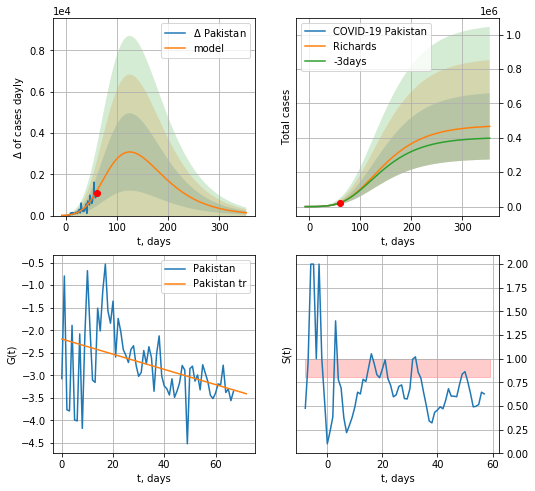

Pakistan data at: 2020-05-09
+3 day model MAPE: 0.010298
model: Richards
coeffs: [ 4.73826893e+05  4.89052373e-01 -5.79454179e+01  3.68149466e-02]
rational stdev: 0.413337
forecast at the end of period: +294 days
	 deltaDaycases: 138
	 total cases: 466156 ± 192679
	 total death: 10109 ± 12535
trend coefficient of determination: 0.166507
 intercept: -2.193701
 slope: -0.016865


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


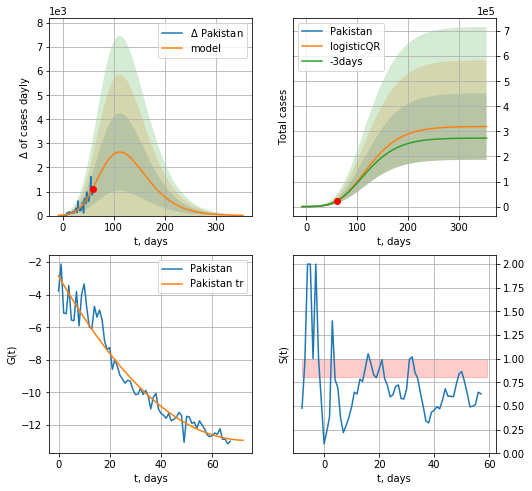

Pakistan data at: 2020-05-09
+3 day model MAPE: 0.009863654797638451
model: logisticQR
coeffs:  [ 3.19689653e+05  2.08656275e-03 -2.01471109e+02 -4.07580892e+02
  1.30756770e-02]
rational stdev:  0.41470182955252466
forecast at the end of period: +294 days
	 deltaDaycases:  8
	 total cases:  319452 ± 132477
	 total death:  6927 ± 8617
trend coefficient of determination: 0.943285
 intercept_: -2.866456132174452
 coeffs_: [ 0.         -0.27440734  0.00187034]


In [376]:
x = forecastRR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
          date    cases  active  death
55 2020-05-02   8790.0    8438    175
56 2020-05-03   9455.0    8215    177
57 2020-05-04  10143.0    8752    182
58 2020-05-05  10929.0    9343    183
59 2020-05-06  11719.0   10130    186


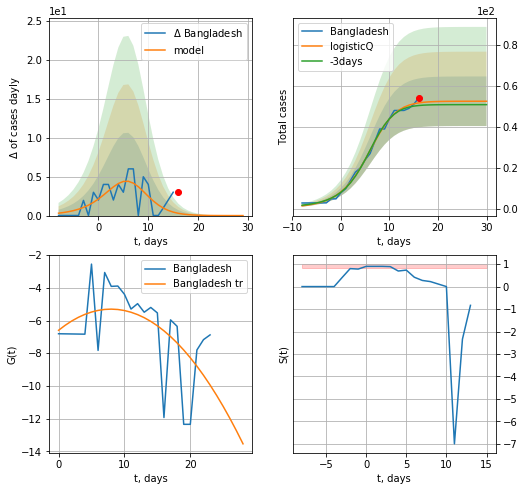

Bangladesh data at: 2020-05-09
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923176e+01  5.83632898e-03  5.49442770e+00 -5.18799455e+01]
rational stdev: 0.229670
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


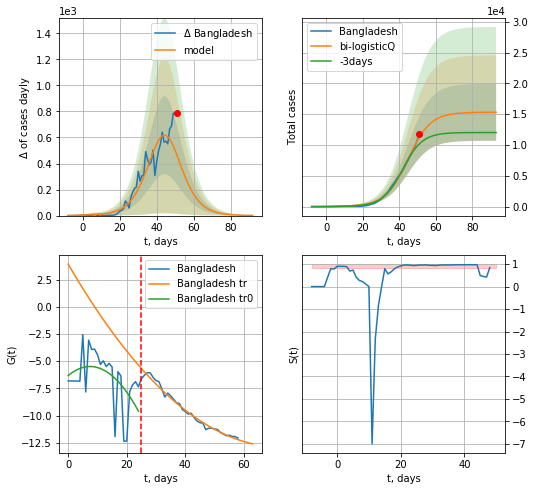

Bangladesh data at: 2020-05-09
+3 day model MAPE: 0.121997
model: bi-logisticQ
coeffs: [ 1.52576917e+04  4.82282721e-06  4.47207282e+01 -3.35831063e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.301595
forecast at the end of period: +42 days
	 deltaDaycases: 1
	 total cases: 15305 ± 4616
	 total death: 237 ± 214
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.980575
 intercept_: 3.92534182185733
 coeffs_: [ 0.         -0.4635868   0.00319602]


In [377]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
x = forecastRRR('Bangladesh',dfBN[:vL],d1,8*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Bangladesh',dfBN[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


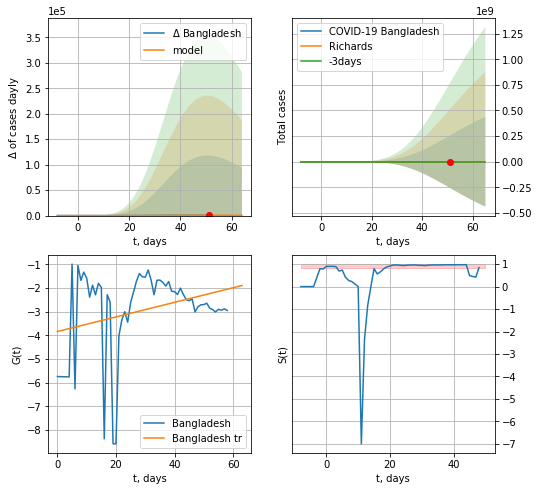

Bangladesh data at: 2020-05-09
+3 day model MAPE: 0.055506
model: Richards
coeffs: [ 3.07100009e+04  2.17207180e+00 -1.32880171e+01  2.61159639e-02]
rational stdev: 22375.959220
forecast at the end of period: +14 days
	 deltaDaycases: 503
	 total cases: 19608 ± 438765709
	 total death: 304 ± 20406874
trend coefficient of determination: 0.086669
 intercept: -3.832533
 slope: 0.030849


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


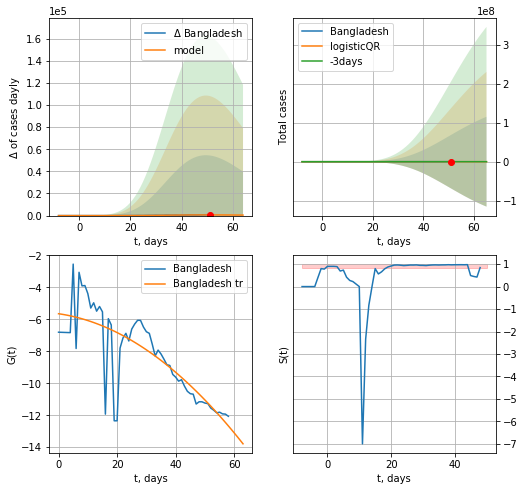

Bangladesh data at: 2020-05-09
+3 day model MAPE: 0.059514524812985733
model: logisticQR
coeffs:  [ 2.70091422e+04  3.12884912e-02 -7.41561616e+01 -2.11791577e+02
  5.24797657e-03]
rational stdev:  5991.5632608904825
forecast at the end of period: +14 days
	 deltaDaycases:  455
	 total cases:  19203 ± 115056415
	 total death:  298 ± 5356457
trend coefficient of determination: 0.630447
 intercept_: -5.653904656846626
 coeffs_: [ 0.         -0.02628648 -0.00163203]


In [378]:
x = forecastRR('Bangladesh',dfBN[:],d1,8*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('Bangladesh',dfBN[:],d1,8*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [378]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [4]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=13:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

/usr/local/lib/python3.5/dist-packages/requests/__init__.py:83: RequestsDependencyWarning: Old version of cryptography ([1, 2, 3]) may cause slowdown.
  warnings.warn(warning, RequestsDependencyWarning)


[13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13]
1:"Country,Other"
2:"TotalCases"
3:"NewCases"
4:"TotalDeaths"
5:"NewDeaths"
6:"TotalRecovered"
7:"ActiveCases"
8:"Serious,Critical"
9:"Tot Cases/1M pop"
10:"Deaths/1M pop"
11:"TotalTests"
12:"Tests/
1M pop
"
13:"Continent"
[461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461]


In [5]:
df.head(10)

,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,"1,084,358",North America,\nNorth America\n,,"+2,389",200,"17,985",,"1,474,770","89,051","301,361",,
1,"806,888",Europe,\nEurope\n,,84,8,"14,339",,"1,605,922","151,773","647,261",,
2,"179,108",South America,\nSouth America\n,,177,8,"10,095",,"298,131","15,400","103,623",,
3,"270,326",Asia,\nAsia\n,,"+1,023",11,"5,008",,"651,907","21,862","359,719",,
4,"38,105",Africa,\nAfrica\n,,1,,217,,"61,986","2,232","21,649",,
5,811,Australia/Oceania,\nOceania\n,,12,,20,,"8,537",118,"7,608",,
6,61,,\n\n,,,,4,,721,15,645,,
7,"2,379,657",All,World,36.0,"+3,686",227,"47,668",,"4,101,974","280,451","1,441,866",,526
8,"1,029,194",North America,USA,242,,,"16,816","26,943","1,347,309","80,037","238,078","8,918,263","4,070"
9,"63,148",Europe,Spain,566,,,"1,741","52,781","262,783","26,478","173,157","2,467,761","5,620"


In [6]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",df.columns[3]:"Deathsper1Mpop","Serious,Critical":"Serious_Critical",df.columns[7]:"Testsper1Mpop",df.columns[12]:"TotCasesper1Mpop"})
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,"1,084,358",North America,\nNorth America\n,,"+2,389",200,"17,985",,"1,474,770","89,051","301,361",,
1,"806,888",Europe,\nEurope\n,,84,8,"14,339",,"1,605,922","151,773","647,261",,
2,"179,108",South America,\nSouth America\n,,177,8,"10,095",,"298,131","15,400","103,623",,
3,"270,326",Asia,\nAsia\n,,"+1,023",11,"5,008",,"651,907","21,862","359,719",,
4,"38,105",Africa,\nAfrica\n,,1,,217,,"61,986","2,232","21,649",,


In [7]:
df[df["Country"]=="Lithuania"]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
93,567,Europe,Lithuania,18,,,17,"66,243","1,444",49,828,"180,332",530
325,567,Europe,Lithuania,18,8,,17,"66,243","1,444",49,828,"180,332",530


In [8]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

230


In [9]:
df.head(24)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,"1,084,358",North America,\nNorth America\n,,"+2,389",200,"17,985",,"1,474,770","89,051","301,361",,
1,"806,888",Europe,\nEurope\n,,84,8,"14,339",,"1,605,922","151,773","647,261",,
2,"179,108",South America,\nSouth America\n,,177,8,"10,095",,"298,131","15,400","103,623",,
3,"270,326",Asia,\nAsia\n,,"+1,023",11,"5,008",,"651,907","21,862","359,719",,
4,"38,105",Africa,\nAfrica\n,,1,,217,,"61,986","2,232","21,649",,
5,811,Australia/Oceania,\nOceania\n,,12,,20,,"8,537",118,"7,608",,
6,61,,\n\n,,,,4,,721,15,645,,
7,"2,379,657",All,World,36.0,"+3,686",227,"47,668",,"4,101,974","280,451","1,441,866",,526
8,"1,029,194",North America,USA,242,,,"16,816","26,943","1,347,309","80,037","238,078","8,918,263","4,070"
9,"63,148",Europe,Spain,566,,,"1,741","52,781","262,783","26,478","173,157","2,467,761","5,620"


In [10]:
df.at[11, 'TotalRecovered'] = 0
df.at[22, 'TotalRecovered'] = 0
#df.at[12, 'TotalRecovered'] = 0


In [11]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1084358,North America,\nNorth America\n,NaN,2389.0,200.0,17985.0,NaN,1474770,89051.0,301361.0,NaN,NaN
1,806888,Europe,\nEurope\n,NaN,84.0,8.0,14339.0,NaN,1605922,151773.0,647261.0,NaN,NaN
2,179108,South America,\nSouth America\n,NaN,177.0,8.0,10095.0,NaN,298131,15400.0,103623.0,NaN,NaN
3,270326,Asia,\nAsia\n,NaN,1023.0,11.0,5008.0,NaN,651907,21862.0,359719.0,NaN,NaN
4,38105,Africa,\nAfrica\n,NaN,1.0,NaN,217.0,NaN,61986,2232.0,21649.0,NaN,NaN
5,811,Australia/Oceania,\nOceania\n,NaN,12.0,NaN,20.0,NaN,8537,118.0,7608.0,NaN,NaN
6,61,,\n\n,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
7,2379657,All,World,36.0,3686.0,227.0,47668.0,NaN,4101974,280451.0,1441866.0,NaN,526.0
8,1029194,North America,USA,242.0,NaN,NaN,16816.0,26943.0,1347309,80037.0,238078.0,8918263.0,4070.0
9,63148,Europe,Spain,566.0,NaN,NaN,1741.0,52781.0,262783,26478.0,173157.0,2467761.0,5620.0


In [12]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,270326,Asia,Total:,NaN,1023.0,11.0,5008.0,NaN,651907,21862.0,359719.0,NaN,NaN
226,38105,Africa,Total:,NaN,1.0,NaN,217.0,NaN,61986,2232.0,21649.0,NaN,NaN
227,811,Australia/Oceania,Total:,NaN,12.0,NaN,20.0,NaN,8537,118.0,7608.0,NaN,NaN
228,61,,Total:,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
229,409685,Europe,European Union,258.391616,84.0,8.0,9732.0,30357.676353,1093386,115049.0,568402.0,13516771.0,2455.664768


In [13]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1084358,North America,North America,NaN,2389.0,200.0,17985.0,NaN,1474770,89051.0,301361.0,NaN,NaN
1,806888,Europe,Europe,NaN,84.0,8.0,14339.0,NaN,1605922,151773.0,647261.0,NaN,NaN
2,179108,South America,South America,NaN,177.0,8.0,10095.0,NaN,298131,15400.0,103623.0,NaN,NaN
3,270326,Asia,Asia,NaN,1023.0,11.0,5008.0,NaN,651907,21862.0,359719.0,NaN,NaN
4,38105,Africa,Africa\n,NaN,1.0,NaN,217.0,NaN,61986,2232.0,21649.0,NaN,NaN


In [14]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [15]:
#df

In [16]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1084358,North America,North America,NaN,2389.0,200.0,17985.0,NaN,1474770,89051.0,301361.0,NaN,NaN
1,806888,Europe,Europe,NaN,84.0,8.0,14339.0,NaN,1605922,151773.0,647261.0,NaN,NaN
2,179108,South America,South America,NaN,177.0,8.0,10095.0,NaN,298131,15400.0,103623.0,NaN,NaN
3,270326,Asia,Asia,NaN,1023.0,11.0,5008.0,NaN,651907,21862.0,359719.0,NaN,NaN
4,38105,Africa,Africa\n,NaN,1.0,NaN,217.0,NaN,61986,2232.0,21649.0,NaN,NaN
5,811,Australia/Oceania,Oceania,NaN,12.0,NaN,20.0,NaN,8537,118.0,7608.0,NaN,NaN
7,2379657,All,World,36.0,3686.0,227.0,47668.0,NaN,4101974,280451.0,1441866.0,NaN,526.0
8,1029194,North America,USA,242.0,NaN,NaN,16816.0,26943.0,1347309,80037.0,238078.0,8918263.0,4070.0
9,63148,Europe,Spain,566.0,NaN,NaN,1741.0,52781.0,262783,26478.0,173157.0,2467761.0,5620.0
10,84842,Europe,Italy,503.0,NaN,NaN,1034.0,41584.0,218268,30395.0,103031.0,2514234.0,3610.0


In [17]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [18]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

USA US
Slovenia SV
Lithuania LT
Algeria AR
Austria AT
Spain SP
Chile CL
Denmark DK
Japan JP
Poland PL
Iraq IQ
S. Korea KR
World World
Philippines PH
Cyprus CP
France FR
Panama PM
UK GB
Ireland IR
Czechia CH
Saudi Arabia SA
Bulgaria BL
Israel IS
European Union EU
Canada CA
Mexico MX
Croatia CT
Argentina AG
Morocco MR
Finland FI
Portugal PT
Iceland IC
Italy IT
Sweden SW
Malaysia ML
Malta MT
Ukraine Ukr
Thailand TH
Netherlands NL
Singapore SG
Romania RM
China CN
India ID
Colombia CB
Hungary HG
Luxembourg LX
Qatar QR
Brazil BZ
Belarus BR
Indonesia IE
Iran IN
Ecuador ED
Australia AS
Serbia SB
New Zealand ZL
Latvia LV
Greece GC
Estonia ES
Belgium BG
UAE UAE
Turkey TR
Egypt EG
Germany GR
Pakistan PK
Peru PU
Russia RS
Switzerland SZ
Slovakia SL
Norway NG


In [19]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-05-09,1474770,1084358,89051.0
Europe
Europe 2020-05-09,1605922,806888,151773.0
South America
South America 2020-05-09,298131,179108,15400.0
Asia
Asia 2020-05-09,651907,270326,21862.0
Africa
 
Africa
  2020-05-09,61986,38105,2232.0
Oceania
Oceania 2020-05-09,8537,811,118.0
World
World 2020-05-09,4101974,2379657,280451.0
USA
USA 2020-05-09,1347309,1029194,80037.0
Spain
Spain 2020-05-09,262783,63148,26478.0
Italy
Italy 2020-05-09,218268,84842,30395.0
UK
UK 2020-05-09,215260,183329,31587.0
Russia
Russia 2020-05-09,198676,164933,1827.0
France
France 2020-05-09,176658,94310,26310.0
Germany
Germany 2020-05-09,171324,20475,7549.0
Brazil
Brazil 2020-05-09,156061,83720,10656.0
Turkey
Turkey 2020-05-09,137115,43896,3739.0
Iran
Iran 2020-05-09,106220,14567,6589.0
Canada
Canada 2020-05-09,67702,31760,4693.0
Peru
Peru 2020-05-09,65015,42955,1814.0
India
India 2020-05-09,62939,41472,2109.0
Belgium
Belgium 2020-05-09,52596,30604,8581.0
Netherlands
Netherlands 2020-05-0

British Virgin Islands
British Virgin Islands 2020-05-09,7,2,1.0
Bhutan
Bhutan 2020-05-09,7,2,nan
Caribbean Netherlands
Caribbean Netherlands 2020-05-09,6,6,nan
St. Barth
St. Barth 2020-05-09,6,0,nan
Western Sahara
Western Sahara 2020-05-09,6,1,nan
Anguilla
Anguilla 2020-05-09,3,0,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-05-09,1,1,nan
China
China 2020-05-09,82901,148,4633.0
Total:
Total: 2020-05-09,1474770,1084358,89051.0
Total:
Total: 2020-05-09,1474770,1084358,89051.0
Total:
Total: 2020-05-09,1474770,1084358,89051.0
Total:
Total: 2020-05-09,1474770,1084358,89051.0
Total:
Total: 2020-05-09,1474770,1084358,89051.0
Total:
Total: 2020-05-09,1474770,1084358,89051.0
Total:
Total: 2020-05-09,1474770,1084358,89051.0
European Union
European Union 2020-05-09,1093386,409685,115049.0


In [20]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [21]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaUS.csv 2020-05-09,1347309,1029194,80037.0

append data/coronaSV.csv 2020-05-09,1454,1098,101.0

append data/coronaLT.csv 2020-05-09,1444,567,49.0

append data/coronaAR.csv 2020-05-09,5558,2518,494.0

append data/coronaAT.csv 2020-05-09,15833,1290,615.0

append data/coronaSP.csv 2020-05-09,262783,63148,26478.0

append data/coronaCL.csv 2020-05-09,27219,14248,304.0

append data/coronaDK.csv 2020-05-09,10319,1700,526.0

append data/coronaJP.csv 2020-05-09,15663,9150,607.0

append data/coronaPL.csv 2020-05-09,15651,9429,785.0

append data/coronaIQ.csv 2020-05-09,2679,870,107.0

append data/coronaKR.csv 2020-05-09,10874,1008,256.0

append data/coronaWorld.csv 2020-05-09,4101974,2379657,280451.0

append data/coronaPH.csv 2020-05-09,10610,8064,704.0

append data/coronaCP.csv 2020-05-09,892,476,15.0

append data/coronaFR.csv 2020-05-09,176658,94310,26310.0

append data/coronaPM.csv 2020-05-09,8282,3544,237.0

append data/coronaGB.csv 2020-05-09,215260,183329,31587.0

append d

In [283]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [285]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

South Africa 0


In [911]:
#dfRM = read_df(pd.DataFrame(),"RM")

RM
          date  cases  active
29 2020-04-01   2245     NaN
30 2020-04-02   2460     NaN
31 2020-04-03   2738     NaN
32 2020-04-04   3183     NaN
33 2020-04-05   3613     0.0


In [892]:
dfc.head()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2018
6873,2020-02-27,27,2,2020,1,0,Romania,RO,ROU,19473936.0
6871,2020-02-29,29,2,2020,3,0,Romania,RO,ROU,19473936.0
6868,2020-03-04,4,3,2020,4,0,Romania,RO,ROU,19473936.0
6867,2020-03-06,6,3,2020,6,0,Romania,RO,ROU,19473936.0
6866,2020-03-07,7,3,2020,7,0,Romania,RO,ROU,19473936.0


In [875]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [7]:
len(countriesEU)

27

In [309]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

World 549497


In [328]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


7185.14611304862

In [287]:
#dfD

In [339]:
#dfAll[dfAll['Country'].isin(cLst)]

In [364]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

39345941.0 5058.879474387986


In [365]:
TT/7.7776e3

5058.879474387986

In [385]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

28705.88263936288

In [366]:
sum(dfp.Population)/1e6

16014.157998

In [282]:
dfAll[dfAll.TotalTests>0]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
7,456815,North America,USA,57.000000,0.0,0.0,10917.0,7670.000000,502876,18747.0,27314.0,2538888.0,1519.000000
8,86524,Europe,Spain,344.000000,0.0,0.0,7371.0,7593.000000,158273,16081.0,55668.0,355000.0,3385.000000
9,98273,Europe,Italy,312.000000,0.0,0.0,3497.0,14999.000000,147577,18849.0,30455.0,906864.0,2441.000000
10,86740,Europe,France,202.000000,0.0,0.0,7004.0,5114.000000,124869,13197.0,24932.0,333807.0,1913.000000
11,65522,Europe,Germany,33.000000,0.0,0.0,4895.0,15730.000000,122171,2736.0,53913.0,1317887.0,1458.000000
12,64456,Europe,UK,132.000000,0.0,0.0,1559.0,4667.000000,73758,8958.0,344.0,316836.0,1086.000000
13,28495,Asia,Iran,50.000000,0.0,0.0,3969.0,2888.000000,68192,4232.0,35465.0,242568.0,812.000000
14,43600,Asia,Turkey,12.000000,0.0,0.0,1667.0,3643.000000,47029,1006.0,2423.0,307210.0,558.000000
15,18080,Europe,Belgium,260.000000,0.0,0.0,1278.0,7269.000000,26667,3019.0,5568.0,84248.0,2301.000000
16,12449,Europe,Switzerland,116.000000,0.0,0.0,386.0,20625.000000,24551,1002.0,11100.0,178500.0,2837.000000


In [272]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [300]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [301]:
#cDicEU["Ireland"][1]

In [364]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

28256.034758895305

In [468]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [381]:
#dfAll

In [365]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

5918.354150378018

In [132]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta"
]

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

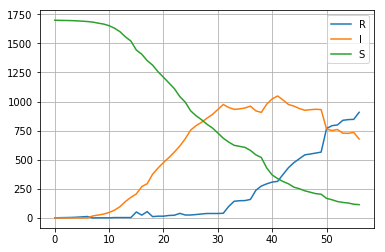

In [798]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

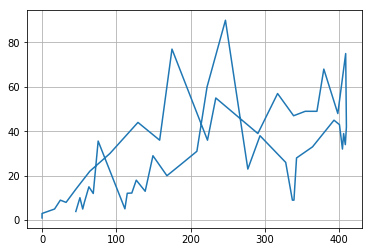

In [799]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

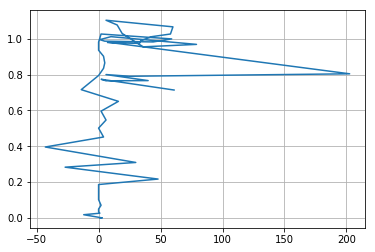

In [800]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

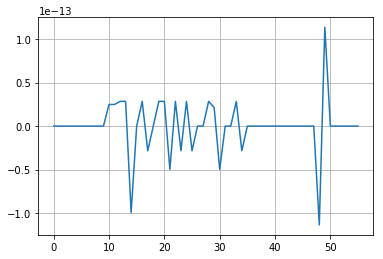

In [801]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [978]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [1044]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

[ 42.58270028 912.65637216]


In [1045]:
55*19

1045

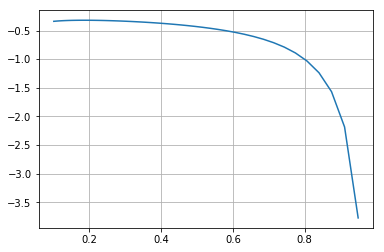

In [1046]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

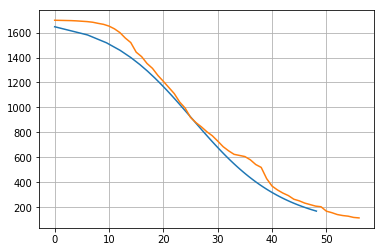

In [1059]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

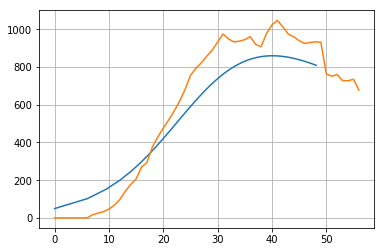

In [1058]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

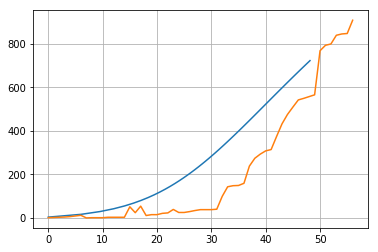

In [1060]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [992]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [824]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [995]:
gamma/(beta*x0)*55*4

45.5529411764706

In [1006]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

array([0.12589254, 0.16378937, 0.2130941 , 0.2772408 , 0.36069727,
       0.46927625, 0.61054023, 0.79432823])

In [1005]:
10**0.1

1.2589254117941673

In [1058]:
np.multiply(I,S)[1:].shape

(54,)

In [1056]:
np.diff(S).shape

(54,)

In [1063]:
50./400

0.125